# DES (Double Exponential Smoothing) method

### Import packages and load the datasets

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.api import ExponentialSmoothing
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error
import statsmodels.api as sm
import statsmodels.formula.api as smf
from datetime import datetime

In [2]:
etf = pd.read_csv('https://raw.githubusercontent.com/LinhTo11/Capstone/main/Preprocessed%20Data/ETF_assetend_rolling.csv?token=GHSAT0AAAAAABUNUAWFN6RYFGMD5JHVDWNCYT2WARQ')
ins = pd.read_csv('https://raw.githubusercontent.com/LinhTo11/Capstone/main/Preprocessed%20Data/Institutional_assetend_rolling.csv?token=GHSAT0AAAAAABUNUAWEPSJNW4OLVHSRW3U2YT2WBMA')
re = pd.read_csv('https://raw.githubusercontent.com/LinhTo11/Capstone/main/Preprocessed%20Data/Retail_assetend_rolling.csv?token=GHSAT0AAAAAABUNUAWFIA5X2ZXRNSKA3QGGYT2WBVQ')

### Show all the asset class we have

In [3]:
# all unique AssetClass
etf.AssetClass.unique()

array(['Commodities/Materials', 'Consumer Goods', 'Energy', 'Financials',
       'Health Care/Biotech', 'Industrials', 'Infrastructure',
       'Large Cap Blend', 'Large Cap Growth', 'Large Cap Value',
       'Mid Cap Blend', 'Mid Cap Growth', 'Mid Cap Value', 'Real Estate',
       'Small Cap Blend', 'Small Cap Growth', 'Small Cap Value',
       'Technology', 'Telecom', 'Utilities'], dtype=object)

### DES with a single asset class (Financials) in ETF dataset

In [117]:
fin = etf[etf['AssetClass'] == 'Financials']
fin.loc[:,['ReportDate', 'AssetsEnd']]

,ReportDate,AssetsEnd
1737,2006-01-04,501.334569
1738,2006-01-11,492.598808
1739,2006-01-18,493.687562
1740,2006-01-25,496.072619
1741,2006-02-01,502.318241
...,...,...
2311,2017-01-04,64676.472421
2312,2017-01-11,65014.491385
2313,2017-01-18,63604.582397
2314,2017-01-25,63997.173726


In [118]:
# take monthly average
# change date to datetime format
def etf_monthly_avg(x = 'Financials'):
  from datetime import datetime
  etf_1 = etf[etf['AssetClass'] == x]
  etf_1['ReportDate'] = etf_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))
  etf_1 = etf_1.set_index('ReportDate')
  etf_1 = etf_1.resample('M').mean()
  etf_1 = etf_1.reset_index()
  return etf_1

fin = etf_monthly_avg('Financials')

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/1106527024.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  etf_1['ReportDate'] = etf_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


In [119]:
# reformat
fin['month'] = pd.DatetimeIndex(fin['ReportDate']).month
fin['year'] = pd.DatetimeIndex(fin['ReportDate']).year
fin_asset = fin.loc[:, ['month', 'year', 'AssetsEnd']]
fin_asset

,month,year,AssetsEnd
0,1,2006,495.923389
1,2,2006,929.448375
2,3,2006,2608.001460
3,4,2006,2619.976664
4,5,2006,3024.714756
...,...,...,...
129,10,2016,48797.631463
130,11,2016,55658.004831
131,12,2016,62735.054322
132,1,2017,64323.179982


Text(0.5, 1.0, 'Original AssetsEnd for Financials')

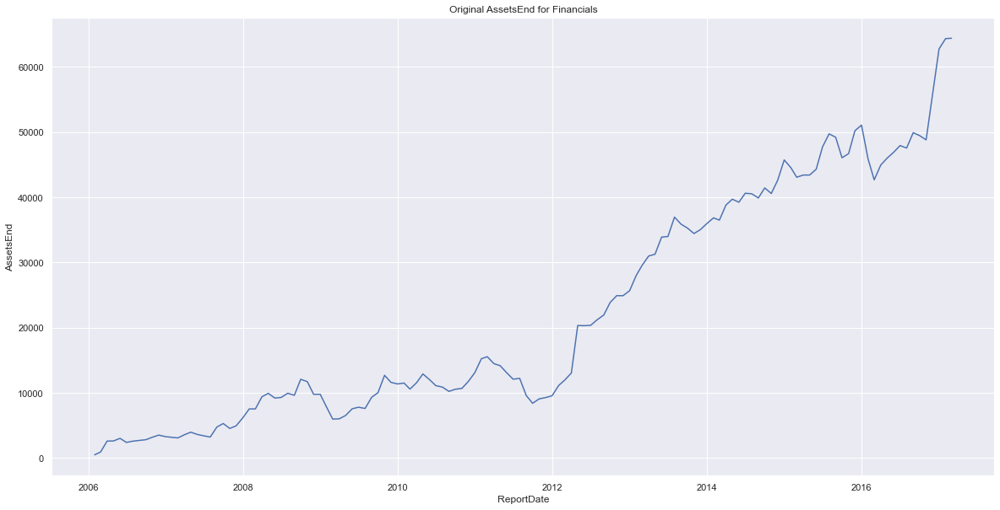

In [121]:
# plot the original AssetsEnd
sns.lineplot(x='ReportDate', y="AssetsEnd", data=fin)
plt.title('Original AssetsEnd for Financials')

In [120]:
# de-seasonalize the data

# calculate sample average
fin_asset["avg"] = fin_asset.AssetsEnd.mean()
# calculate monthly average
fin_asset["month_avg"] = pd.to_numeric(fin_asset['AssetsEnd']).groupby(fin_asset['month']).transform("mean")
# calculate the seasonal factor
fin_asset["season_factor"] = fin_asset.month_avg / fin_asset.avg
# calculate the de-sesonalized series
fin_asset["de_asset"] = fin_asset.AssetsEnd / fin_asset.season_factor
fin_asset.head(12)

,month,year,AssetsEnd,avg,month_avg,season_factor,de_asset
0,1,2006,495.923389,22231.420416,23031.063798,1.035969,478.704825
1,2,2006,929.448375,22231.420416,22647.409164,1.018712,912.376220
2,3,2006,2608.001460,22231.420416,19891.725497,0.894757,2914.758547
3,4,2006,2619.976664,22231.420416,20978.823509,0.943656,2776.409396
4,5,2006,3024.714756,22231.420416,21190.545856,0.953180,3173.288024
5,6,2006,2398.739411,22231.420416,21516.407823,0.967838,2478.452014
6,7,2006,2594.208699,22231.420416,22037.467453,0.991276,2617.040472
7,8,2006,2711.596169,22231.420416,22090.484823,0.993661,2728.895944
8,9,2006,2815.588315,22231.420416,22293.417889,1.002789,2807.758229
9,10,2006,3199.419204,22231.420416,22481.843491,1.011264,3163.781183


Text(0.5, 1.0, 'De-seasonalized AssetsEnd for Financials')

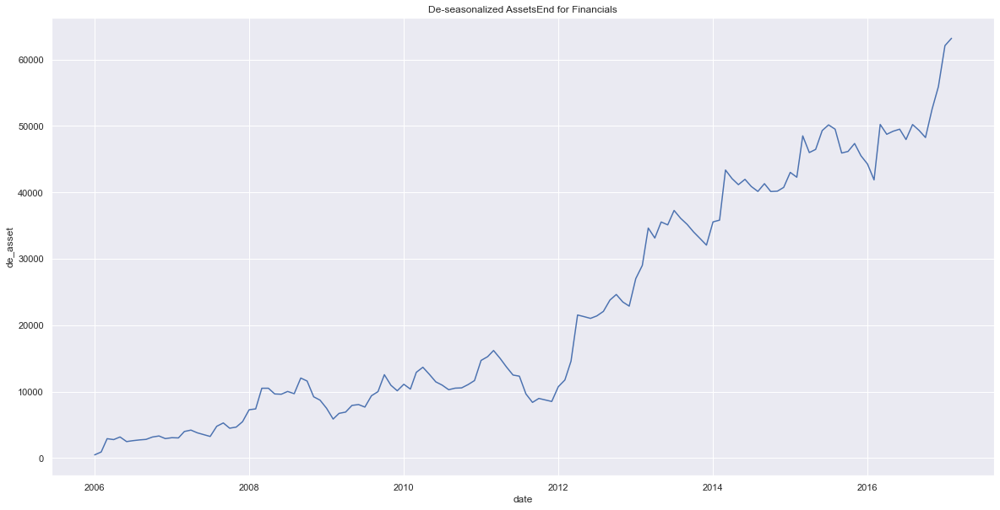

In [122]:
# plot the de-seasonalized series
for i in range(len(fin_asset)):
  fin_asset.loc[i,'date'] = str(fin_asset.loc[i,'year']) + '-' + str(fin_asset.loc[i,'month'])

fin_asset['date'] = fin_asset['date'].map(lambda x: datetime.strptime(x, '%Y-%m'))
sns.lineplot(x='date', y="de_asset", data=fin_asset)
plt.title('De-seasonalized AssetsEnd for Financials')

In [123]:
# use 80-20 train test split
training_size = round(len(fin_asset) * 0.80)
training_size

107

In [124]:
# define the Double Exponential Smoothing function
def DESMSE(alpha,beta):
    return mean_squared_error(fin_asset.de_asset[:107],
                              ExponentialSmoothing(fin_asset.de_asset[:107],trend="add", initialization_method='estimated').fit(smoothing_level = alpha,smoothing_trend = beta).predict(0,106))

In [125]:
# use grid search to find the best alpha and beta
from itertools import product
def expand_grid(dictionary):
   return pd.DataFrame([row for row in product(*dictionary.values())], 
                       columns=dictionary.keys())

dictionary = {'alpha': np.arange(0.0, 1.05, 0.05), 
              'beta': np.arange(0.0, 1.05, 0.05)}

des_results = expand_grid(dictionary)
des_results["mse"] = np.repeat(0,len(des_results))

for alpha in np.arange(0.0, 1.05, 0.05):
    for beta in np.arange(0.0, 1.05, 0.05):
       des_results.loc[(des_results["alpha"] == alpha) & (des_results["beta"] == beta),"mse"] = DESMSE(alpha,beta)

In [126]:
des_results.sort_values("mse").head(10)
# lowest training mse comes with alpha = 1 and beta = 0.00

,alpha,beta,mse
420,1.00,0.00,2.738870e+06
399,0.95,0.00,2.762720e+06
378,0.90,0.00,2.805200e+06
421,1.00,0.05,2.822672e+06
400,0.95,0.05,2.843285e+06
357,0.85,0.00,2.866981e+06
379,0.90,0.05,2.884462e+06
422,1.00,0.10,2.893675e+06
401,0.95,0.10,2.909015e+06
358,0.85,0.05,2.946791e+06


In [127]:
# predict
fin_asset.loc[fin_asset.index[107:], 'des'] = ExponentialSmoothing(fin_asset.de_asset[:107],trend="add", initialization_method='estimated').fit(smoothing_level = 1,smoothing_trend = 0.00).predict(107,133)

In [128]:
# test MSE
mean_squared_error(fin_asset.de_asset[107:],fin_asset.des[107:])

23931211.445034128

Text(0, 0.5, 'AssetsEnd')

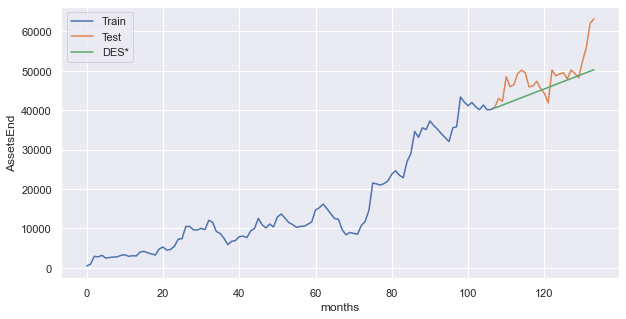

In [129]:
# plot the train test and prediction series
plt.figure(figsize=(10,5))
plt.plot(fin_asset.de_asset[:108], label='Train')
plt.plot(fin_asset.de_asset[107:], label='Test')
plt.plot(fin_asset.des[107:], label='DES*')
plt.legend(loc='best')
plt.xlabel('months')
plt.ylabel('AssetsEnd')

In [130]:
# for loop running through the time series
fin_asset['pre_signal'] = np.full(len(fin_asset), 0)
pred = []
for i in range(10,len(fin_asset)): # burn in period of 10 months
  des_results = expand_grid(dictionary)
  des_results["mse"] = np.repeat(0,len(des_results))

  def DESMSE(alpha,beta):
    return mean_squared_error(fin_asset.de_asset[:i],
                              ExponentialSmoothing(fin_asset.de_asset[:i],trend="add", initialization_method='estimated').fit(smoothing_level = alpha,smoothing_trend = beta).predict(0,i-1))

  for alpha in np.arange(0.0, 1.05, 0.05):
      for beta in np.arange(0.0, 1.05, 0.05):
        des_results.loc[(des_results["alpha"] == alpha) & (des_results["beta"] == beta),"mse"] = DESMSE(alpha,beta)
  
  des_results.sort_values('mse', ascending=True)
  # predict
  pred.append(ExponentialSmoothing(fin_asset.de_asset[:i],trend="add", initialization_method='estimated').fit(smoothing_level = des_results.iloc[0,0],smoothing_trend = des_results.iloc[0,1]).forecast(1))

In [131]:
# put the prediction series back in the dataframe
pred = [float(i) for i in pred]
predict = list(np.full(10, np.nan)) + pred
fin_asset['prediction'] = predict
fin_asset.head(20)

,month,year,AssetsEnd,avg,month_avg,season_factor,de_asset,date,des,pre_signal,prediction
0,1,2006,495.923389,22231.420416,23031.063798,1.035969,478.704825,2006-01-01,NaN,0,NaN
1,2,2006,929.448375,22231.420416,22647.409164,1.018712,912.376220,2006-02-01,NaN,0,NaN
2,3,2006,2608.001460,22231.420416,19891.725497,0.894757,2914.758547,2006-03-01,NaN,0,NaN
3,4,2006,2619.976664,22231.420416,20978.823509,0.943656,2776.409396,2006-04-01,NaN,0,NaN
4,5,2006,3024.714756,22231.420416,21190.545856,0.953180,3173.288024,2006-05-01,NaN,0,NaN
5,6,2006,2398.739411,22231.420416,21516.407823,0.967838,2478.452014,2006-06-01,NaN,0,NaN
6,7,2006,2594.208699,22231.420416,22037.467453,0.991276,2617.040472,2006-07-01,NaN,0,NaN
7,8,2006,2711.596169,22231.420416,22090.484823,0.993661,2728.895944,2006-08-01,NaN,0,NaN
8,9,2006,2815.588315,22231.420416,22293.417889,1.002789,2807.758229,2006-09-01,NaN,0,NaN
9,10,2006,3199.419204,22231.420416,22481.843491,1.011264,3163.781183,2006-10-01,NaN,0,NaN


In [132]:
# identify the signals monthly
for i in range(11,len(fin_asset)):
  if fin_asset.loc[i,'AssetsEnd'] > fin_asset.loc[i-1,'AssetsEnd']:
    fin_asset.loc[i-1, 'act_signal'] = 'Buy'
  elif fin_asset.loc[i,'AssetsEnd'] < fin_asset.loc[i-1,'AssetsEnd']:
    fin_asset.loc[i-1, 'act_signal'] = 'Sell'
  else:
    fin_asset.loc[i-1, 'act_signal'] = 'Hold'

for i in range(11,len(fin_asset)):
  if fin_asset.loc[i,'prediction'] > fin_asset.loc[i-1,'prediction']:
    fin_asset.loc[i-1, 'pre_signal'] = 'Buy'
  elif fin_asset.loc[i,'prediction'] < fin_asset.loc[i-1,'prediction']:
    fin_asset.loc[i-1, 'pre_signal'] = 'Sell'
  else:
    fin_asset.loc[i-1, 'pre_signal'] = 'Hold'

fin_asset.loc[10:20, ['AssetsEnd', 'act_signal', 'prediction', 'pre_signal']]

,AssetsEnd,act_signal,prediction,pre_signal
10,3522.955867,Sell,3582.850002,Buy
11,3284.826647,Sell,3702.648281,Sell
12,3173.225080,Sell,3646.748442,Sell
13,3086.179979,Buy,3639.679803,Sell
14,3576.932134,Buy,3618.641998,Buy
15,3970.014798,Sell,3855.575782,Buy
16,3621.189334,Sell,4088.783180,Buy
17,3412.667455,Sell,4173.705570,Buy
18,3222.398201,Buy,4177.198054,Sell
19,4752.533635,Buy,4118.207828,Buy


In [133]:
# 1-month Accuracy
(fin_asset.pre_signal[10:133] == fin_asset.act_signal[10:133]).sum()/len(fin_asset.pre_signal[10:133])

0.5609756097560976

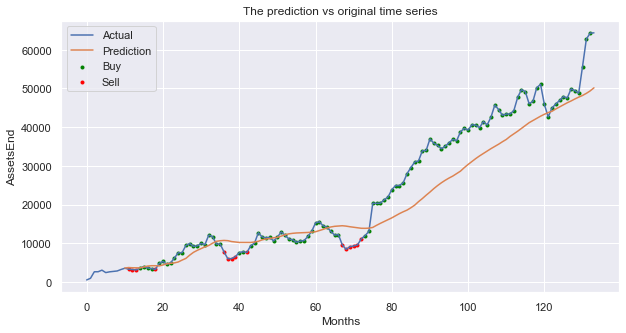

In [134]:
# plot the tradable signals
for i in range(11,len(fin_asset)):
  if fin_asset.loc[i,'pre_signal'] == 'Buy':
    fin_asset.loc[i, 'buy'] = fin_asset.loc[i, 'AssetsEnd']
  elif fin_asset.loc[i,'pre_signal'] == 'Sell':
    fin_asset.loc[i, 'sell'] = fin_asset.loc[i, 'AssetsEnd']

plt.figure(figsize=(10,5))
plt.plot(fin_asset["AssetsEnd"], label='Actual')
plt.plot(fin_asset.prediction, label='Prediction')
plt.scatter(fin_asset.index, fin_asset.buy, s=9, c='green', label='Buy')
plt.scatter(fin_asset.index, fin_asset.sell, s=9, c='red', label='Sell')
plt.legend(loc='best')
plt.title('The prediction vs original time series')
plt.xlabel('Months')
plt.ylabel('AssetsEnd')
plt.show()

In [135]:
# Sensitivity
# How many of the “buy” signals were correctly identified
len(fin_asset[(fin_asset['act_signal'] == 'Buy') & (fin_asset['pre_signal'] == 'Buy')])/len(fin_asset[fin_asset['act_signal'] == 'Buy'])

0.8552631578947368

In [136]:
# Specificity
# How many of the “sell” signals were correctly identified
len(fin_asset[(fin_asset['act_signal'] == 'Sell') & (fin_asset['pre_signal'] == 'Sell')])/len(fin_asset[fin_asset['act_signal'] == 'Sell'])

0.0851063829787234

In [137]:
# Precision
# How many of the “sell” signals were correctly identified
len(fin_asset[(fin_asset['act_signal'] == 'Buy') & (fin_asset['pre_signal'] == 'Buy')])/len(fin_asset[fin_asset['pre_signal'] == 'Buy'])

0.6018518518518519

### DES function
Three inputs: Asset, dataset and target

In [116]:
def DES(Asset = 'Financials', dataset = 'ETF', target = 'AssetsEnd'):
  # make sure the inputs are correct
  if dataset == 'ETF':
    df = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Data with New Labels/ETF_assetend_rolling.csv')
  elif dataset == 'INS':
    df = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Data with New Labels/Institutional_assetend_rolling.csv')
  elif dataset == 'RE':
    df = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Data with New Labels/Retail_assetend_rolling.csv')
  else:
    raise ValueError("Please input the correct database.")

  if Asset in df.AssetClass.unique():
    pass
  else:
    raise ValueError("Please input the correct AssetClass.")

  if target in ['AssetsEnd', 'PortfolioChangePct']:
    pass
  else:
    raise ValueError("Please input the correct target (AssetsEnd, PortfolioChangePct).")

  # take monthly average of the target column and convert date to datetime format
  def monthly_avg(x = 'Financials'):
    from datetime import datetime
    df_1 = df[df['AssetClass'] == x]
    df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    df_1 = df_1.set_index('ReportDate')
    df_1 = df_1.resample('M').mean()
    df_1 = df_1.reset_index()
    return df_1

  temp = monthly_avg(Asset)
  temp['month'] = pd.DatetimeIndex(temp['ReportDate']).month
  temp['year'] = pd.DatetimeIndex(temp['ReportDate']).year

  temp_1 = temp.loc[:, ['month', 'year', target]]

  # plot the original AssetsEnd
  sns.lineplot(x='ReportDate', y= target, data=temp)
  plt.title('Original Time Series of '+Asset+"'s "+target)
  plt.show()

  # calculate sample average
  temp_1["avg"] = temp_1[target].mean()
  # calculate monthly average
  temp_1["month_avg"] = pd.to_numeric(temp_1[target]).groupby(temp_1['month']).transform("mean")
  # calculate the seasonal factor
  temp_1["season_factor"] = temp_1.month_avg / temp_1.avg
  # calculate the de-sesonalized series
  temp_1["de_"+target] = temp_1[target] / temp_1.season_factor
  # plot the de-seasonalized series
  for i in range(len(temp_1)):
    temp_1.loc[i,'date'] = str(temp_1.loc[i,'year']) + '-' + str(temp_1.loc[i,'month'])

  temp_1['date'] = temp_1['date'].map(lambda x: datetime.strptime(x, '%Y-%m'))
  sns.lineplot(x='date', y="de_"+target, data=temp_1)
  plt.title('De-seasonalized Time Series of '+Asset+"'s "+target)
  plt.show()
  
  # Prediction
  from itertools import product
  def expand_grid(dictionary):
    return pd.DataFrame([row for row in product(*dictionary.values())], 
                        columns=dictionary.keys())

  dictionary = {'alpha': np.arange(0.0, 1.05, 0.05), 
                'beta': np.arange(0.0, 1.05, 0.05)}

  temp_1['pre_signal'] = np.full(len(temp_1), 0)
  pred = []
  for i in range(10,len(temp_1)): # burn in period of 10 months
    des_results = expand_grid(dictionary)
    des_results["mse"] = np.repeat(0,len(des_results))

    def DESMSE(alpha,beta):
      return mean_squared_error(temp_1["de_"+target][:i],
                                ExponentialSmoothing(temp_1["de_"+target][:i],trend="add", initialization_method='estimated').fit(smoothing_level = alpha,smoothing_trend = beta).predict(0,i-1))

    for alpha in np.arange(0.0, 1.05, 0.05):
        for beta in np.arange(0.0, 1.05, 0.05):
          des_results.loc[(des_results["alpha"] == alpha) & (des_results["beta"] == beta),"mse"] = DESMSE(alpha,beta)
    
    des_results.sort_values('mse', ascending=True)
    # predict
    pred.append(ExponentialSmoothing(temp_1["de_"+target][:i],trend="add", initialization_method='estimated').fit(smoothing_level = des_results.iloc[0,0],smoothing_trend = des_results.iloc[0,1]).forecast(1))
  
  pred = [float(i) for i in pred]
  predict = list(np.full(10, np.nan)) + pred
  temp_1['prediction'] = predict
  
  # Plot the prediction and the original time series
  plt.figure(figsize=(10,5))
  plt.plot(temp_1[target], label='Actual')
  plt.plot(temp_1.prediction, label='Prediction')
  plt.legend(loc='best')
  plt.title('The prediction vs original time series of '+Asset+"'s "+target)
  plt.xlabel('date')
  plt.ylabel(target)
  plt.show()

  # Calculate the MSE of this time series prediction
  prediction_mse = mean_squared_error(temp_1["de_"+target][10:len(temp_1)-1], temp_1['prediction'][10:len(temp_1)-1])
  print(f'The MSE of the '+Asset+' '+target+ f' time series prediction is {prediction_mse}.')

  # identify the signals monthly
  for i in range(11,len(temp_1)):
    if temp_1.loc[i,target] > temp_1.loc[i-1,target]:
      temp_1.loc[i-1, 'act_signal'] = 1
    elif temp_1.loc[i,target] < temp_1.loc[i-1,target]:
      temp_1.loc[i-1, 'act_signal'] = -1
    else:
      temp_1.loc[i-1, 'act_signal'] = 0

  for i in range(11,len(temp_1)):
    if temp_1.loc[i,'prediction'] > temp_1.loc[i-1,'prediction']:
      temp_1.loc[i-1, 'pre_signal'] = 1
    elif temp_1.loc[i,'prediction'] < temp_1.loc[i-1,'prediction']:
      temp_1.loc[i-1, 'pre_signal'] = -1
    else:
      temp_1.loc[i-1, 'pre_signal'] = 0

  # 1-month Accuracy
  one_month_acc = (temp_1.pre_signal[10:len(temp_1)-1] == temp_1.act_signal[10:len(temp_1)-1]).sum()/len(temp_1.pre_signal[10:len(temp_1)-1])
  one_month_auc = metrics.roc_auc_score(temp_1['act_signal'][11:len(temp_1)-1], temp_1['pre_signal'][11:len(temp_1)-1])
  one_month_TP = len(temp_1[(temp_1['act_signal'] == 1) & (temp_1['pre_signal'] == 1)])
  one_month_FP = len(temp_1[(temp_1['act_signal'] == -1) & (temp_1['pre_signal'] == 1)])
  one_month_FN = len(temp_1[(temp_1['act_signal'] == 1) & (temp_1['pre_signal'] == -1)])
  one_month_TN = len(temp_1[(temp_1['act_signal'] == -1) & (temp_1['pre_signal'] == -1)])
  print(f"The "+Asset+" "+target+ f" one month interval prediction's accuracy is {one_month_acc}."+f" The AUC score is {one_month_auc}.")

  # identify the signals every three months
  for i in range(10,len(temp_1),3):
    if temp_1.loc[i,target] > temp_1.loc[i-3,target]:
      temp_1.loc[i-3, 'act_signal3'] = 1
    elif temp_1.loc[i,target] < temp_1.loc[i-3,target]:
      temp_1.loc[i-3, 'act_signal3'] = -1
    else:
      temp_1.loc[i-3, 'act_signal3'] = 0

  for i in range(10,len(temp_1),3):
    if temp_1.loc[i,'prediction'] > temp_1.loc[i-3,'prediction']:
      temp_1.loc[i-3, 'pre_signal3'] = 1
    elif temp_1.loc[i,'prediction'] < temp_1.loc[i-3,'prediction']:
      temp_1.loc[i-3, 'pre_signal3'] = -1
    else:
      temp_1.loc[i-3, 'pre_signal3'] = 0

  # 3-month Accuracy
  three_month_des = temp_1[temp_1['act_signal3'].isna() == False][1:]
  three_month_acc = (three_month_des.pre_signal3 == three_month_des.act_signal3).sum()/len(three_month_des.pre_signal3)
  three_month_auc = metrics.roc_auc_score(three_month_des['act_signal3'], three_month_des['pre_signal3'])
  three_month_TP = len(three_month_des[(three_month_des['act_signal3'] == 1) & (three_month_des['pre_signal3'] == 1)])
  three_month_FP = len(three_month_des[(three_month_des['act_signal3'] == -1) & (three_month_des['pre_signal3'] == 1)])
  three_month_FN = len(three_month_des[(three_month_des['act_signal3'] == 1) & (three_month_des['pre_signal3'] == -1)])
  three_month_TN = len(three_month_des[(three_month_des['act_signal3'] == -1) & (three_month_des['pre_signal3'] == -1)])
  print(f"The "+Asset+" "+target+ f" three months interval prediction's accuracy is {three_month_acc}."+f" The AUC score is {three_month_auc}.")

  # identify the signals every three months
  for i in range(10,len(temp_1),6):
    if temp_1.loc[i,target] > temp_1.loc[i-6,target]:
      temp_1.loc[i-6, 'act_signal6'] = 1
    elif temp_1.loc[i,target] < temp_1.loc[i-6,target]:
      temp_1.loc[i-6, 'act_signal6'] = -1
    else:
      temp_1.loc[i-6, 'act_signal6'] = 0

  for i in range(10,len(temp_1),6):
    if temp_1.loc[i,'prediction'] > temp_1.loc[i-6,'prediction']:
      temp_1.loc[i-6, 'pre_signal6'] = 1
    elif temp_1.loc[i,'prediction'] < temp_1.loc[i-6,'prediction']:
      temp_1.loc[i-6, 'pre_signal6'] = -1
    else:
      temp_1.loc[i-6, 'pre_signal6'] = 0

  # 6-month Accuracy
  six_month_des = temp_1[temp_1['act_signal6'].isna() == False][1:]
  six_month_acc = (six_month_des.pre_signal6 == six_month_des.act_signal6).sum()/len(six_month_des.pre_signal6)
  six_month_auc = metrics.roc_auc_score(six_month_des['act_signal6'], six_month_des['pre_signal6'])
  six_month_TP = len(six_month_des[(six_month_des['act_signal6'] == 1) & (six_month_des['pre_signal6'] == 1)])
  six_month_FP = len(six_month_des[(six_month_des['act_signal6'] == -1) & (six_month_des['pre_signal6'] == 1)])
  six_month_FN = len(six_month_des[(six_month_des['act_signal6'] == 1) & (six_month_des['pre_signal6'] == -1)])
  six_month_TN = len(six_month_des[(six_month_des['act_signal6'] == -1) & (six_month_des['pre_signal6'] == -1)])
  print(f"The "+Asset+" "+target+ f" six months interval prediction's accuracy is {six_month_acc}."+f" The AUC score is {six_month_auc}.")

  # plot the one month signals
  for i in range(11,len(temp_1)):
    if temp_1.loc[i,'pre_signal'] == 1:
      temp_1.loc[i, 'buy1'] = temp_1.loc[i, target]
    elif temp_1.loc[i,'pre_signal'] == -1:
      temp_1.loc[i, 'sell1'] = temp_1.loc[i, target]
  temp_1.reset_index(inplace=True)
  
  # plot the tradable signals
  plt.figure(figsize=(10,5))
  plt.plot(temp_1[target], label='Actual')
  plt.plot(temp_1.prediction, label='Prediction')
  plt.scatter(temp_1.index, temp_1.buy1, s=9, c='green', label='Buy')
  plt.scatter(temp_1.index, temp_1.sell1, s=9, c='red', label='Sell')
  plt.legend(loc='best')
  plt.title('The prediction vs original time series of '+Asset+"'s "+target+" with monthly tradable signals.")
  plt.xlabel('Months')
  plt.ylabel(target)
  plt.show()

  for i in range(11,len(temp_1)):
    if temp_1.loc[i,'pre_signal3'] == 1:
      temp_1.loc[i, 'buy3'] = temp_1.loc[i, target]
    elif temp_1.loc[i,'pre_signal3'] == -1:
      temp_1.loc[i, 'sell3'] = temp_1.loc[i, target]
  
  plt.figure(figsize=(10,5))
  plt.plot(temp_1[target], label='Actual')
  plt.plot(temp_1.prediction, label='Prediction')
  plt.scatter(temp_1.index, temp_1.buy3, s=9, c='green', label='Buy')
  plt.scatter(temp_1.index, temp_1.sell3, s=9, c='red', label='Sell')
  plt.legend(loc='best')
  plt.title('The prediction vs original time series of '+Asset+"'s "+target+" with three months interval tradable signals.")
  plt.xlabel('Months')
  plt.ylabel(target)
  plt.show()

  for i in range(11,len(temp_1)):
    if temp_1.loc[i,'pre_signal6'] == 1:
      temp_1.loc[i, 'buy6'] = temp_1.loc[i, target]
    elif temp_1.loc[i,'pre_signal6'] == -1:
      temp_1.loc[i, 'sell6'] = temp_1.loc[i, target]
  
  plt.figure(figsize=(10,5))
  plt.plot(temp_1[target], label='Actual')
  plt.plot(temp_1.prediction, label='Prediction')
  plt.scatter(temp_1.index, temp_1.buy6, s=9, c='green', label ='Buy')
  plt.scatter(temp_1.index, temp_1.sell6, s=9, c='red', label='Sell')
  plt.legend(loc='best')
  plt.title('The prediction vs original time series of '+Asset+"'s "+target+" with six months interval tradable signals.")
  plt.xlabel('Months')
  plt.ylabel(target)
  plt.show()

  # return results
  return prediction_mse, one_month_acc, one_month_auc, three_month_acc, three_month_auc, six_month_acc, six_month_auc, one_month_TP, one_month_FP, one_month_FN, one_month_TN, three_month_TP, three_month_FP, three_month_FN, three_month_TN, six_month_TP, six_month_FP, six_month_FN, six_month_TN

### An example to show what this function does
1. Draw the plot of original time series
2. Draw the plot of de-seasonalized time series
3. Draw the original time series and the smooth prediction
4. Draw the plots of tradable signals in three kinds of time interval
5. Calculate the MSE of original series and smooth prediction
6. Calculate the accuracy, AUC score, number of true positive, false positive, false negative and true negative of the three scenarios

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


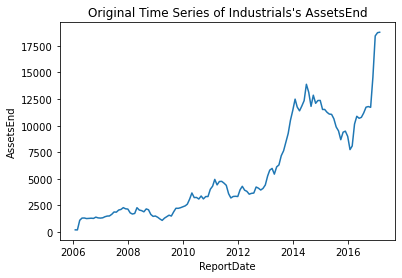

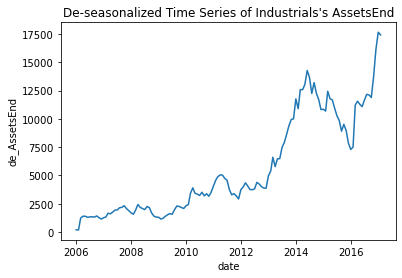

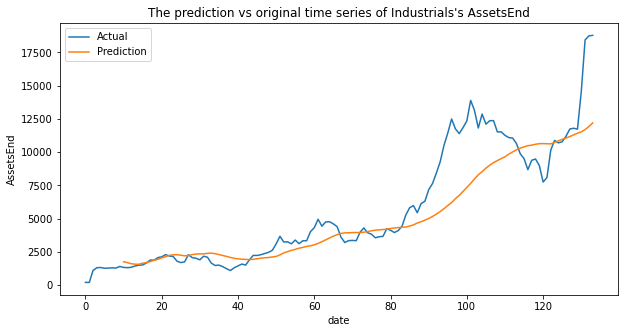

The MSE of the Industrials AssetsEnd time series prediction is 4193727.8972478984.
The Industrials AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.4814189189189189.
The Industrials AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.4756410256410256.
The Industrials AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5476190476190476.


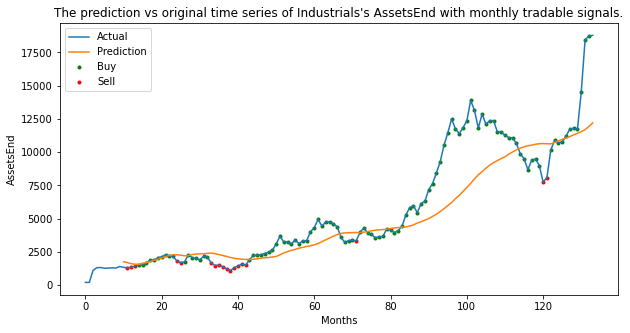

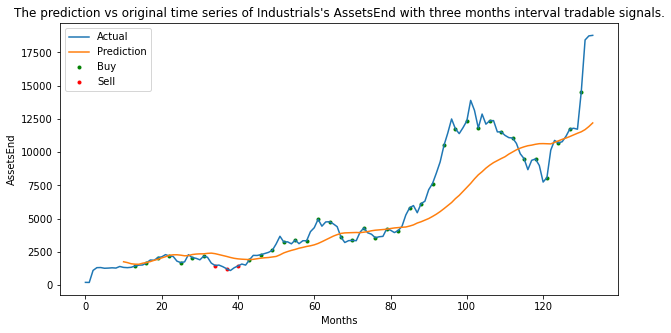

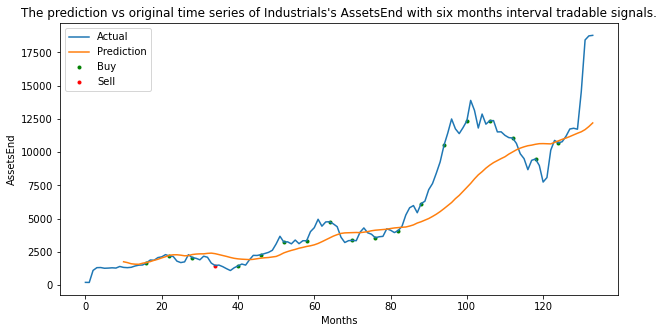

(4193727.8972478984,
 0.5609756097560976,
 0.4814189189189189,
 0.5853658536585366,
 0.4756410256410256,
 0.7,
 0.5476190476190476,
 62,
 42,
 12,
 7,
 23,
 14,
 3,
 1,
 13,
 5,
 1,
 1)

In [105]:
DES(Asset = 'Industrials', database = 'ETF', target = 'AssetsEnd')

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


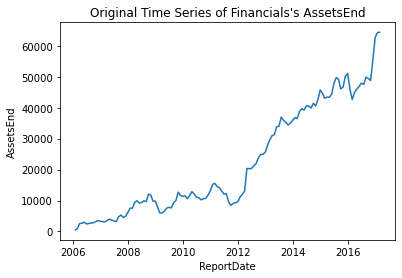

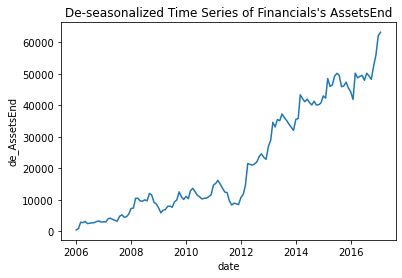

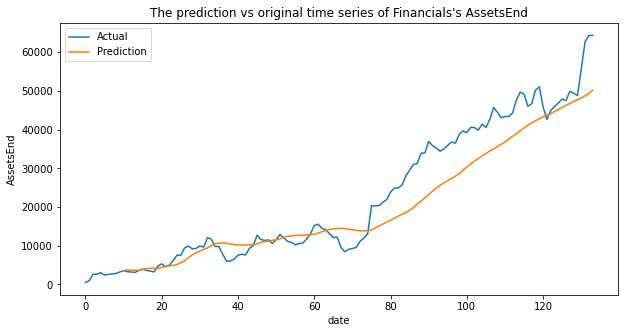

The MSE of the Financials AssetsEnd time series prediction is 35348994.52403534.
The Financials AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.47110983981693366.
The Financials AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5086805555555556.
The Financials AssetsEnd six months interval prediction's accuracy is 0.9. The AUC score is 0.75.


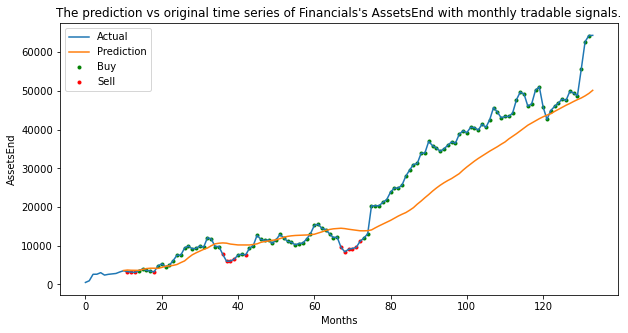

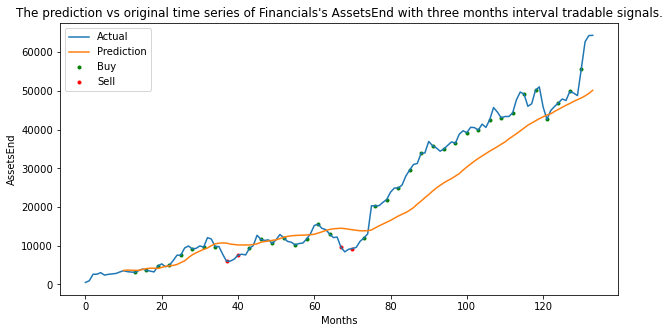

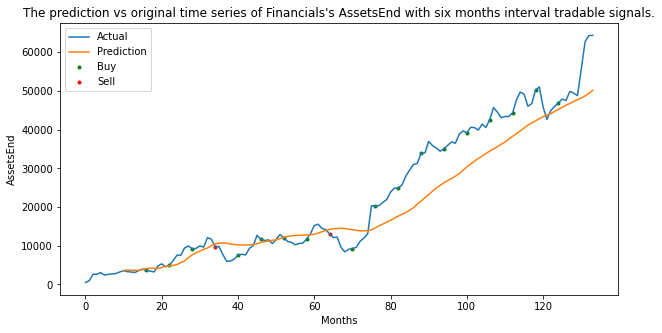

In [71]:
asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES()

### Take out asset "Infrastructure" because it contains a lot of outliers

In [56]:
asset_name = np. delete(etf.AssetClass.unique(), 6)
asset_name

array(['Commodities/Materials', 'Consumer Goods', 'Energy', 'Financials',
       'Health Care/Biotech', 'Industrials', 'Large Cap Blend',
       'Large Cap Growth', 'Large Cap Value', 'Mid Cap Blend',
       'Mid Cap Growth', 'Mid Cap Value', 'Real Estate',
       'Small Cap Blend', 'Small Cap Growth', 'Small Cap Value',
       'Technology', 'Telecom', 'Utilities'], dtype=object)

### Run the function of AssetsEnd and PorfolioChangePct for all the three databases
### Save the results to individual csv file

#### ETF AssetsEnd

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


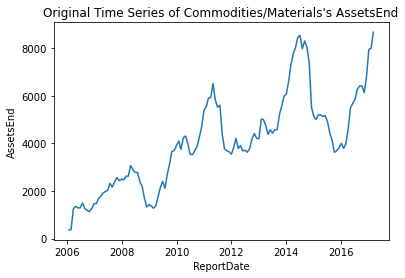

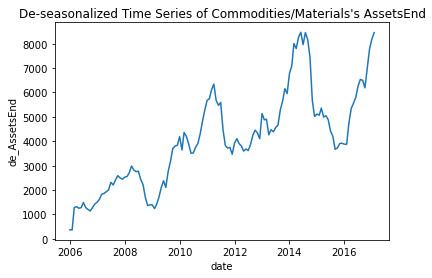

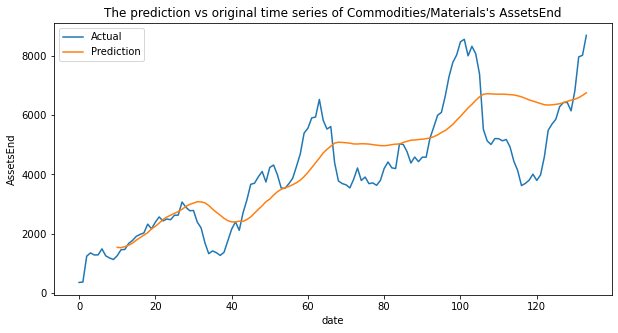

The MSE of the Commodities/Materials AssetsEnd time series prediction is 1470587.1656014665.
The Commodities/Materials AssetsEnd one month interval prediction's accuracy is 0.5772357723577236. The AUC score is 0.5419481981981982.
The Commodities/Materials AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5875.
The Commodities/Materials AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.5666666666666667.


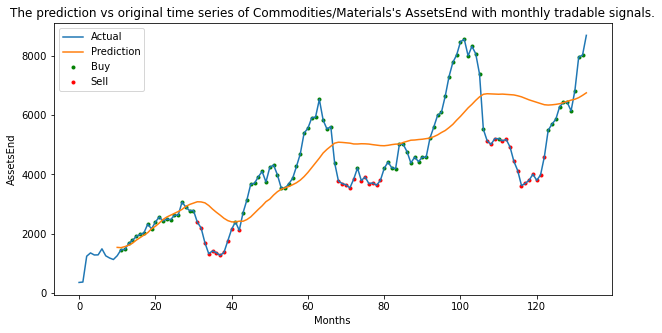

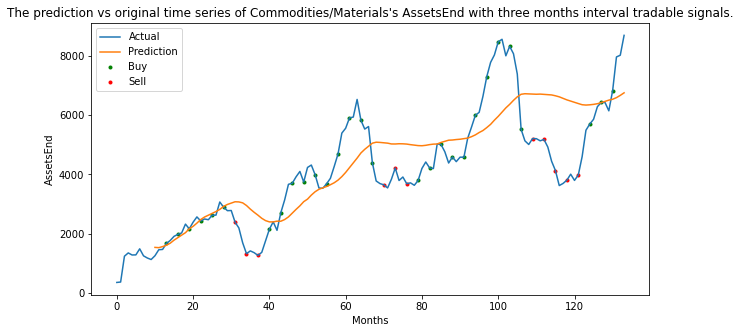

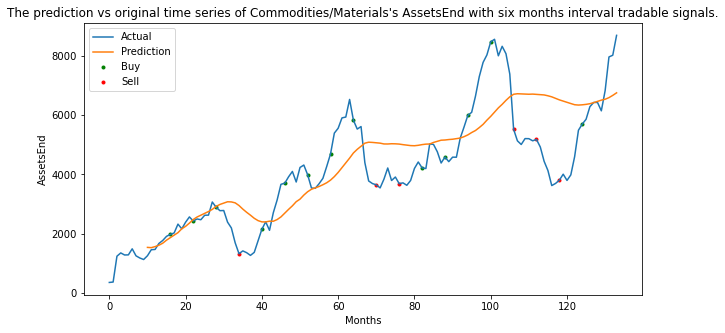

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


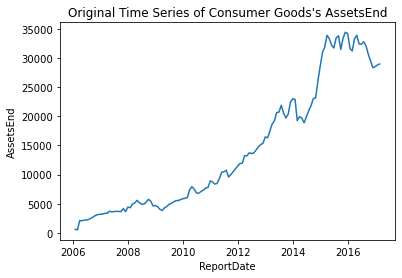

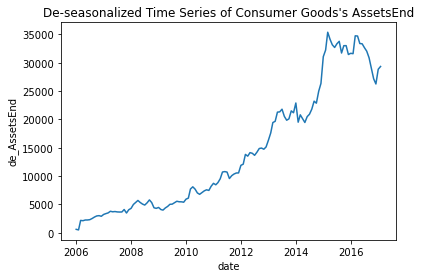

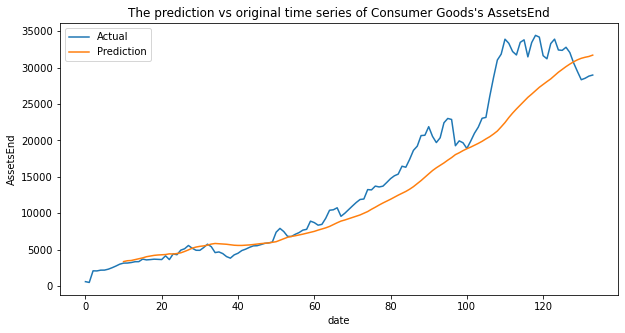

The MSE of the Consumer Goods AssetsEnd time series prediction is 13715571.837212117.
The Consumer Goods AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.5057211683227942.
The Consumer Goods AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5287878787878788.
The Consumer Goods AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.6.


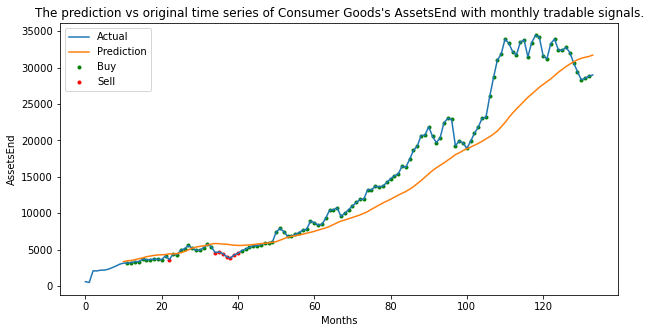

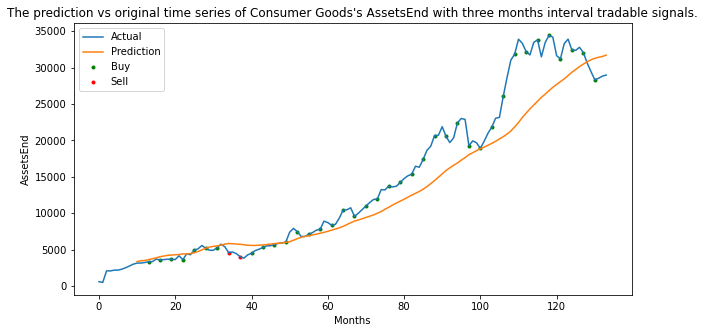

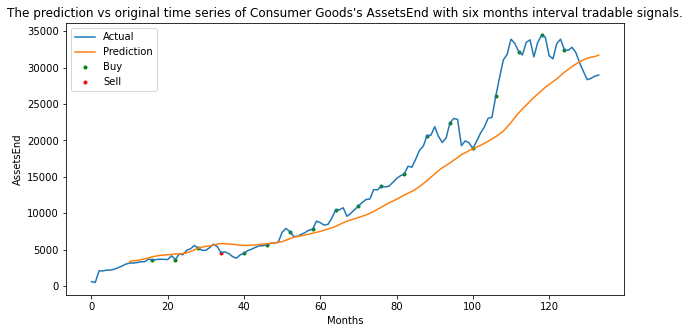

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


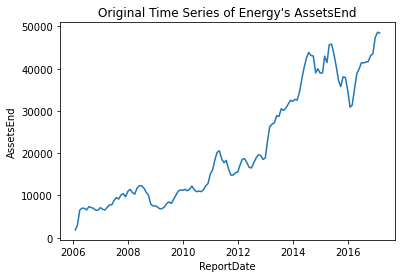

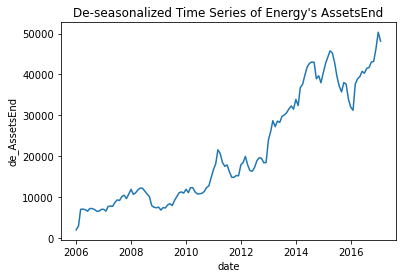

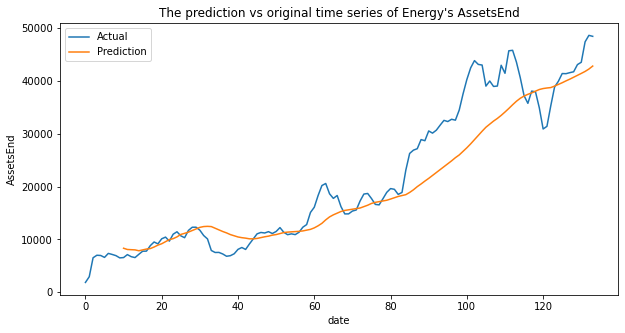

The MSE of the Energy AssetsEnd time series prediction is 26478757.870243695.
The Energy AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5234553775743707.
The Energy AssetsEnd three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.5796703296703296.
The Energy AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.40625.


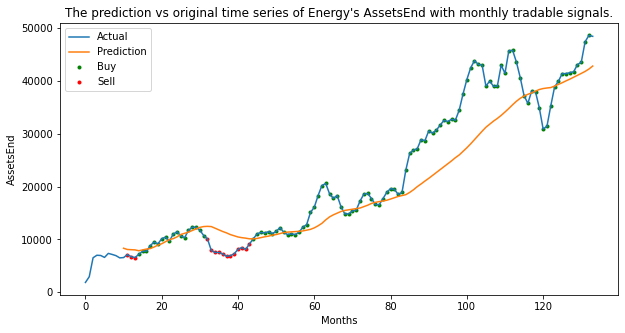

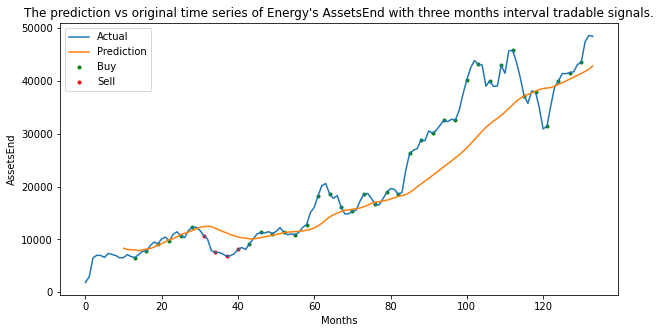

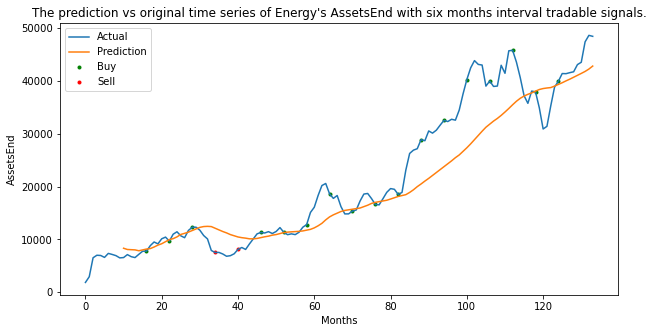

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


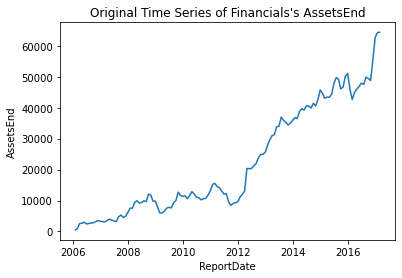

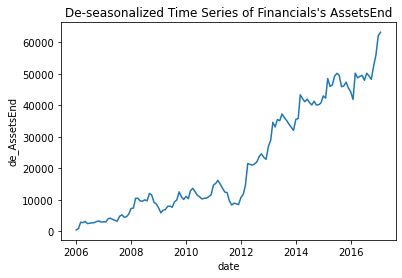

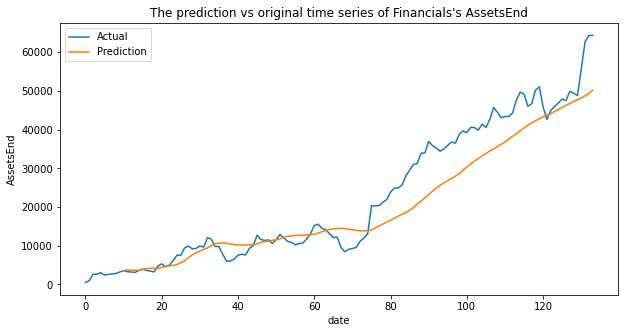

The MSE of the Financials AssetsEnd time series prediction is 35348994.52403534.
The Financials AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.47110983981693366.
The Financials AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5086805555555556.
The Financials AssetsEnd six months interval prediction's accuracy is 0.9. The AUC score is 0.75.


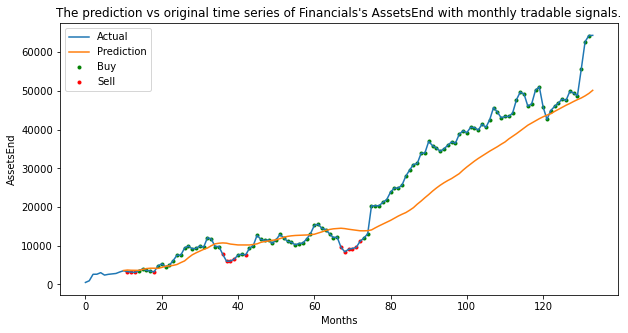

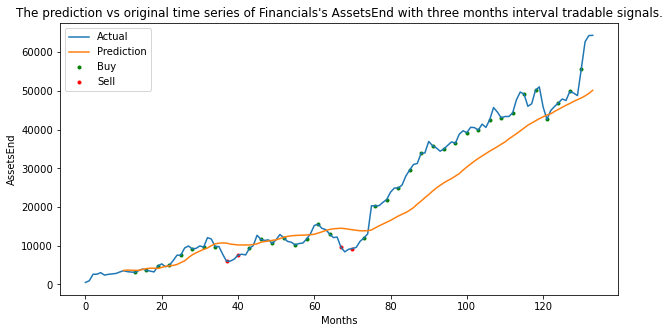

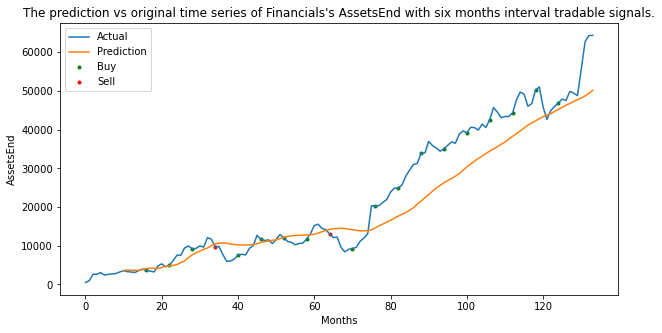

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


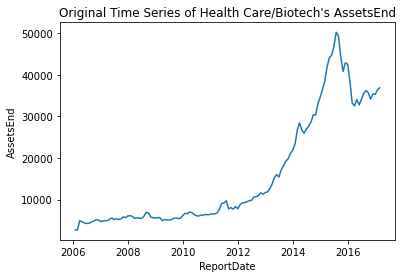

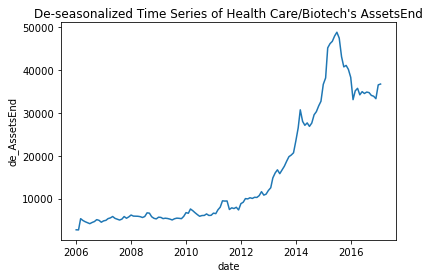

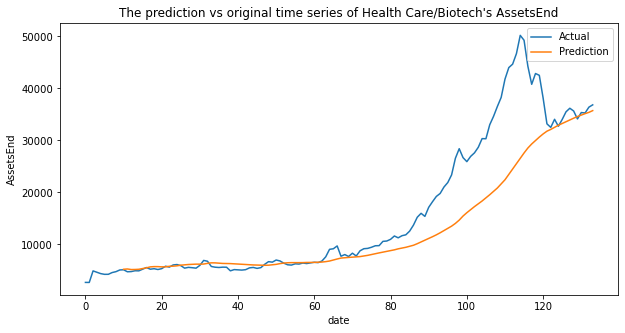

The MSE of the Health Care/Biotech AssetsEnd time series prediction is 50762749.9485813.
The Health Care/Biotech AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5203962703962703.
The Health Care/Biotech AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5701058201058201.
The Health Care/Biotech AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5476190476190476.


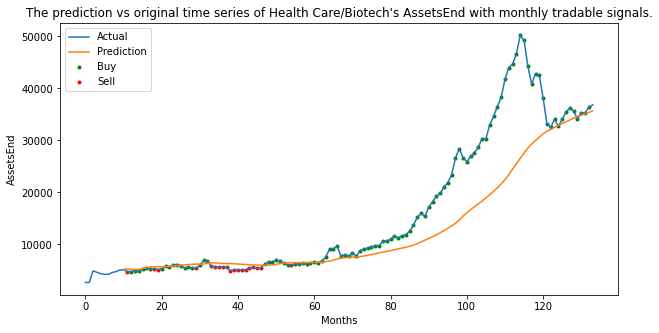

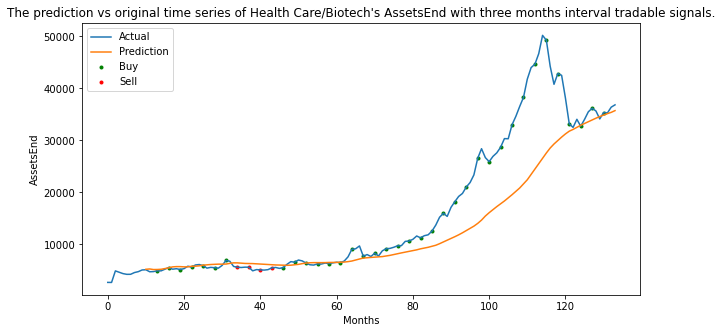

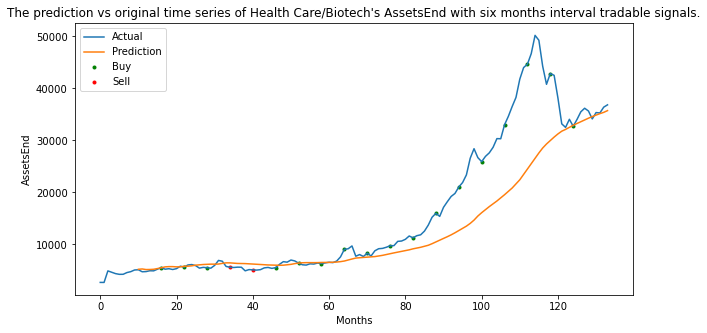

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


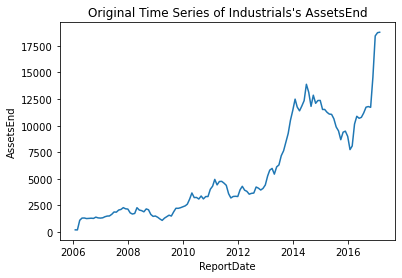

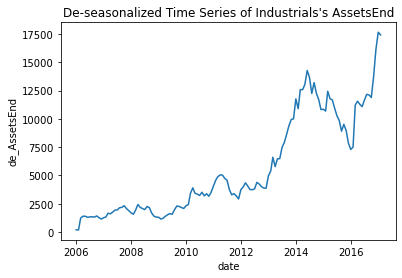

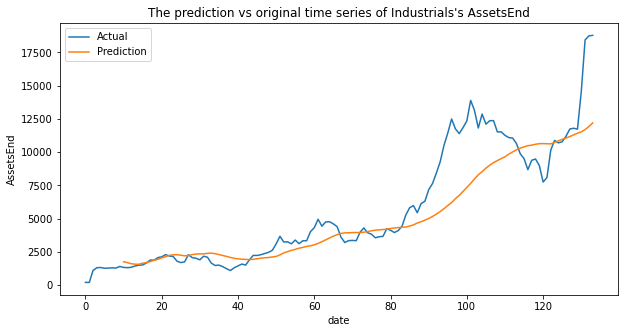

The MSE of the Industrials AssetsEnd time series prediction is 4193727.8972478984.
The Industrials AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.4814189189189189.
The Industrials AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.4756410256410256.
The Industrials AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5476190476190476.


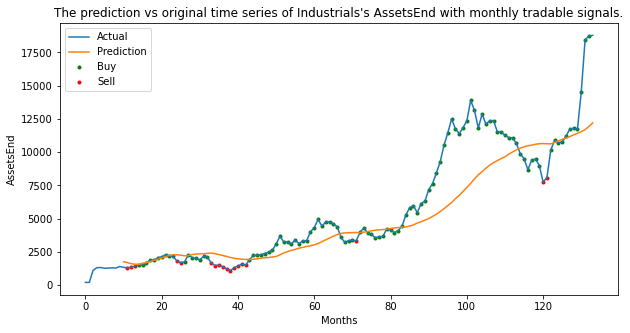

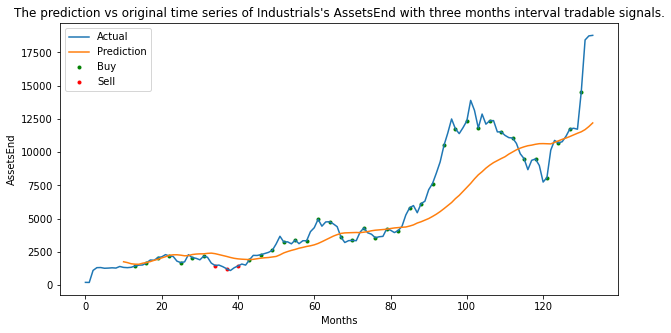

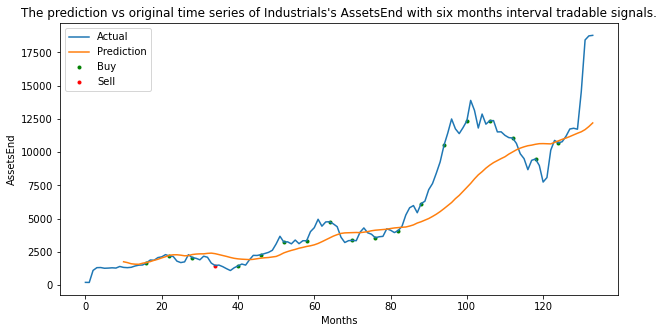

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


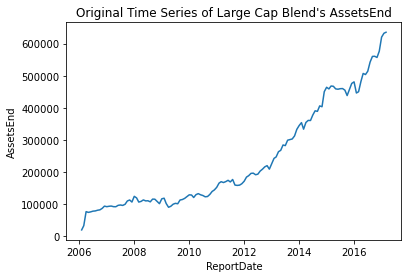

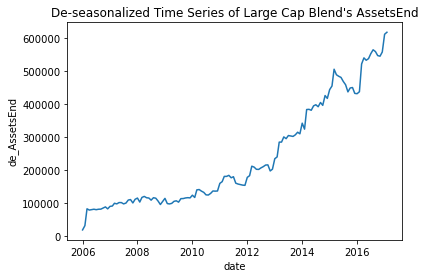

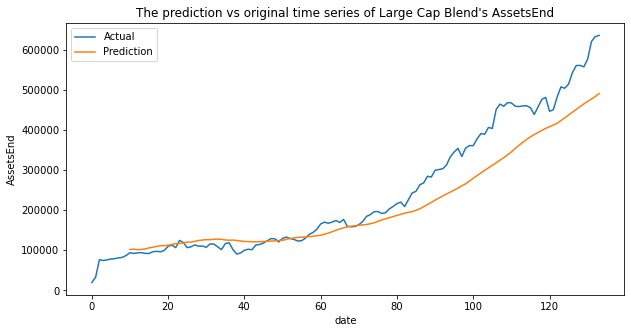

The MSE of the Large Cap Blend AssetsEnd time series prediction is 3538437082.9901824.
The Large Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6178861788617886. The AUC score is 0.4782205746061167.
The Large Cap Blend AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5177419354838709.
The Large Cap Blend AssetsEnd six months interval prediction's accuracy is 0.9. The AUC score is 0.6666666666666667.


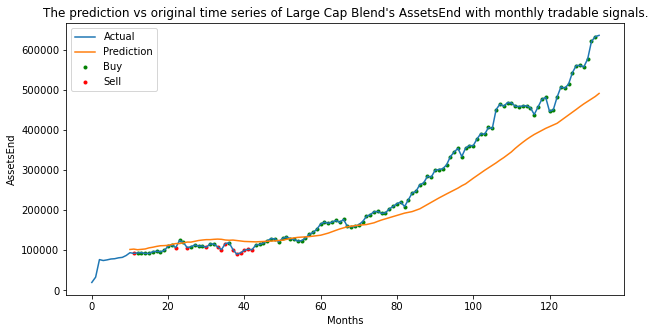

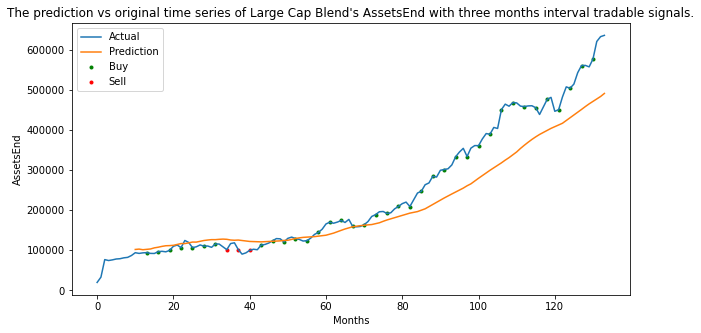

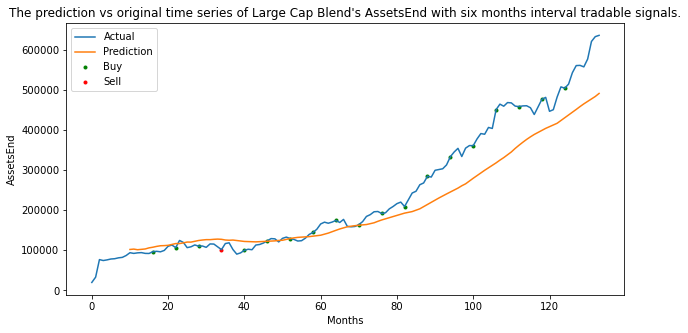

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


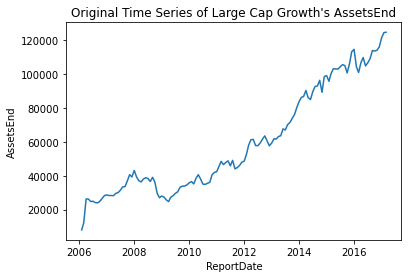

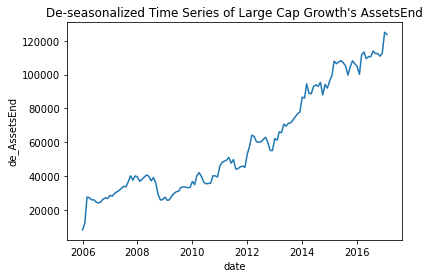

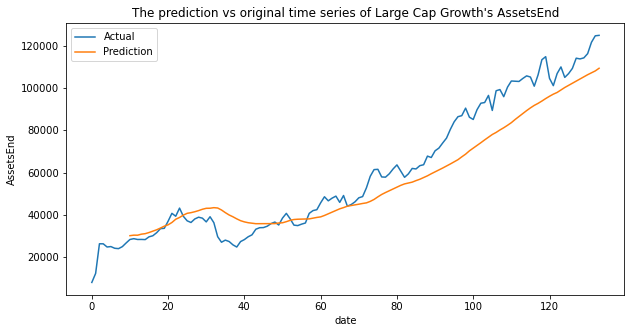

The MSE of the Large Cap Growth AssetsEnd time series prediction is 108593278.71295656.
The Large Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6666666666666666. The AUC score is 0.5287303058387396.
The Large Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7804878048780488. The AUC score is 0.579861111111111.
The Large Cap Growth AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.43333333333333335.


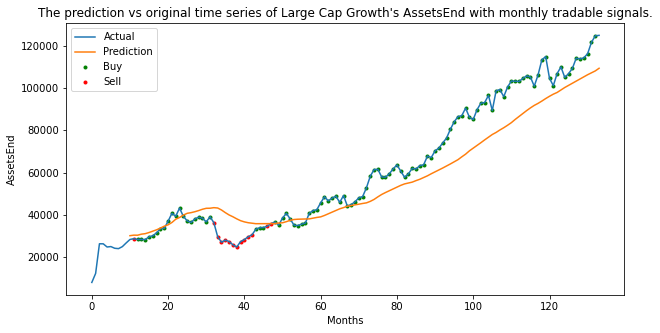

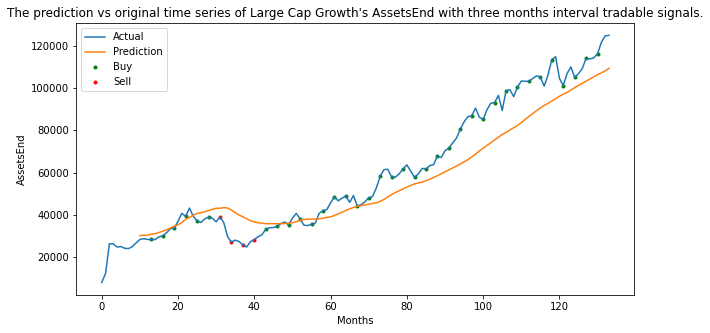

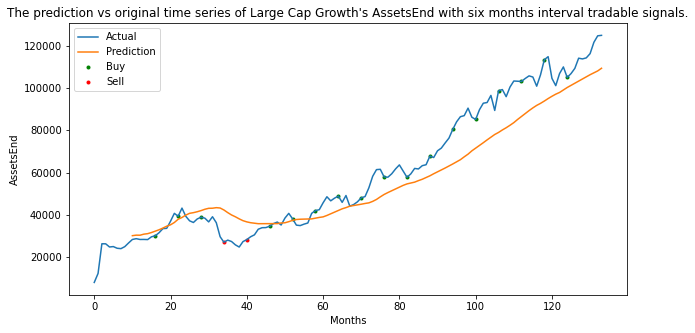

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


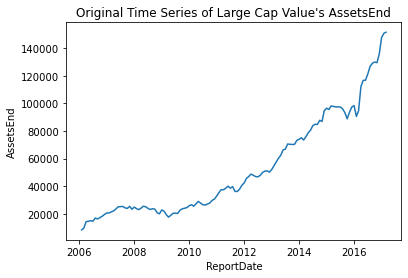

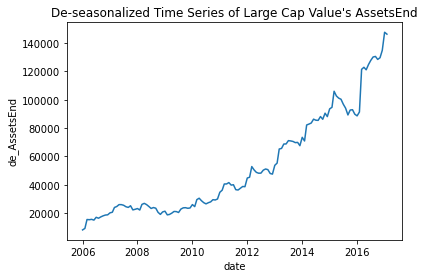

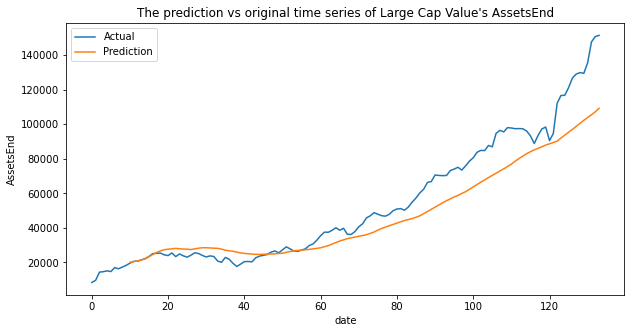

The MSE of the Large Cap Value AssetsEnd time series prediction is 183161648.95749205.
The Large Cap Value AssetsEnd one month interval prediction's accuracy is 0.6747967479674797. The AUC score is 0.5603733815115929.
The Large Cap Value AssetsEnd three months interval prediction's accuracy is 0.7560975609756098. The AUC score is 0.603030303030303.
The Large Cap Value AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.607843137254902.


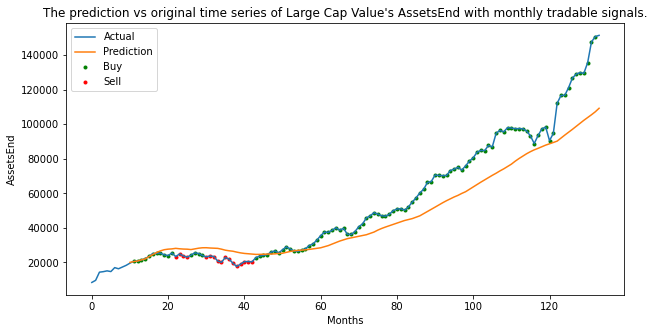

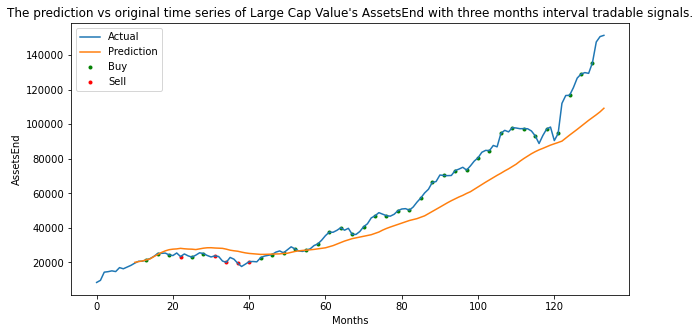

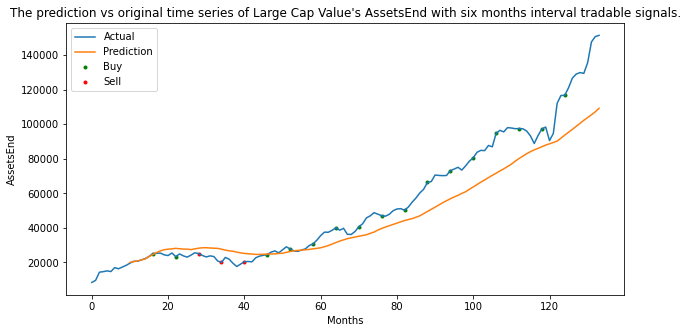

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


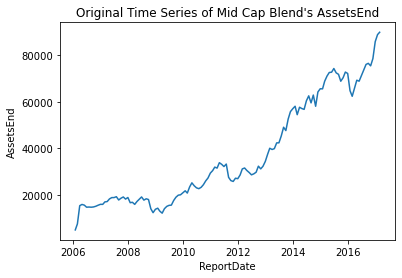

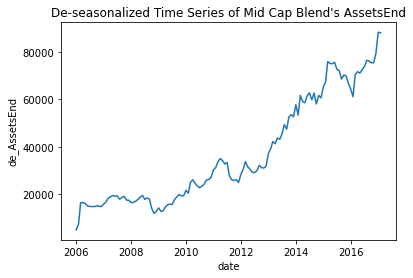

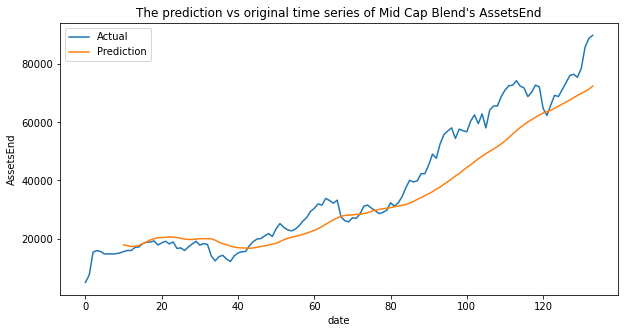

The MSE of the Mid Cap Blend AssetsEnd time series prediction is 68059385.70487578.
The Mid Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5083333333333333.
The Mid Cap Blend AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5193548387096774.
The Mid Cap Blend AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.6666666666666667.


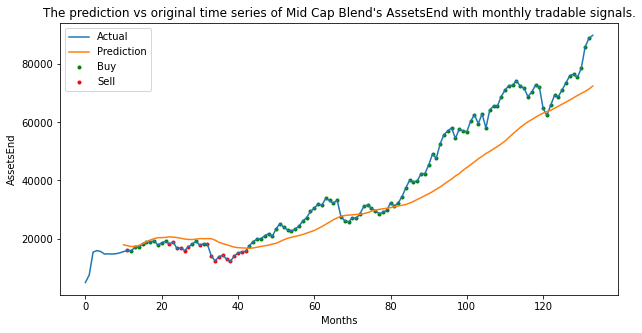

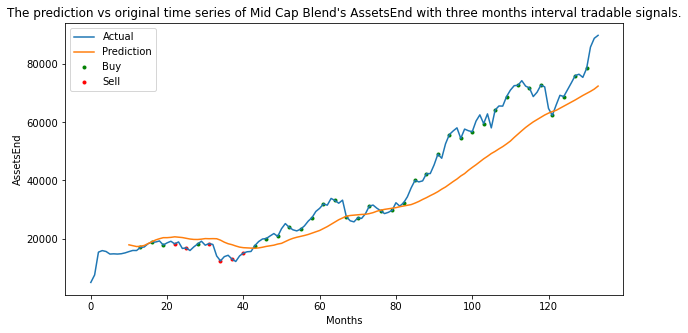

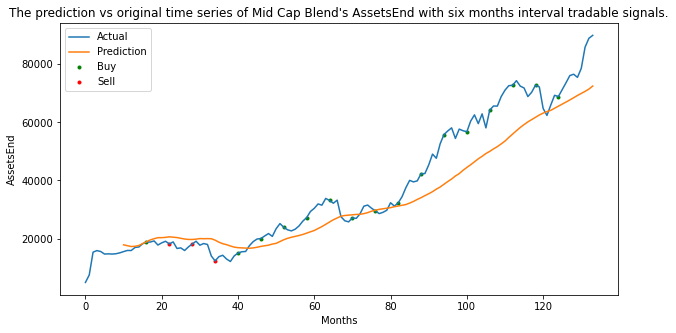

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


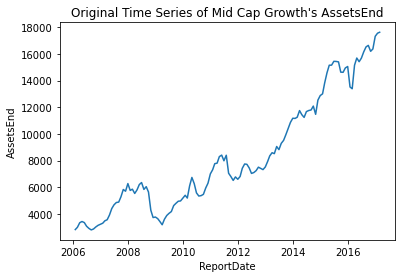

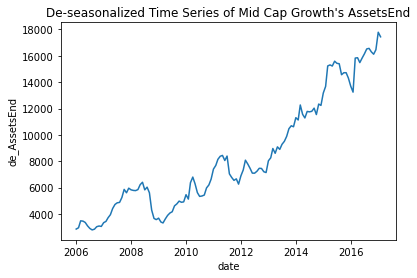

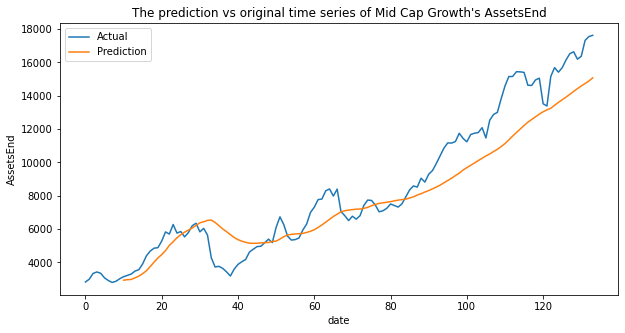

The MSE of the Mid Cap Growth AssetsEnd time series prediction is 2489286.6468341714.
The Mid Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6666666666666666. The AUC score is 0.5109649122807017.
The Mid Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5575757575757576.
The Mid Cap Growth AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.4375.


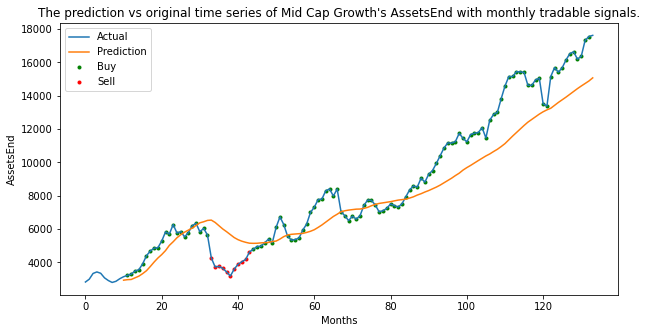

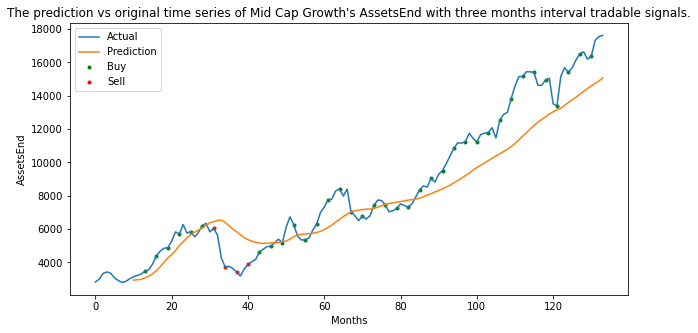

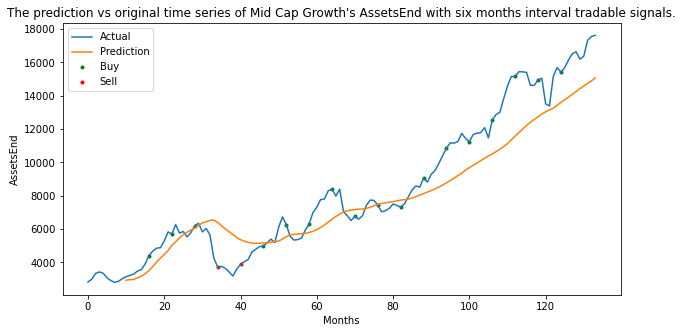

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


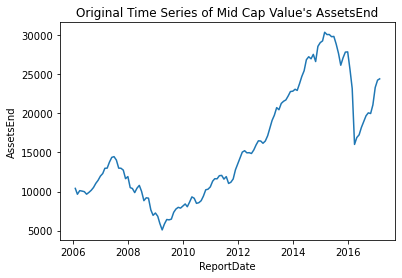

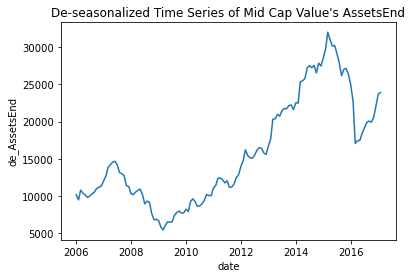

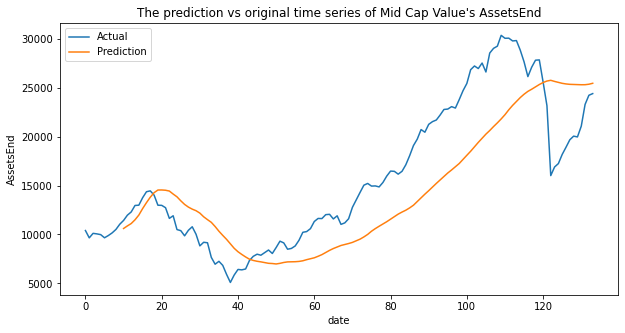

The MSE of the Mid Cap Value AssetsEnd time series prediction is 21439872.343908675.
The Mid Cap Value AssetsEnd one month interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5776874435411021.
The Mid Cap Value AssetsEnd three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.6057692307692308.
The Mid Cap Value AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.6428571428571428.


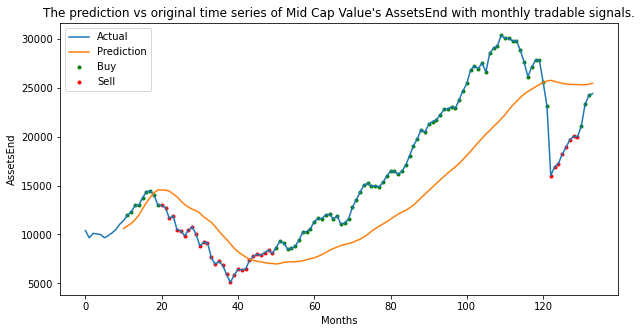

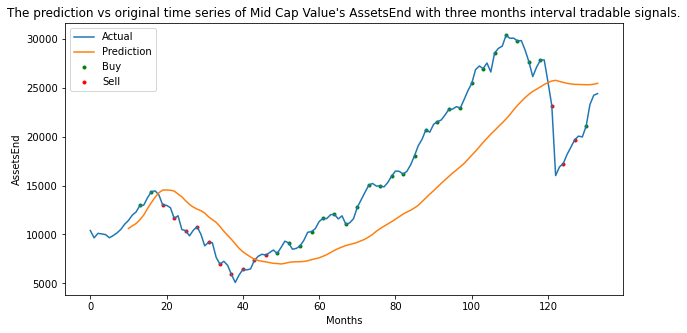

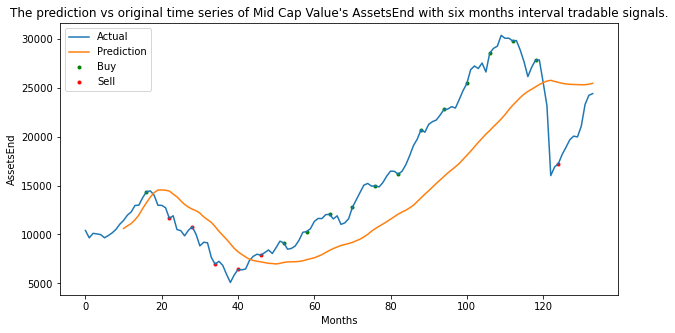

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


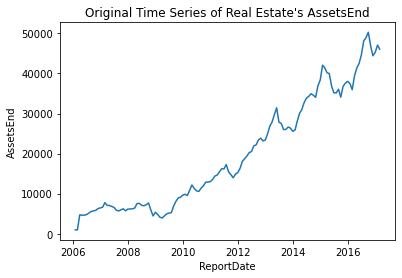

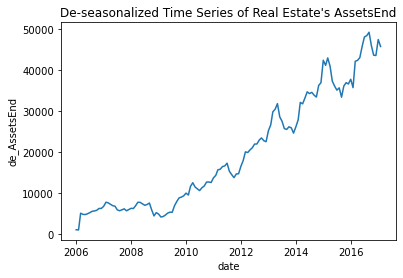

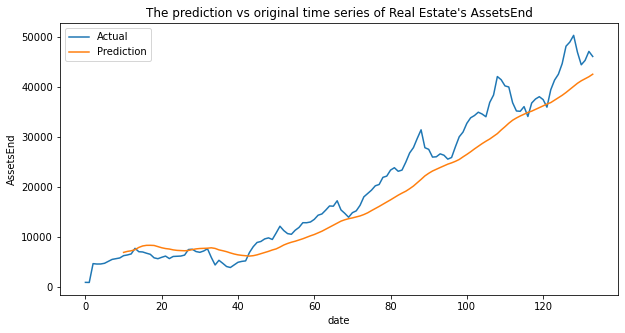

The MSE of the Real Estate AssetsEnd time series prediction is 18840647.740076598.
The Real Estate AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5054459817486017.
The Real Estate AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5560344827586207.
The Real Estate AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5333333333333333.


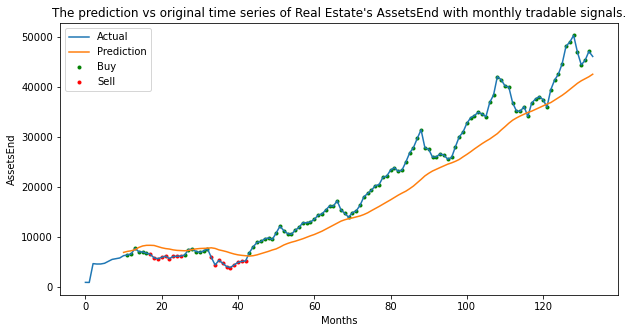

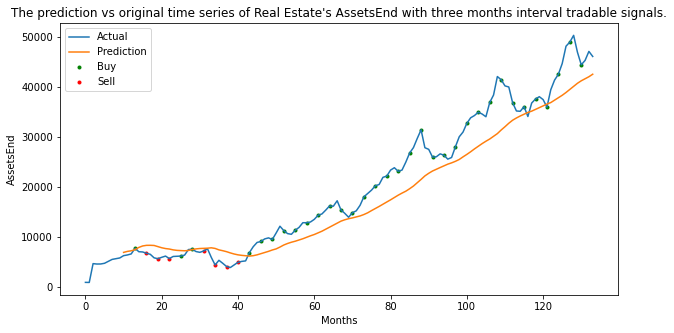

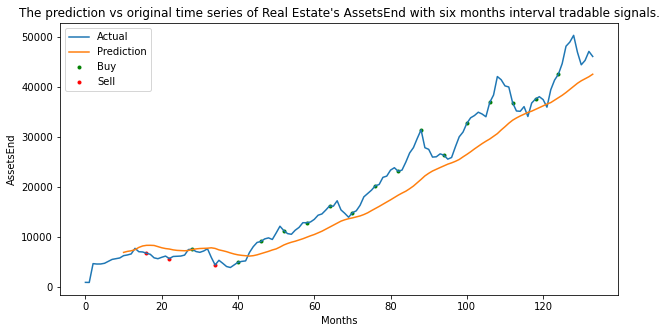

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


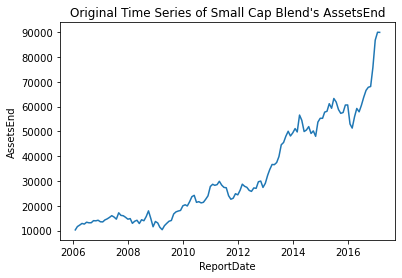

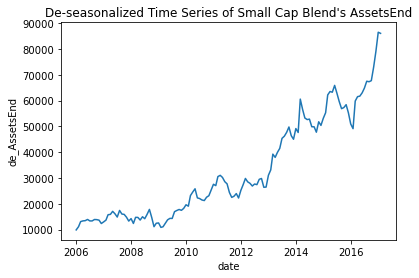

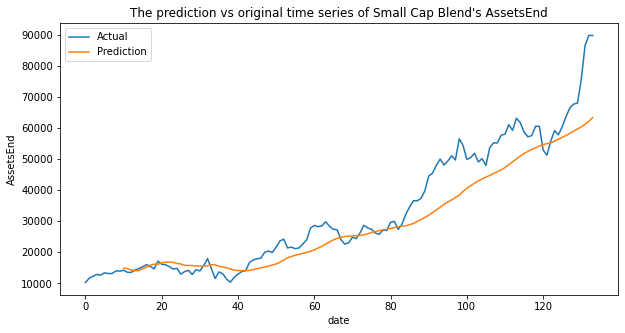

The MSE of the Small Cap Blend AssetsEnd time series prediction is 53570411.93914519.
The Small Cap Blend AssetsEnd one month interval prediction's accuracy is 0.5934959349593496. The AUC score is 0.51177304964539.
The Small Cap Blend AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5863636363636363.
The Small Cap Blend AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5476190476190476.


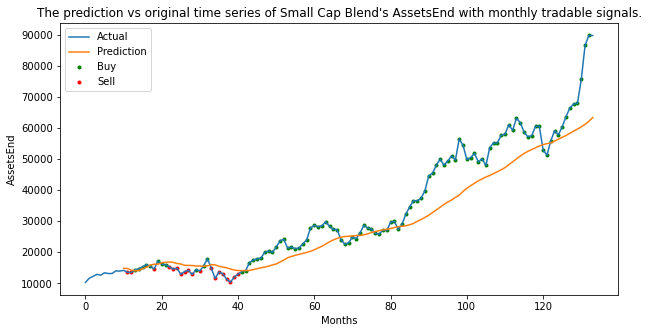

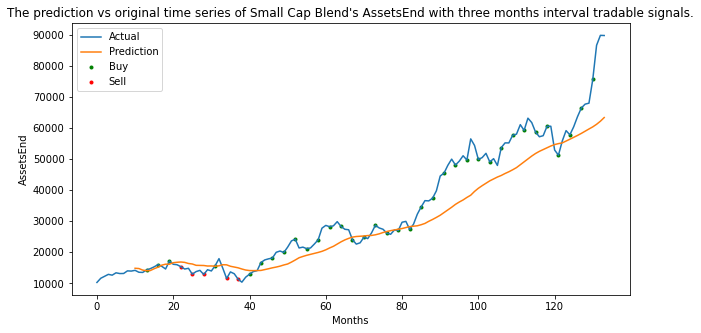

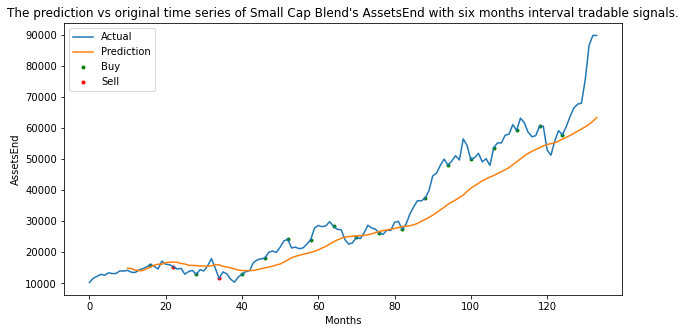

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


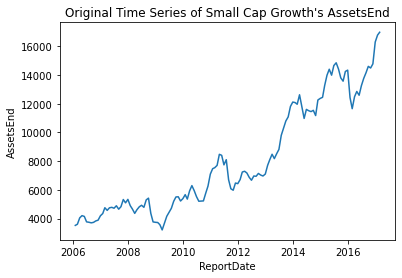

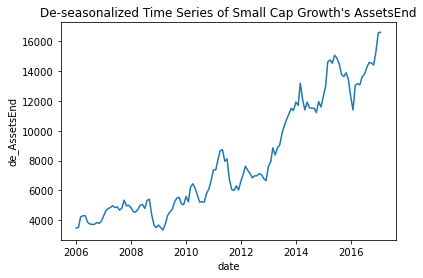

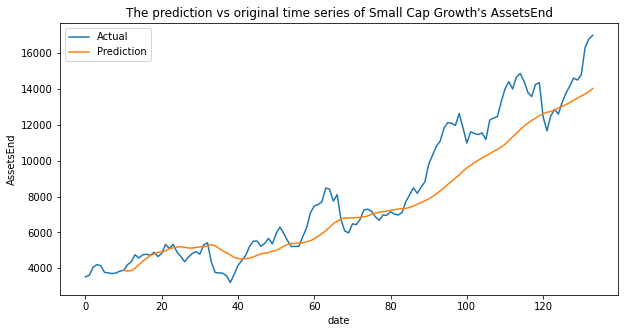

The MSE of the Small Cap Growth AssetsEnd time series prediction is 2096678.4502460659.
The Small Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5238297872340425.
The Small Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.5121212121212122.
The Small Cap Growth AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.4666666666666667.


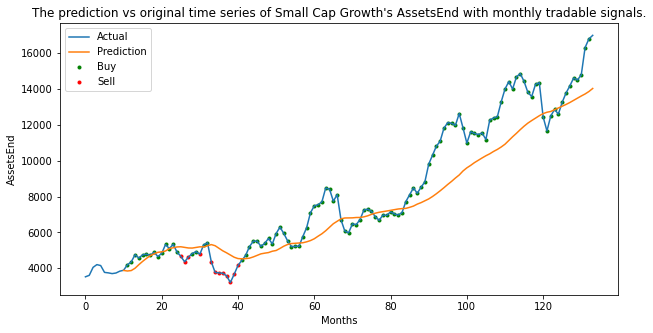

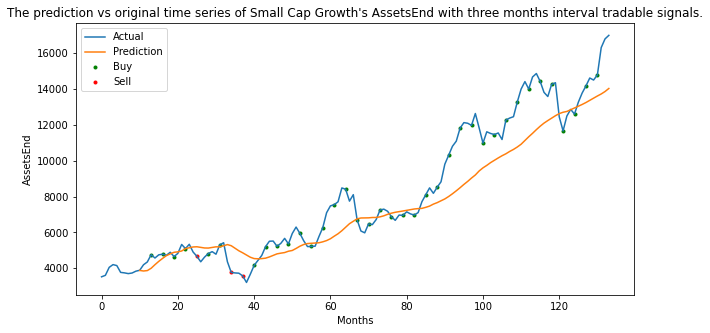

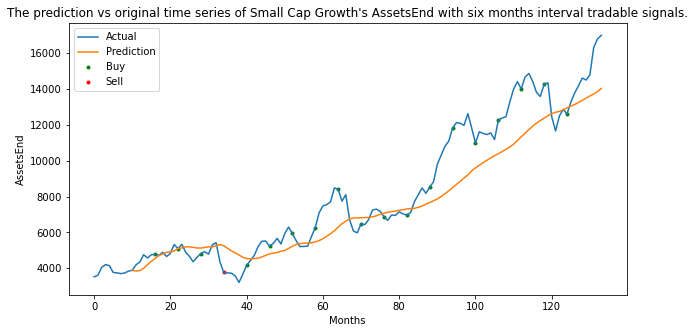

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


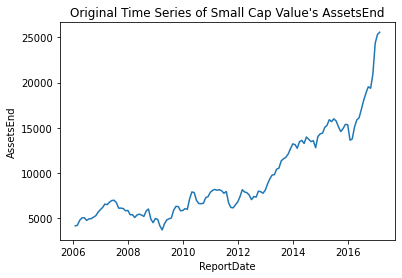

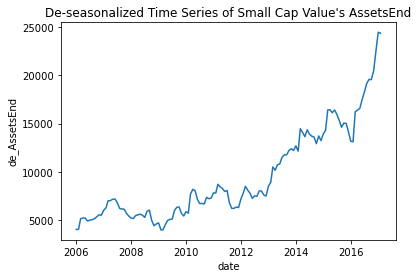

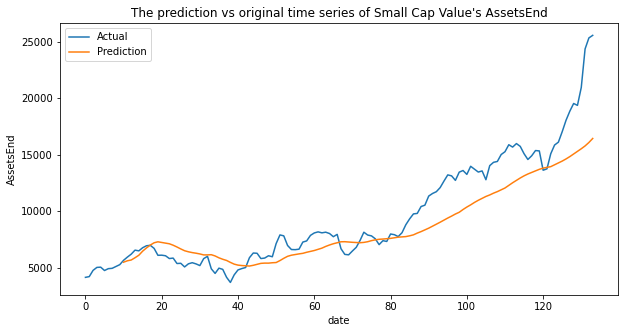

The MSE of the Small Cap Value AssetsEnd time series prediction is 4848605.346434041.
The Small Cap Value AssetsEnd one month interval prediction's accuracy is 0.5772357723577236. The AUC score is 0.510354609929078.
The Small Cap Value AssetsEnd three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.585978835978836.
The Small Cap Value AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.6309523809523809.


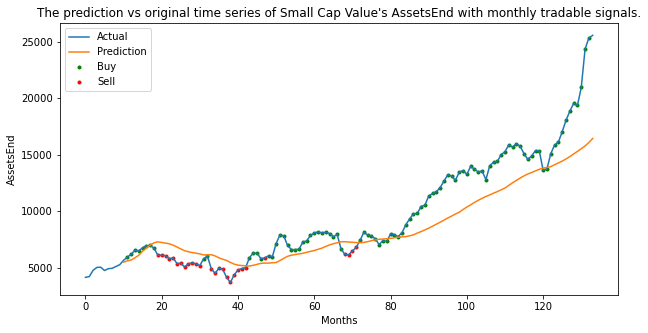

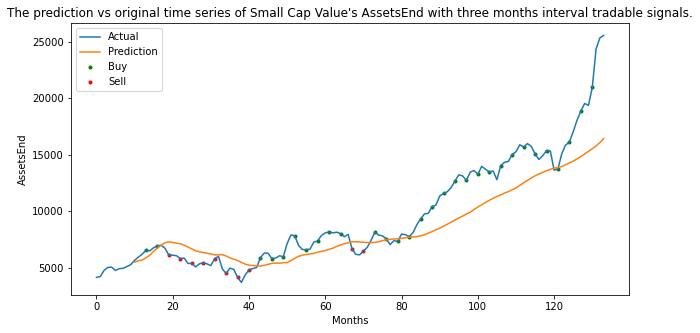

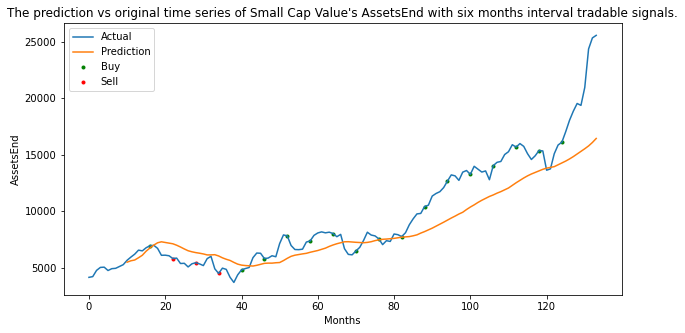

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


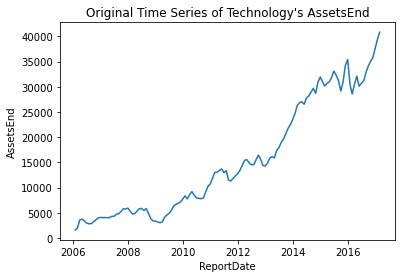

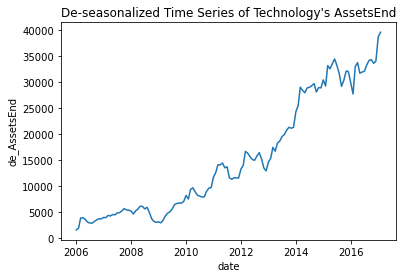

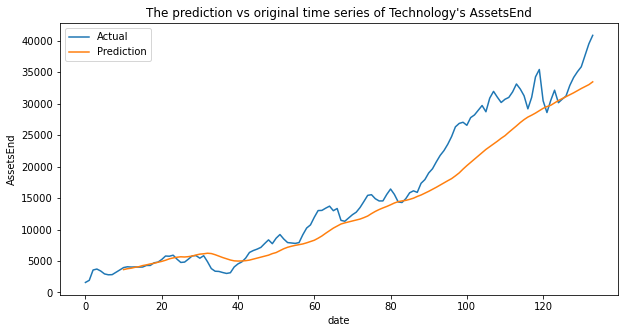

The MSE of the Technology AssetsEnd time series prediction is 12329211.453943862.
The Technology AssetsEnd one month interval prediction's accuracy is 0.7154471544715447. The AUC score is 0.546188630490956.
The Technology AssetsEnd three months interval prediction's accuracy is 0.8048780487804879. The AUC score is 0.5954861111111112.
The Technology AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.46875.


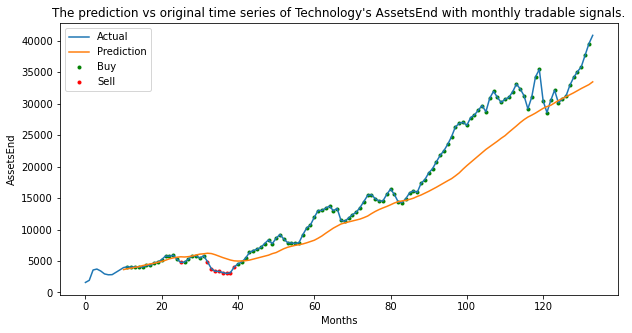

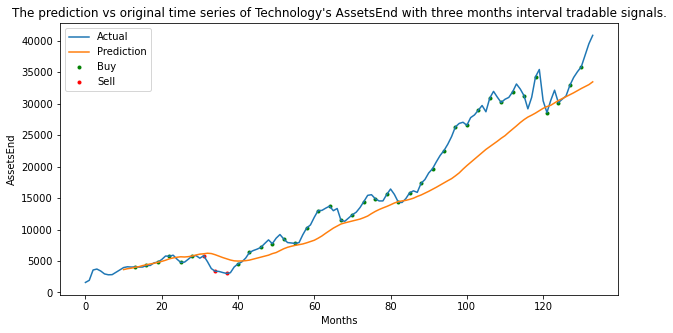

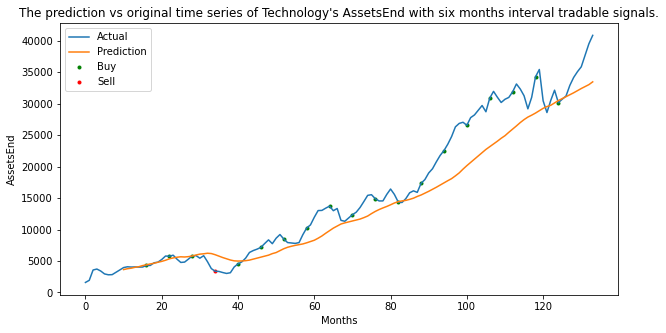

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


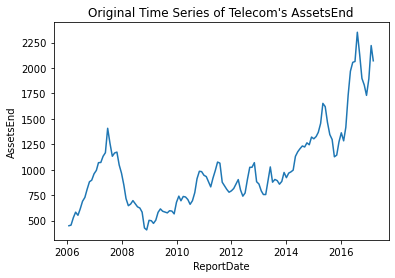

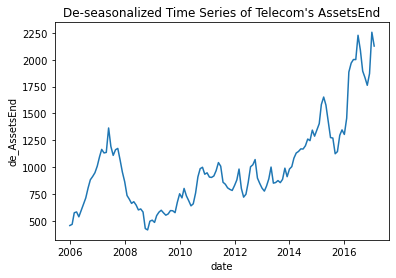

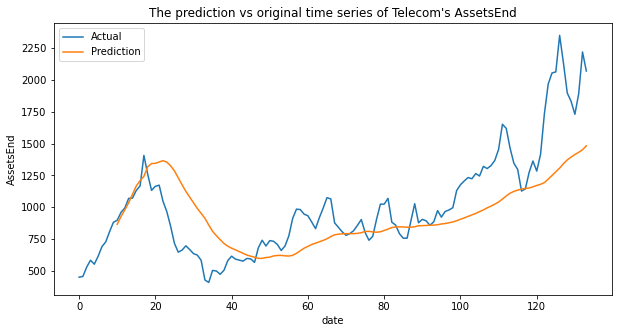

The MSE of the Telecom AssetsEnd time series prediction is 92526.9375984796.
The Telecom AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5499058380414312.
The Telecom AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5579710144927537.
The Telecom AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.6212121212121212.


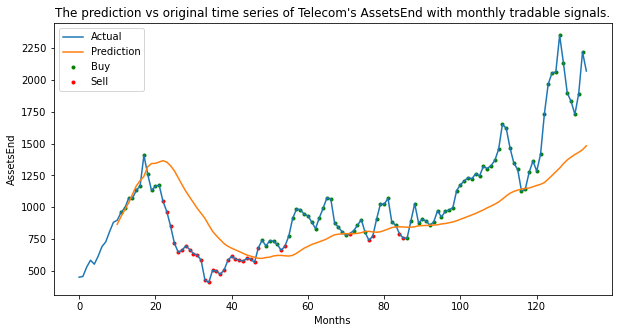

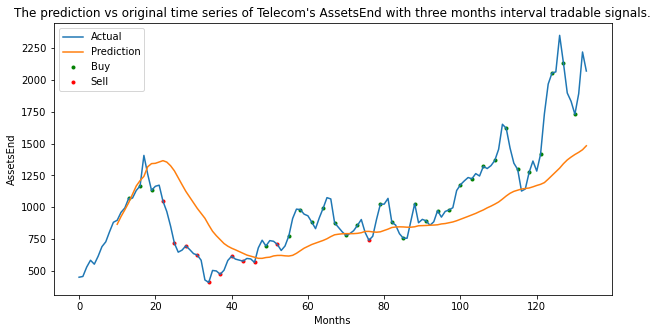

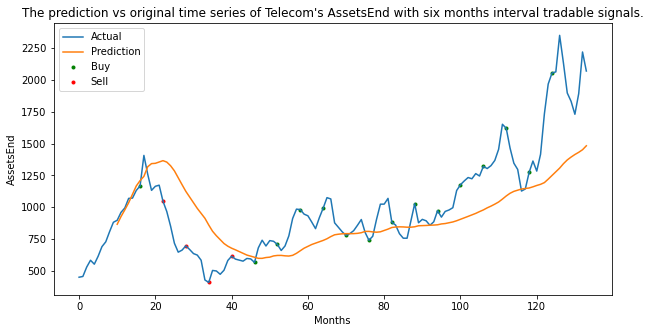

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


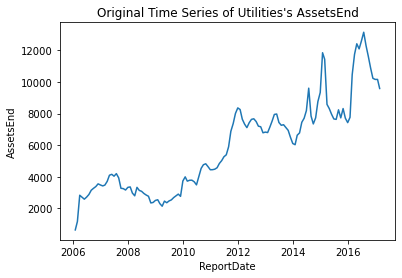

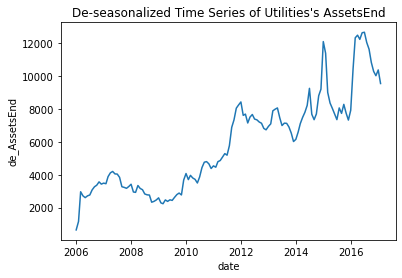

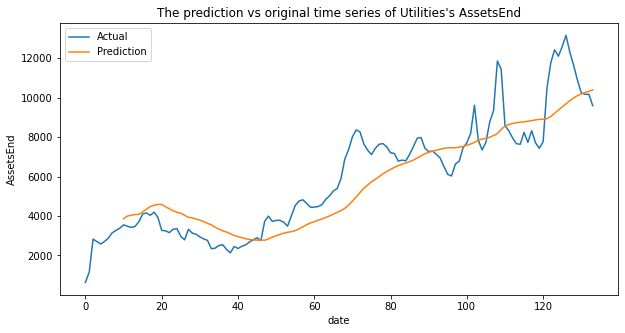

The MSE of the Utilities AssetsEnd time series prediction is 1758965.4119733488.
The Utilities AssetsEnd one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5228070175438597.
The Utilities AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5519323671497585.
The Utilities AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.6000000000000001.


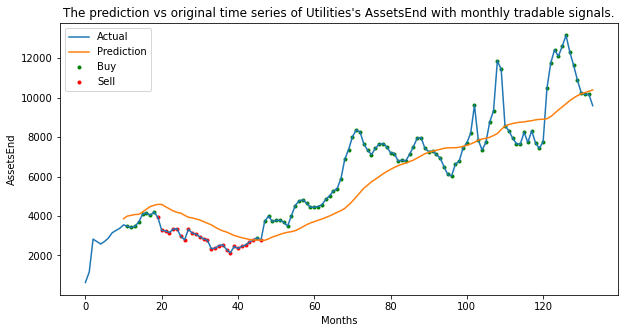

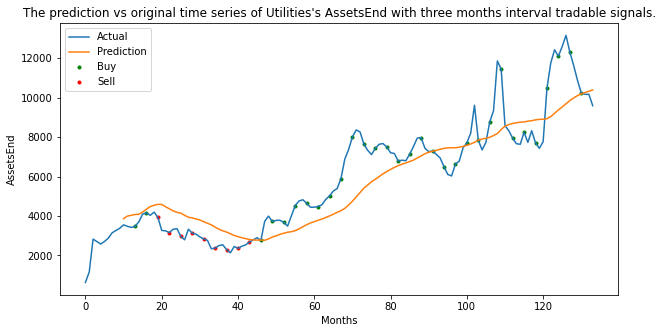

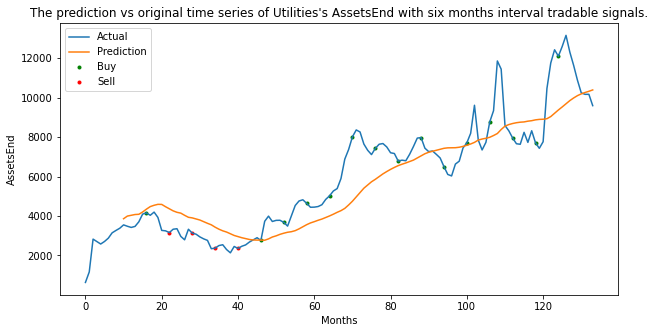

In [74]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'ETF', target = 'AssetsEnd')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

ETF_AssetsEnd = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [75]:
ETF_AssetsEnd

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,1.470587e+06,0.577236,0.541948,0.634146,0.587500,0.65,0.566667,54,31,21,17,20,10,5,6,11,3,4,2
1,Consumer Goods,1.371557e+07,0.650407,0.505721,0.731707,0.528788,0.80,0.600000,77,38,5,3,29,10,1,1,15,4,0,1
2,Energy,2.647876e+07,0.609756,0.523455,0.707317,0.579670,0.65,0.406250,68,39,9,7,26,10,2,3,13,4,3,0
3,Financials,3.534899e+07,0.560976,0.471110,0.731707,0.508681,0.90,0.750000,65,43,11,4,29,8,3,1,16,2,0,2
4,Health Care/Biotech,5.076275e+07,0.609756,0.520396,0.682927,0.570106,0.70,0.547619,67,37,11,8,25,11,2,3,13,5,1,1
5,Industrials,4.193728e+06,0.560976,0.481419,0.585366,0.475641,0.70,0.547619,62,42,12,7,23,14,3,1,13,5,1,1
6,Large Cap Blend,3.538437e+09,0.617886,0.478221,0.731707,0.517742,0.90,0.666667,73,37,10,3,29,9,2,1,17,2,0,1
7,Large Cap Growth,1.085933e+08,0.666667,0.528730,0.780488,0.579861,0.65,0.433333,76,33,8,6,30,7,2,2,13,5,2,0
8,Large Cap Value,1.831616e+08,0.674797,0.560373,0.756098,0.603030,0.80,0.607843,74,32,8,9,28,8,2,3,15,2,2,1
9,Mid Cap Blend,6.805939e+07,0.609756,0.508333,0.682927,0.519355,0.80,0.666667,68,35,13,7,26,8,5,2,14,3,1,2


In [76]:
ETF_AssetsEnd.to_csv('Etf_AssetsEnd.csv')

#### INS AssetsEnd

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


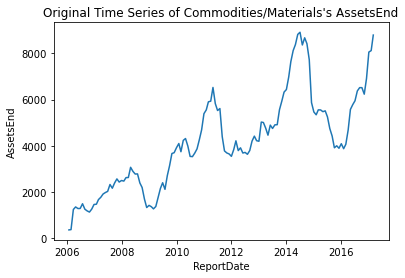

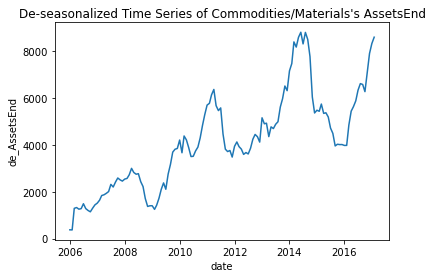

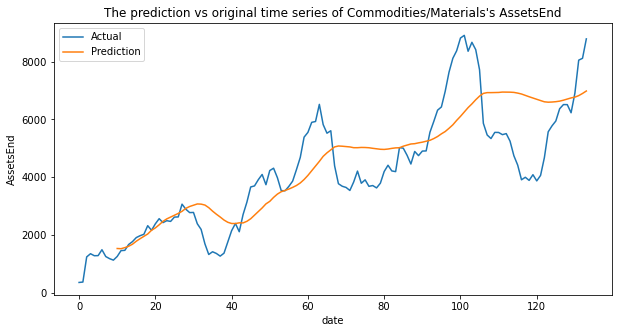

The MSE of the Commodities/Materials AssetsEnd time series prediction is 1546950.462490423.
The Commodities/Materials AssetsEnd one month interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.545045045045045.
The Commodities/Materials AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5705128205128205.
The Commodities/Materials AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.4666666666666667.


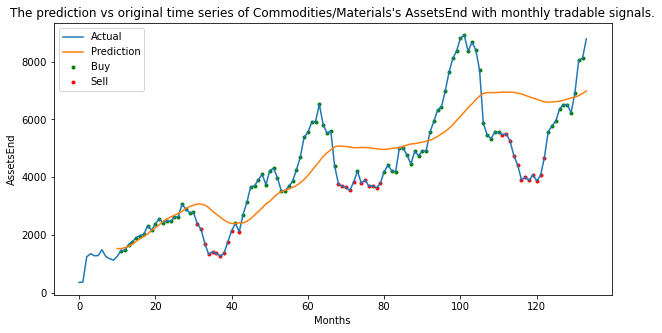

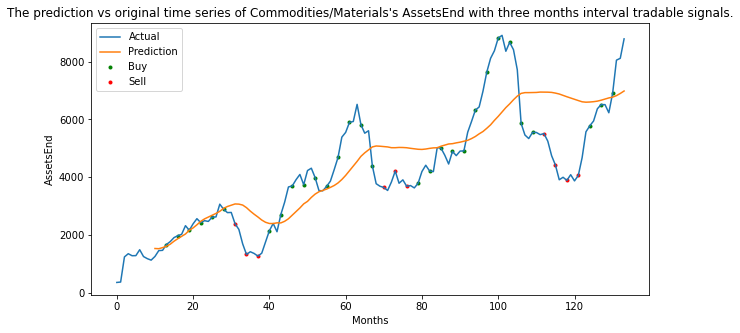

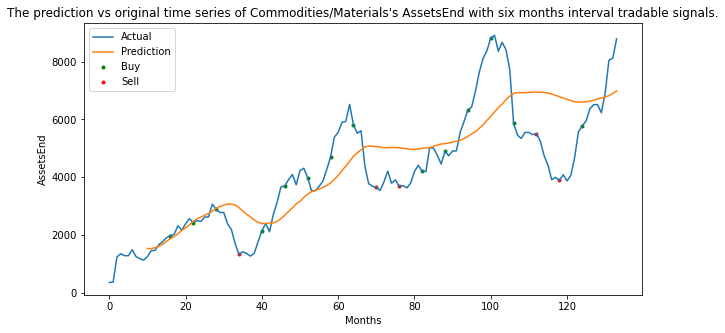

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


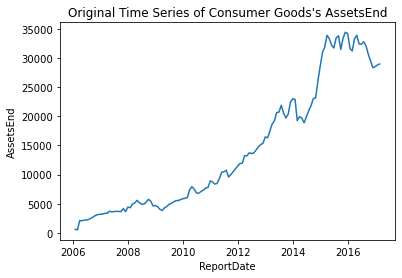

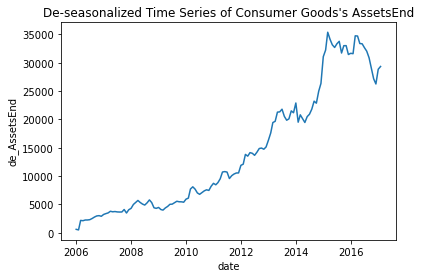

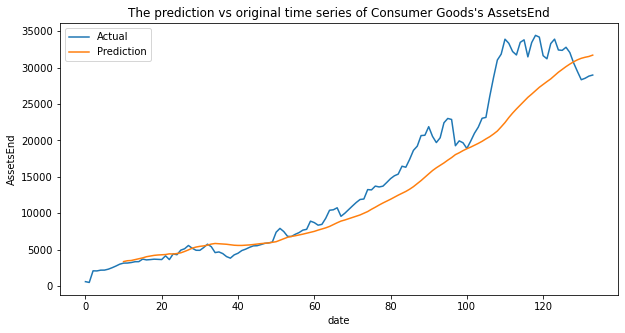

The MSE of the Consumer Goods AssetsEnd time series prediction is 13715571.837212117.
The Consumer Goods AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.5057211683227942.
The Consumer Goods AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5287878787878788.
The Consumer Goods AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.6.


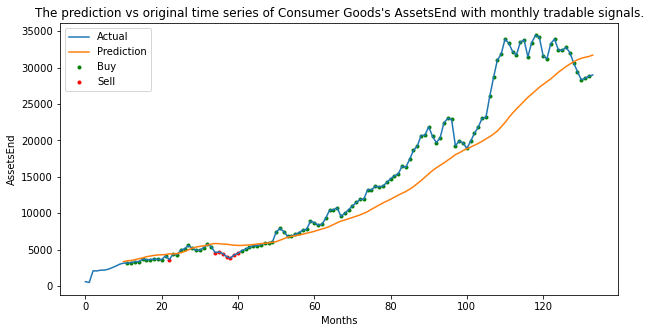

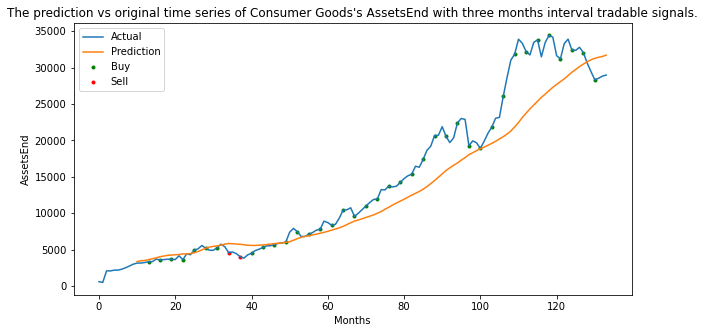

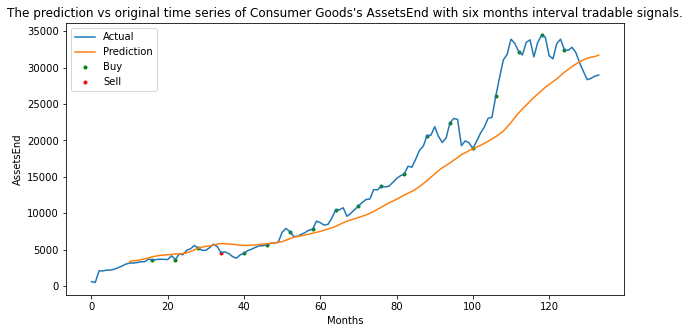

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


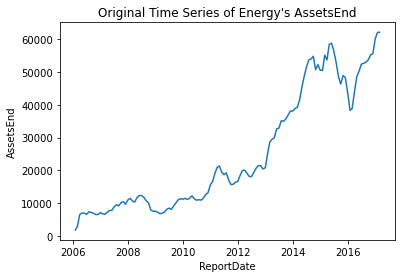

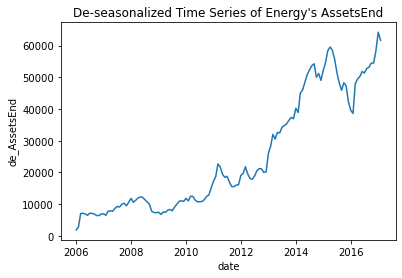

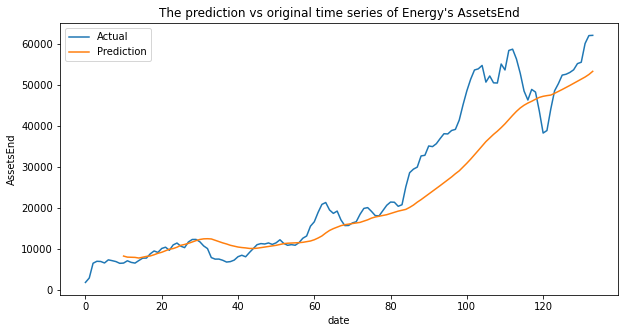

The MSE of the Energy AssetsEnd time series prediction is 54437438.615799546.
The Energy AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.535983137609154.
The Energy AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5701058201058201.
The Energy AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.4117647058823529.


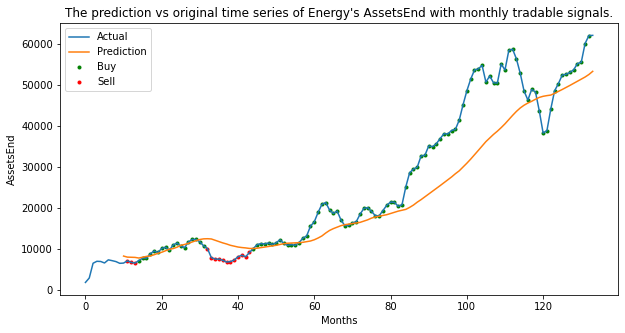

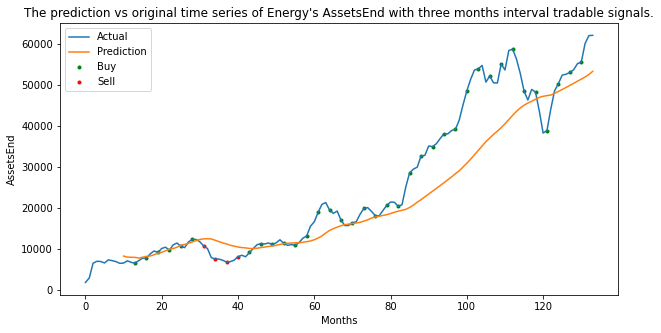

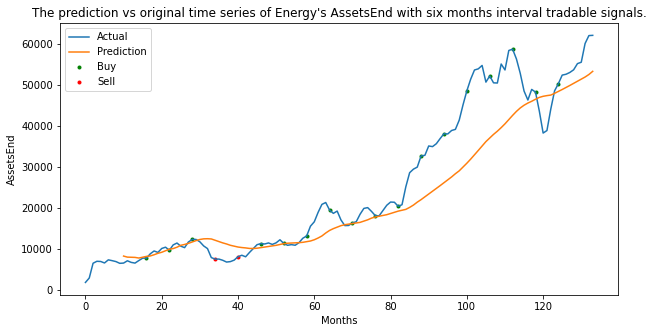

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


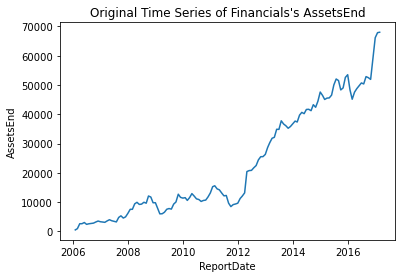

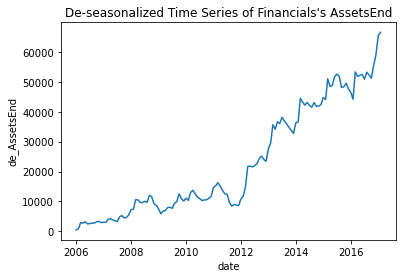

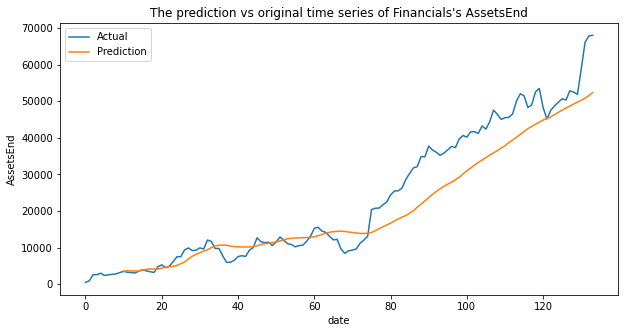

The MSE of the Financials AssetsEnd time series prediction is 40530185.69332308.
The Financials AssetsEnd one month interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.4768913747424198.
The Financials AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5086805555555556.
The Financials AssetsEnd six months interval prediction's accuracy is 0.9. The AUC score is 0.75.


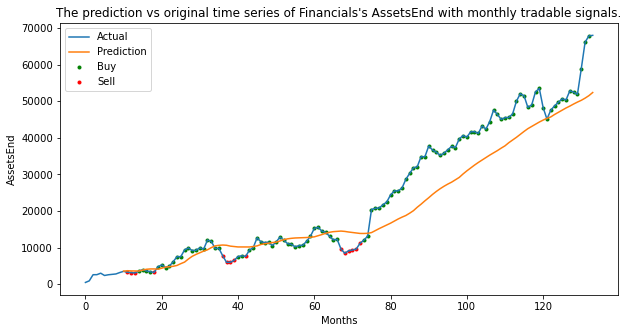

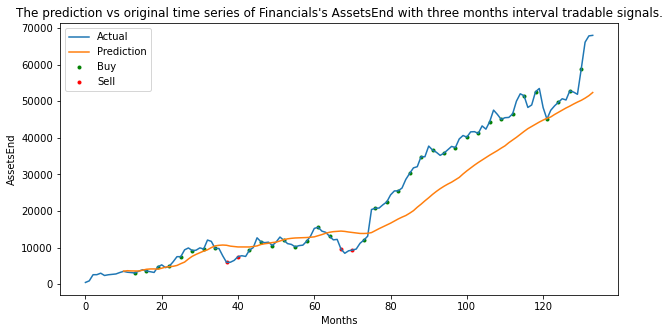

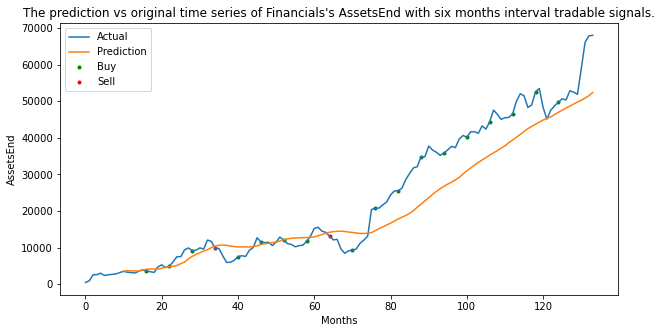

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


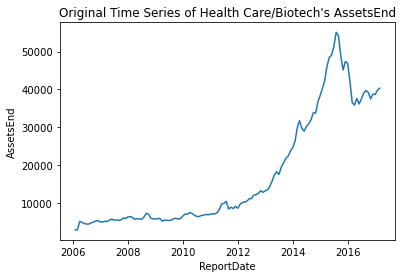

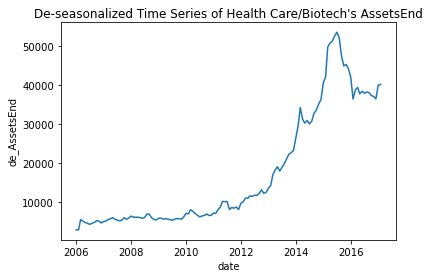

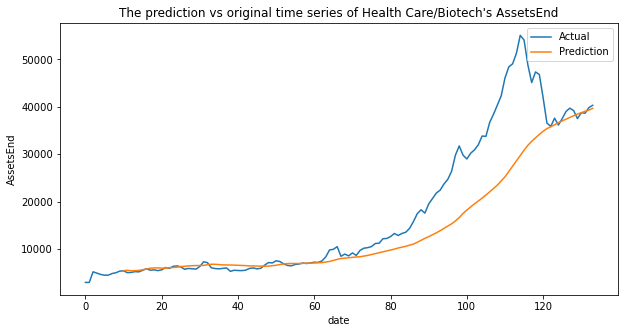

The MSE of the Health Care/Biotech AssetsEnd time series prediction is 60122318.98707969.
The Health Care/Biotech AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5083333333333333.
The Health Care/Biotech AssetsEnd three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.5233516483516484.
The Health Care/Biotech AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.5666666666666667.


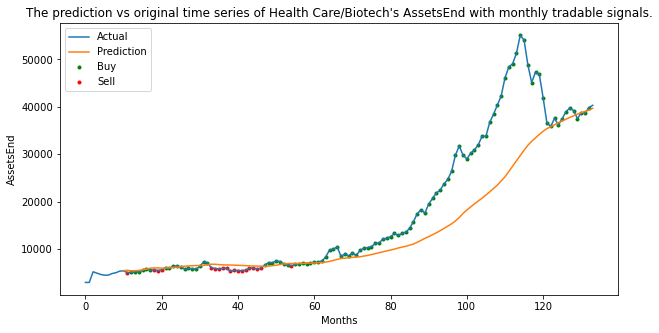

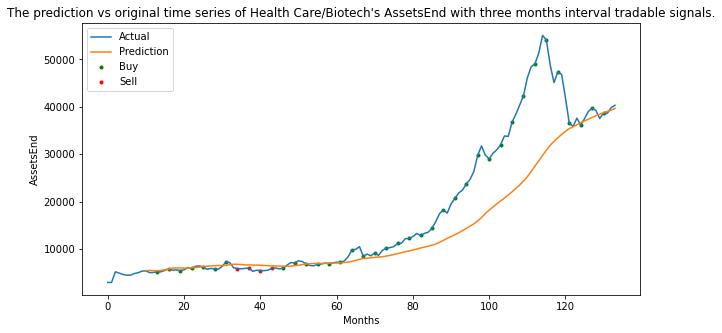

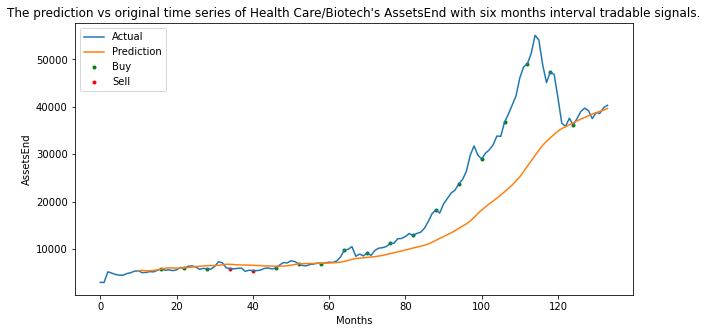

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


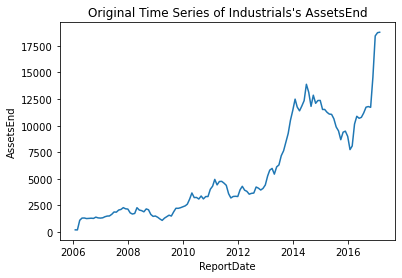

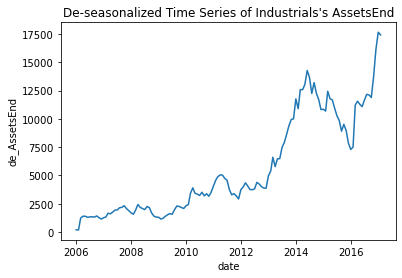

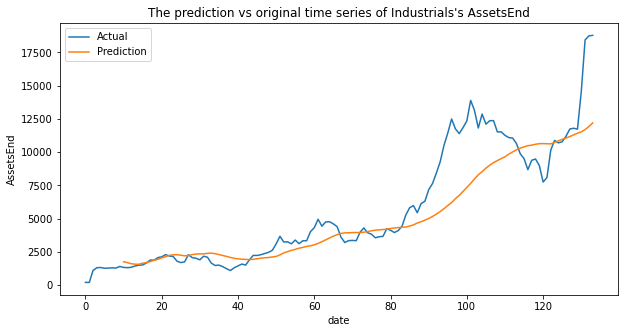

The MSE of the Industrials AssetsEnd time series prediction is 4193727.8972478984.
The Industrials AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.4814189189189189.
The Industrials AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.4756410256410256.
The Industrials AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.5476190476190476.


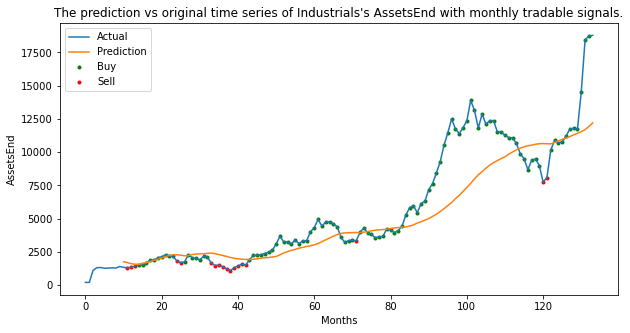

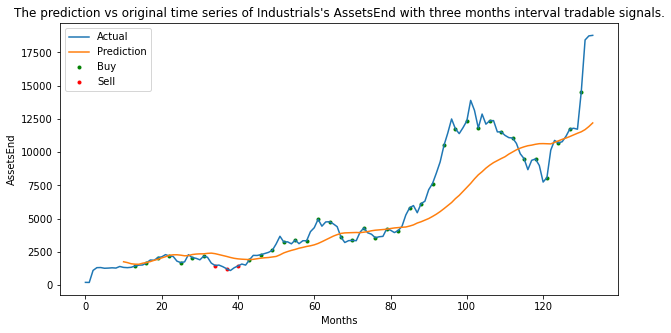

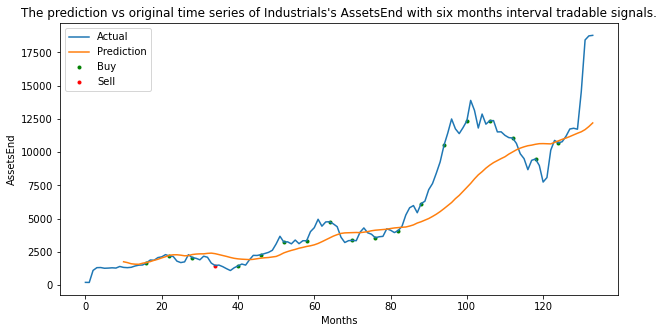

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


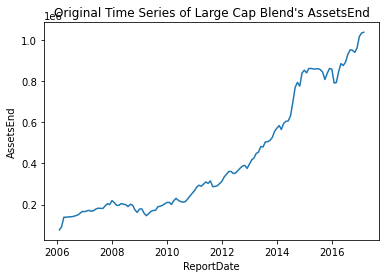

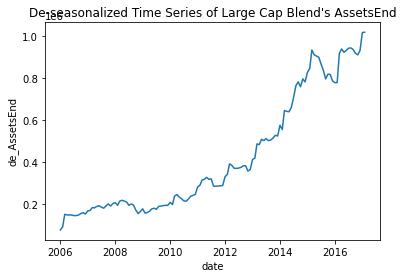

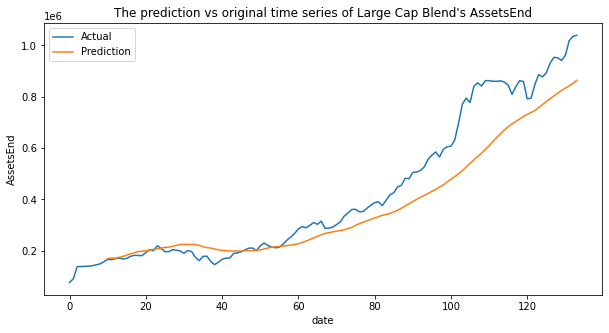

The MSE of the Large Cap Blend AssetsEnd time series prediction is 11988419151.16377.
The Large Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.5011128775834659.
The Large Cap Blend AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5575757575757576.
The Large Cap Blend AssetsEnd six months interval prediction's accuracy is 0.85. The AUC score is 0.6944444444444444.


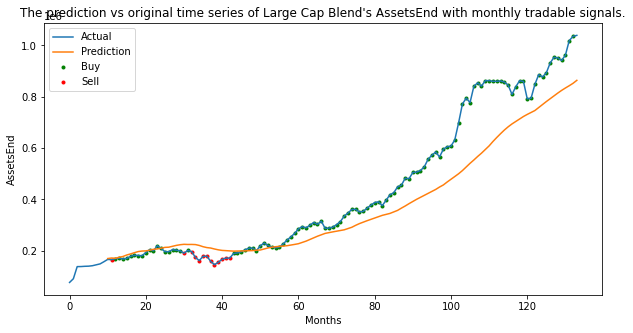

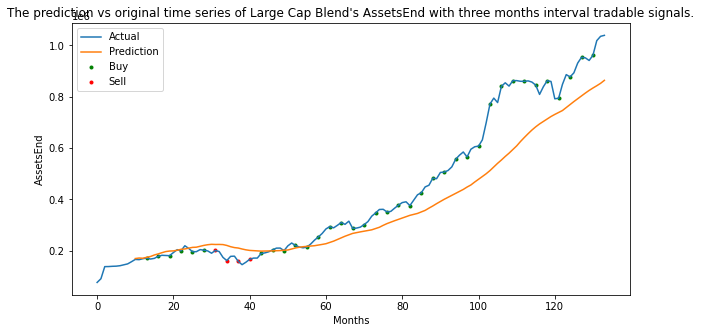

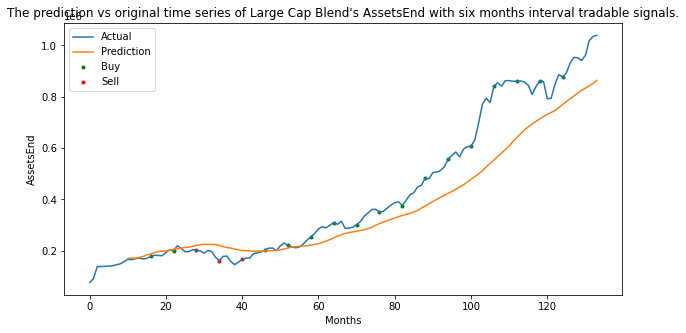

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


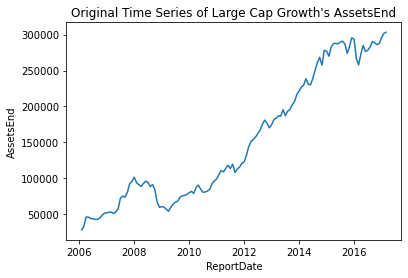

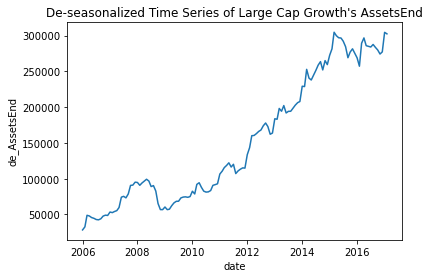

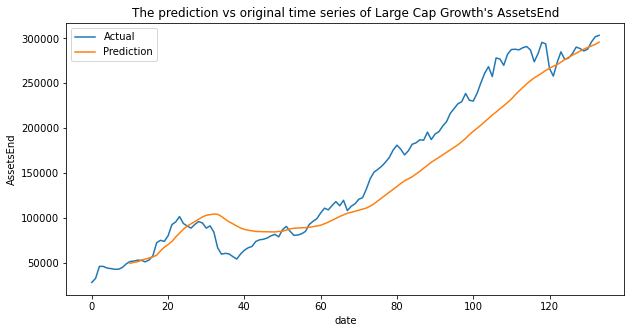

The MSE of the Large Cap Growth AssetsEnd time series prediction is 804464305.9023045.
The Large Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6422764227642277. The AUC score is 0.50031328320802.
The Large Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5516129032258065.
The Large Cap Growth AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.4444444444444444.


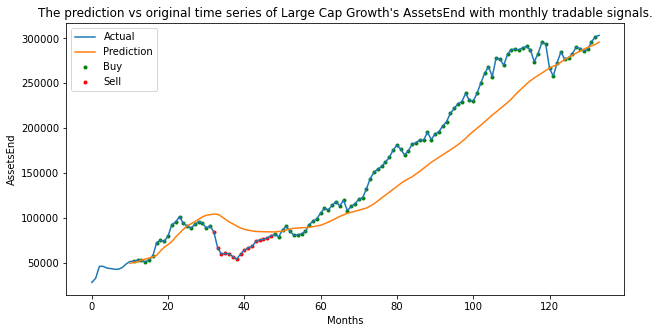

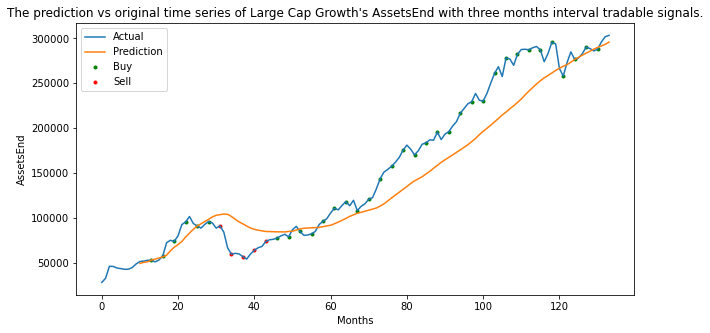

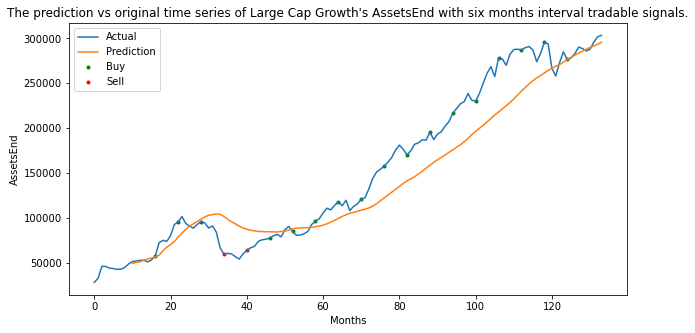

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


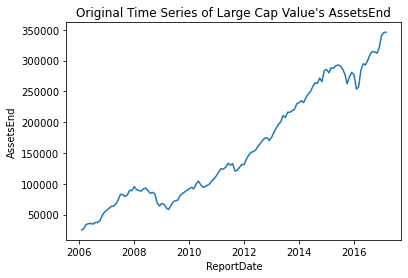

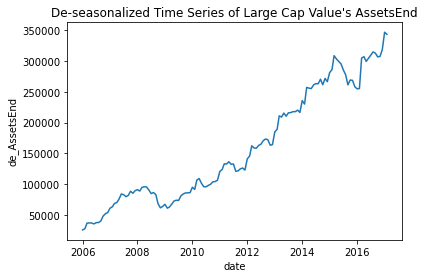

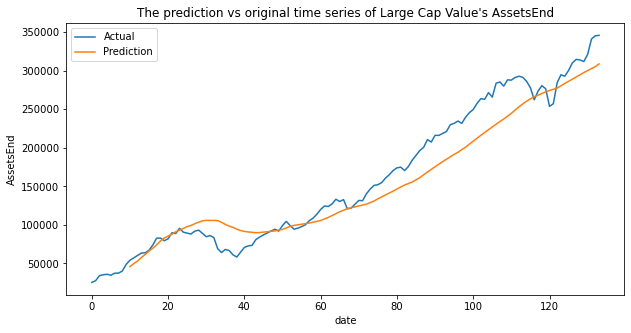

The MSE of the Large Cap Value AssetsEnd time series prediction is 669328699.3027344.
The Large Cap Value AssetsEnd one month interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5263910969793322.
The Large Cap Value AssetsEnd three months interval prediction's accuracy is 0.8048780487804879. The AUC score is 0.5946969696969697.
The Large Cap Value AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.607843137254902.


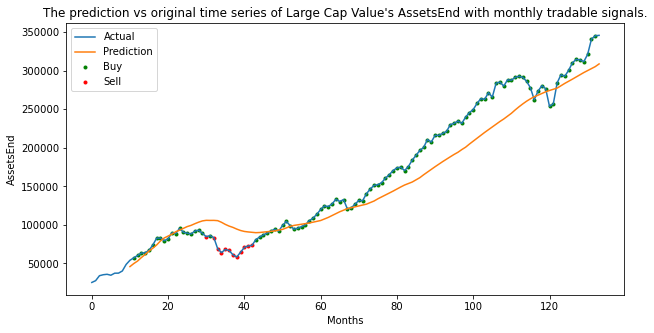

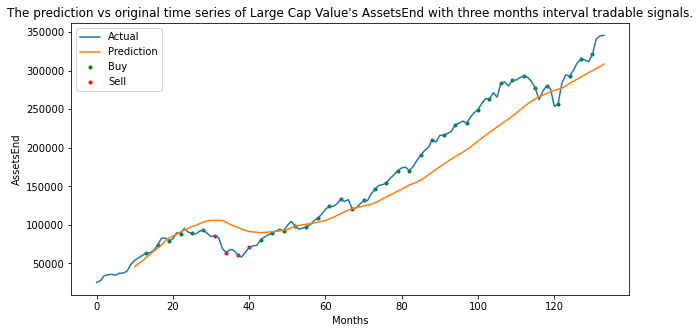

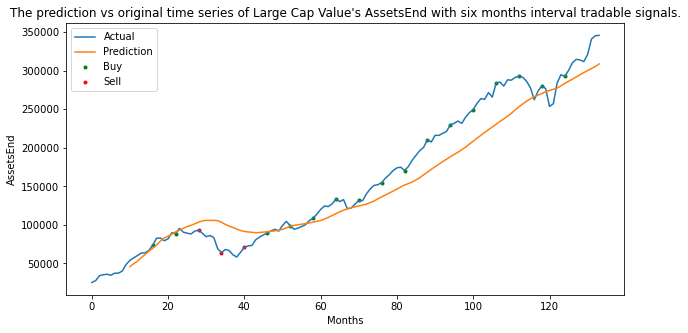

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


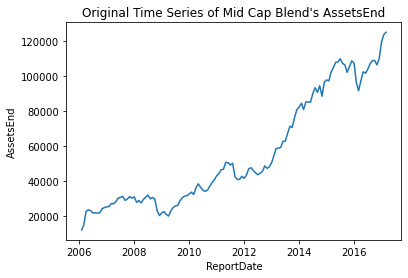

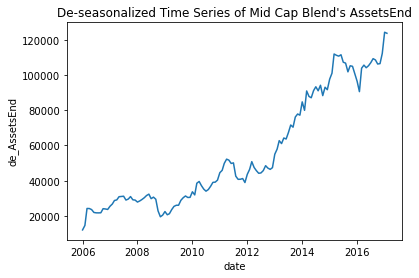

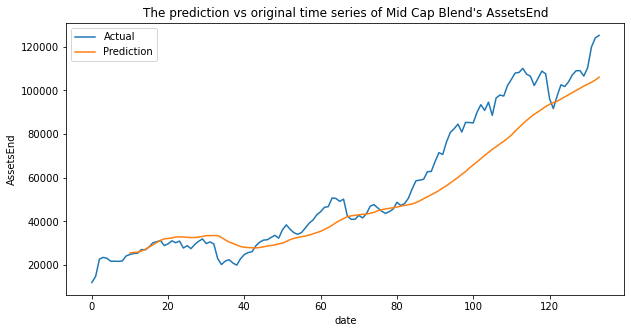

The MSE of the Mid Cap Blend AssetsEnd time series prediction is 139560672.5656957.
The Mid Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.5201219512195122.
The Mid Cap Blend AssetsEnd three months interval prediction's accuracy is 0.7560975609756098. The AUC score is 0.5642361111111112.
The Mid Cap Blend AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.607843137254902.


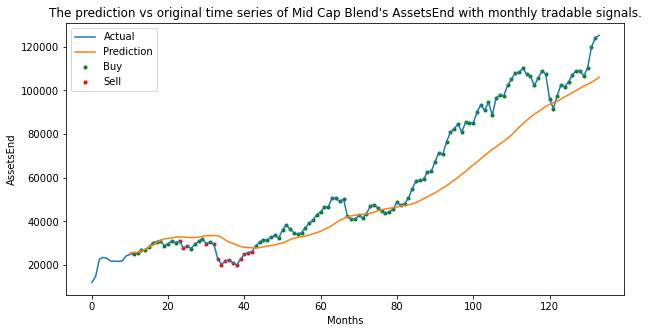

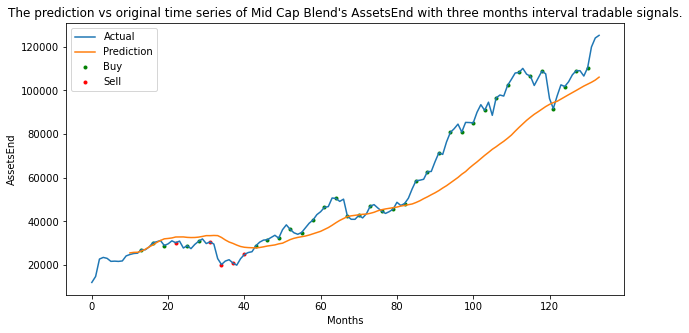

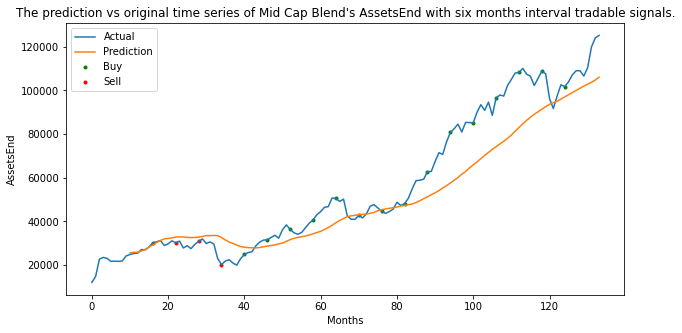

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


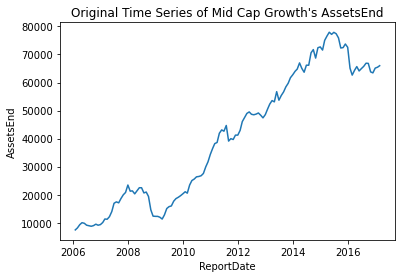

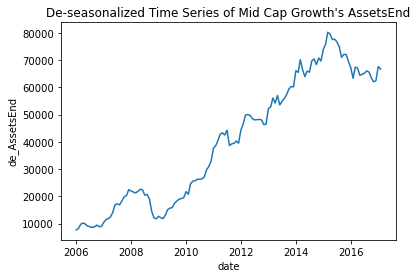

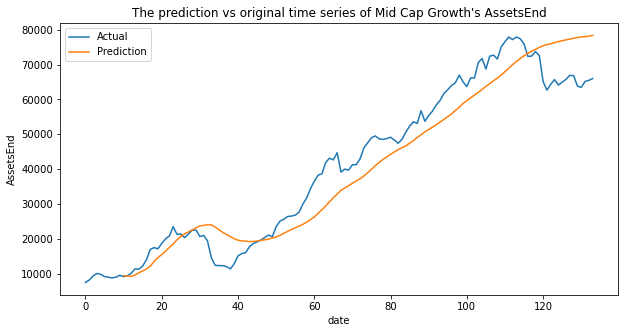

The MSE of the Mid Cap Growth AssetsEnd time series prediction is 50264618.674308784.
The Mid Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6747967479674797. The AUC score is 0.5407784986098239.
The Mid Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.5488505747126436.
The Mid Cap Growth AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.42857142857142855.


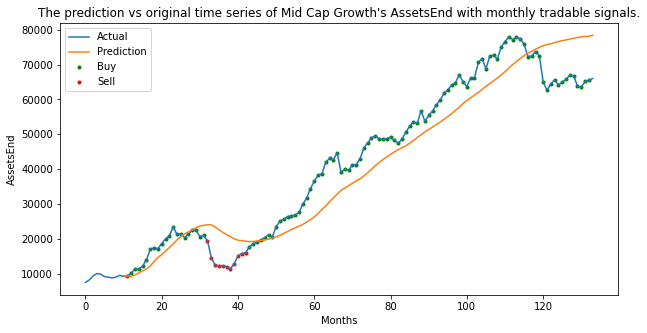

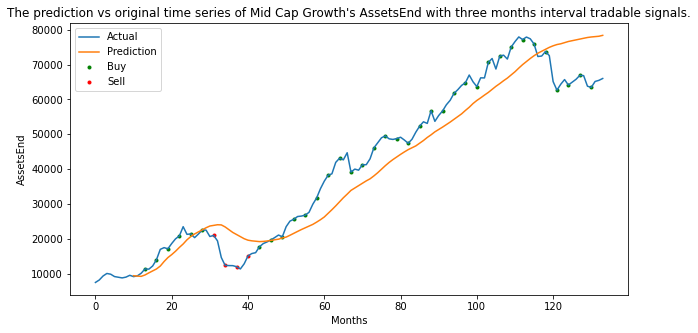

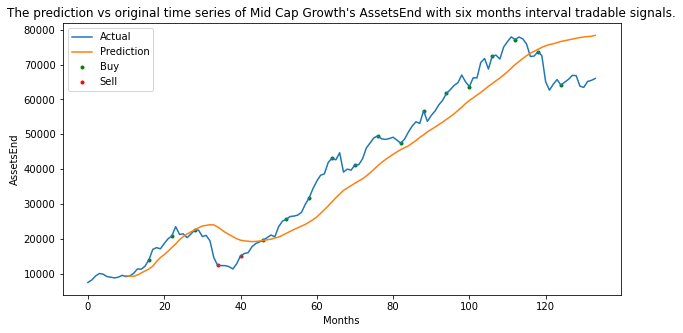

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


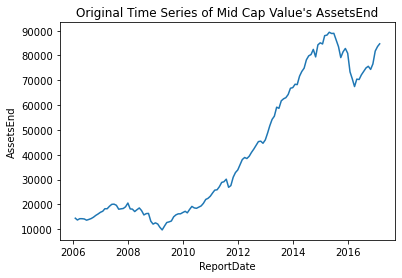

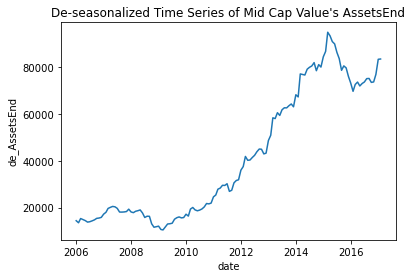

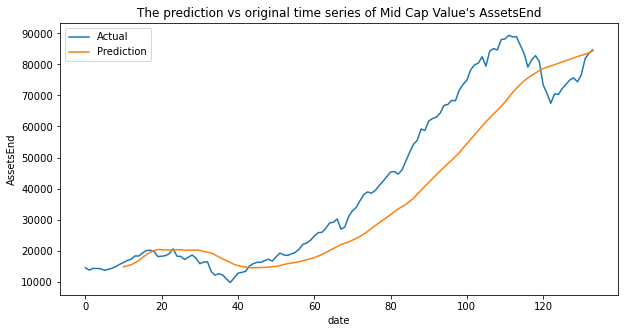

The MSE of the Mid Cap Value AssetsEnd time series prediction is 130768762.93807703.
The Mid Cap Value AssetsEnd one month interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5425604358188627.
The Mid Cap Value AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5854838709677419.
The Mid Cap Value AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.6333333333333333.


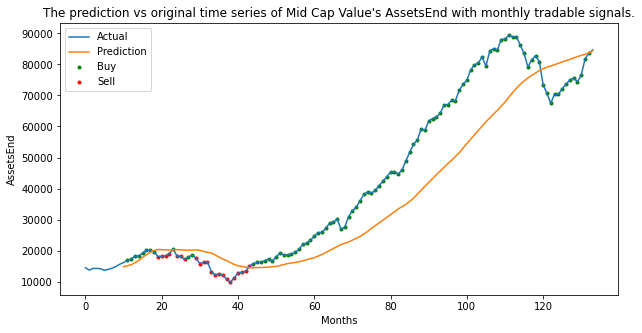

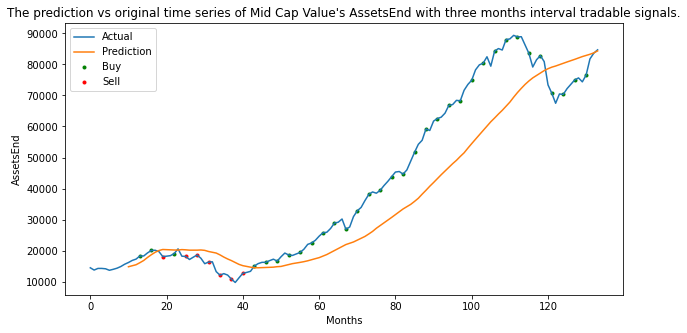

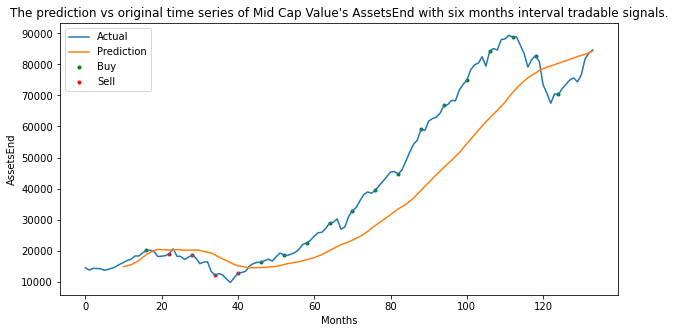

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


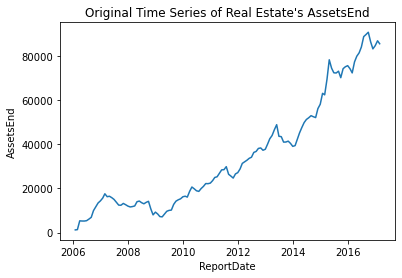

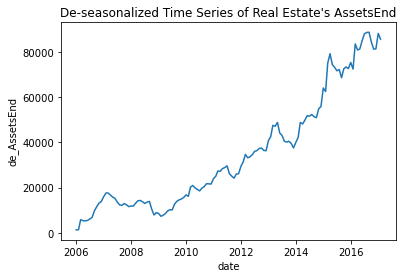

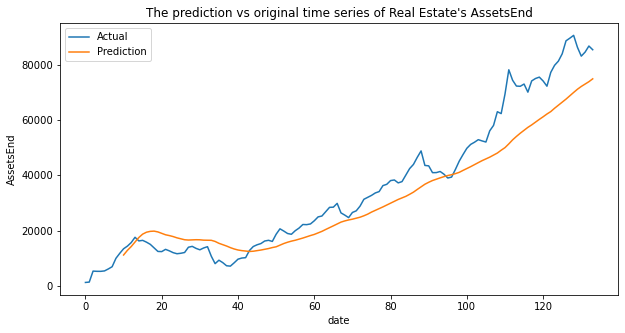

The MSE of the Real Estate AssetsEnd time series prediction is 83946213.1023195.
The Real Estate AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.555952380952381.
The Real Estate AssetsEnd three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.5977011494252873.
The Real Estate AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.65625.


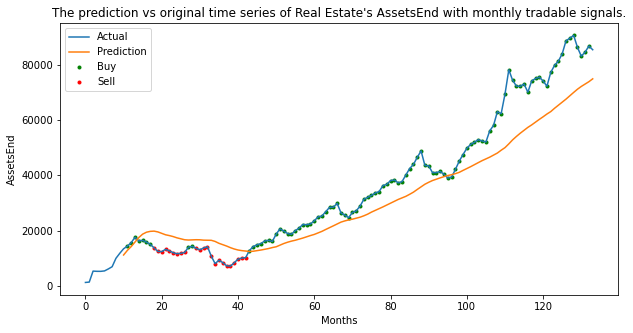

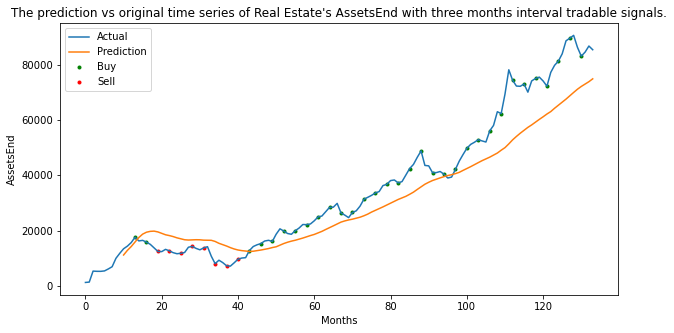

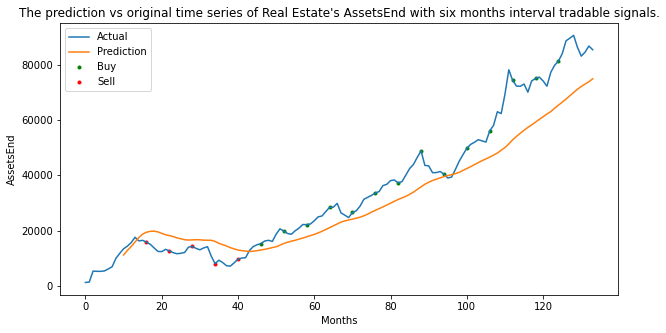

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


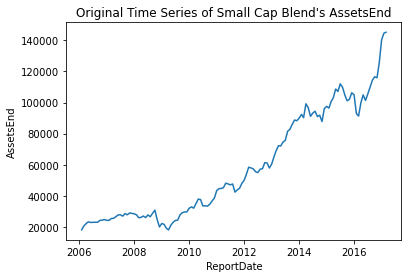

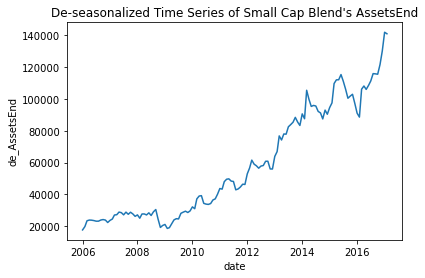

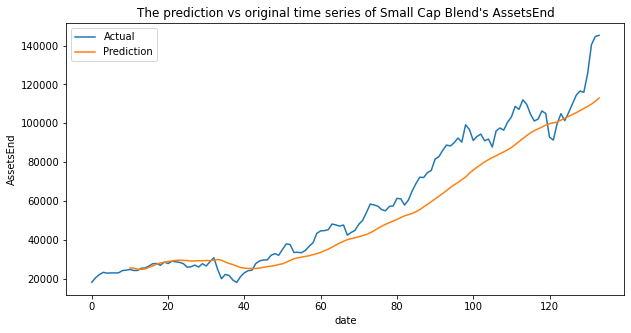

The MSE of the Small Cap Blend AssetsEnd time series prediction is 131089668.90273055.
The Small Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5001471886959082.
The Small Cap Blend AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5486111111111112.
The Small Cap Blend AssetsEnd six months interval prediction's accuracy is 0.8. The AUC score is 0.59375.


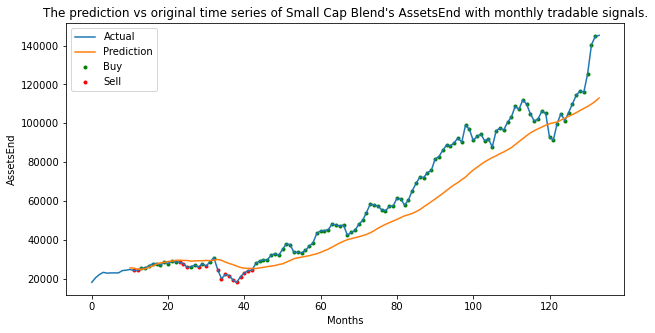

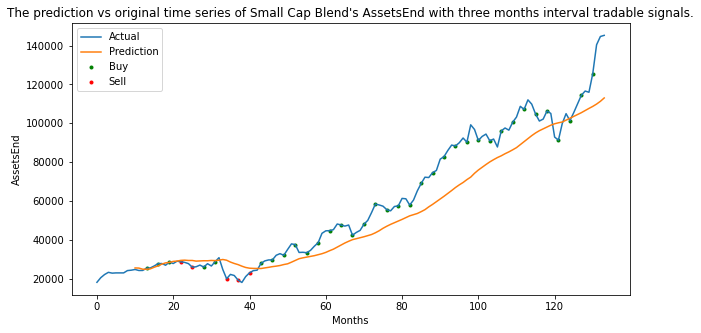

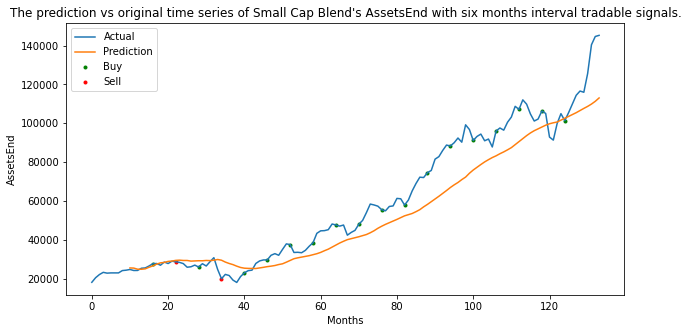

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


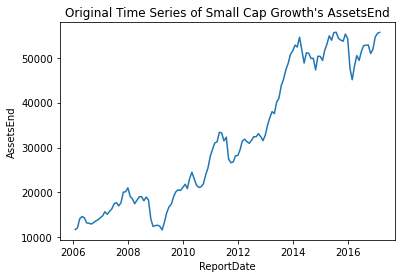

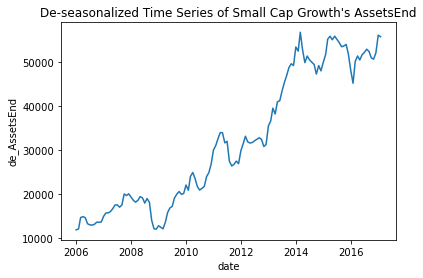

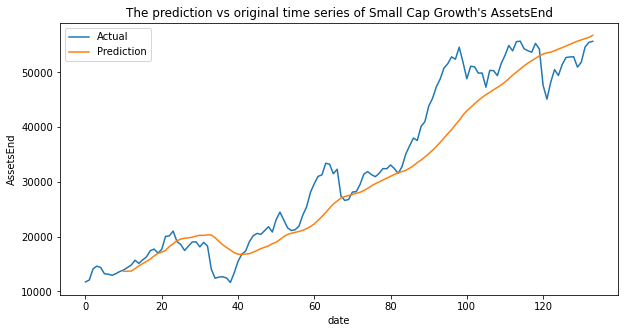

The MSE of the Small Cap Growth AssetsEnd time series prediction is 25307419.2911278.
The Small Cap Growth AssetsEnd one month interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.508536944362673.
The Small Cap Growth AssetsEnd three months interval prediction's accuracy is 0.7317073170731707. The AUC score is 0.5177419354838709.
The Small Cap Growth AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.5666666666666667.


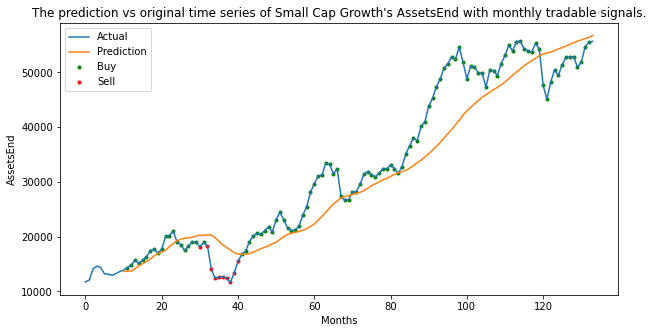

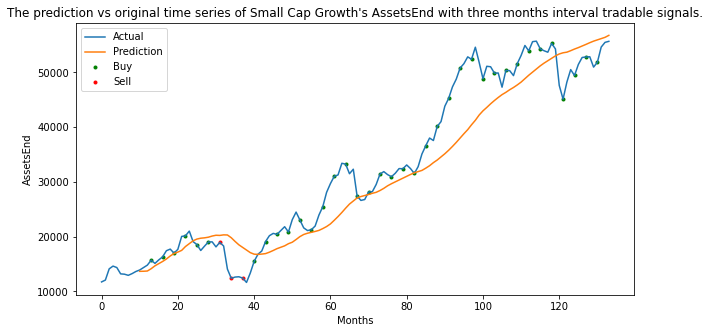

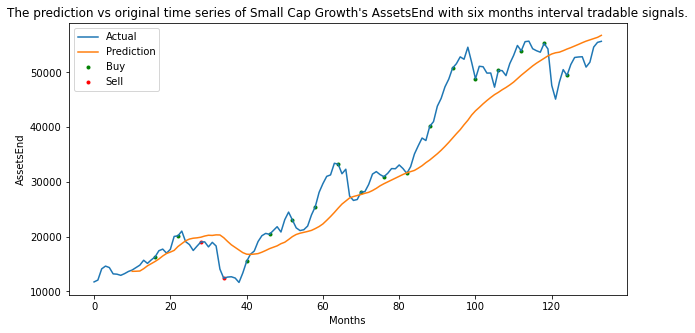

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


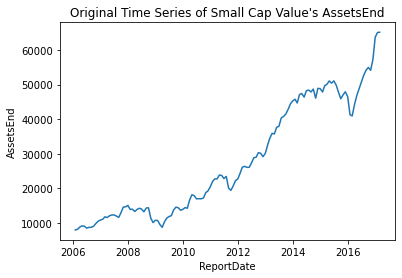

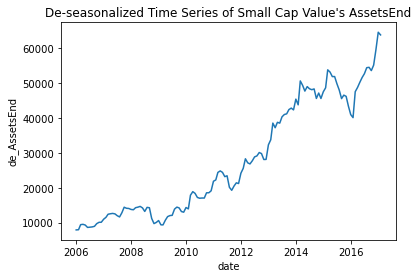

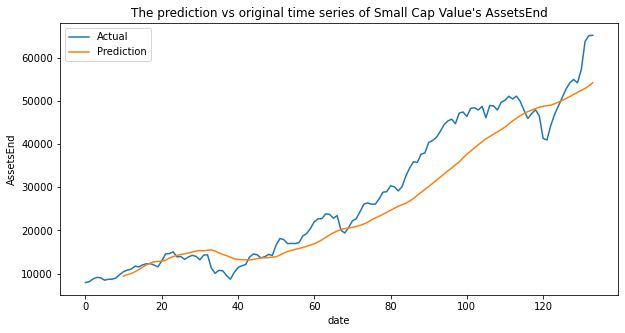

The MSE of the Small Cap Value AssetsEnd time series prediction is 28203168.716362882.
The Small Cap Value AssetsEnd one month interval prediction's accuracy is 0.6504065040650406. The AUC score is 0.5073170731707317.
The Small Cap Value AssetsEnd three months interval prediction's accuracy is 0.7560975609756098. The AUC score is 0.567741935483871.
The Small Cap Value AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.46875.


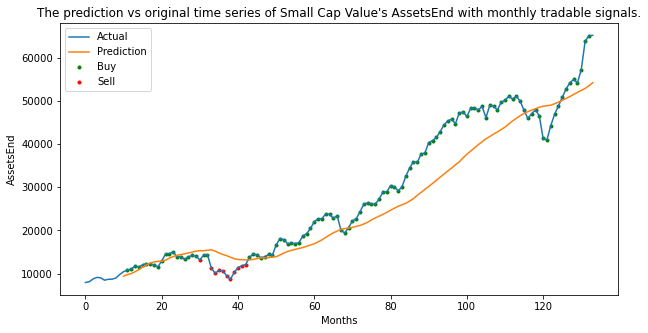

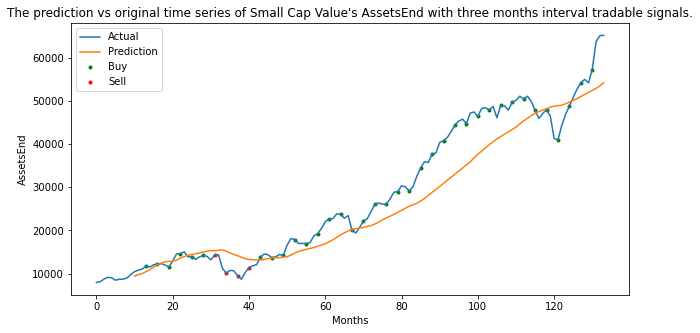

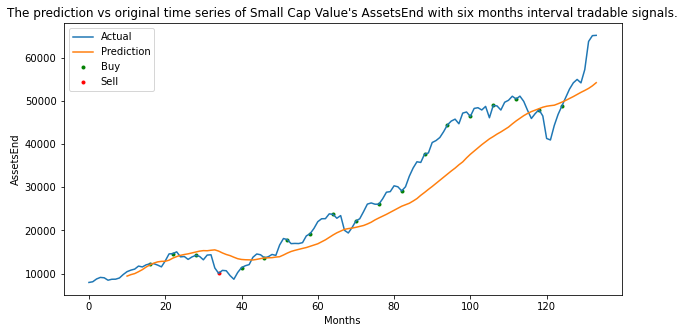

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


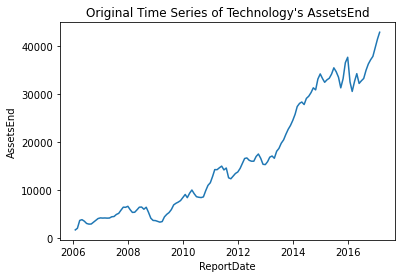

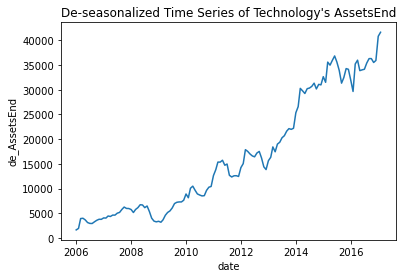

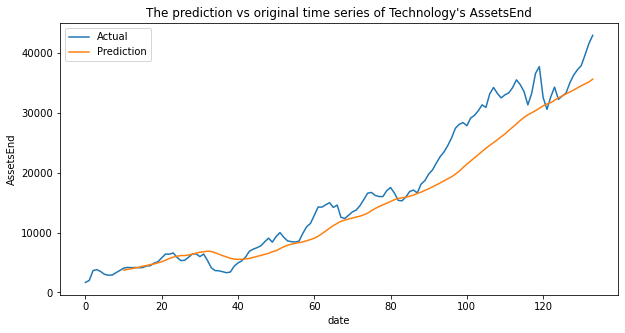

The MSE of the Technology AssetsEnd time series prediction is 13508491.287679564.
The Technology AssetsEnd one month interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.5440381558028616.
The Technology AssetsEnd three months interval prediction's accuracy is 0.7804878048780488. The AUC score is 0.5838709677419355.
The Technology AssetsEnd six months interval prediction's accuracy is 0.75. The AUC score is 0.46875.


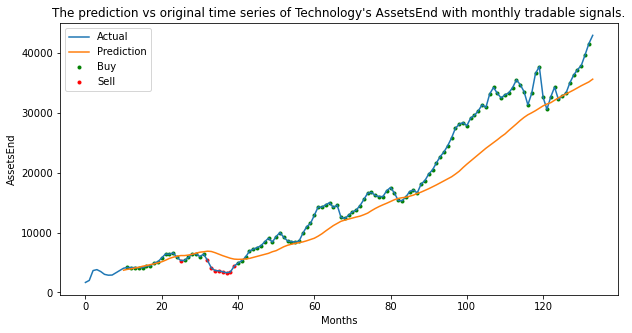

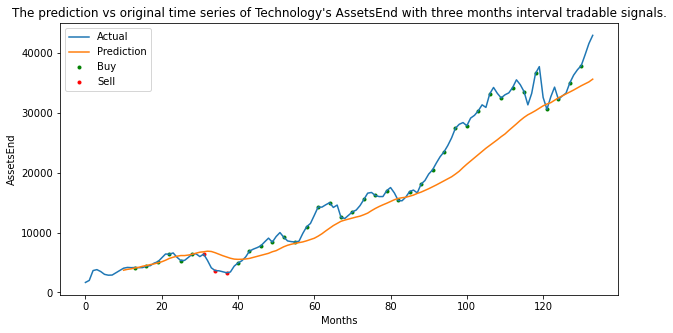

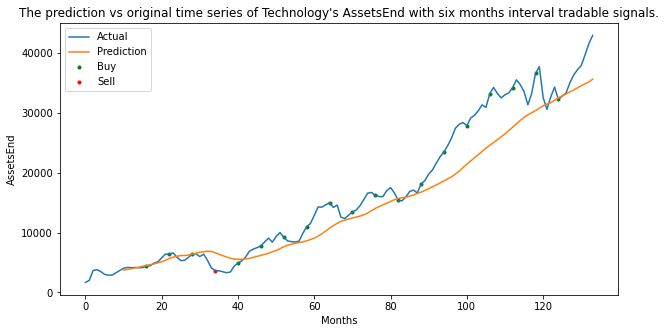

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


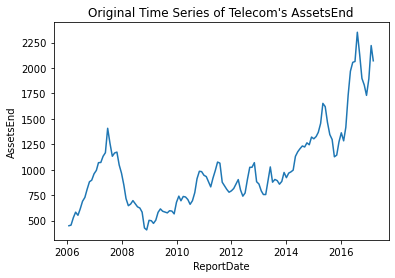

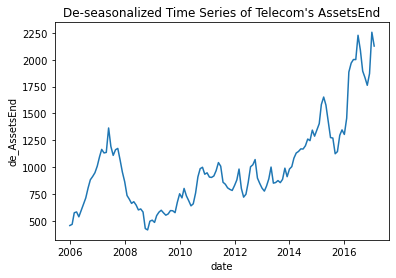

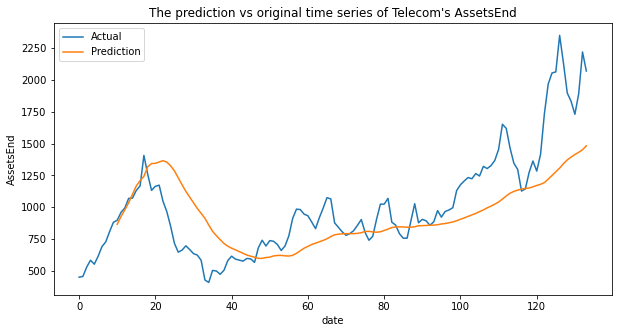

The MSE of the Telecom AssetsEnd time series prediction is 92526.9375984796.
The Telecom AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5499058380414312.
The Telecom AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5579710144927537.
The Telecom AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.6212121212121212.


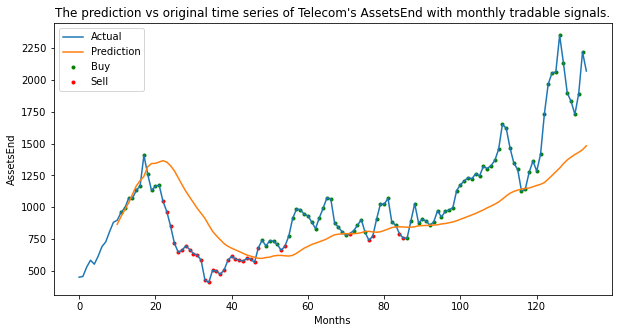

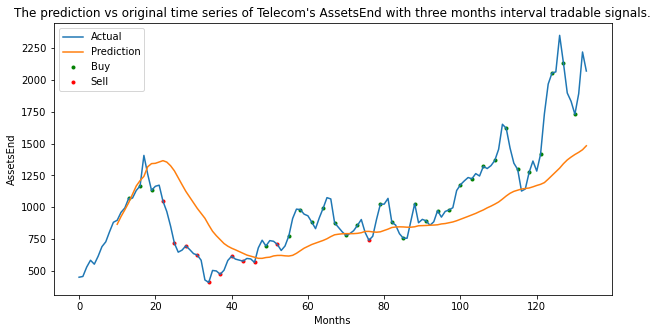

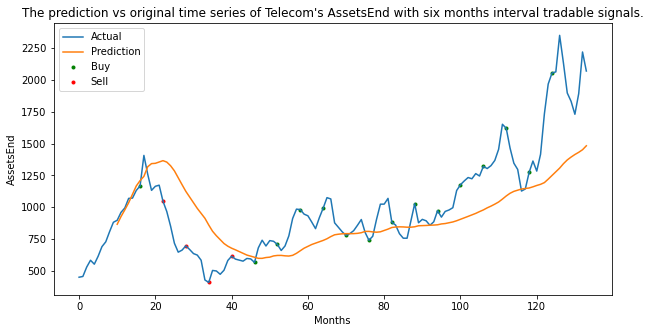

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


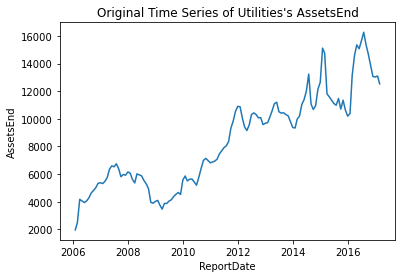

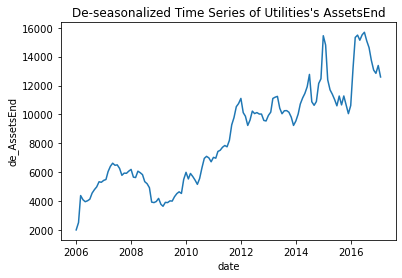

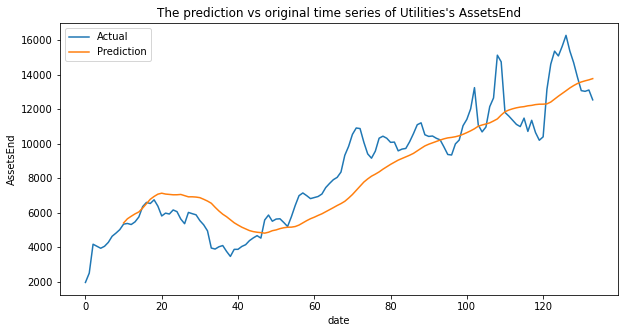

The MSE of the Utilities AssetsEnd time series prediction is 2211256.5892391675.
The Utilities AssetsEnd one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5029850746268656.
The Utilities AssetsEnd three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5519323671497585.
The Utilities AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.5416666666666667.


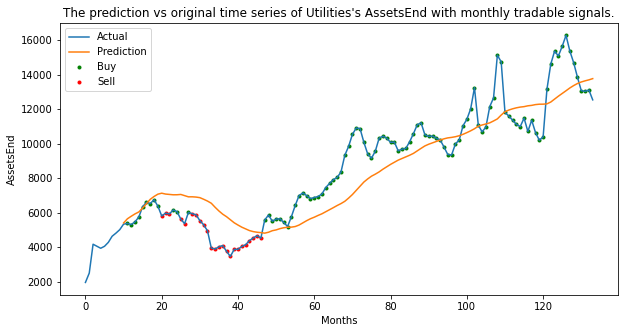

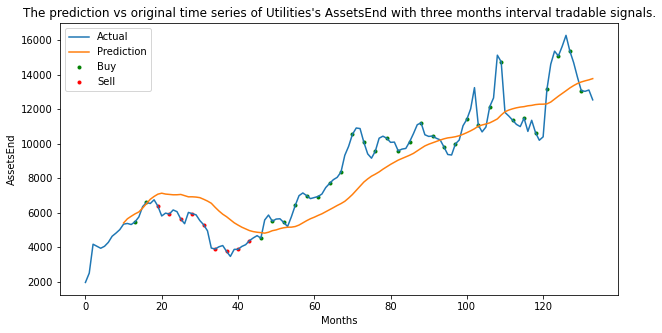

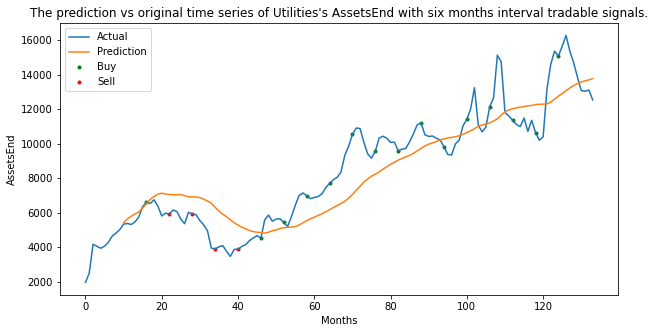

In [77]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'INS', target = 'AssetsEnd')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

INS_AssetsEnd = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [78]:
INS_AssetsEnd

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,1.546950e+06,0.585366,0.545045,0.634146,0.570513,0.60,0.466667,56,32,19,16,21,10,5,5,11,4,4,1
1,Consumer Goods,1.371557e+07,0.650407,0.505721,0.731707,0.528788,0.80,0.600000,77,38,5,3,29,10,1,1,15,4,0,1
2,Energy,5.443744e+07,0.650407,0.535983,0.682927,0.570106,0.70,0.411765,73,34,9,7,25,11,2,3,14,3,3,0
3,Financials,4.053019e+07,0.585366,0.476891,0.731707,0.508681,0.90,0.750000,68,40,11,4,29,8,3,1,16,2,0,2
4,Health Care/Biotech,6.012232e+07,0.609756,0.508333,0.658537,0.523352,0.75,0.566667,68,36,12,7,25,11,3,2,14,4,1,1
5,Industrials,4.193728e+06,0.560976,0.481419,0.585366,0.475641,0.70,0.547619,62,42,12,7,23,14,3,1,13,5,1,1
6,Large Cap Blend,1.198842e+10,0.650407,0.501113,0.731707,0.557576,0.85,0.694444,76,34,9,4,28,9,2,2,16,1,2,1
7,Large Cap Growth,8.044643e+08,0.642276,0.500313,0.731707,0.551613,0.80,0.444444,74,33,11,5,28,8,3,2,16,2,2,0
8,Large Cap Value,6.693287e+08,0.682927,0.526391,0.804878,0.594697,0.80,0.607843,79,32,7,5,31,6,2,2,15,2,2,1
9,Mid Cap Blend,1.395607e+08,0.650407,0.520122,0.756098,0.564236,0.80,0.607843,74,34,9,6,29,7,3,2,15,2,2,1


In [79]:
INS_AssetsEnd.to_csv('Ins_AssetsEnd.csv')

#### RE AssetsEnd

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


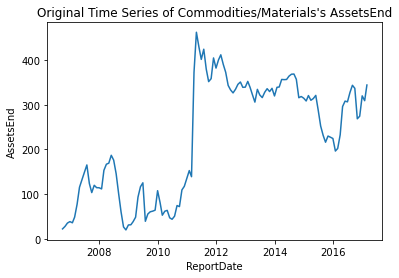

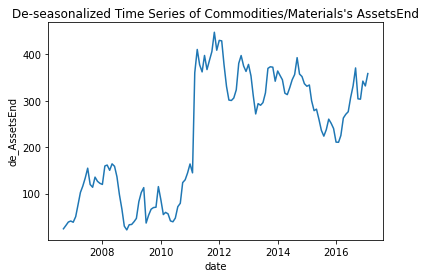

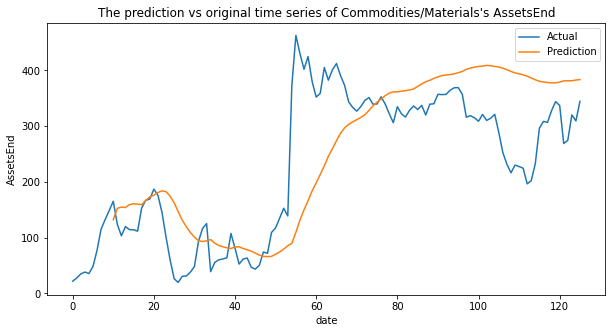

The MSE of the Commodities/Materials AssetsEnd time series prediction is 9847.80538563481.
The Commodities/Materials AssetsEnd one month interval prediction's accuracy is 0.4608695652173913. The AUC score is 0.45223325062034736.
The Commodities/Materials AssetsEnd three months interval prediction's accuracy is 0.5. The AUC score is 0.4916666666666667.
The Commodities/Materials AssetsEnd six months interval prediction's accuracy is 0.5263157894736842. The AUC score is 0.5333333333333333.


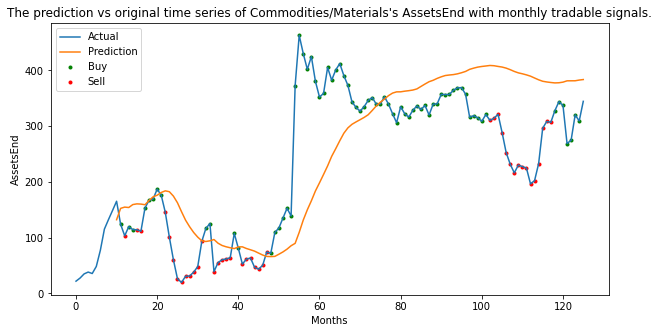

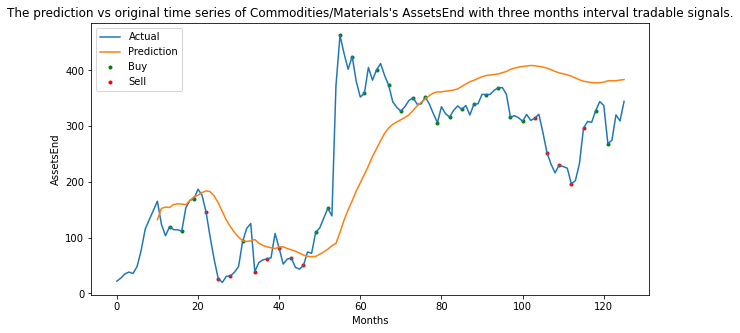

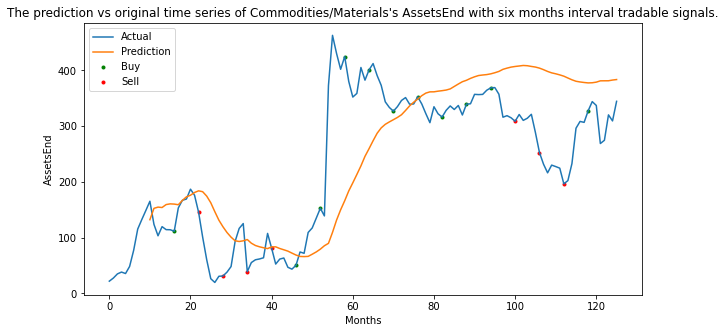

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


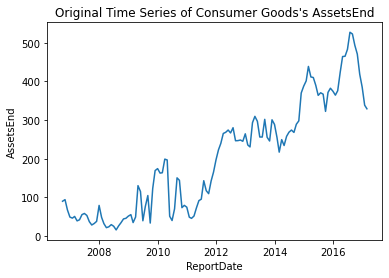

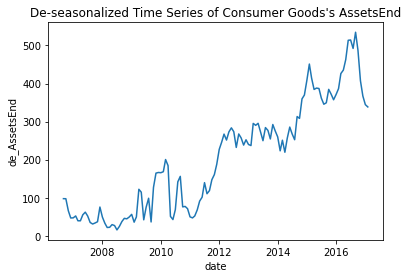

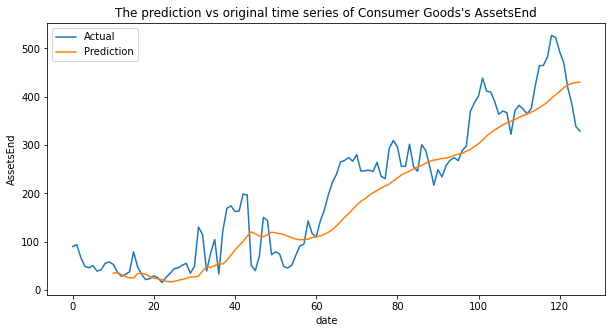

The MSE of the Consumer Goods AssetsEnd time series prediction is 3421.118465483492.
The Consumer Goods AssetsEnd one month interval prediction's accuracy is 0.4782608695652174. The AUC score is 0.4514472455648927.
The Consumer Goods AssetsEnd three months interval prediction's accuracy is 0.6052631578947368. The AUC score is 0.5568181818181819.
The Consumer Goods AssetsEnd six months interval prediction's accuracy is 0.5789473684210527. The AUC score is 0.5611111111111111.


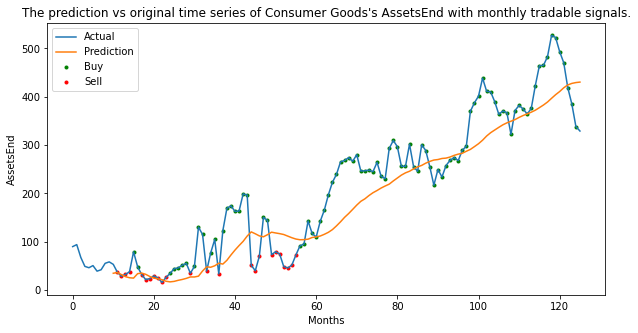

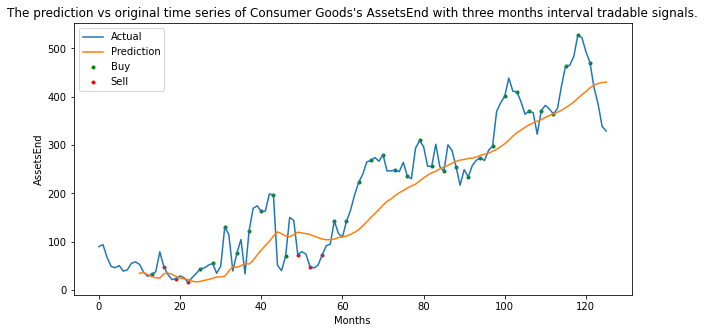

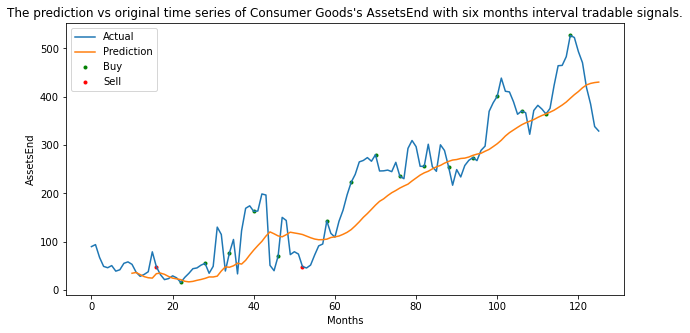

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


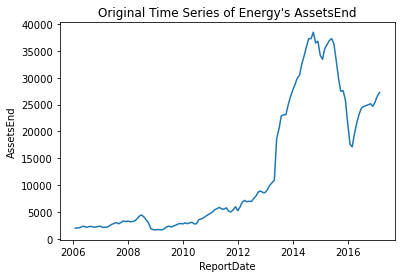

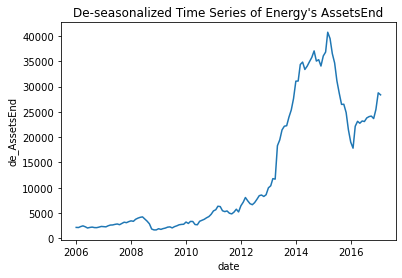

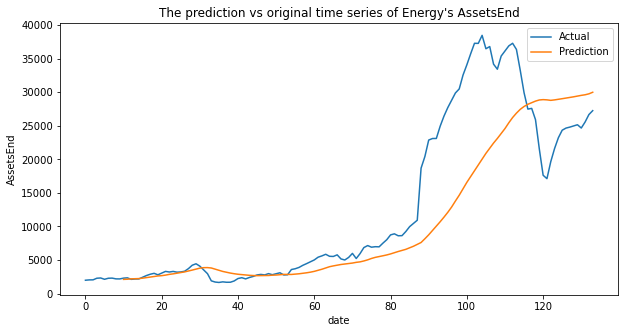

The MSE of the Energy AssetsEnd time series prediction is 52101616.66924433.
The Energy AssetsEnd one month interval prediction's accuracy is 0.6666666666666666. The AUC score is 0.5193798449612403.
The Energy AssetsEnd three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.5233516483516484.
The Energy AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.4375.


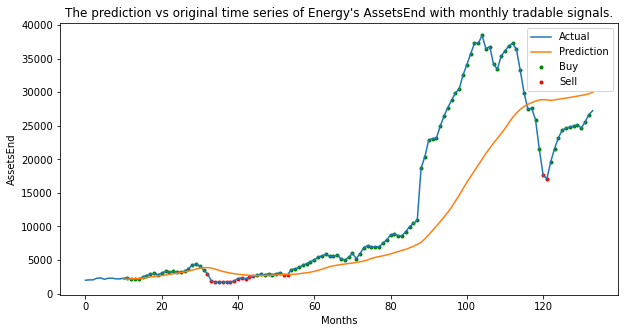

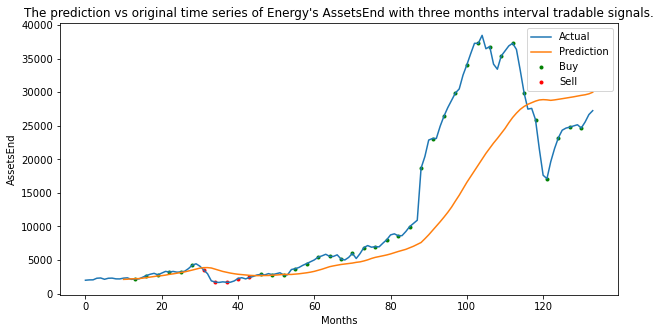

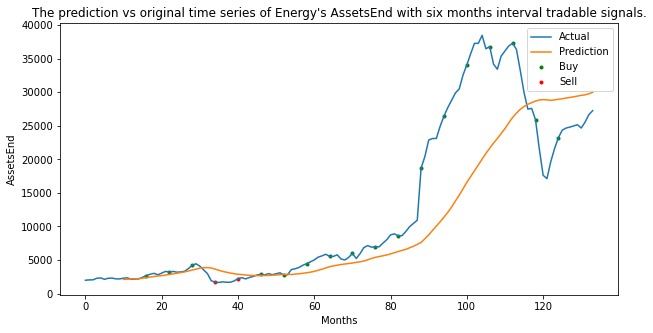

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


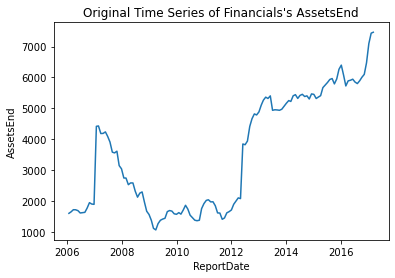

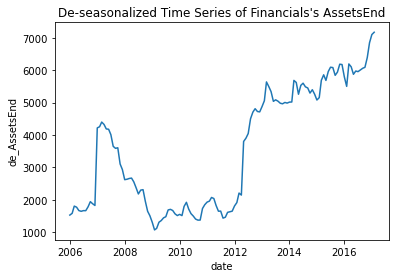

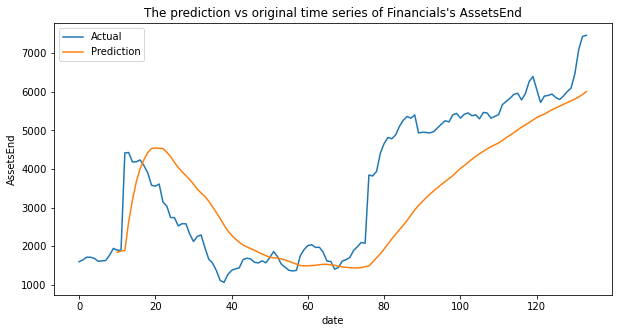

The MSE of the Financials AssetsEnd time series prediction is 1578975.9740395509.
The Financials AssetsEnd one month interval prediction's accuracy is 0.6178861788617886. The AUC score is 0.6070146368406517.
The Financials AssetsEnd three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.6482843137254903.
The Financials AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.6703296703296703.


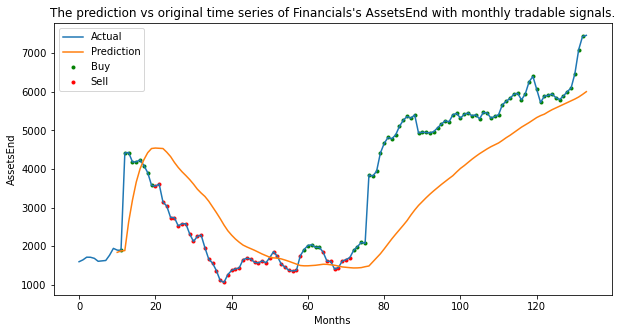

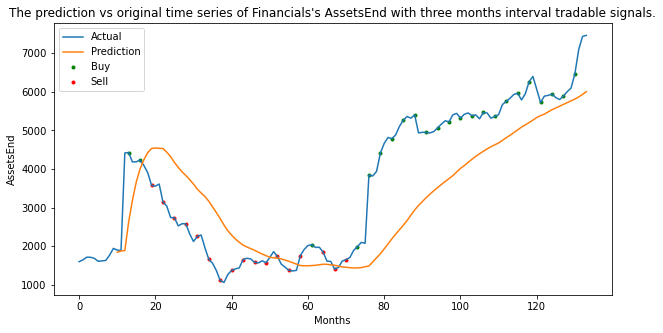

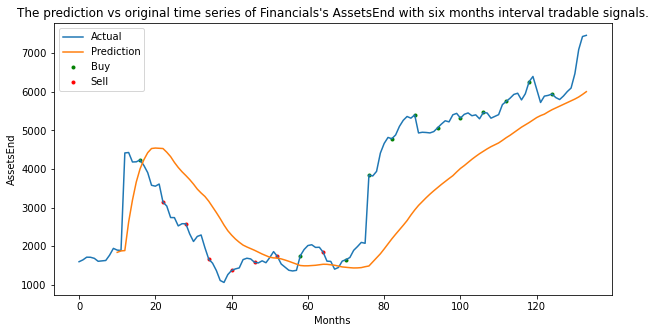

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


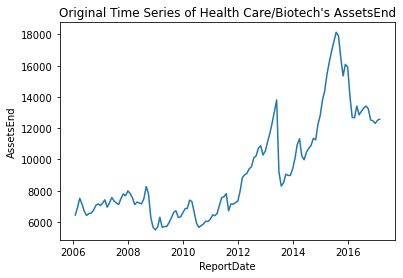

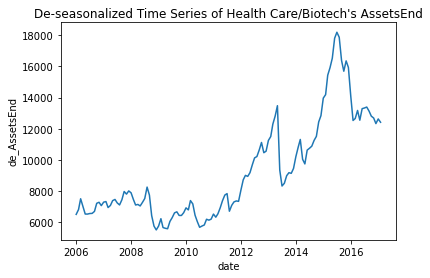

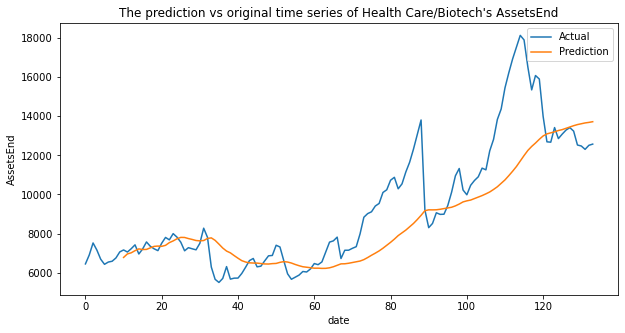

The MSE of the Health Care/Biotech AssetsEnd time series prediction is 3936655.982140733.
The Health Care/Biotech AssetsEnd one month interval prediction's accuracy is 0.5528455284552846. The AUC score is 0.48154761904761906.
The Health Care/Biotech AssetsEnd three months interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.5317460317460317.
The Health Care/Biotech AssetsEnd six months interval prediction's accuracy is 0.55. The AUC score is 0.5.


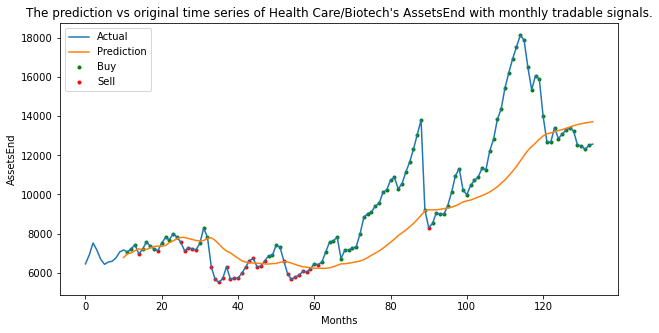

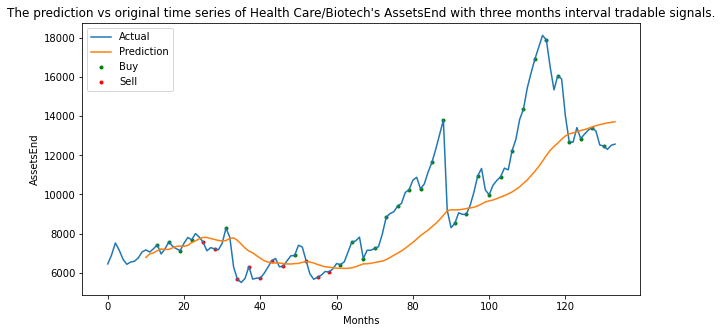

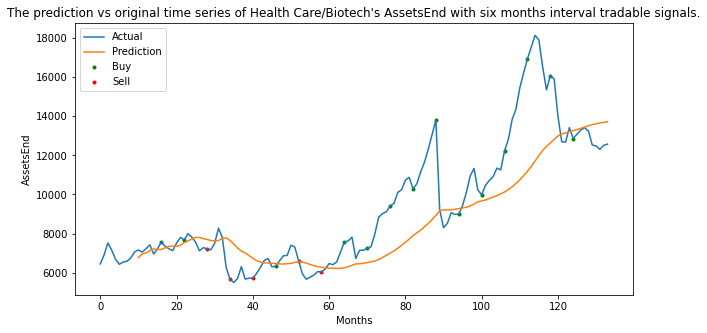

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


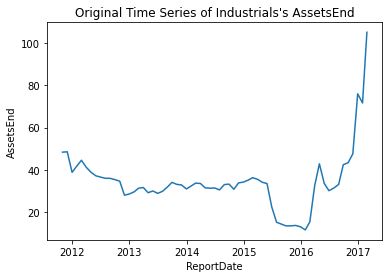

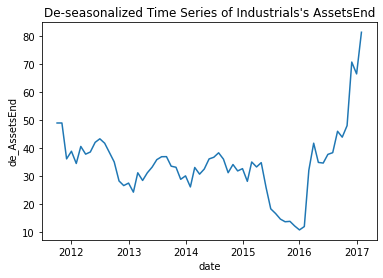

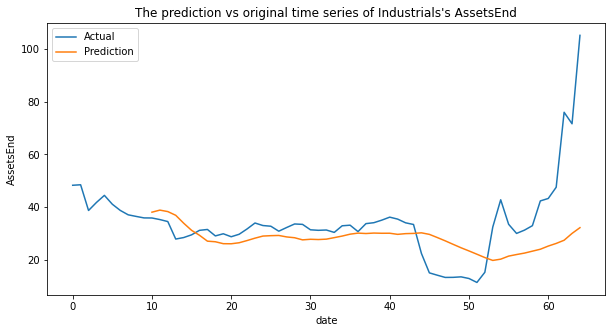

The MSE of the Industrials AssetsEnd time series prediction is 146.59227016867737.
The Industrials AssetsEnd one month interval prediction's accuracy is 0.5185185185185185. The AUC score is 0.5258620689655172.
The Industrials AssetsEnd three months interval prediction's accuracy is 0.7777777777777778. The AUC score is 0.7922077922077922.
The Industrials AssetsEnd six months interval prediction's accuracy is 0.6666666666666666. The AUC score is 0.6666666666666667.


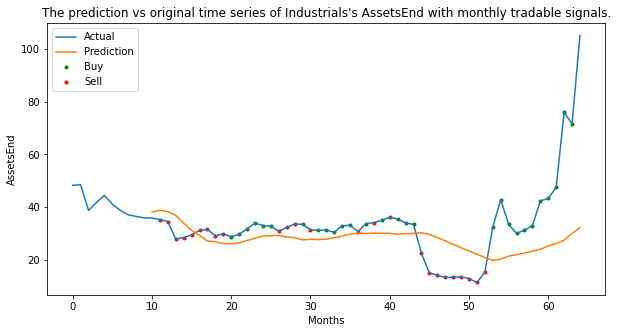

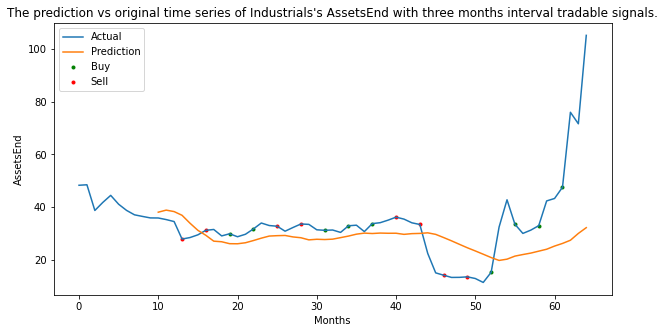

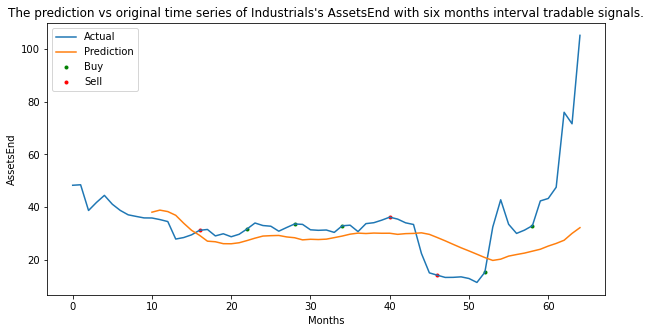

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


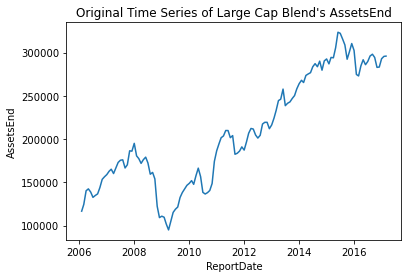

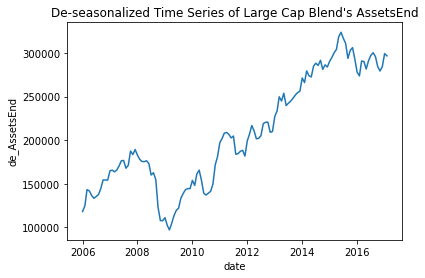

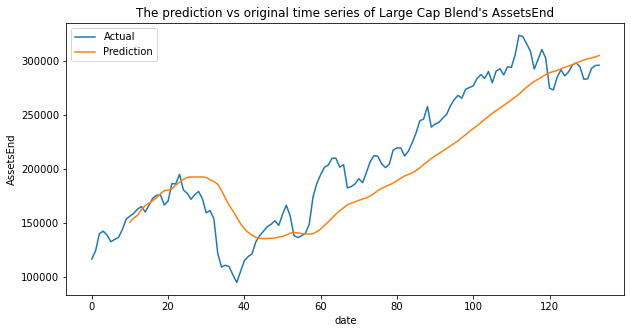

The MSE of the Large Cap Blend AssetsEnd time series prediction is 928133785.4149902.
The Large Cap Blend AssetsEnd one month interval prediction's accuracy is 0.6178861788617886. The AUC score is 0.5139880952380953.
The Large Cap Blend AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5824175824175825.
The Large Cap Blend AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.47619047619047616.


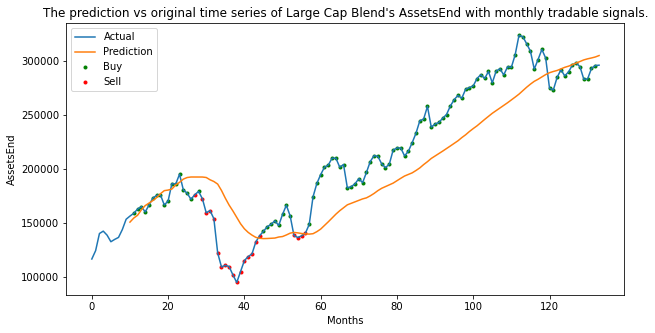

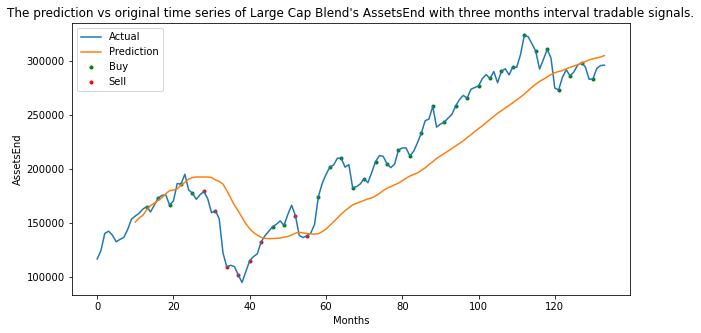

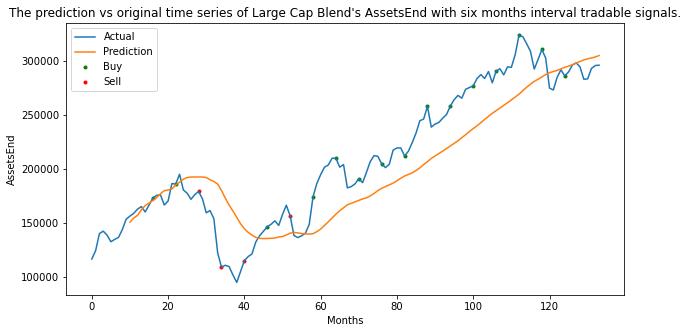

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


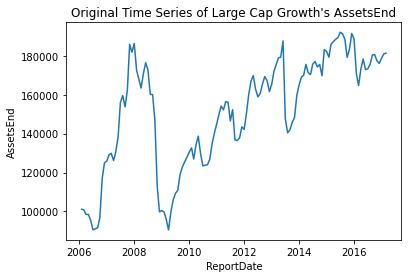

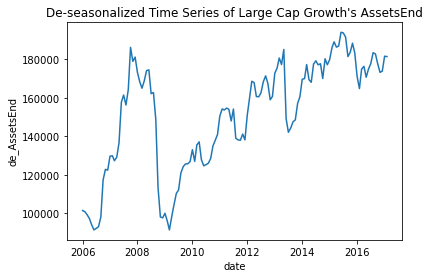

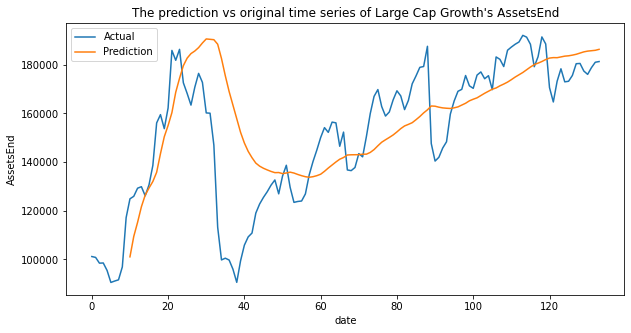

The MSE of the Large Cap Growth AssetsEnd time series prediction is 481127710.1390578.
The Large Cap Growth AssetsEnd one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.4636363636363636.
The Large Cap Growth AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5804597701149425.
The Large Cap Growth AssetsEnd six months interval prediction's accuracy is 0.55. The AUC score is 0.44047619047619047.


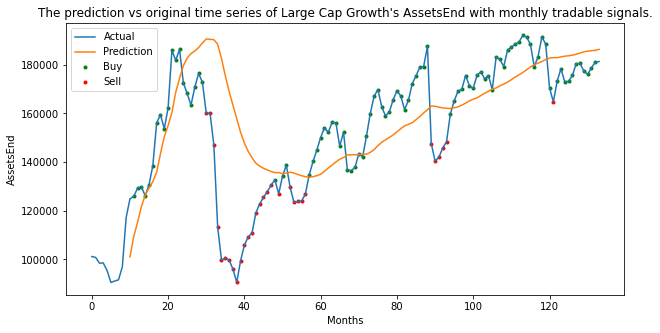

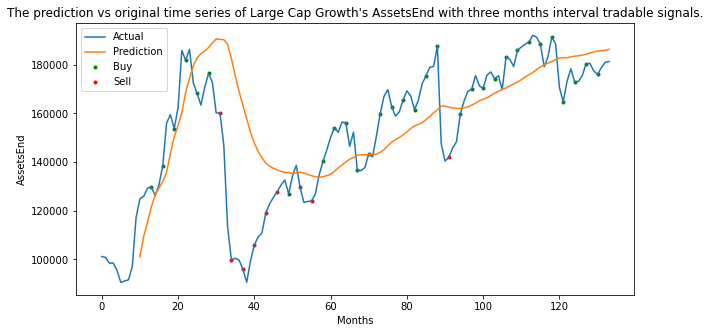

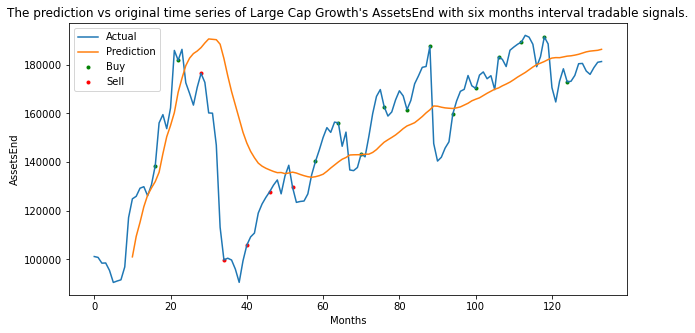

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


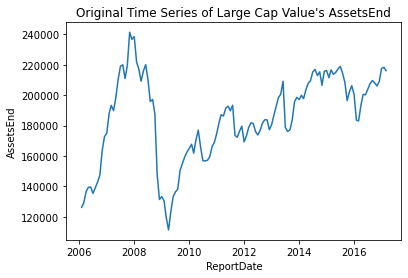

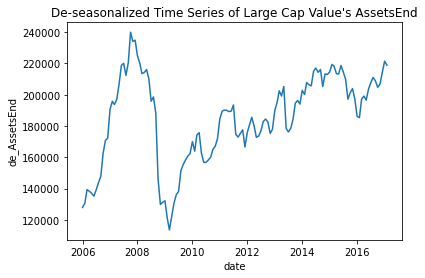

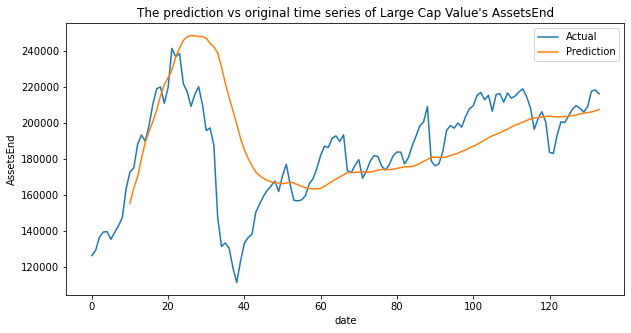

The MSE of the Large Cap Value AssetsEnd time series prediction is 746534777.5055115.
The Large Cap Value AssetsEnd one month interval prediction's accuracy is 0.5284552845528455. The AUC score is 0.47254004576659037.
The Large Cap Value AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5762499999999999.
The Large Cap Value AssetsEnd six months interval prediction's accuracy is 0.5. The AUC score is 0.41758241758241765.


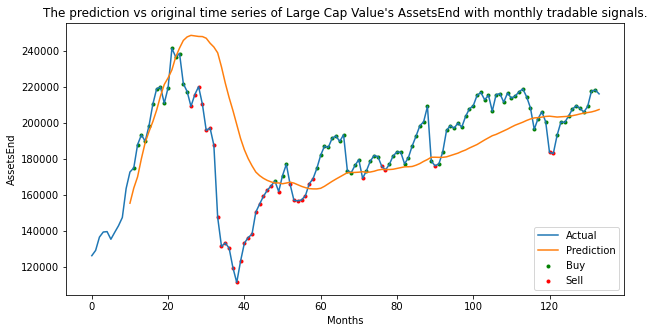

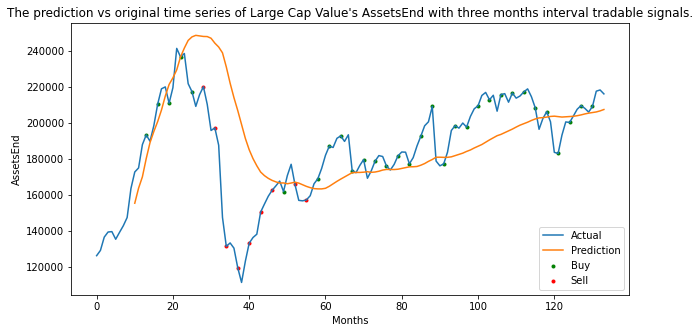

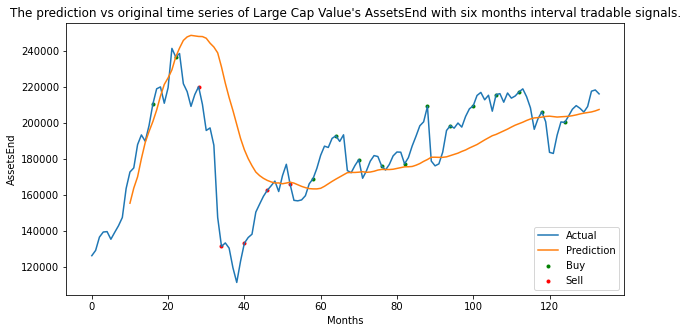

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


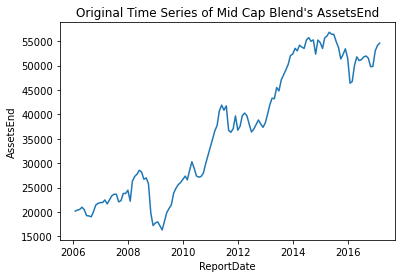

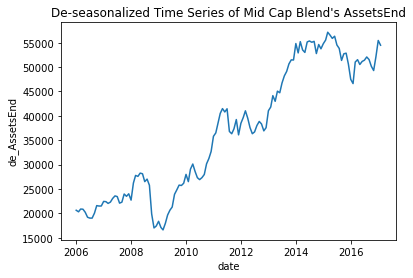

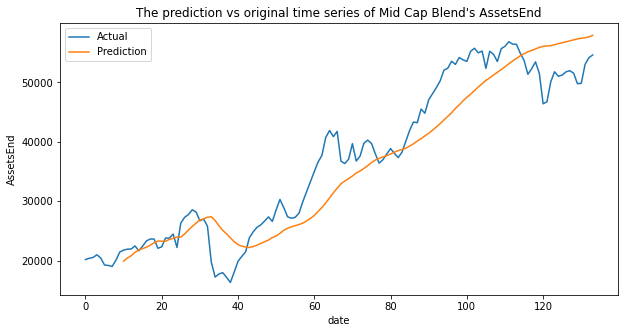

The MSE of the Mid Cap Blend AssetsEnd time series prediction is 23847402.734189525.
The Mid Cap Blend AssetsEnd one month interval prediction's accuracy is 0.5934959349593496. The AUC score is 0.47639860139860146.
The Mid Cap Blend AssetsEnd three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.5412087912087912.
The Mid Cap Blend AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.46153846153846156.


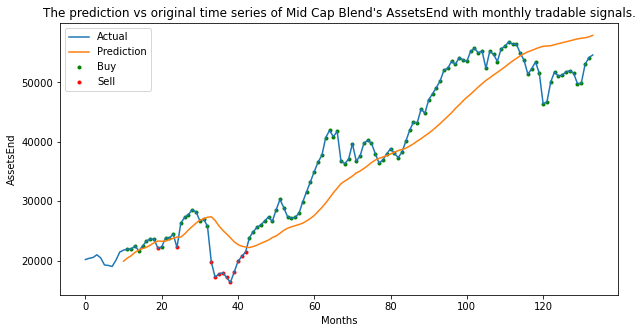

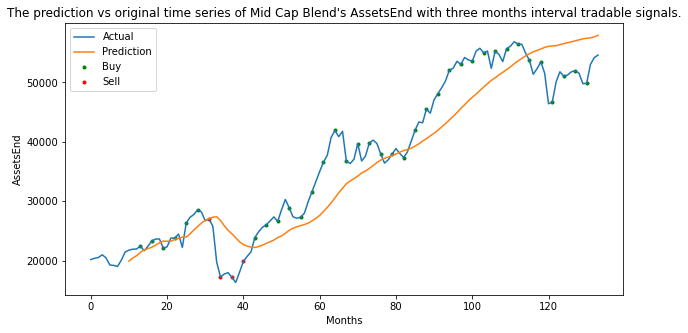

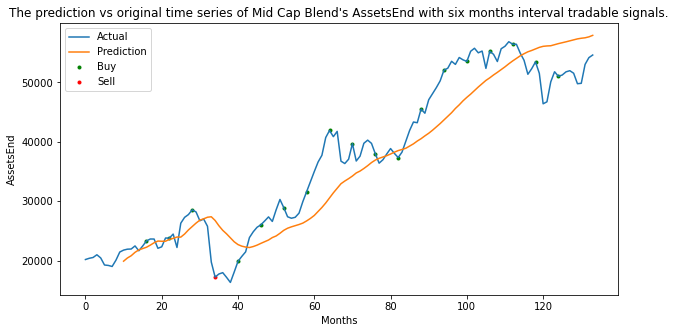

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


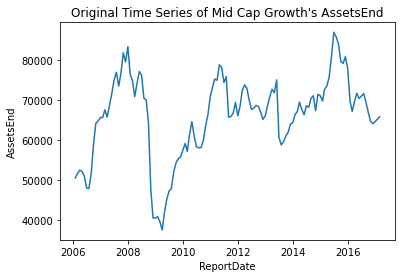

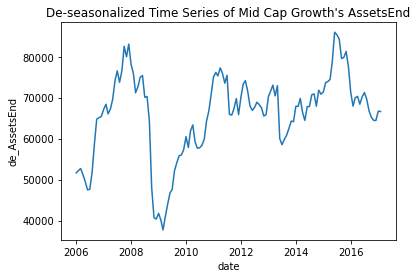

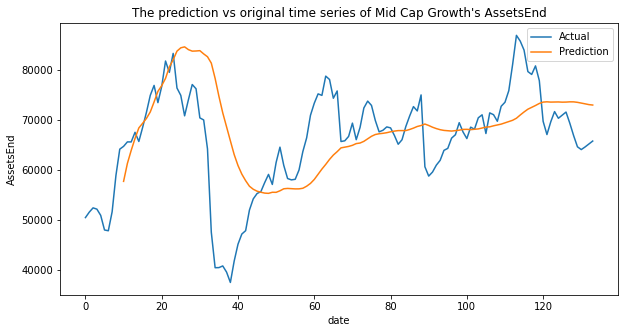

The MSE of the Mid Cap Growth AssetsEnd time series prediction is 103673784.22791962.
The Mid Cap Growth AssetsEnd one month interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.4036177851422259.
The Mid Cap Growth AssetsEnd three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5269230769230769.
The Mid Cap Growth AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.6041666666666667.


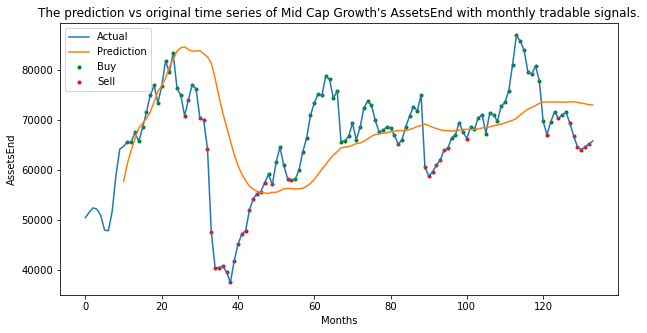

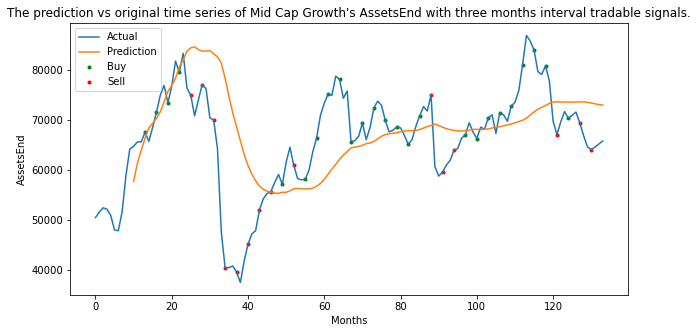

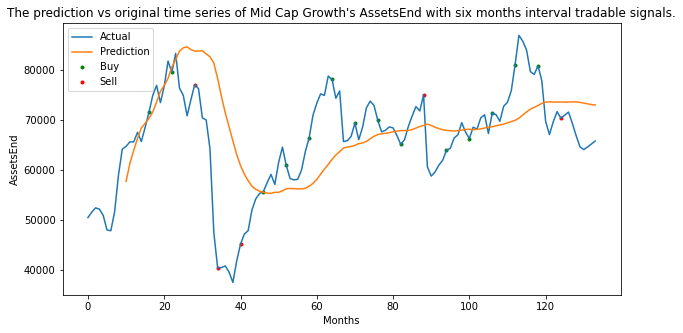

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


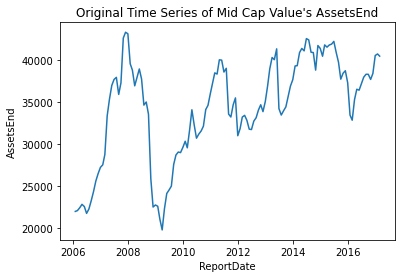

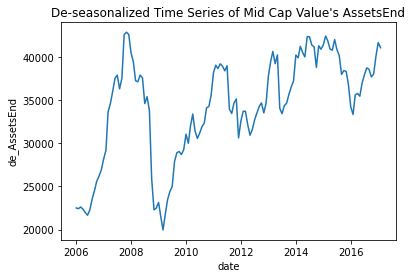

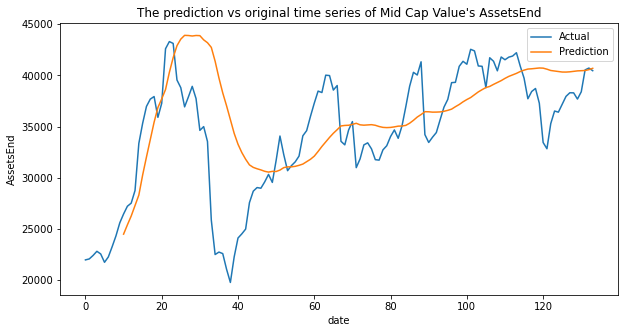

The MSE of the Mid Cap Value AssetsEnd time series prediction is 27713652.739325266.
The Mid Cap Value AssetsEnd one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.4904279279279279.
The Mid Cap Value AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5846560846560847.
The Mid Cap Value AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.598901098901099.


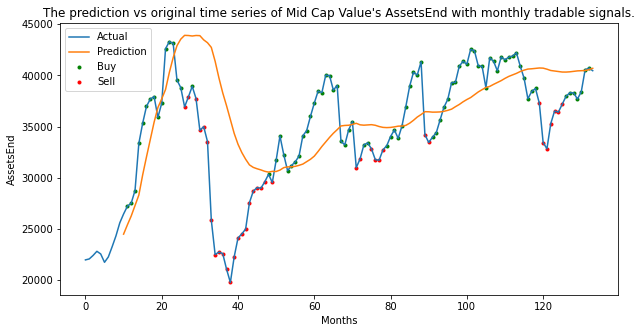

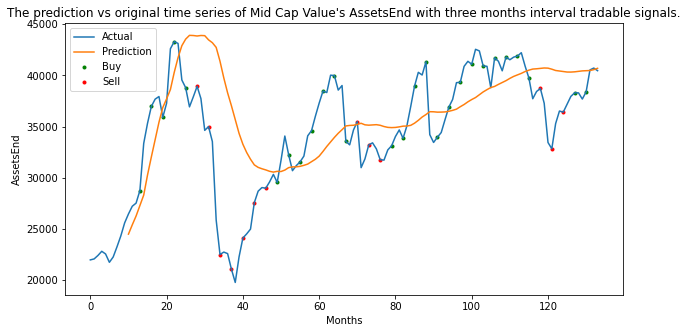

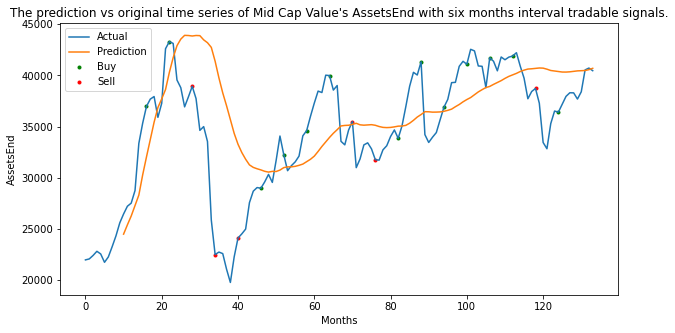

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


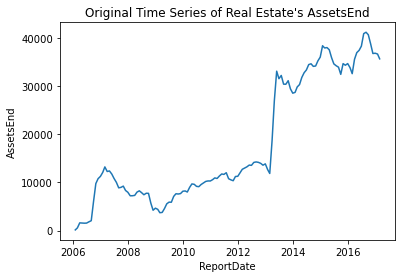

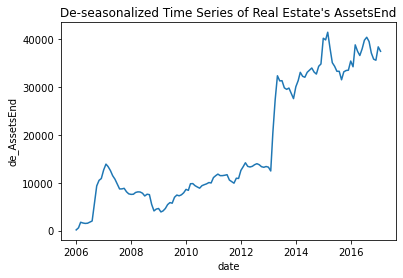

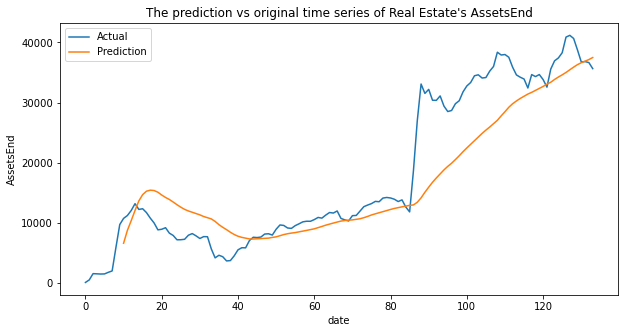

The MSE of the Real Estate AssetsEnd time series prediction is 34823139.37472941.
The Real Estate AssetsEnd one month interval prediction's accuracy is 0.5528455284552846. The AUC score is 0.517429193899782.
The Real Estate AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.6014492753623188.
The Real Estate AssetsEnd six months interval prediction's accuracy is 0.65. The AUC score is 0.6041666666666667.


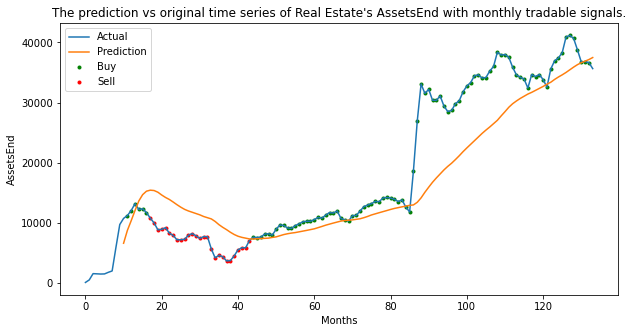

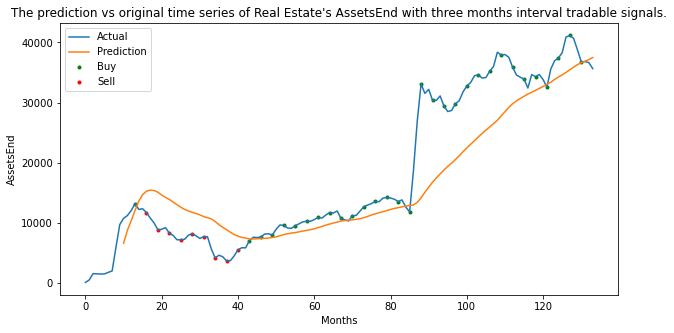

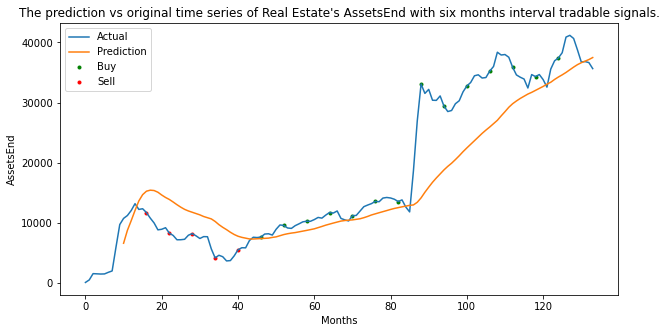

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


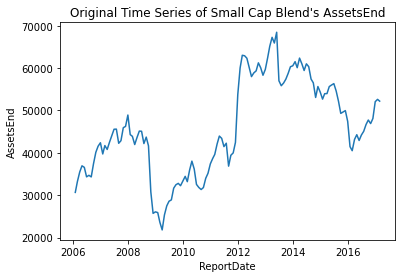

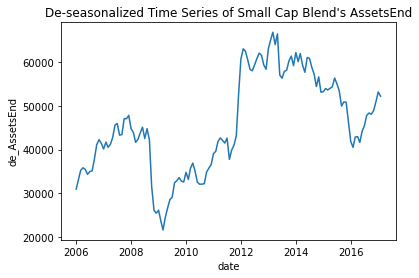

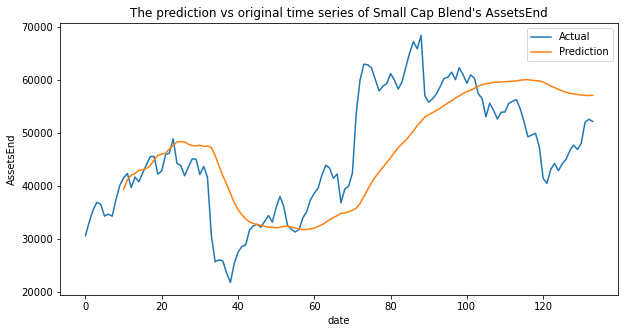

The MSE of the Small Cap Blend AssetsEnd time series prediction is 93114480.33876403.
The Small Cap Blend AssetsEnd one month interval prediction's accuracy is 0.4959349593495935. The AUC score is 0.4625.
The Small Cap Blend AssetsEnd three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.43062200956937796.
The Small Cap Blend AssetsEnd six months interval prediction's accuracy is 0.45. The AUC score is 0.45000000000000007.


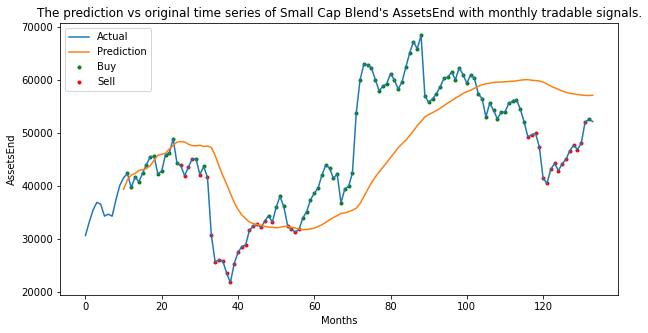

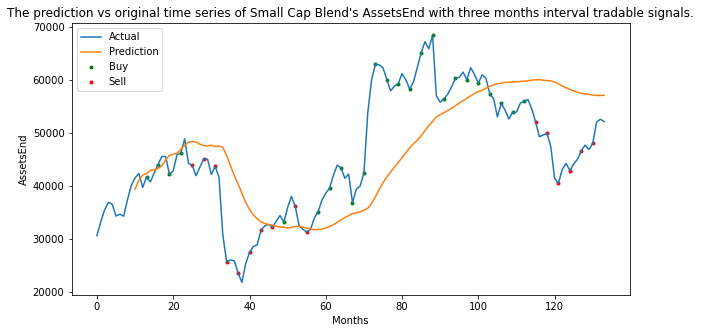

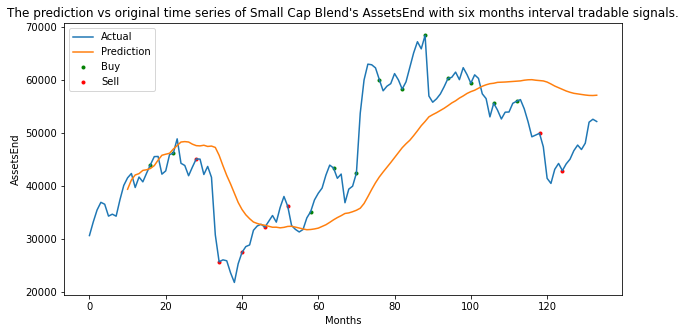

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


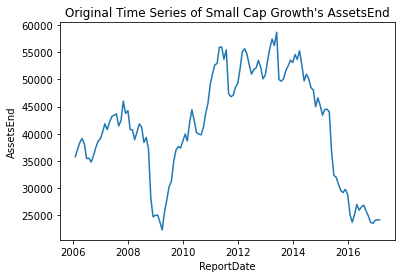

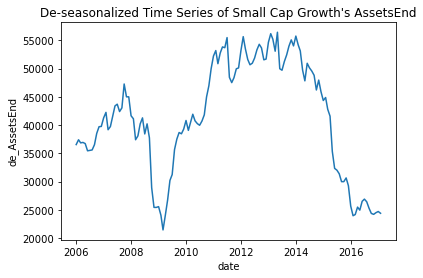

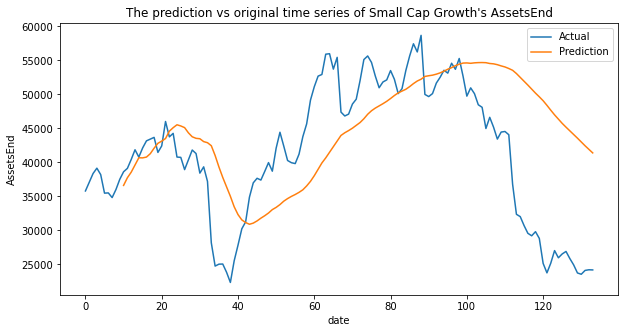

The MSE of the Small Cap Growth AssetsEnd time series prediction is 109312894.40448686.
The Small Cap Growth AssetsEnd one month interval prediction's accuracy is 0.5934959349593496. The AUC score is 0.5833333333333333.
The Small Cap Growth AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.6369047619047619.
The Small Cap Growth AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.7070707070707071.


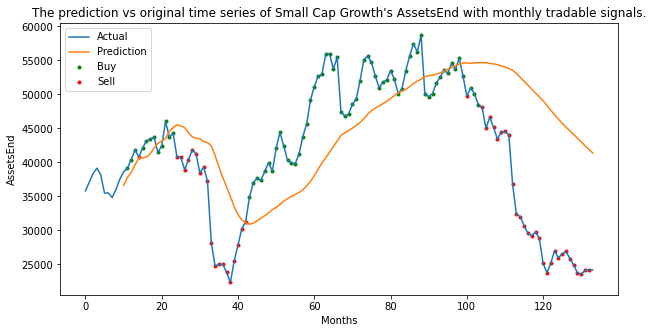

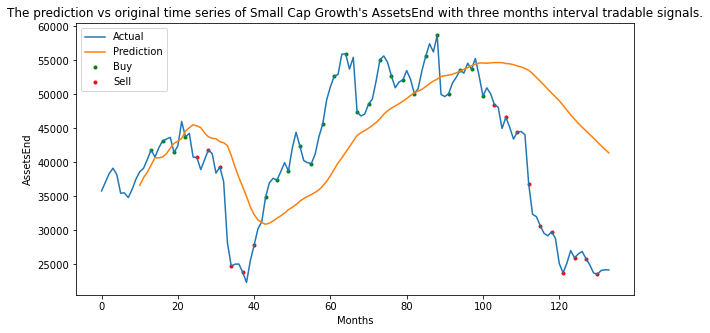

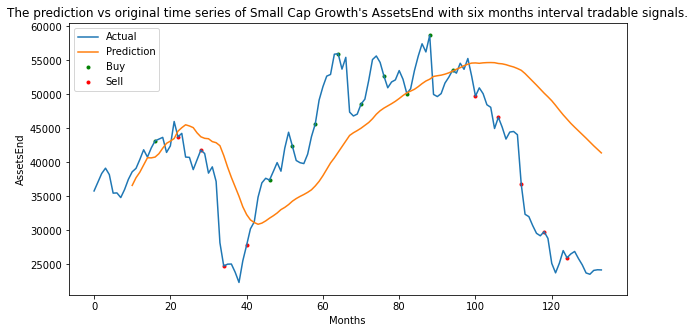

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


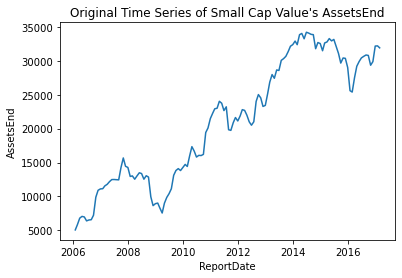

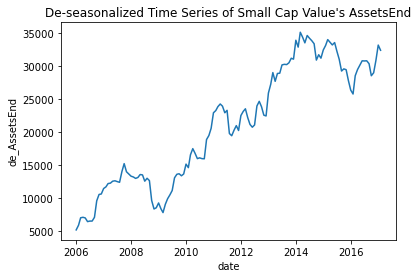

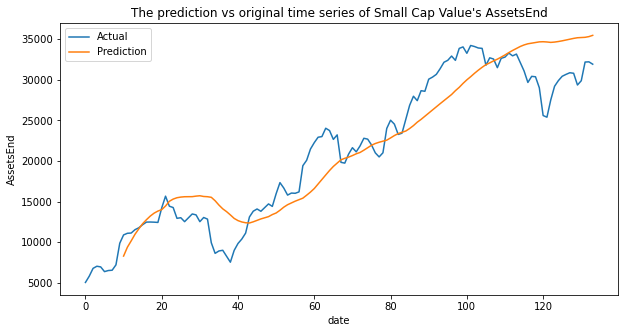

The MSE of the Small Cap Value AssetsEnd time series prediction is 12067281.180264523.
The Small Cap Value AssetsEnd one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.4905555555555555.
The Small Cap Value AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5282051282051282.
The Small Cap Value AssetsEnd six months interval prediction's accuracy is 0.6. The AUC score is 0.5208333333333333.


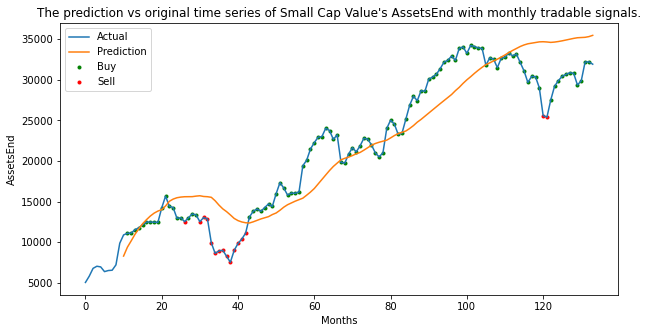

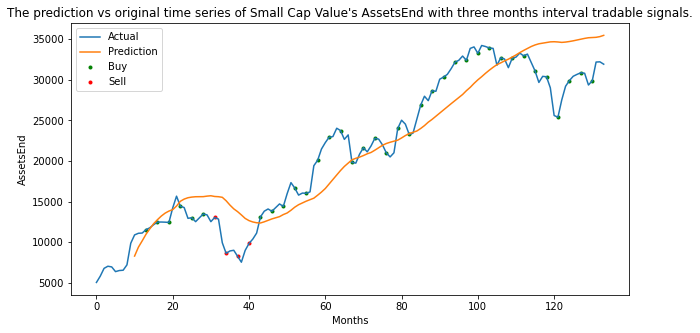

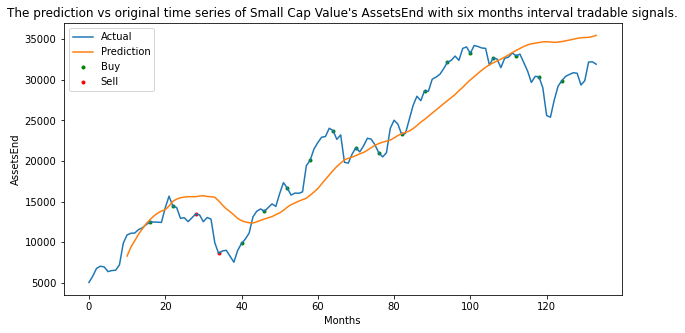

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


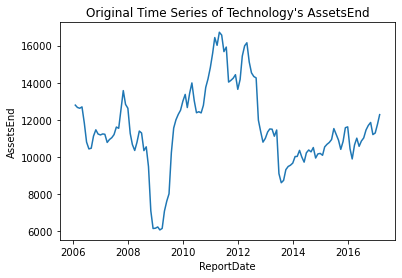

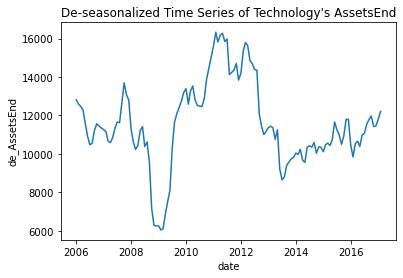

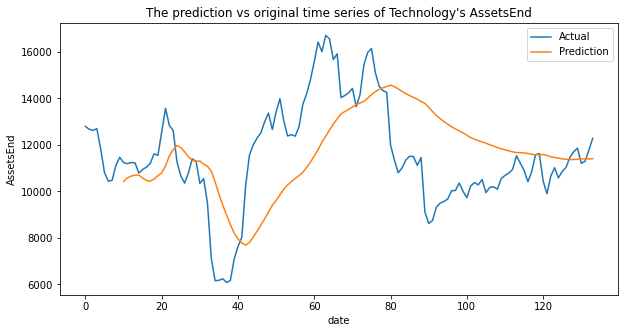

The MSE of the Technology AssetsEnd time series prediction is 5554422.842359681.
The Technology AssetsEnd one month interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.4496567505720824.
The Technology AssetsEnd three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5446859903381642.
The Technology AssetsEnd six months interval prediction's accuracy is 0.5. The AUC score is 0.5164835164835165.


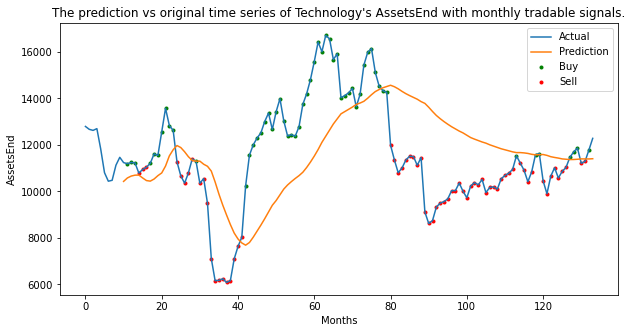

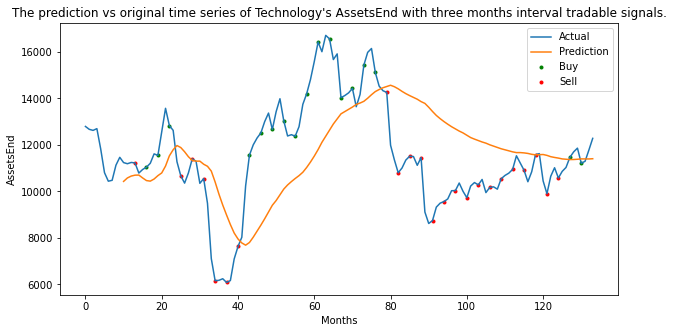

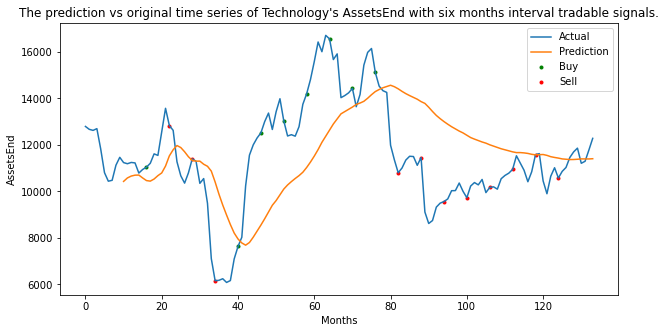

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


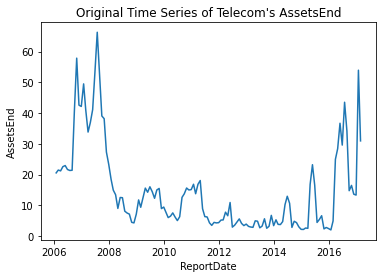

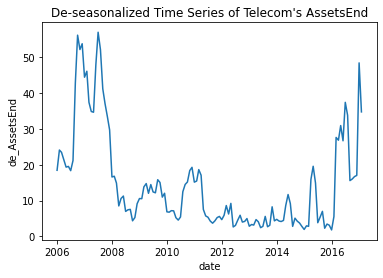

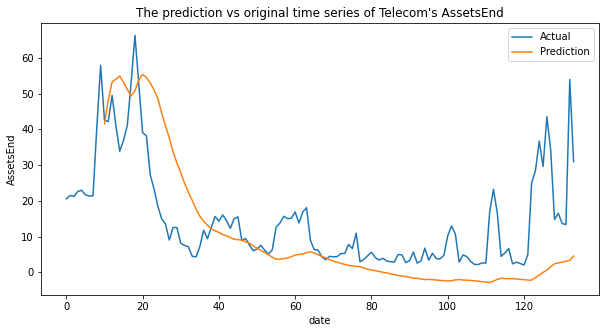

The MSE of the Telecom AssetsEnd time series prediction is 172.47222968587366.
The Telecom AssetsEnd one month interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4766531713900134.
The Telecom AssetsEnd three months interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.4867149758454106.
The Telecom AssetsEnd six months interval prediction's accuracy is 0.35. The AUC score is 0.3125.


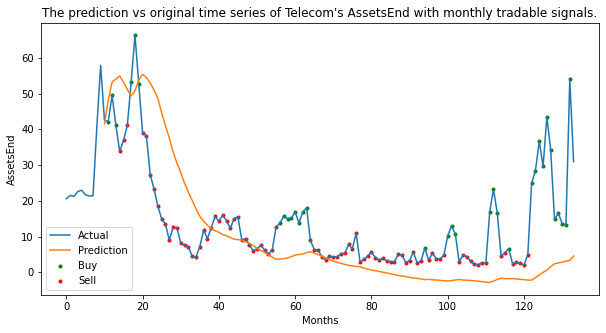

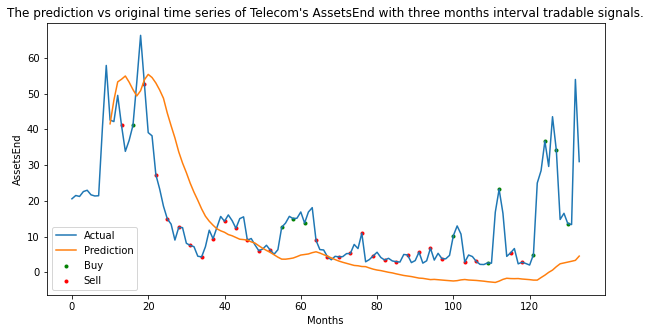

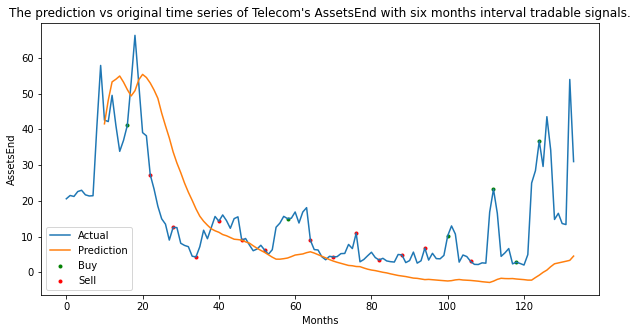

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


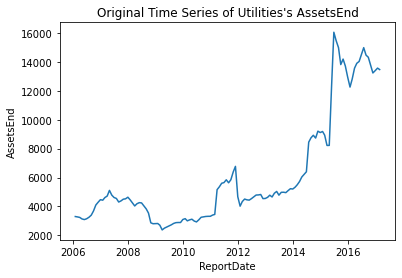

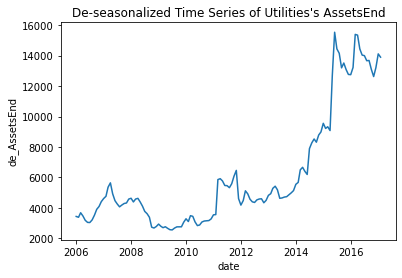

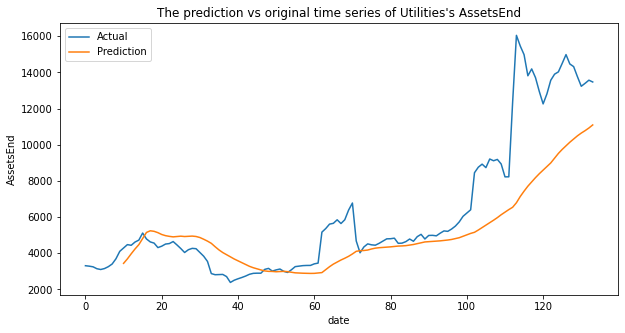

The MSE of the Utilities AssetsEnd time series prediction is 5931096.007013159.
The Utilities AssetsEnd one month interval prediction's accuracy is 0.5691056910569106. The AUC score is 0.5126984126984127.
The Utilities AssetsEnd three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.5674603174603174.
The Utilities AssetsEnd six months interval prediction's accuracy is 0.7. The AUC score is 0.6428571428571428.


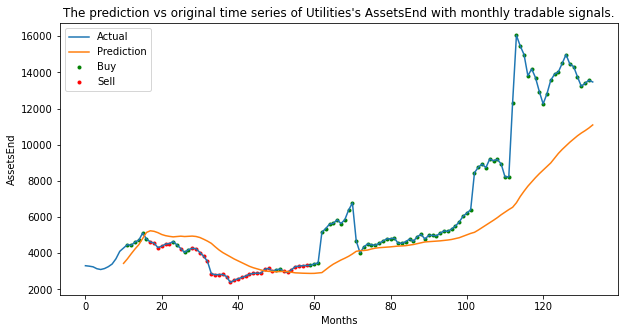

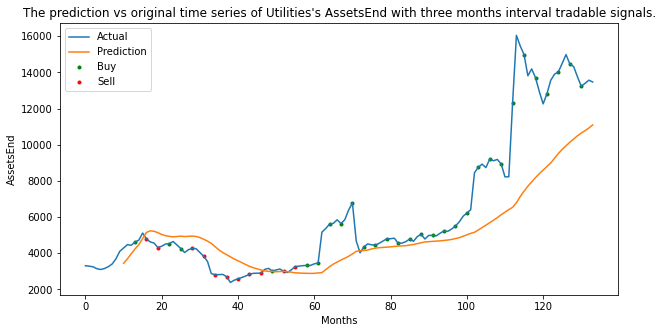

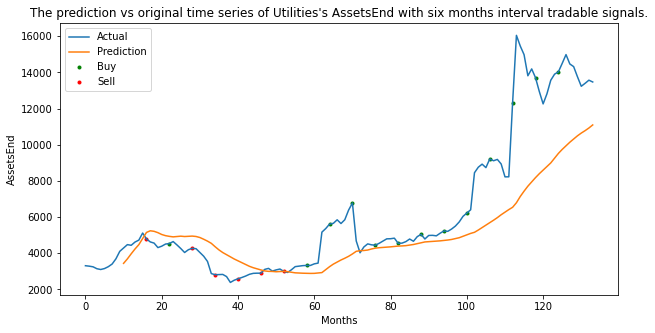

In [80]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'RE', target = 'AssetsEnd')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

RE_AssetsEnd = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [81]:
RE_AssetsEnd

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,9.847805e+03,0.460870,0.452233,0.500000,0.491667,0.526316,0.533333,37,37,25,16,13,12,7,6,6,6,3,4
1,Consumer Goods,3.421118e+03,0.478261,0.451447,0.605263,0.556818,0.578947,0.561111,47,44,16,8,19,12,3,4,9,7,1,2
2,Energy,5.210162e+07,0.666667,0.519380,0.658537,0.523352,0.700000,0.437500,76,30,11,6,25,11,3,2,14,4,2,0
3,Financials,1.578976e+06,0.617886,0.607015,0.658537,0.648284,0.700000,0.670330,50,26,21,26,17,7,7,10,10,3,3,4
4,Health Care/Biotech,3.936656e+06,0.552846,0.481548,0.609756,0.531746,0.550000,0.500000,58,33,22,10,21,10,6,4,9,6,3,2
5,Industrials,1.465923e+02,0.518519,0.525862,0.777778,0.792208,0.666667,0.666667,16,13,13,12,8,1,3,6,4,1,2,2
6,Large Cap Blend,9.281338e+08,0.617886,0.513988,0.682927,0.582418,0.600000,0.476190,68,34,13,8,24,9,4,4,11,5,3,1
7,Large Cap Growth,4.811277e+08,0.536585,0.463636,0.682927,0.580460,0.550000,0.440476,57,36,21,9,24,8,5,4,10,5,4,1
8,Large Cap Value,7.465348e+08,0.528455,0.472540,0.634146,0.576250,0.500000,0.417582,53,34,24,12,21,11,4,5,9,6,4,1
9,Mid Cap Blend,2.384740e+07,0.593496,0.476399,0.682927,0.541209,0.600000,0.461538,70,41,9,3,26,11,2,2,12,7,1,0


In [82]:
RE_AssetsEnd.to_csv('Re_AssetsEnd.csv')

#### ETF PCP

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


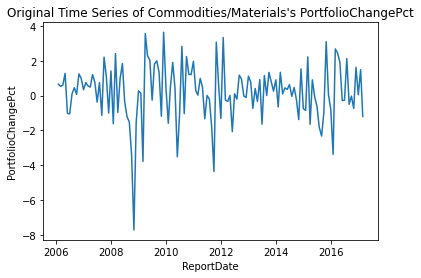

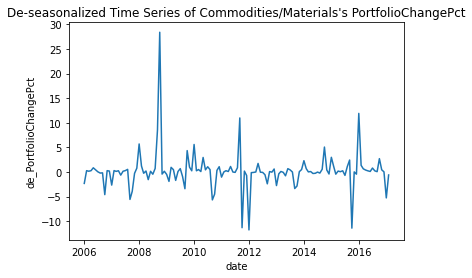

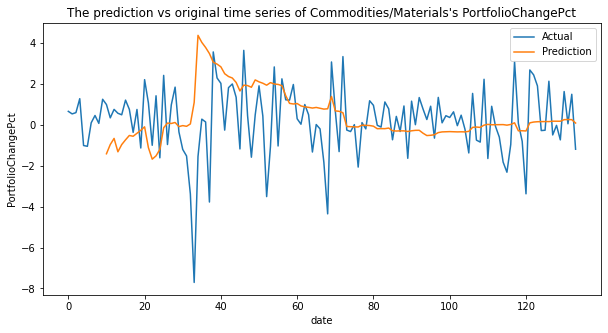

The MSE of the Commodities/Materials PortfolioChangePct time series prediction is 16.860363133497973.
The Commodities/Materials PortfolioChangePct one month interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.6128941441441441.
The Commodities/Materials PortfolioChangePct three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.532608695652174.
The Commodities/Materials PortfolioChangePct six months interval prediction's accuracy is 0.45. The AUC score is 0.45959595959595967.


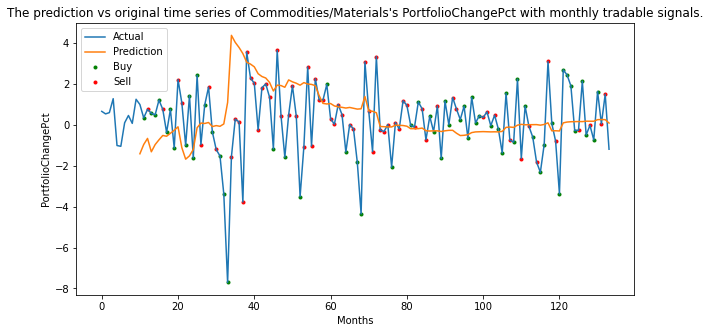

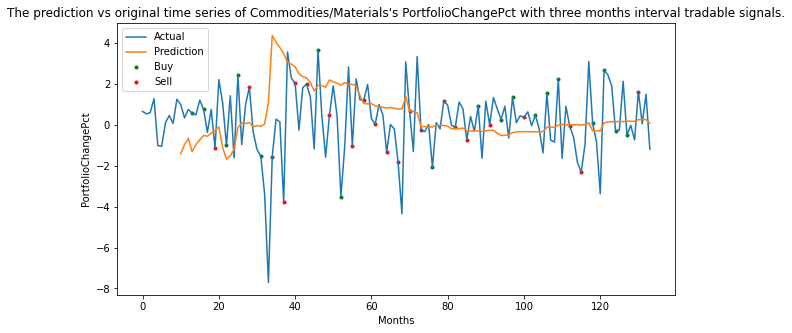

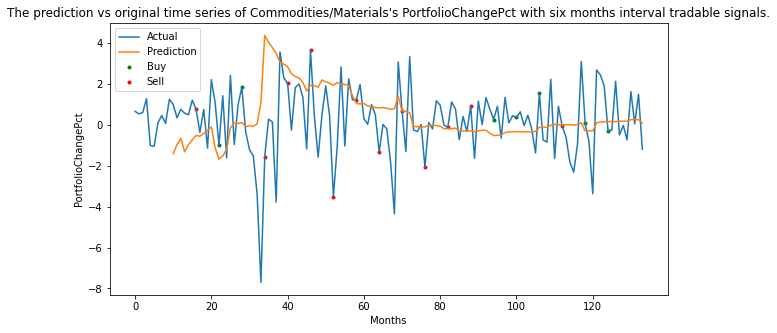

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


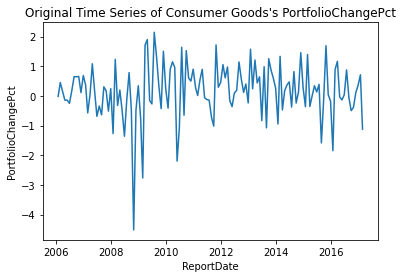

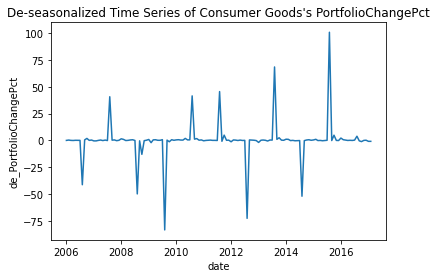

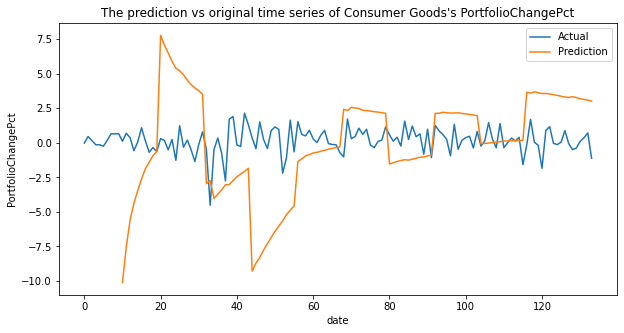

The MSE of the Consumer Goods PortfolioChangePct time series prediction is 329.50987406212283.
The Consumer Goods PortfolioChangePct one month interval prediction's accuracy is 0.45528455284552843. The AUC score is 0.4576248313090418.
The Consumer Goods PortfolioChangePct three months interval prediction's accuracy is 0.4146341463414634. The AUC score is 0.4130952380952381.
The Consumer Goods PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.3939393939393939.


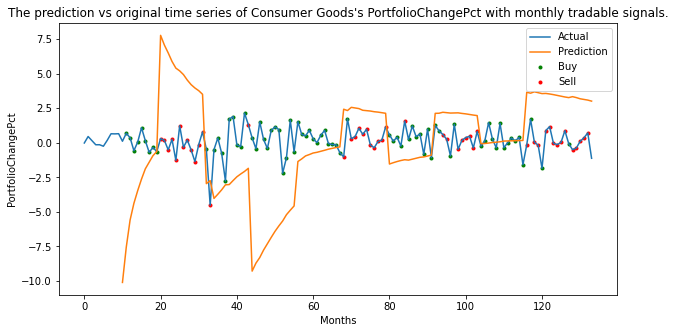

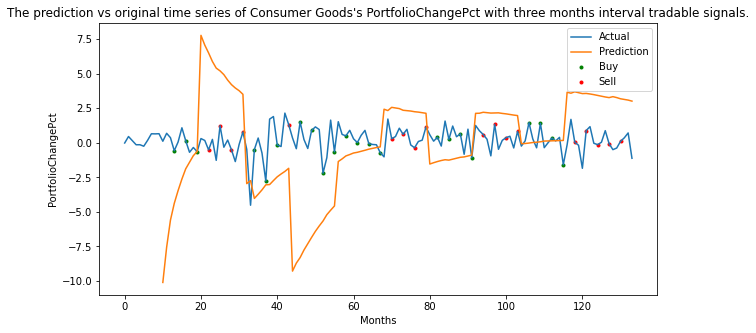

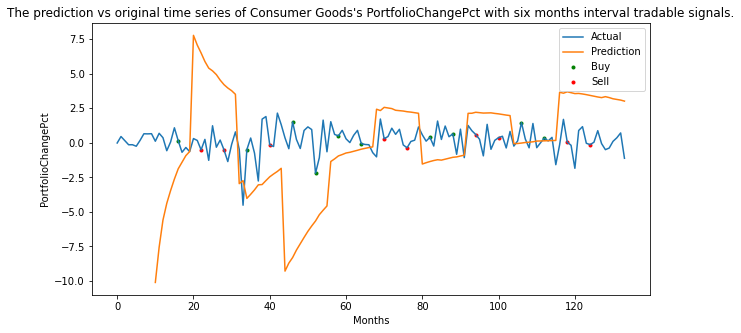

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


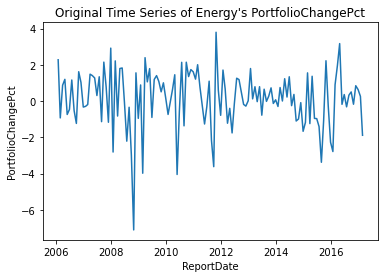

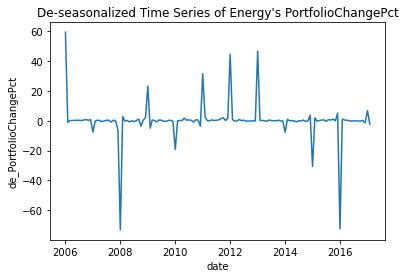

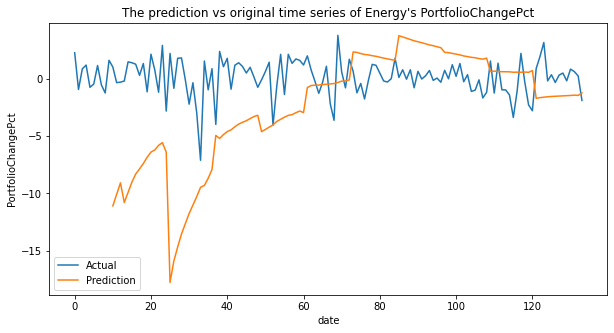

The MSE of the Energy PortfolioChangePct time series prediction is 169.93311409435427.
The Energy PortfolioChangePct one month interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.4719827586206897.
The Energy PortfolioChangePct three months interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.5203349282296651.
The Energy PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.4949494949494949.


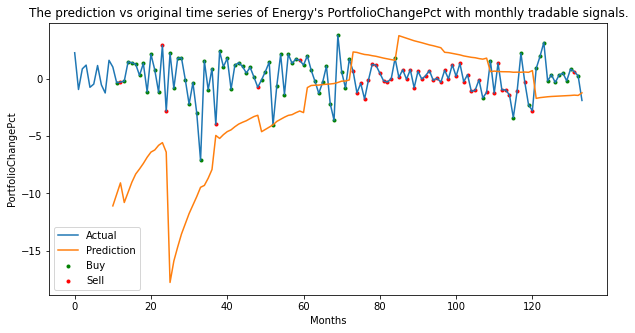

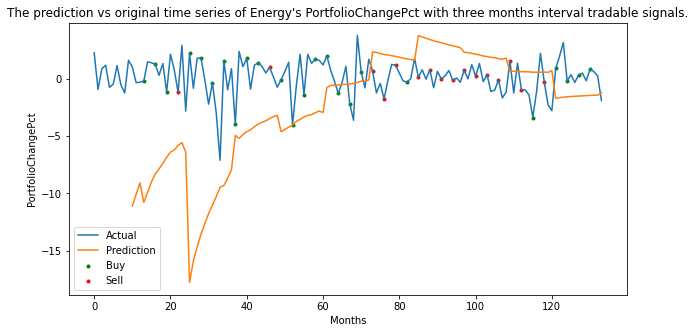

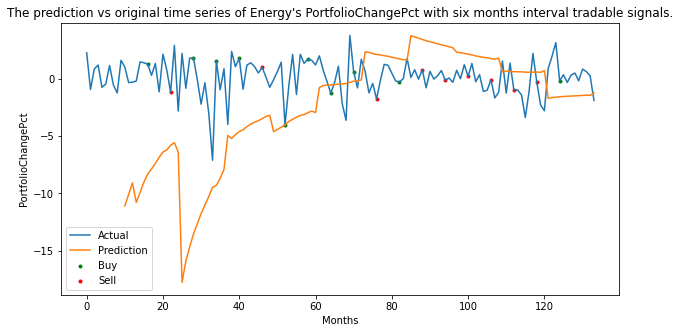

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


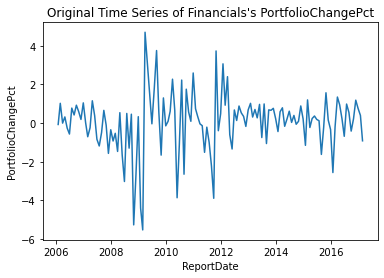

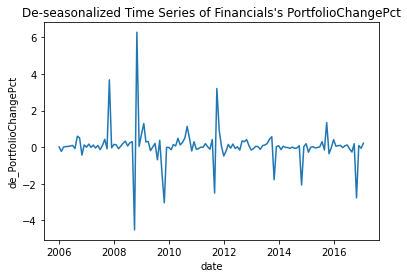

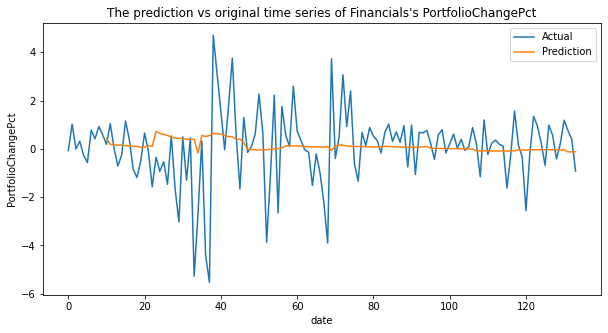

The MSE of the Financials PortfolioChangePct time series prediction is 1.1338269271474166.
The Financials PortfolioChangePct one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5307629204265791.
The Financials PortfolioChangePct three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.6630952380952381.
The Financials PortfolioChangePct six months interval prediction's accuracy is 0.6. The AUC score is 0.5858585858585859.


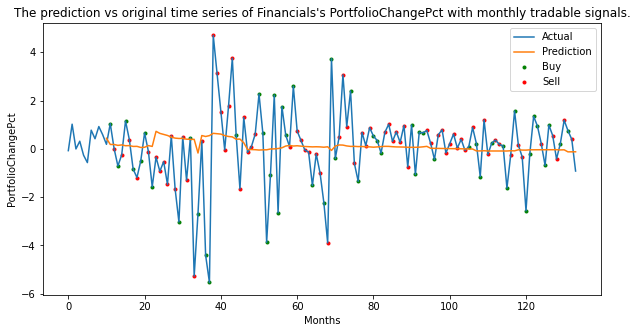

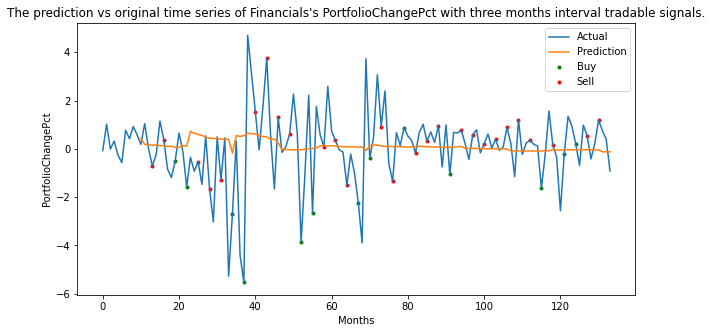

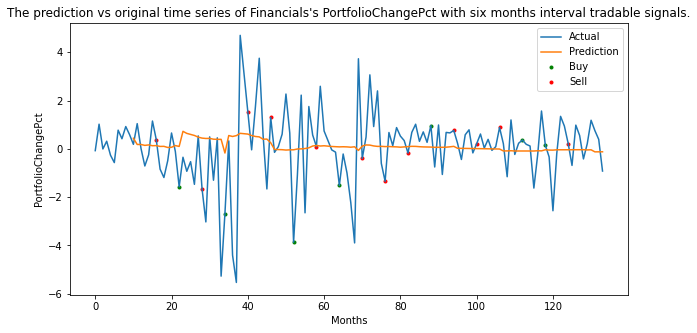

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


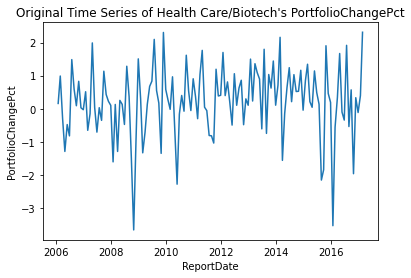

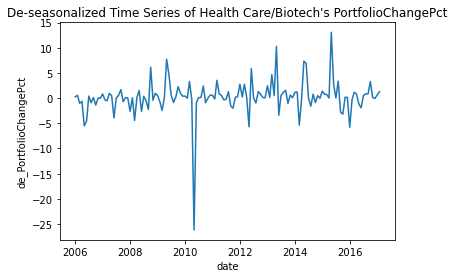

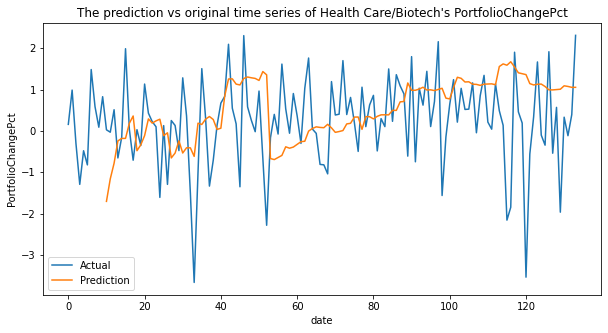

The MSE of the Health Care/Biotech PortfolioChangePct time series prediction is 13.420903105281695.
The Health Care/Biotech PortfolioChangePct one month interval prediction's accuracy is 0.3902439024390244. The AUC score is 0.3983805668016194.
The Health Care/Biotech PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.47607655502392343.
The Health Care/Biotech PortfolioChangePct six months interval prediction's accuracy is 0.6. The AUC score is 0.5833333333333333.


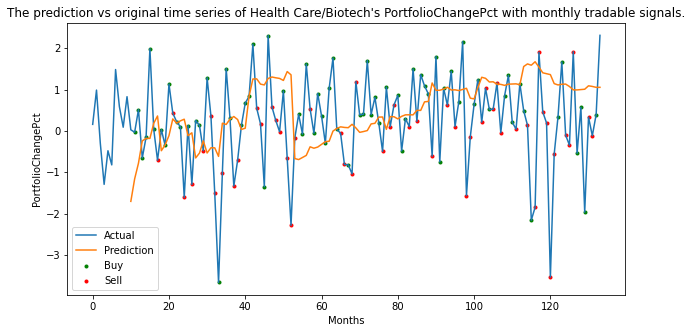

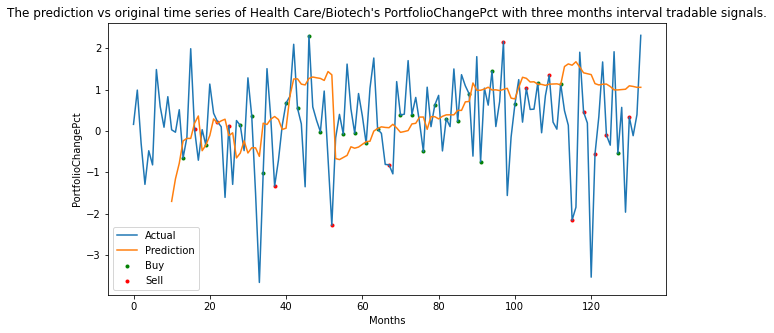

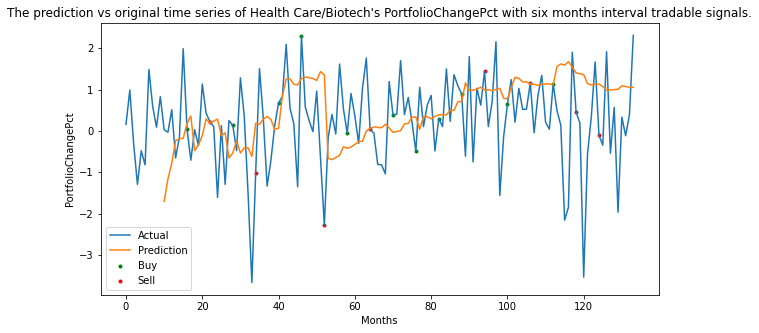

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


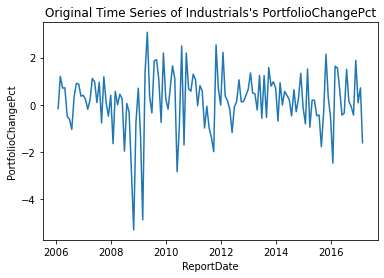

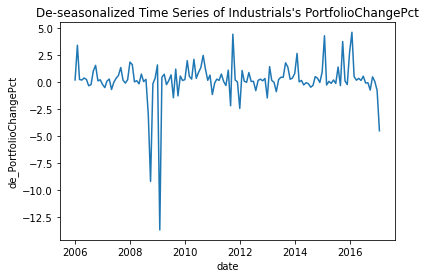

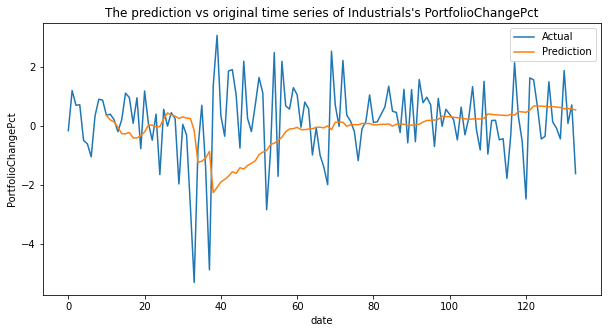

The MSE of the Industrials PortfolioChangePct time series prediction is 3.866599744116709.
The Industrials PortfolioChangePct one month interval prediction's accuracy is 0.4715447154471545. The AUC score is 0.48351648351648346.
The Industrials PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5630952380952381.
The Industrials PortfolioChangePct six months interval prediction's accuracy is 0.45. The AUC score is 0.4292929292929293.


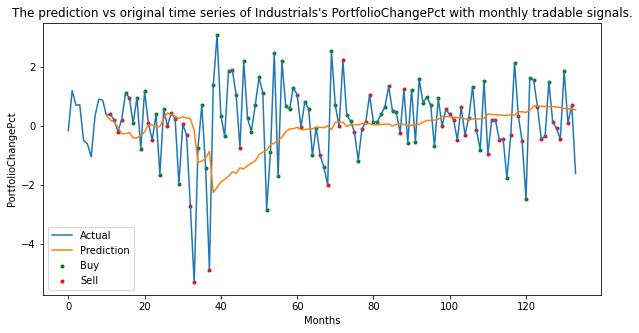

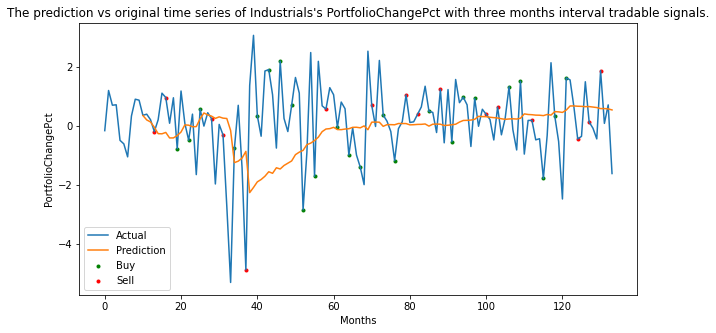

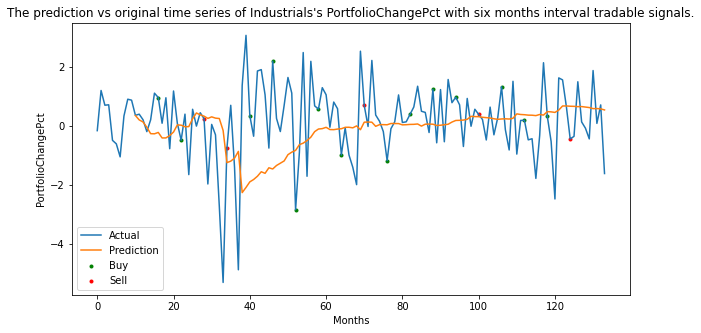

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


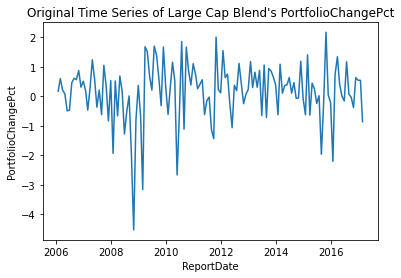

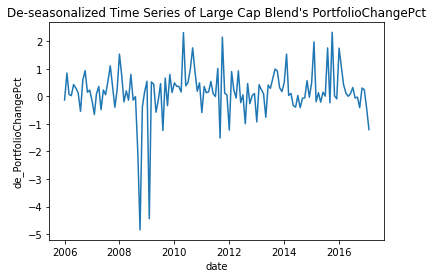

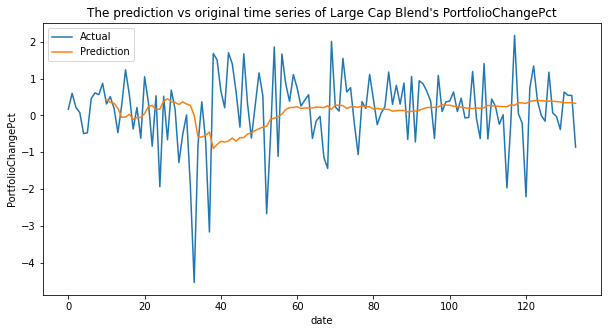

The MSE of the Large Cap Blend PortfolioChangePct time series prediction is 0.9251957120815335.
The Large Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.46895604395604396.
The Large Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5595238095238095.
The Large Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


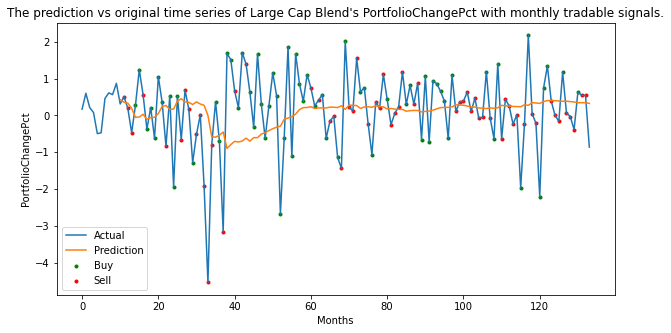

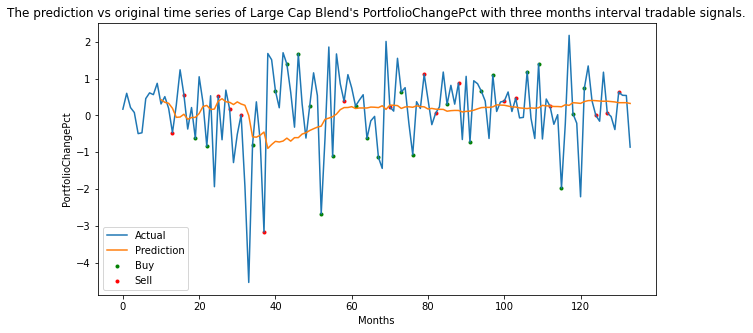

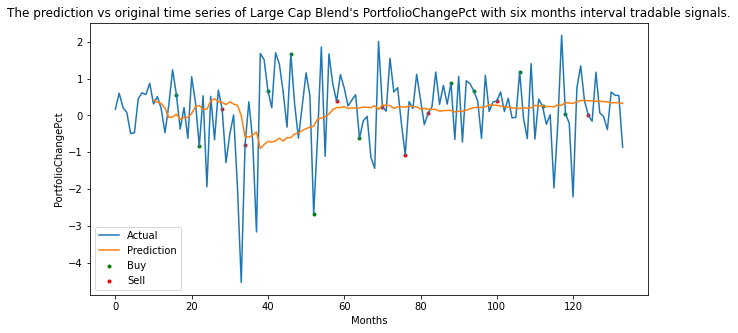

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


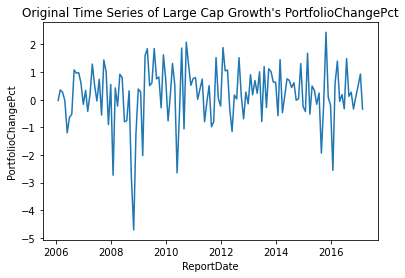

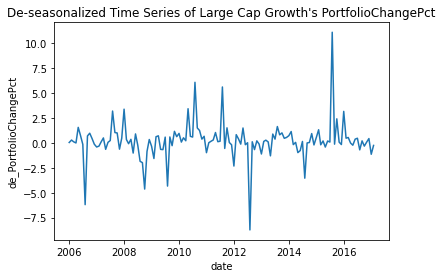

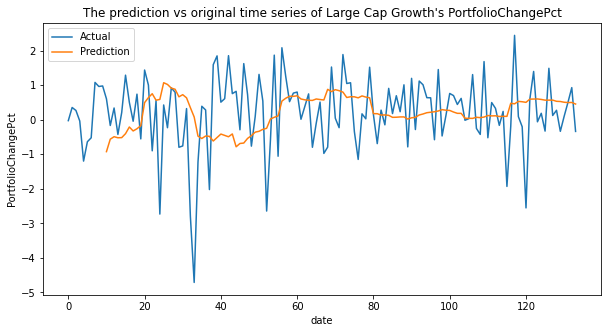

The MSE of the Large Cap Growth PortfolioChangePct time series prediction is 3.6654877531766874.
The Large Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.4959349593495935. The AUC score is 0.5.
The Large Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.7149758454106281.
The Large Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.5.


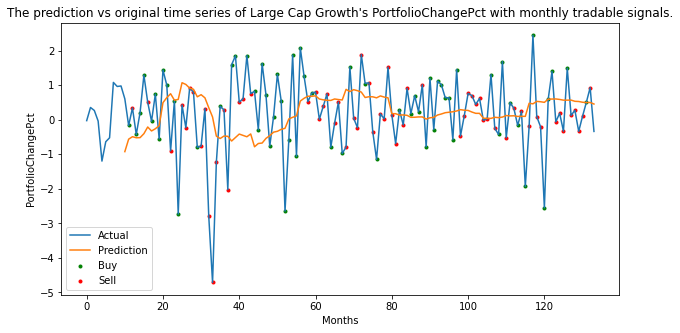

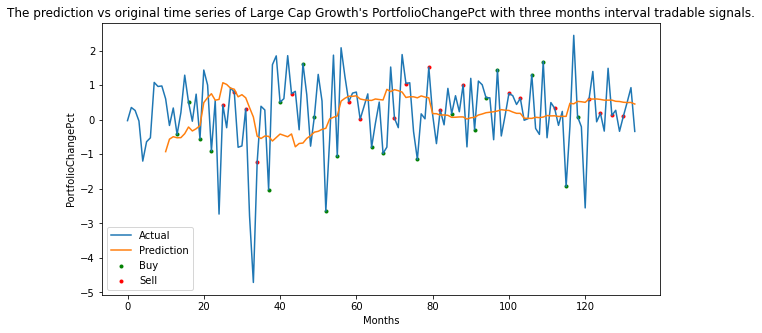

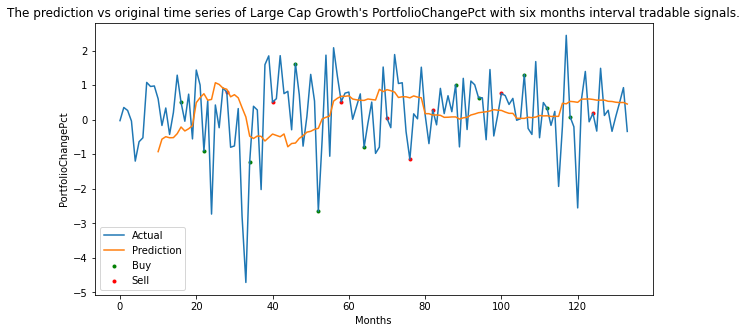

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


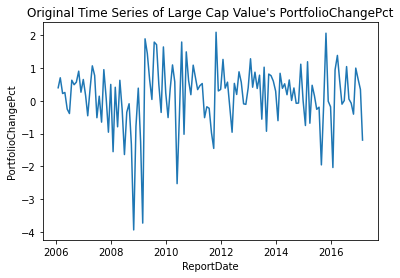

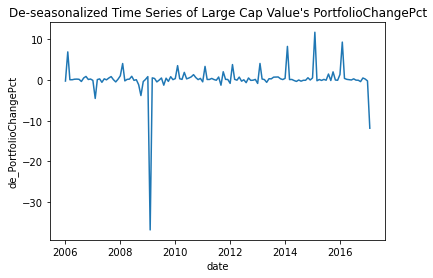

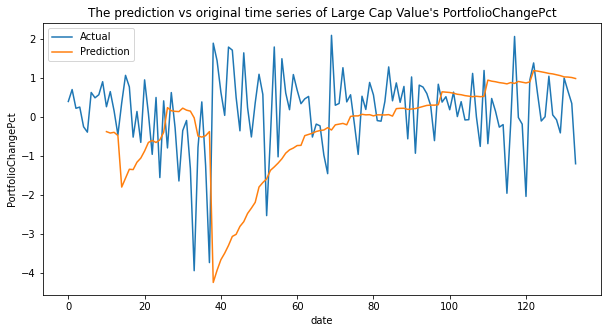

The MSE of the Large Cap Value PortfolioChangePct time series prediction is 15.820402289162308.
The Large Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.4959349593495935. The AUC score is 0.5151891742612538.
The Large Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.47607655502392343.
The Large Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


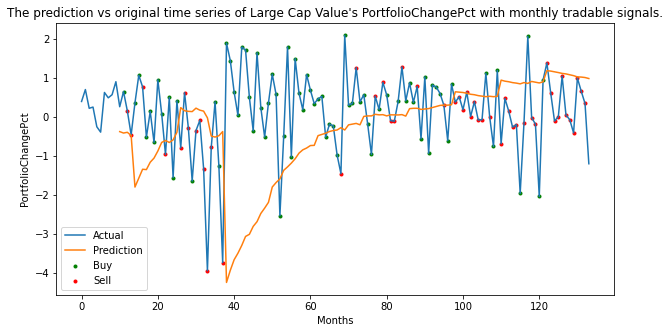

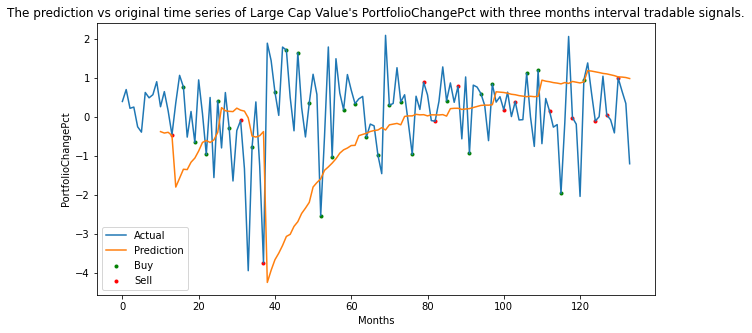

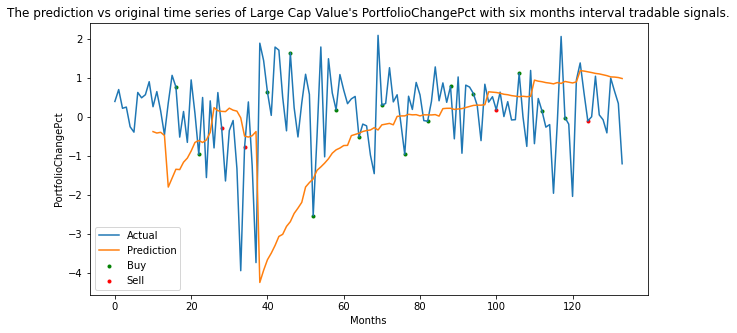

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


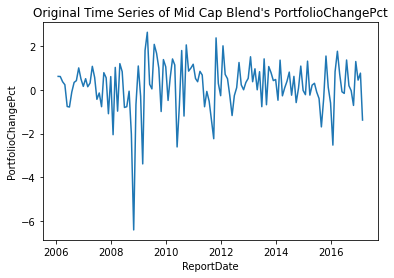

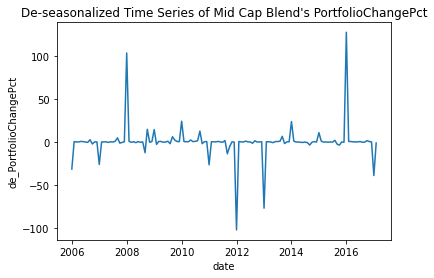

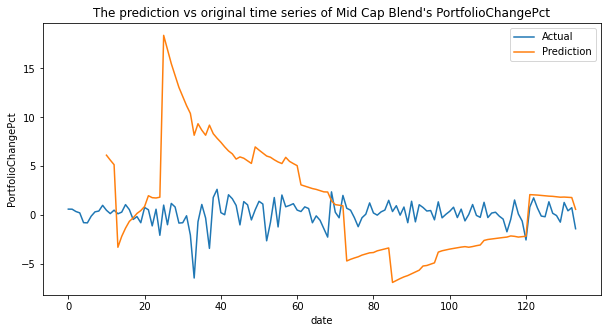

The MSE of the Mid Cap Blend PortfolioChangePct time series prediction is 426.71031911293085.
The Mid Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.5528455284552846. The AUC score is 0.5488466757123474.
The Mid Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5607142857142857.
The Mid Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.30000000000000004.


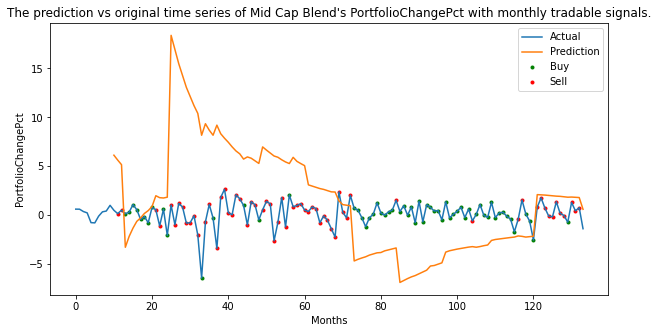

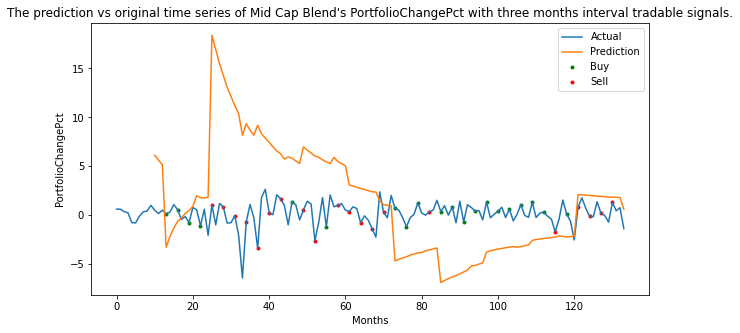

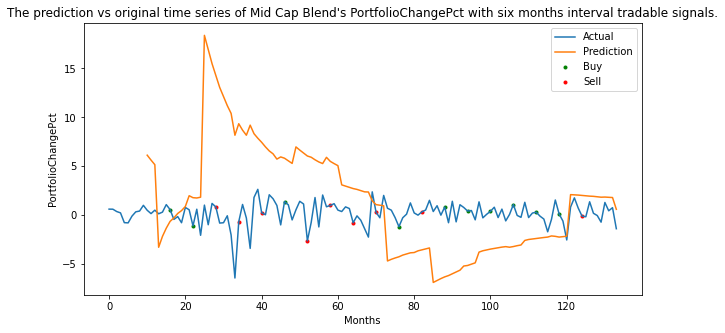

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


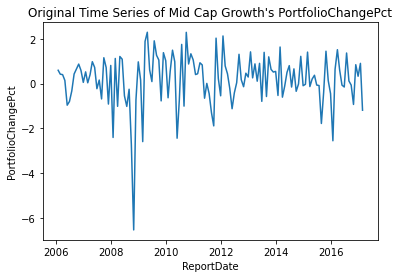

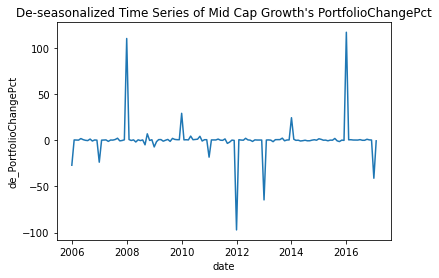

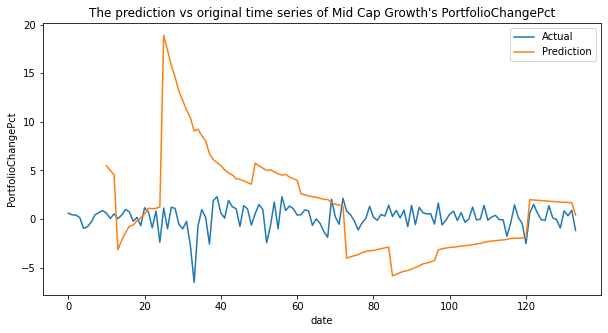

The MSE of the Mid Cap Growth PortfolioChangePct time series prediction is 386.6297171786576.
The Mid Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.6016260162601627. The AUC score is 0.5996732026143792.
The Mid Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5607142857142857.
The Mid Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.30000000000000004.


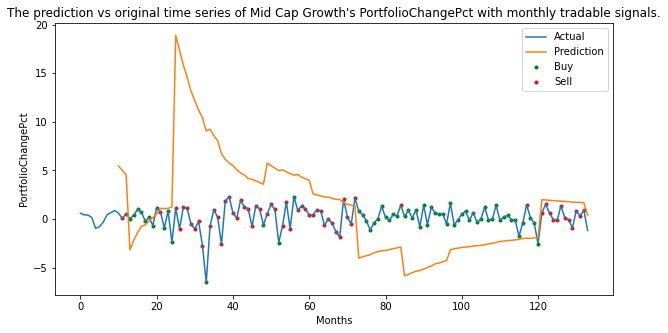

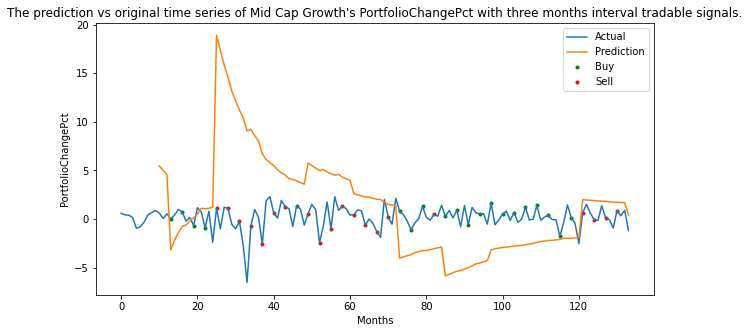

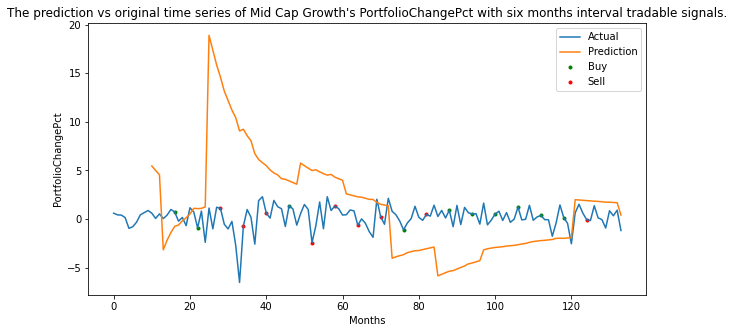

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


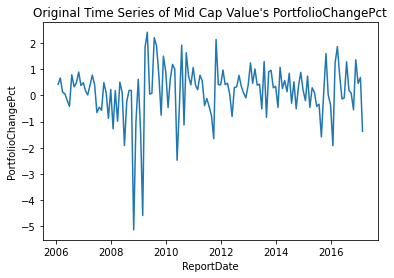

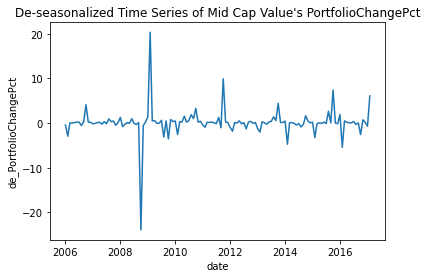

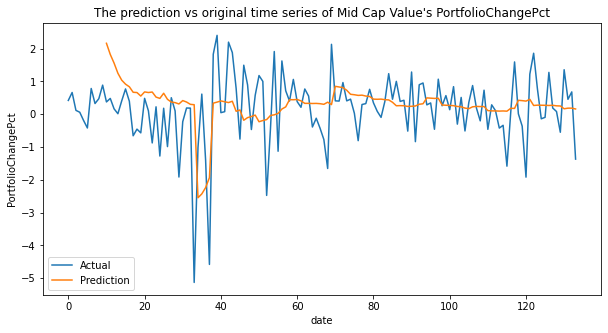

The MSE of the Mid Cap Value PortfolioChangePct time series prediction is 11.954858422868183.
The Mid Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.5059701492537313.
The Mid Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.6352657004830917.
The Mid Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.49999999999999994.


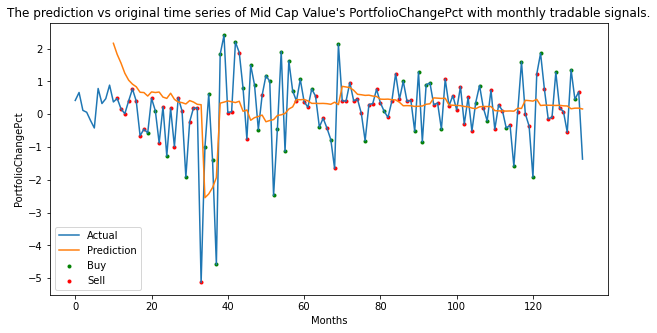

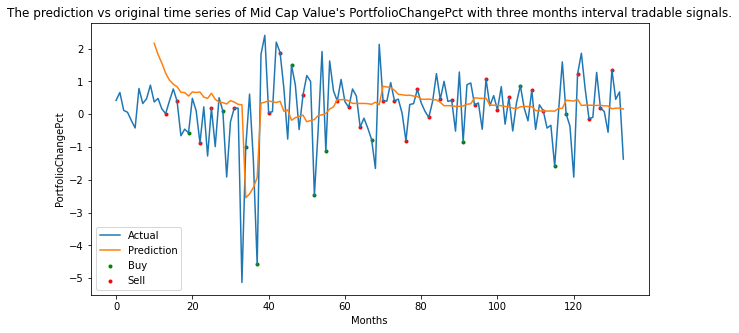

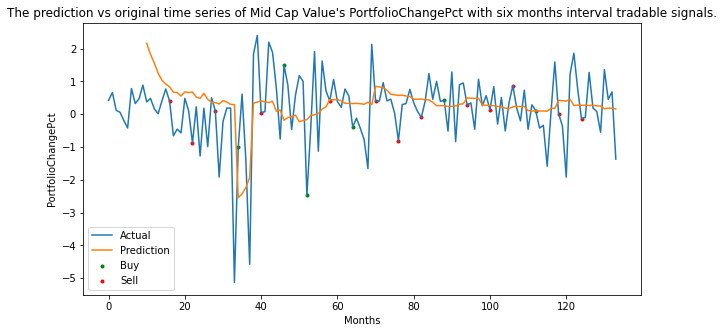

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


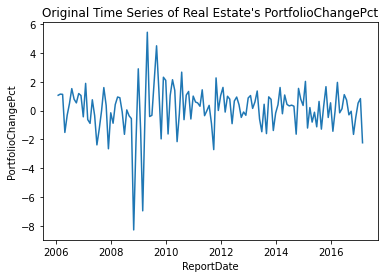

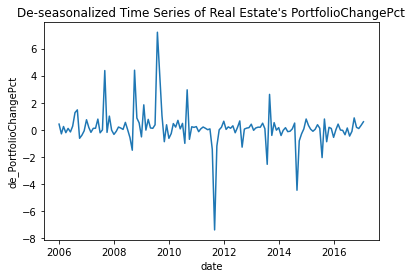

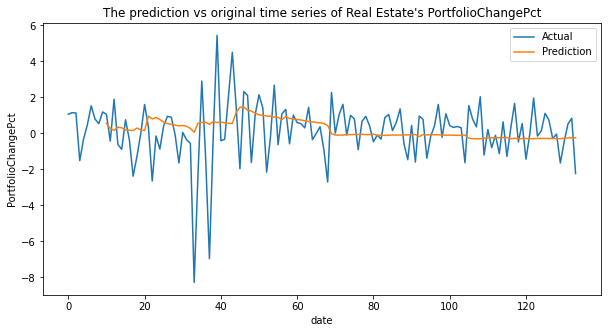

The MSE of the Real Estate PortfolioChangePct time series prediction is 2.0242386956240814.
The Real Estate PortfolioChangePct one month interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.5081967213114754.
The Real Estate PortfolioChangePct three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.427536231884058.
The Real Estate PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


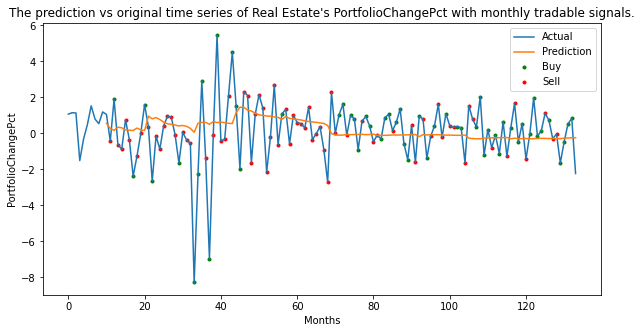

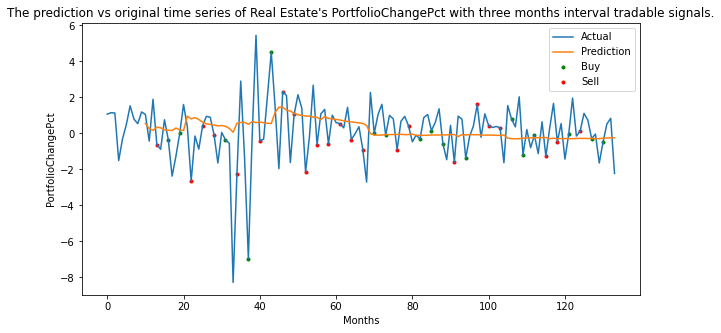

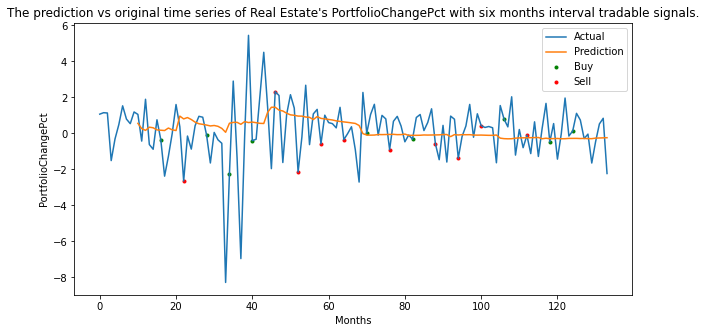

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


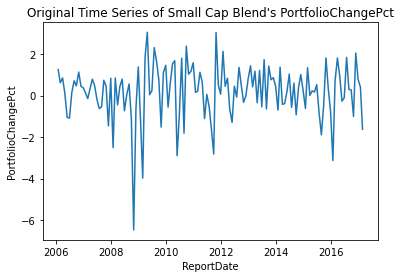

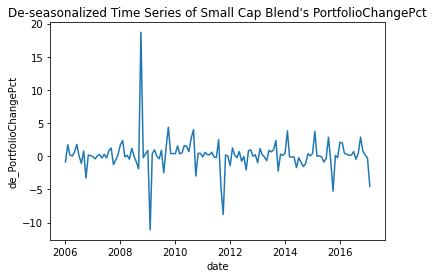

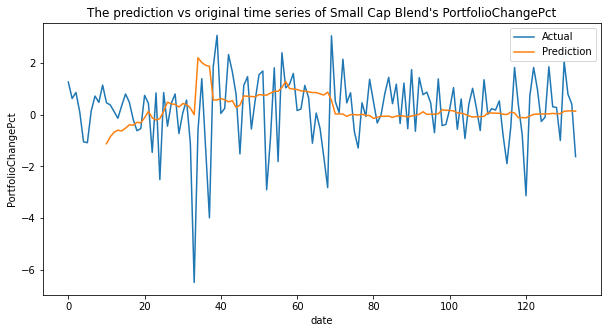

The MSE of the Small Cap Blend PortfolioChangePct time series prediction is 7.030906003289032.
The Small Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.46637072908259347.
The Small Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4940191387559808.
The Small Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.3838383838383838.


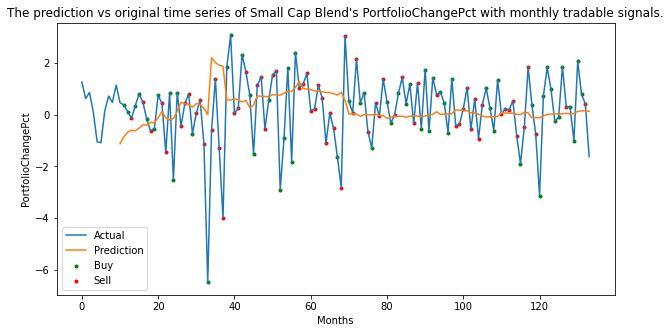

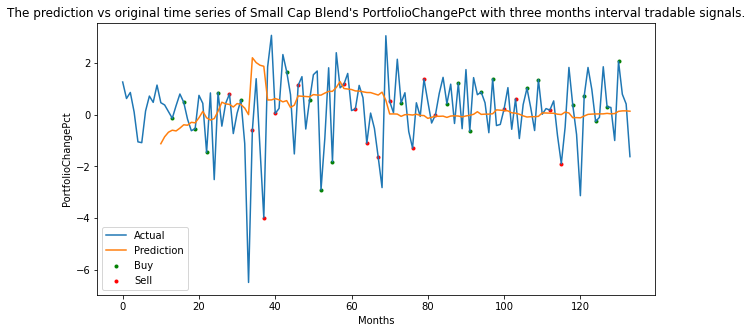

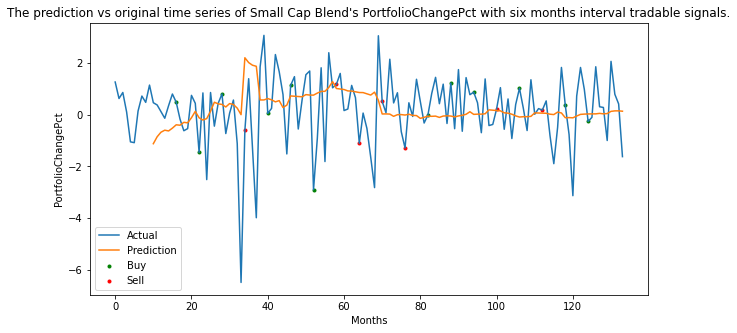

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


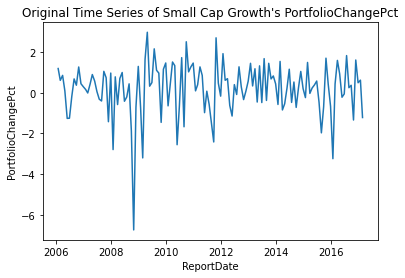

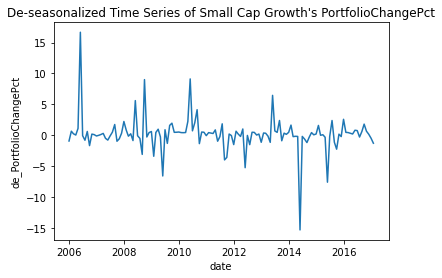

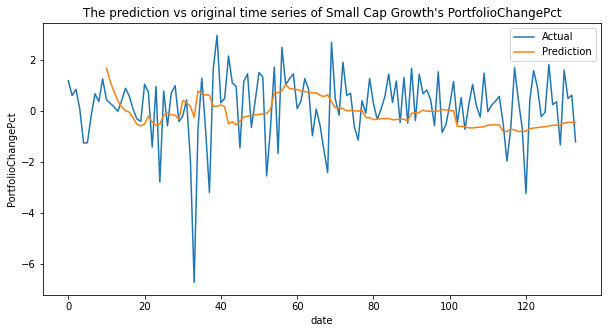

The MSE of the Small Cap Growth PortfolioChangePct time series prediction is 6.636276426895971.
The Small Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.5284552845528455. The AUC score is 0.5244623655913978.
The Small Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.5095693779904307.
The Small Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.30303030303030304.


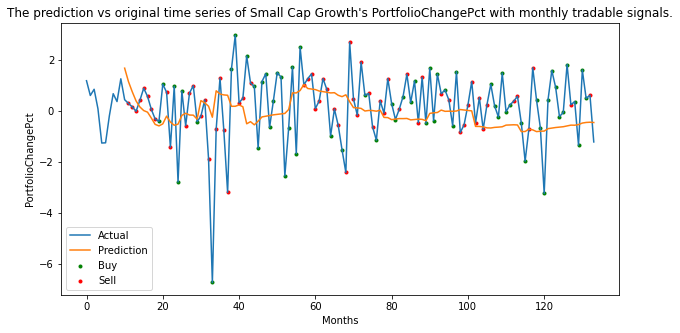

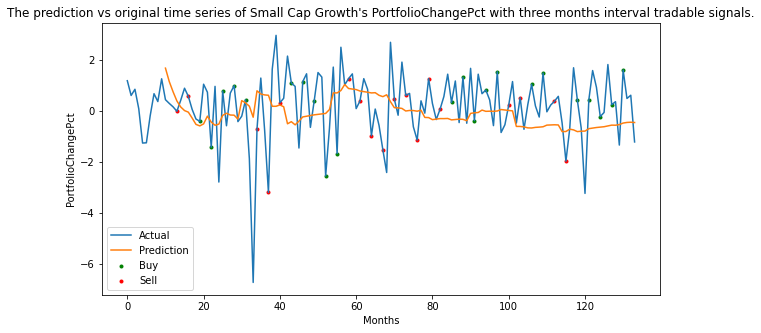

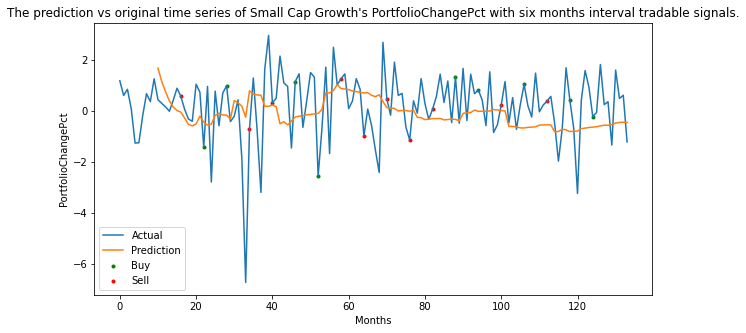

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


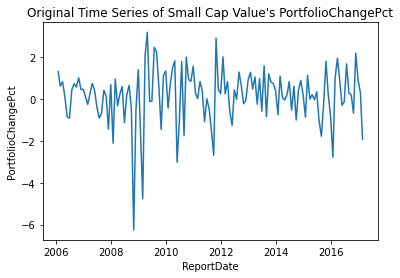

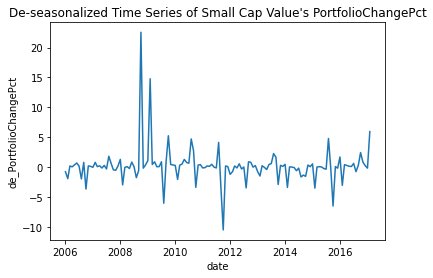

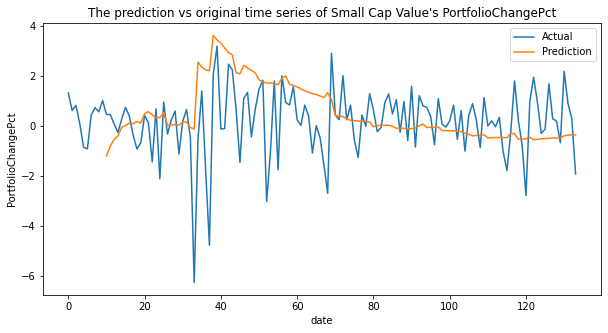

The MSE of the Small Cap Value PortfolioChangePct time series prediction is 10.30387612039732.
The Small Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5772357723577236. The AUC score is 0.5738127544097693.
The Small Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.6341463414634146. The AUC score is 0.6321428571428571.
The Small Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


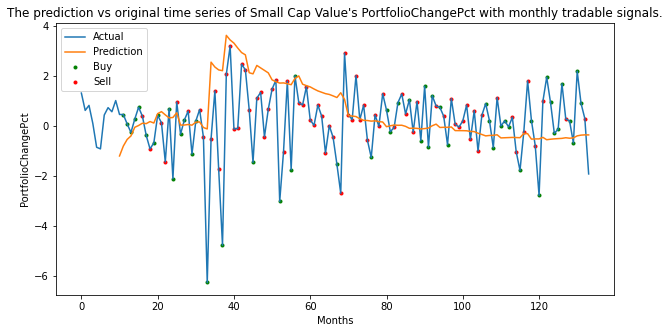

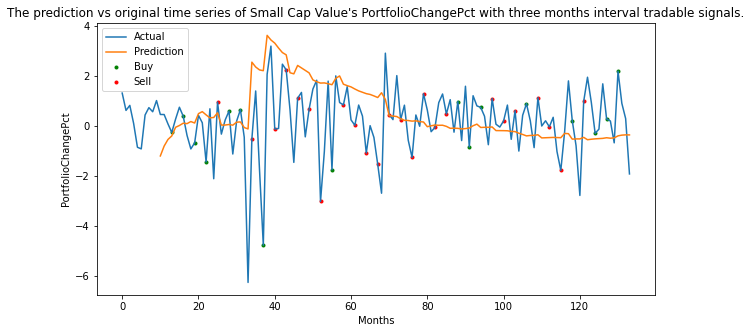

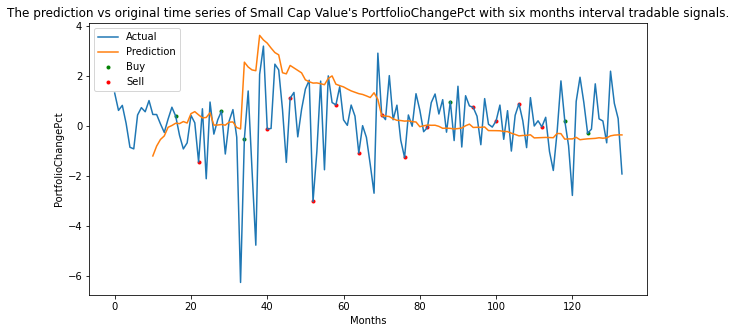

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


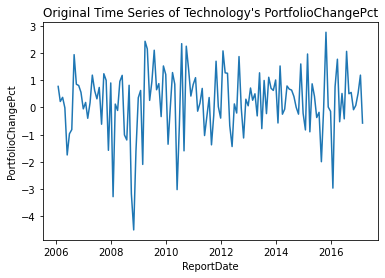

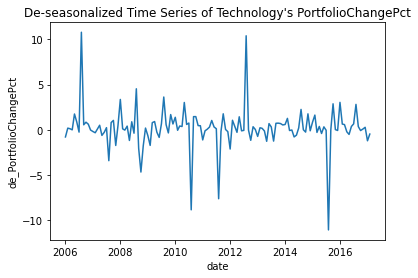

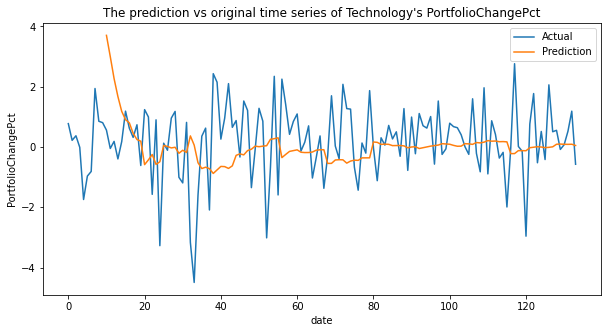

The MSE of the Technology PortfolioChangePct time series prediction is 5.116681670231317.
The Technology PortfolioChangePct one month interval prediction's accuracy is 0.43089430894308944. The AUC score is 0.42807112068965514.
The Technology PortfolioChangePct three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.538647342995169.
The Technology PortfolioChangePct six months interval prediction's accuracy is 0.55. The AUC score is 0.5606060606060607.


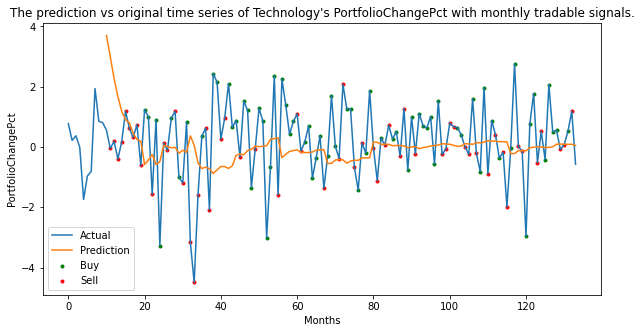

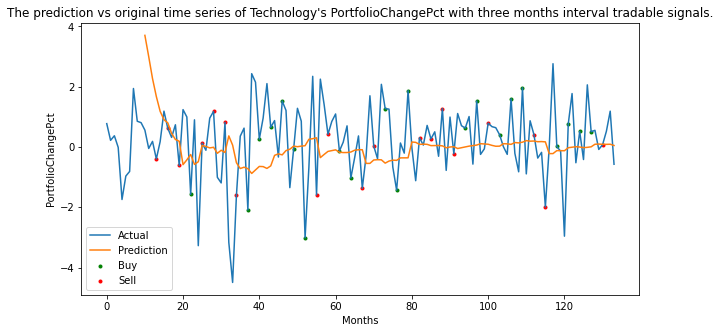

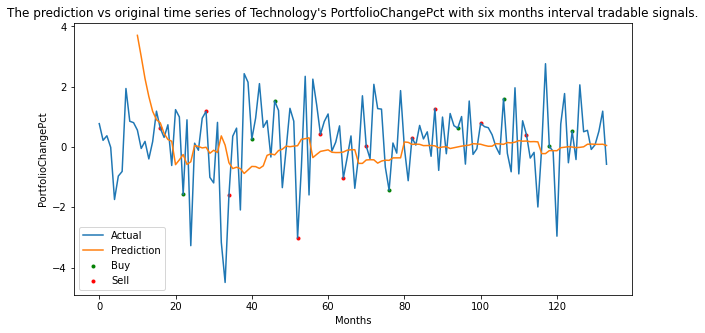

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


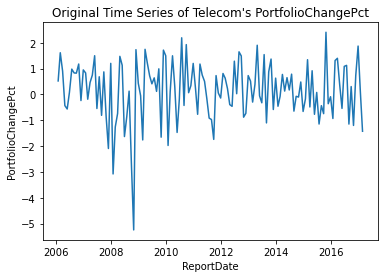

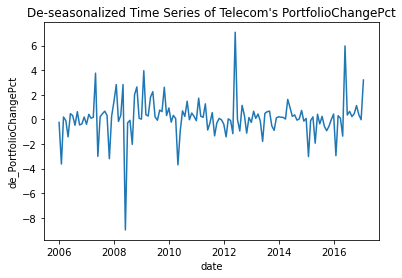

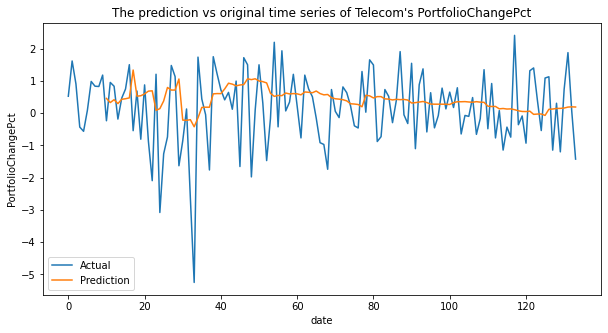

The MSE of the Telecom PortfolioChangePct time series prediction is 3.06851195005149.
The Telecom PortfolioChangePct one month interval prediction's accuracy is 0.4715447154471545. The AUC score is 0.4718614718614718.
The Telecom PortfolioChangePct three months interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.4730392156862745.
The Telecom PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.5.


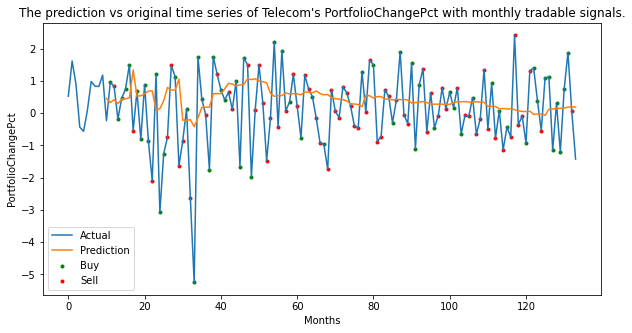

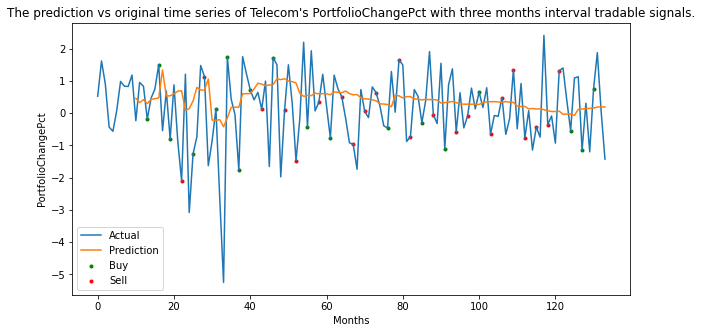

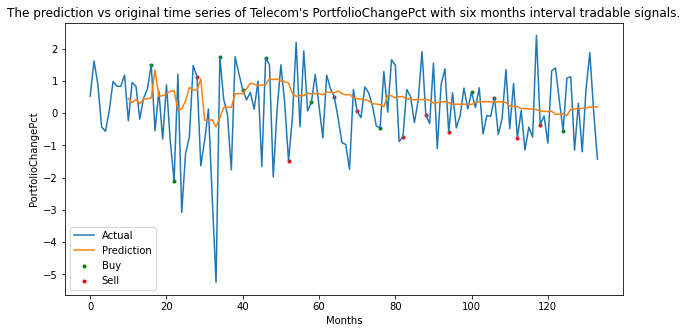

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


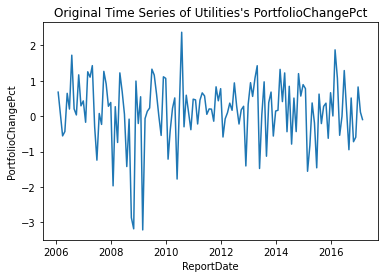

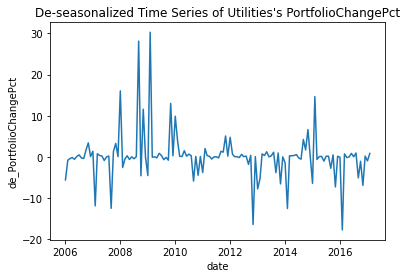

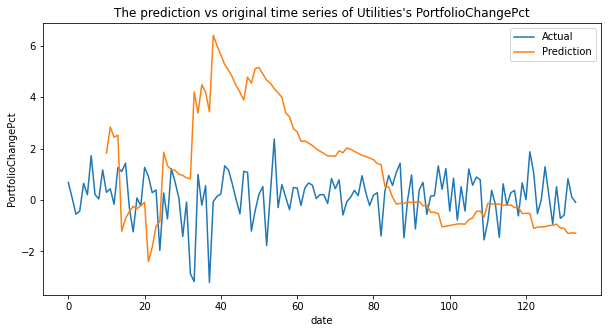

The MSE of the Utilities PortfolioChangePct time series prediction is 37.43806993290307.
The Utilities PortfolioChangePct one month interval prediction's accuracy is 0.5284552845528455. The AUC score is 0.5245901639344263.
The Utilities PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.5072463768115942.
The Utilities PortfolioChangePct six months interval prediction's accuracy is 0.45. The AUC score is 0.45.


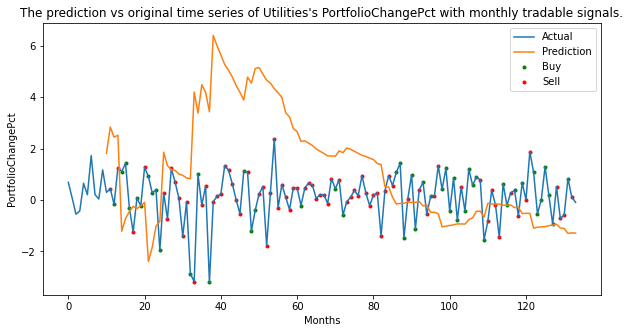

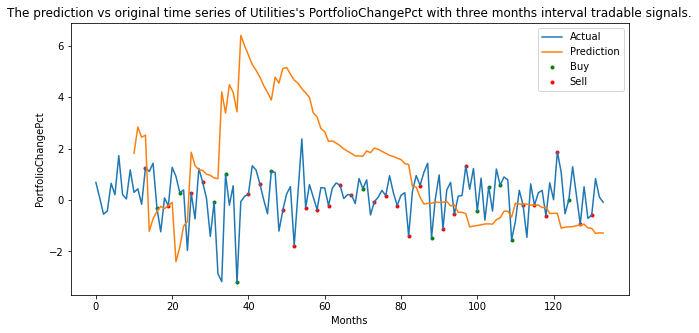

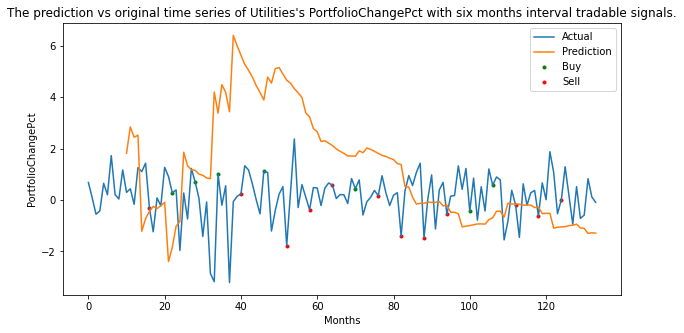

In [83]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'ETF', target = 'PortfolioChangePct')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

ETF_PortfolioChangePct = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [84]:
ETF_PortfolioChangePct

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,16.860363,0.609756,0.612894,0.536585,0.532609,0.45,0.459596,29,29,19,46,9,10,9,13,4,4,7,5
1,Consumer Goods,329.509874,0.455285,0.457625,0.414634,0.413095,0.40,0.393939,33,42,25,23,10,13,11,7,5,6,6,3
2,Energy,169.933114,0.463415,0.471983,0.512195,0.520335,0.50,0.494949,33,41,25,24,12,13,7,9,6,5,5,4
3,Financials,1.133827,0.536585,0.530763,0.658537,0.663095,0.60,0.585859,24,27,30,42,10,3,11,17,4,3,5,8
4,Health Care/Biotech,13.420903,0.390244,0.398381,0.487805,0.476077,0.60,0.583333,27,45,30,21,14,13,8,6,8,4,4,4
5,Industrials,3.866600,0.471545,0.483516,0.560976,0.563095,0.45,0.429293,28,40,25,30,13,11,7,10,7,7,4,2
6,Large Cap Blend,0.925196,0.463415,0.468956,0.560976,0.559524,0.35,0.350000,25,38,28,32,13,10,8,10,4,7,6,3
7,Large Cap Growth,3.665488,0.495935,0.500000,0.707317,0.714976,0.50,0.500000,30,32,30,31,14,8,4,15,6,6,4,4
8,Large Cap Value,15.820402,0.495935,0.515189,0.487805,0.476077,0.35,0.350000,31,41,21,30,14,13,8,6,6,9,4,1
9,Mid Cap Blend,426.710319,0.552846,0.548847,0.560976,0.560714,0.30,0.300000,30,30,25,38,11,9,9,12,3,7,7,3


In [85]:
ETF_PortfolioChangePct.to_csv('ETF_PortfolioChangePct.csv')

#### RE PCP

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


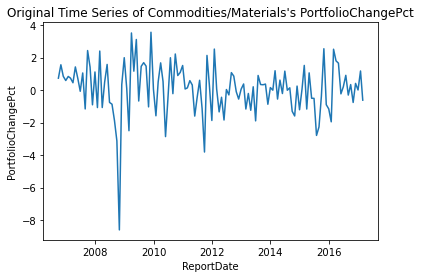

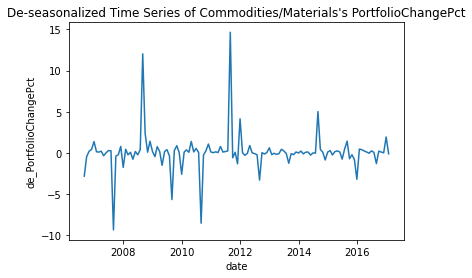

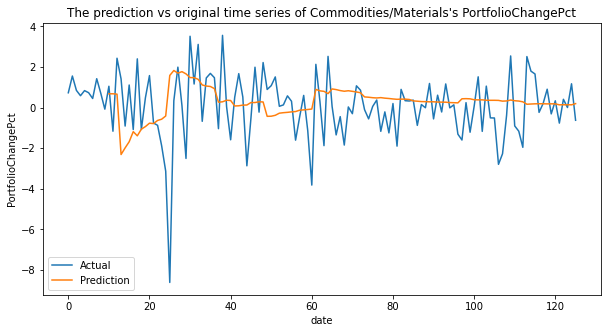

The MSE of the Commodities/Materials PortfolioChangePct time series prediction is 6.529943743674858.
The Commodities/Materials PortfolioChangePct one month interval prediction's accuracy is 0.4782608695652174. The AUC score is 0.4761166253101736.
The Commodities/Materials PortfolioChangePct three months interval prediction's accuracy is 0.47368421052631576. The AUC score is 0.484593837535014.
The Commodities/Materials PortfolioChangePct six months interval prediction's accuracy is 0.5789473684210527. The AUC score is 0.636904761904762.


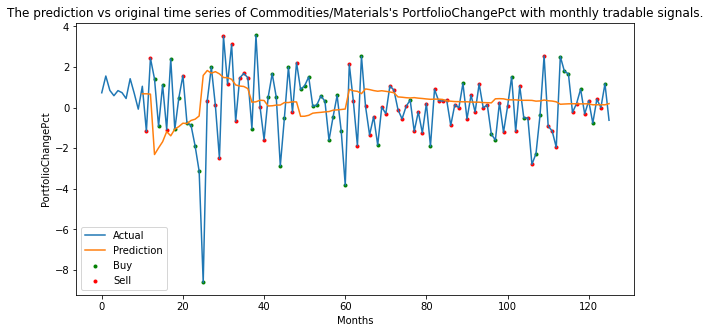

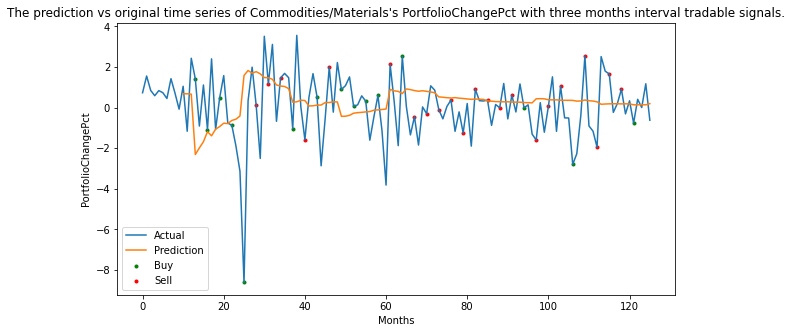

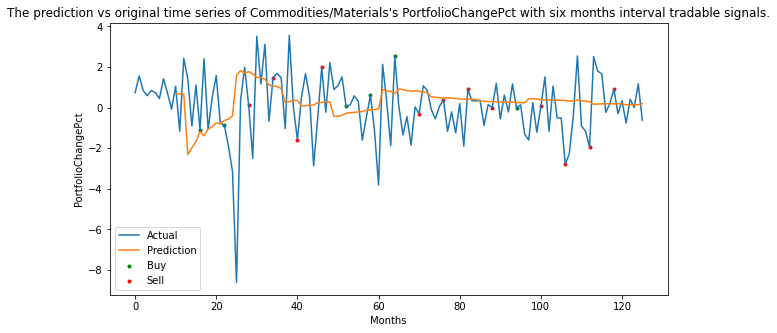

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


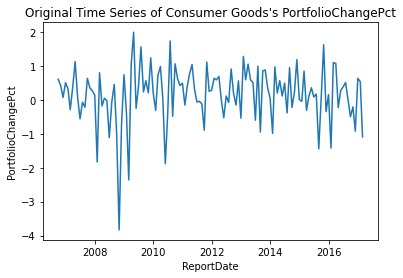

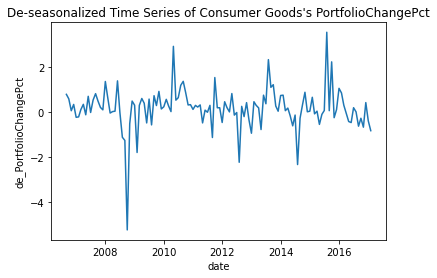

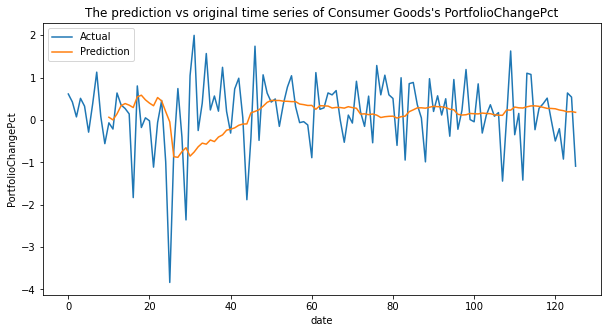

The MSE of the Consumer Goods PortfolioChangePct time series prediction is 1.0083862514573345.
The Consumer Goods PortfolioChangePct one month interval prediction's accuracy is 0.4434782608695652. The AUC score is 0.43611111111111106.
The Consumer Goods PortfolioChangePct three months interval prediction's accuracy is 0.4473684210526316. The AUC score is 0.4472222222222222.
The Consumer Goods PortfolioChangePct six months interval prediction's accuracy is 0.3157894736842105. The AUC score is 0.32386363636363635.


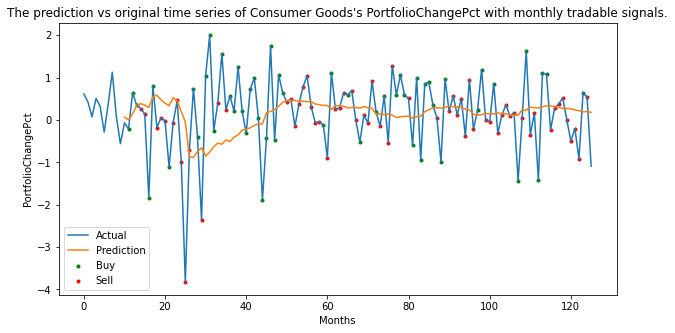

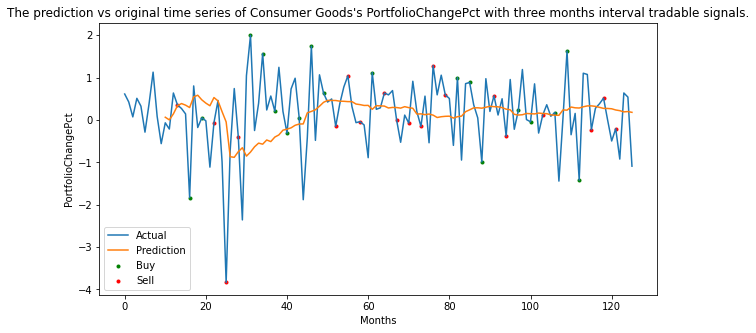

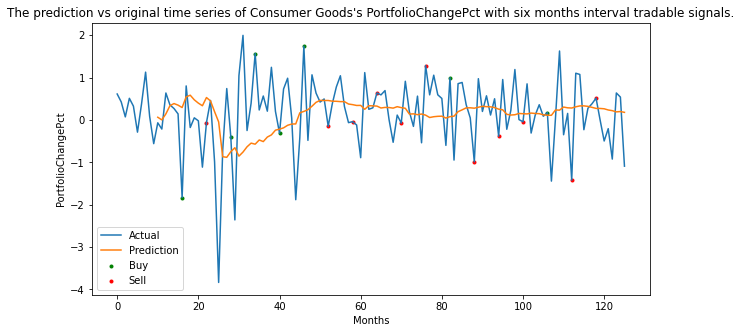

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


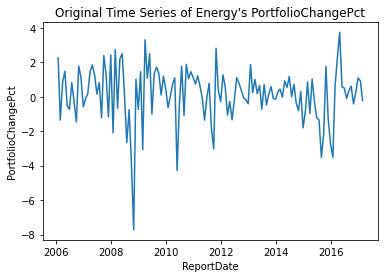

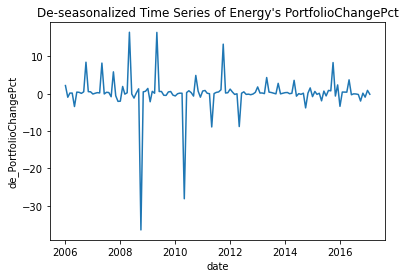

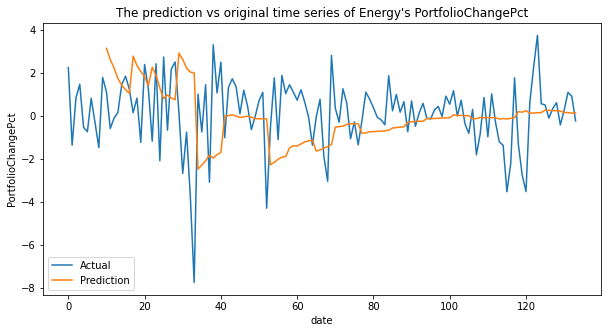

The MSE of the Energy PortfolioChangePct time series prediction is 30.11207072616369.
The Energy PortfolioChangePct one month interval prediction's accuracy is 0.4065040650406504. The AUC score is 0.40823211875843457.
The Energy PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.569377990430622.
The Energy PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35858585858585856.


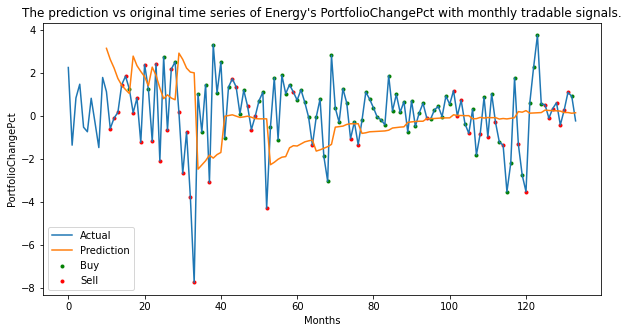

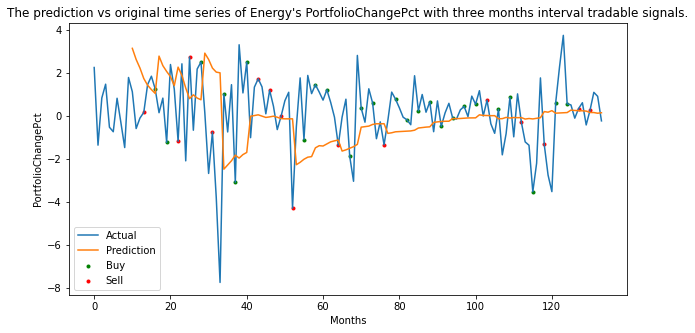

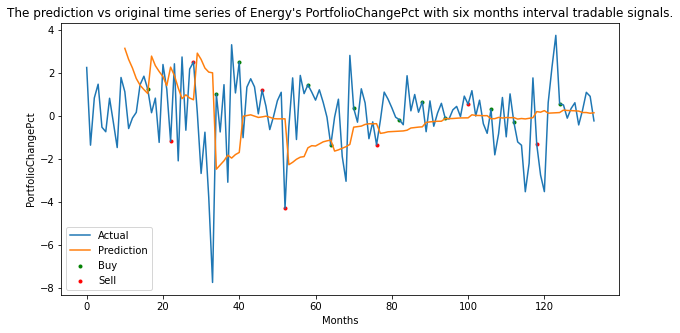

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


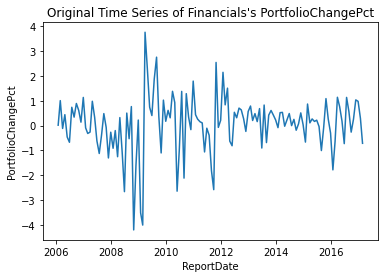

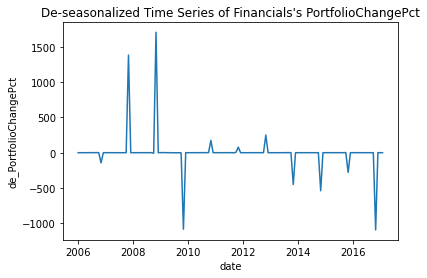

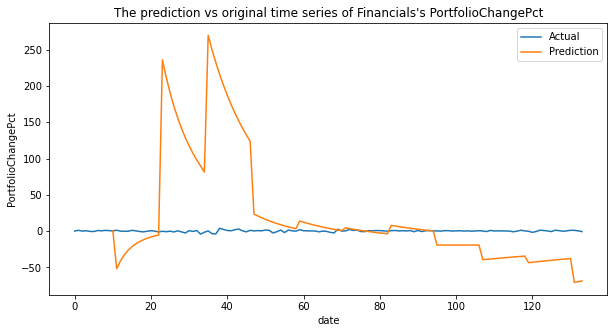

The MSE of the Financials PortfolioChangePct time series prediction is 69668.26177899672.
The Financials PortfolioChangePct one month interval prediction's accuracy is 0.5772357723577236. The AUC score is 0.5664835164835166.
The Financials PortfolioChangePct three months interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.618421052631579.
The Financials PortfolioChangePct six months interval prediction's accuracy is 0.65. The AUC score is 0.6616161616161615.


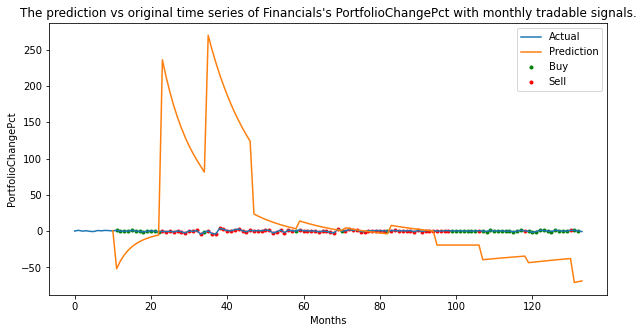

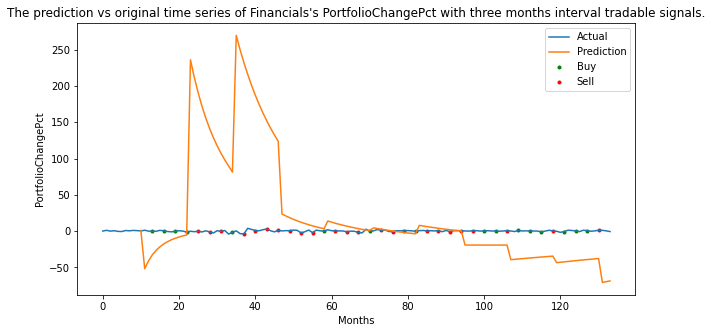

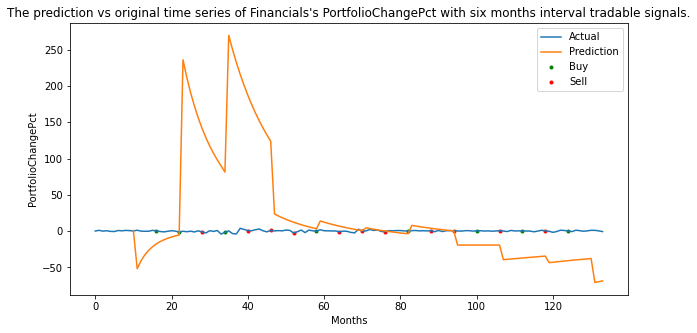

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


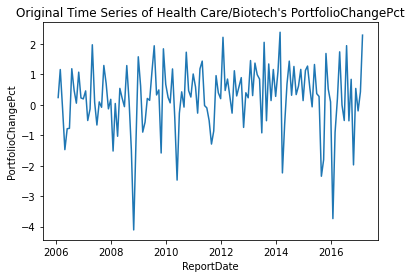

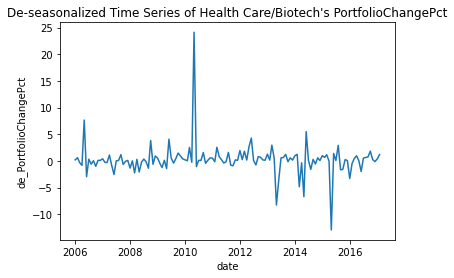

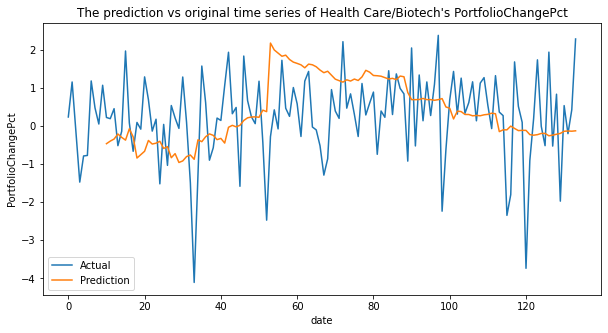

The MSE of the Health Care/Biotech PortfolioChangePct time series prediction is 9.530175544484282.
The Health Care/Biotech PortfolioChangePct one month interval prediction's accuracy is 0.36585365853658536. The AUC score is 0.3669181034482758.
The Health Care/Biotech PortfolioChangePct three months interval prediction's accuracy is 0.6585365853658537. The AUC score is 0.6654589371980677.
The Health Care/Biotech PortfolioChangePct six months interval prediction's accuracy is 0.6. The AUC score is 0.6060606060606062.


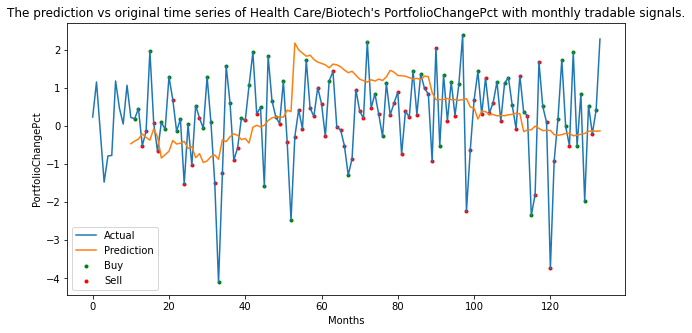

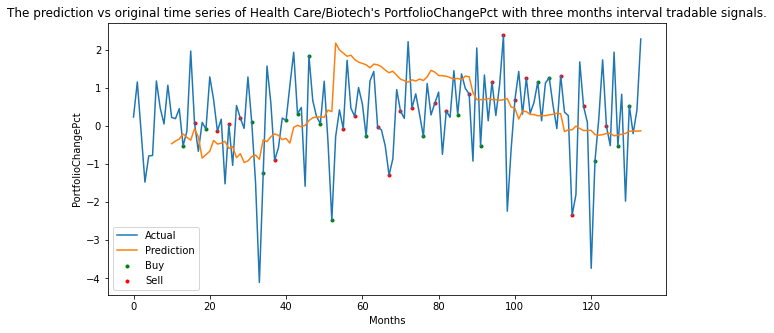

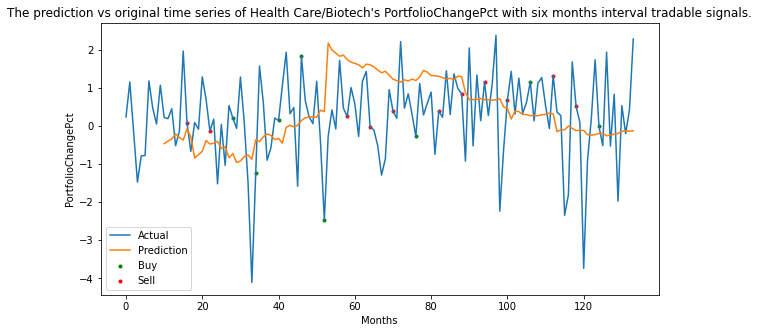

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


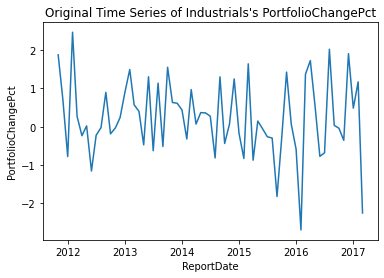

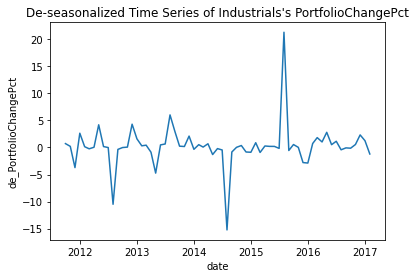

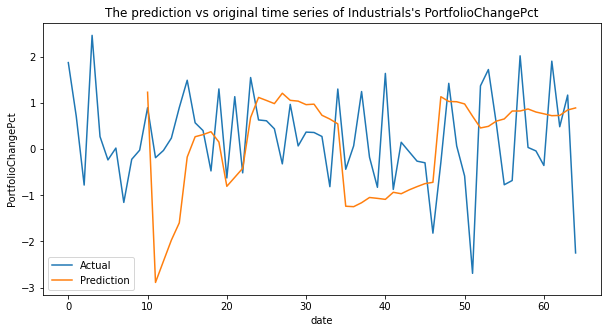

The MSE of the Industrials PortfolioChangePct time series prediction is 19.86093520307119.
The Industrials PortfolioChangePct one month interval prediction's accuracy is 0.48148148148148145. The AUC score is 0.48240469208211134.
The Industrials PortfolioChangePct three months interval prediction's accuracy is 0.5555555555555556. The AUC score is 0.55.
The Industrials PortfolioChangePct six months interval prediction's accuracy is 0.4444444444444444. The AUC score is 0.45000000000000007.


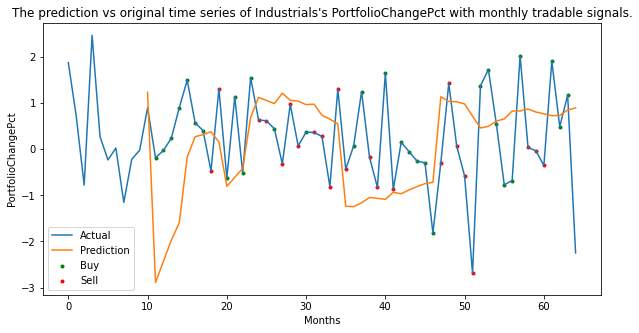

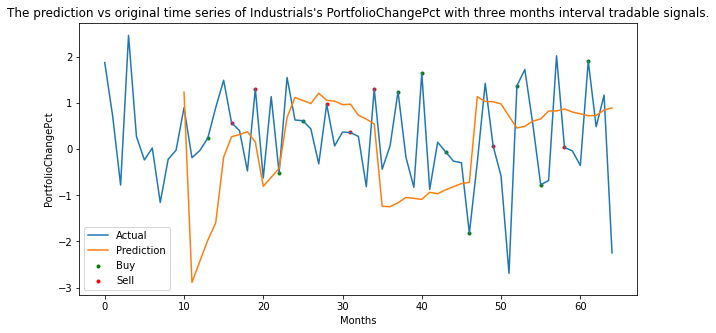

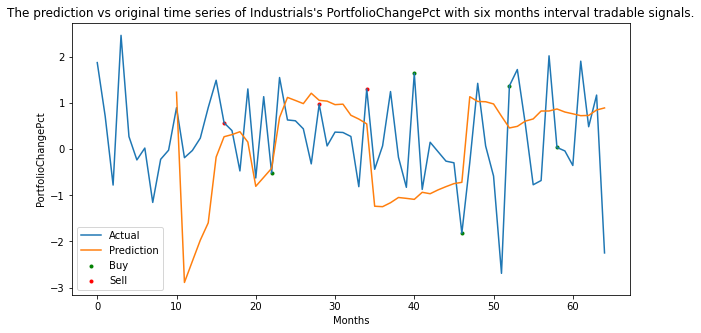

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


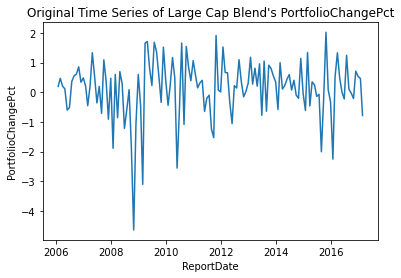

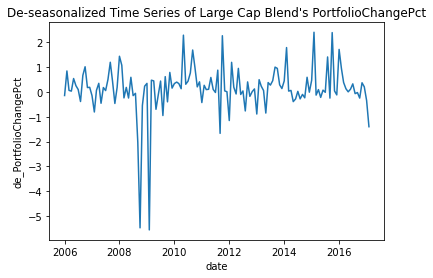

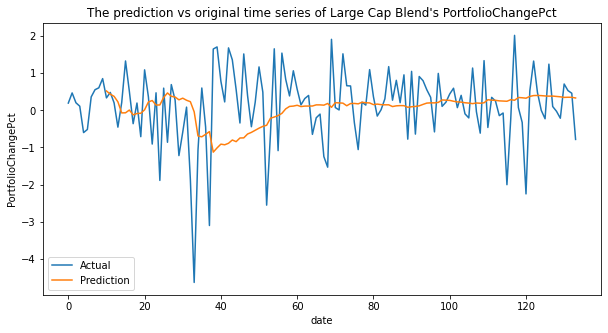

The MSE of the Large Cap Blend PortfolioChangePct time series prediction is 1.0967551753142835.
The Large Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.4959349593495935. The AUC score is 0.5041425020712511.
The Large Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5630952380952381.
The Large Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.3.


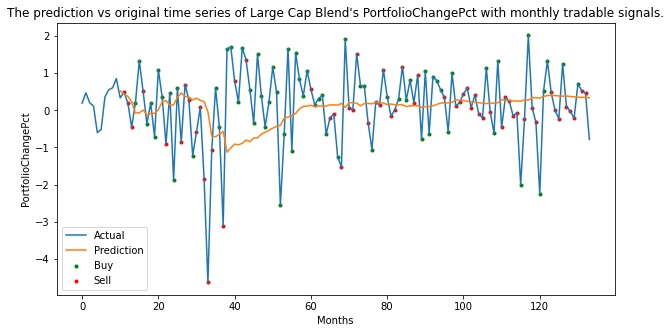

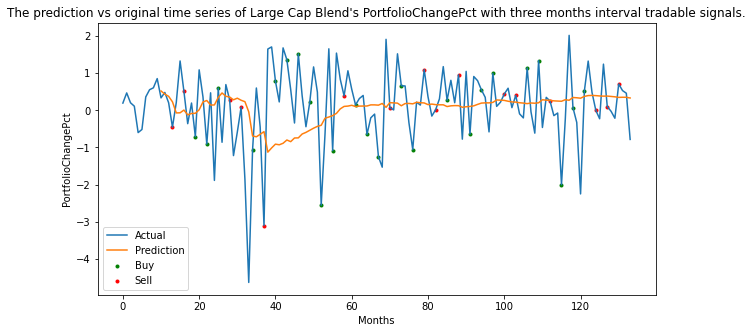

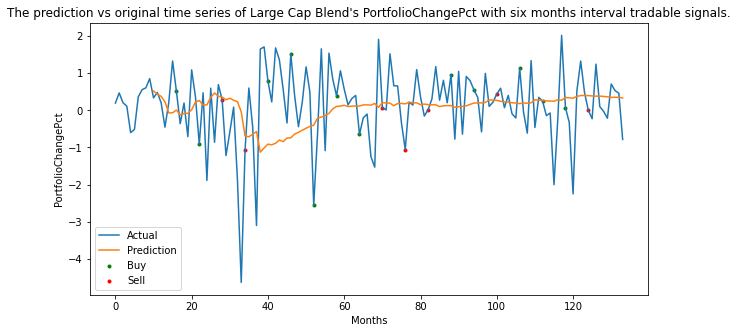

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


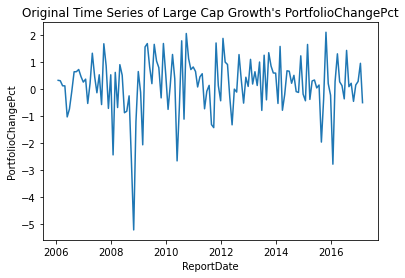

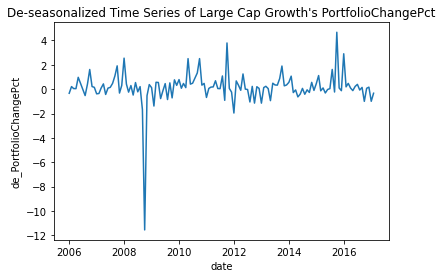

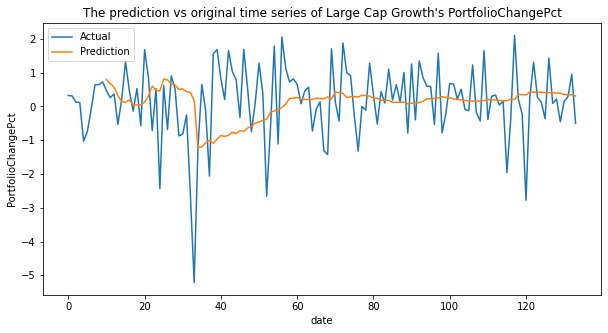

The MSE of the Large Cap Growth PortfolioChangePct time series prediction is 2.1724919644402787.
The Large Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.44715447154471544. The AUC score is 0.43899782135076254.
The Large Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.7073170731707317. The AUC score is 0.7149758454106281.
The Large Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.5.


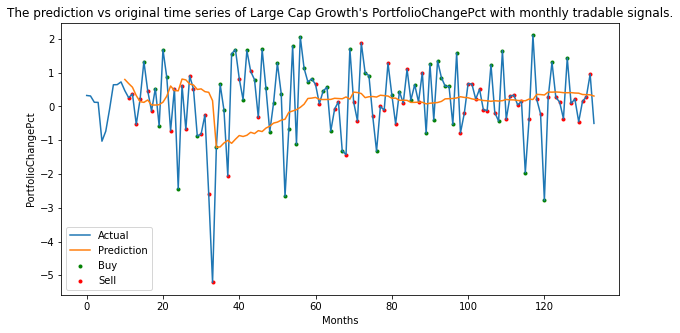

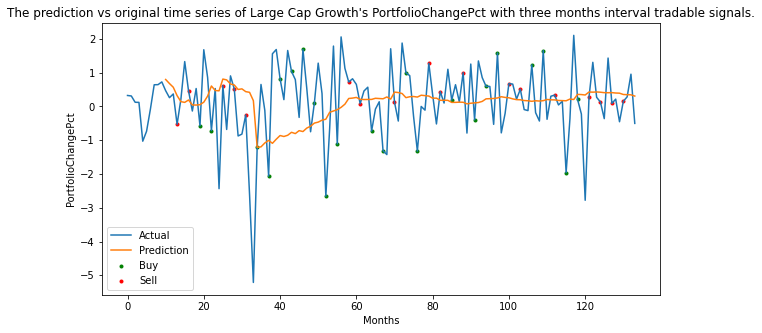

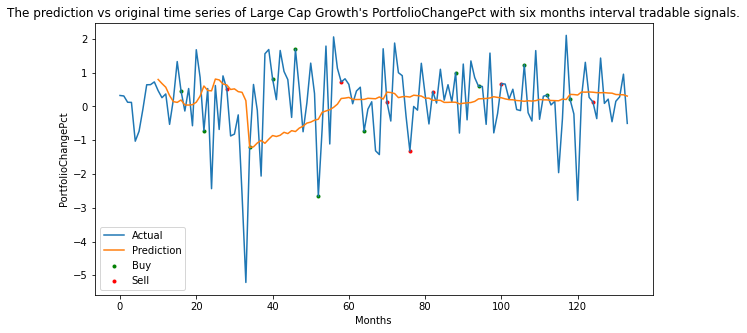

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


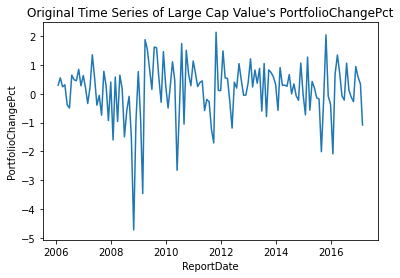

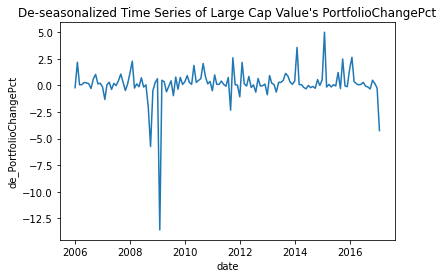

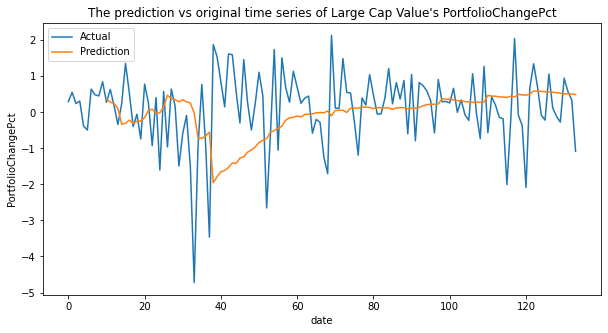

The MSE of the Large Cap Value PortfolioChangePct time series prediction is 2.8914393533359126.
The Large Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5203252032520326. The AUC score is 0.5378723404255319.
The Large Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4904761904761905.
The Large Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.37373737373737376.


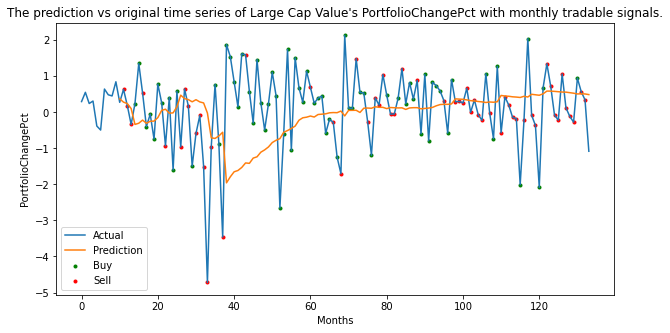

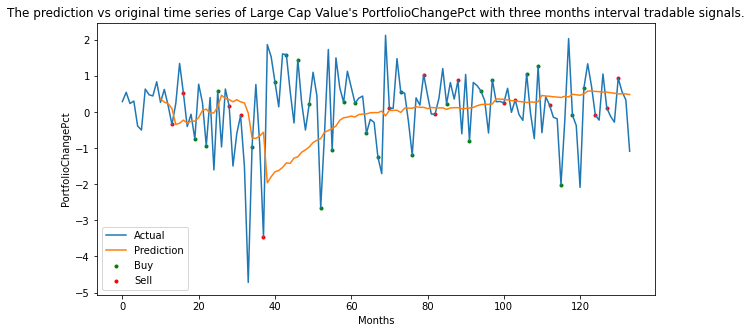

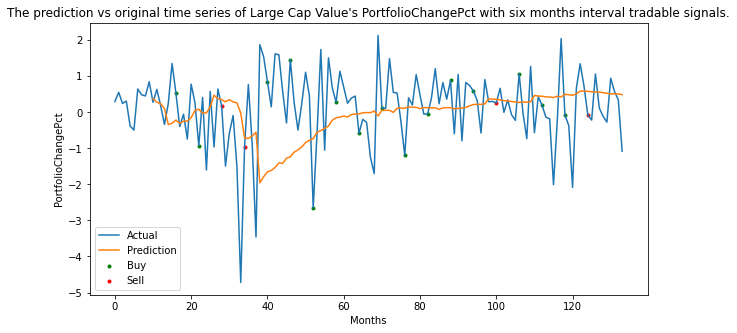

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


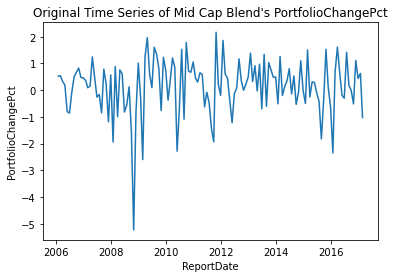

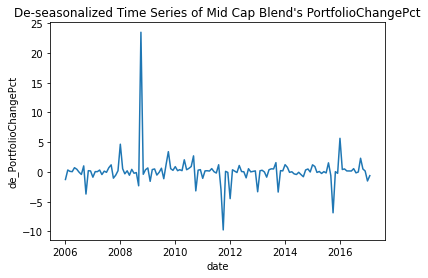

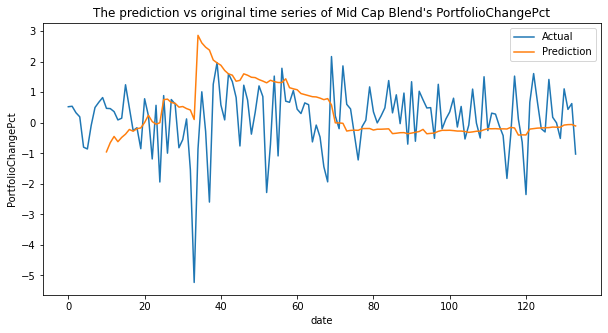

The MSE of the Mid Cap Blend PortfolioChangePct time series prediction is 7.848307266620531.
The Mid Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.5934959349593496. The AUC score is 0.5980769230769231.
The Mid Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.5121951219512195. The AUC score is 0.511904761904762.
The Mid Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.45. The AUC score is 0.44999999999999996.


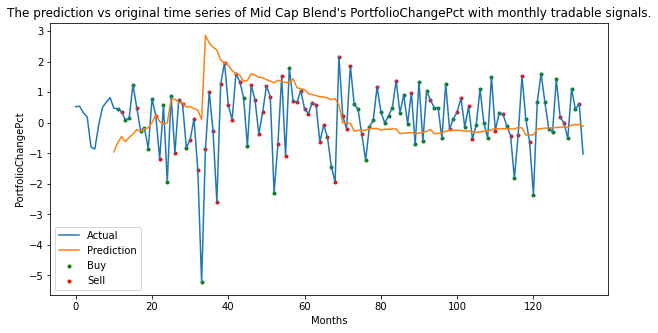

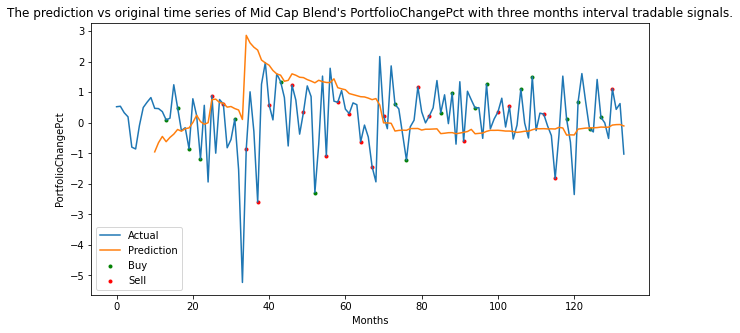

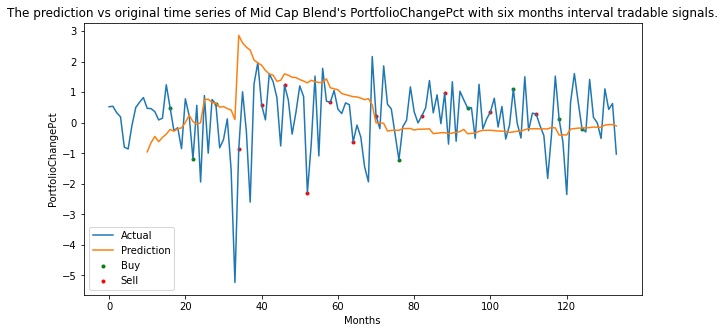

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


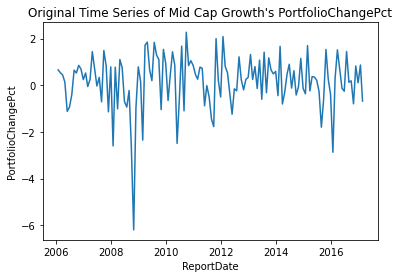

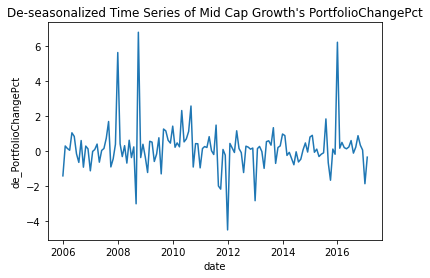

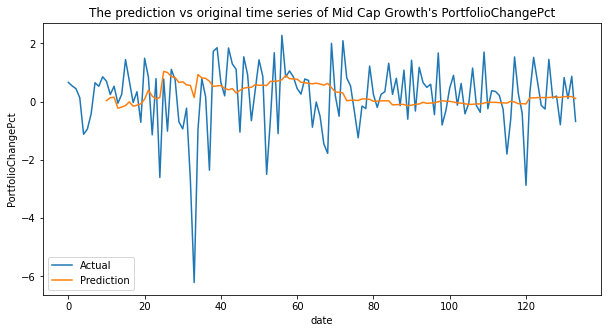

The MSE of the Mid Cap Growth PortfolioChangePct time series prediction is 1.9754206120103845.
The Mid Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.5528455284552846. The AUC score is 0.5574175824175824.
The Mid Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.6095238095238096.
The Mid Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.3484848484848485.


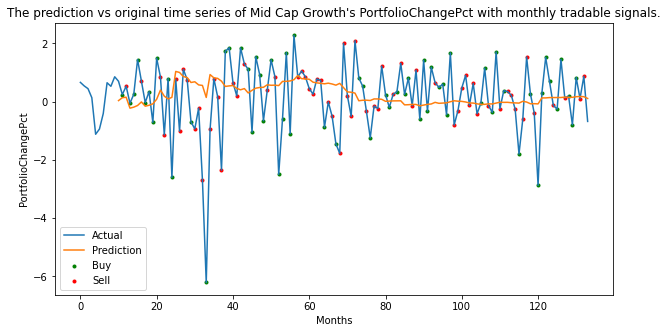

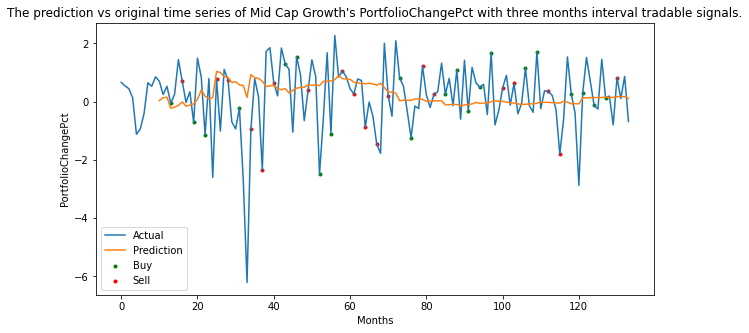

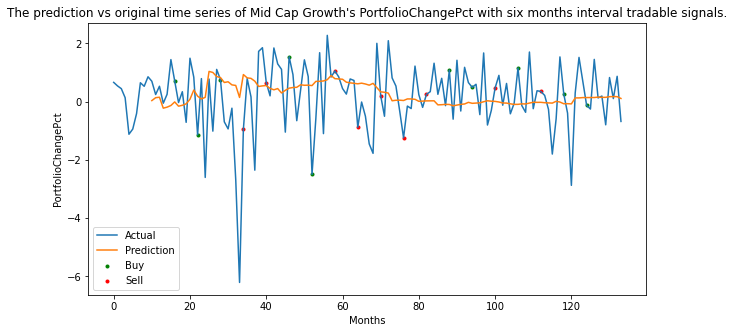

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


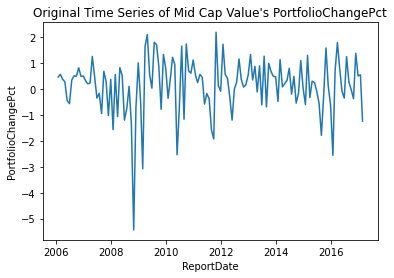

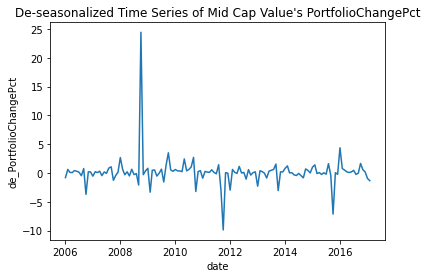

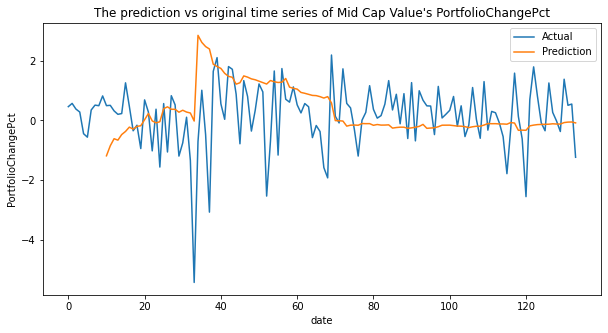

The MSE of the Mid Cap Value PortfolioChangePct time series prediction is 8.024684506851571.
The Mid Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5691056910569106. The AUC score is 0.5632421982877659.
The Mid Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5357142857142857.
The Mid Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.3939393939393939.


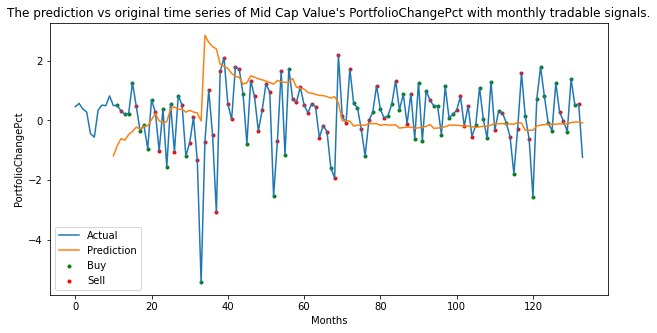

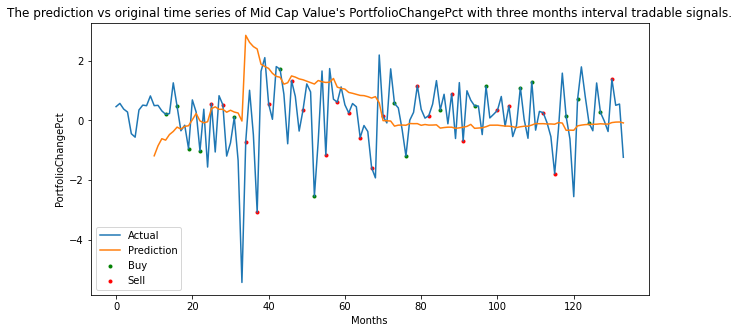

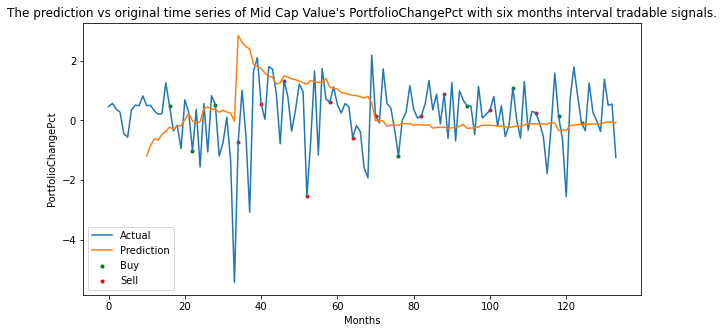

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


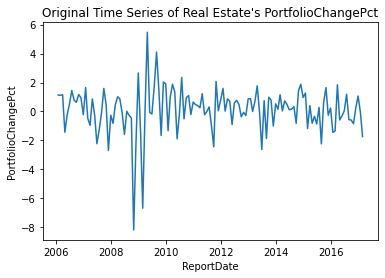

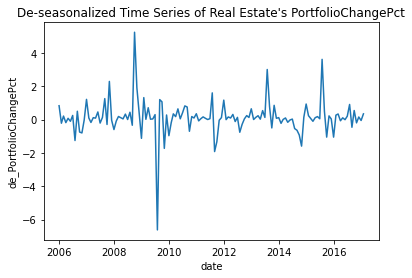

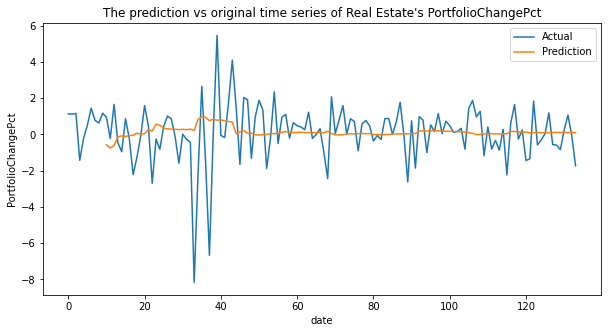

The MSE of the Real Estate PortfolioChangePct time series prediction is 1.2547302017265762.
The Real Estate PortfolioChangePct one month interval prediction's accuracy is 0.5040650406504065. The AUC score is 0.49973118279569895.
The Real Estate PortfolioChangePct three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.6932367149758454.
The Real Estate PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.3939393939393939.


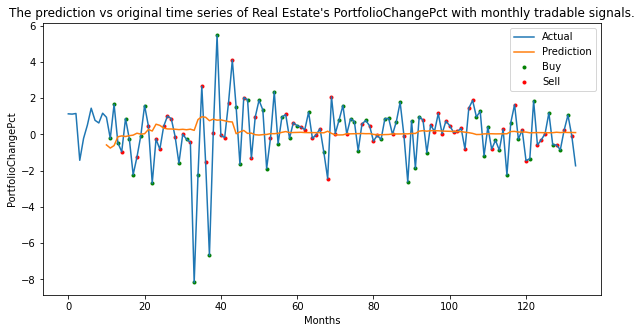

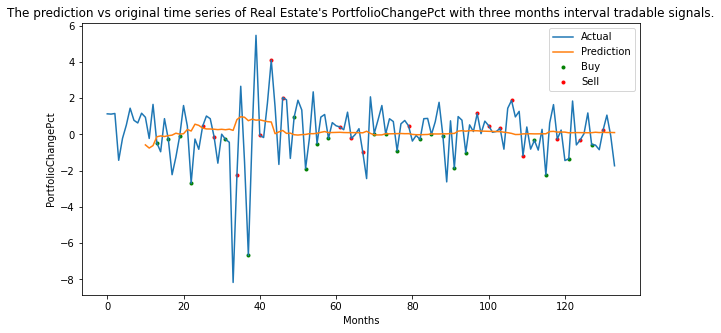

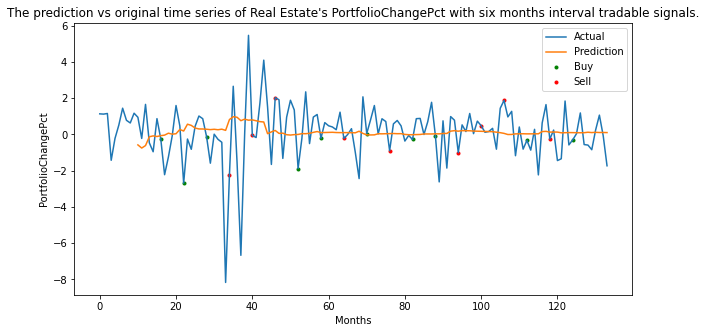

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


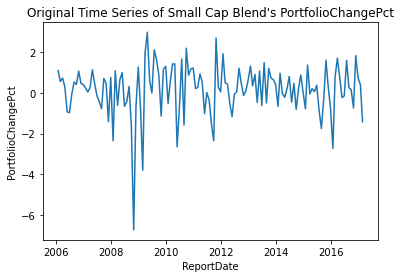

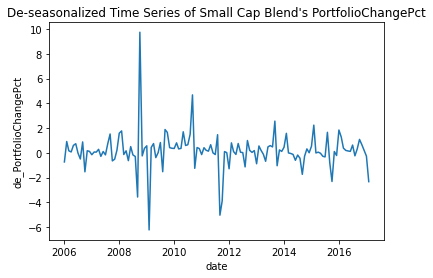

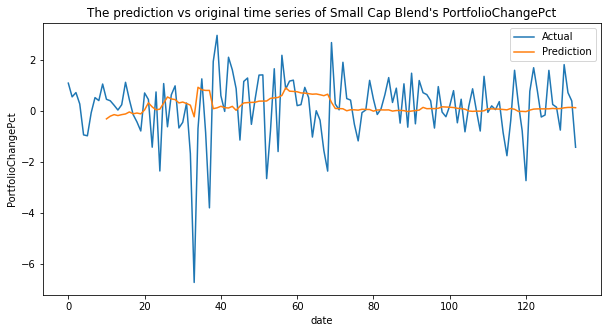

The MSE of the Small Cap Blend PortfolioChangePct time series prediction is 2.5167210967637104.
The Small Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.5284552845528455. The AUC score is 0.5322930800542741.
The Small Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4904761904761905.
The Small Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


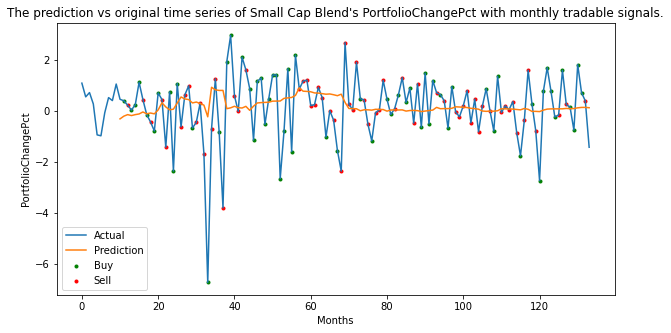

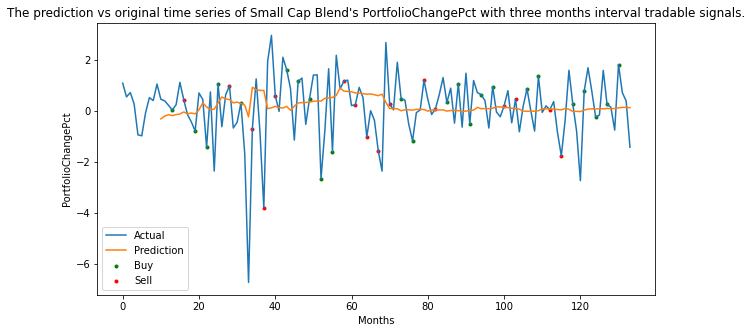

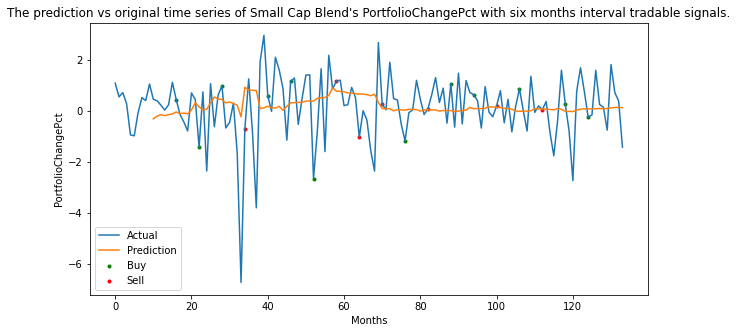

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


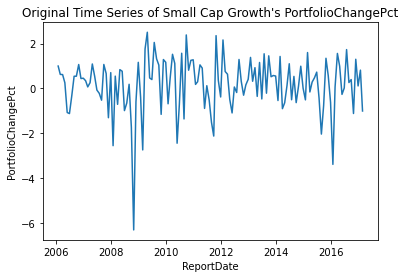

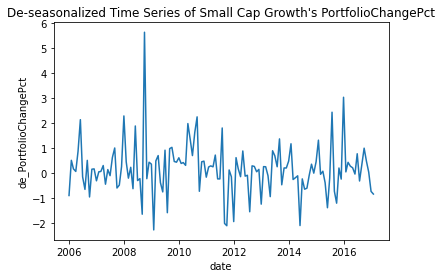

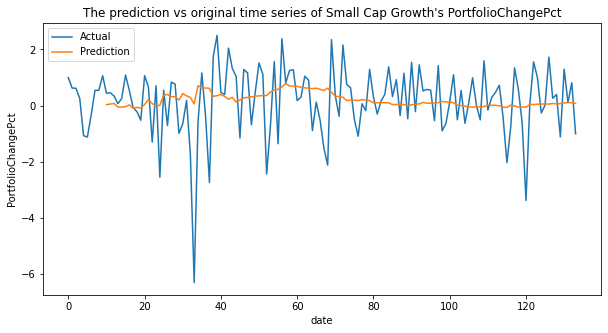

The MSE of the Small Cap Growth PortfolioChangePct time series prediction is 1.1391310927741625.
The Small Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.48079004329004327.
The Small Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5380952380952381.
The Small Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.25. The AUC score is 0.24747474747474746.


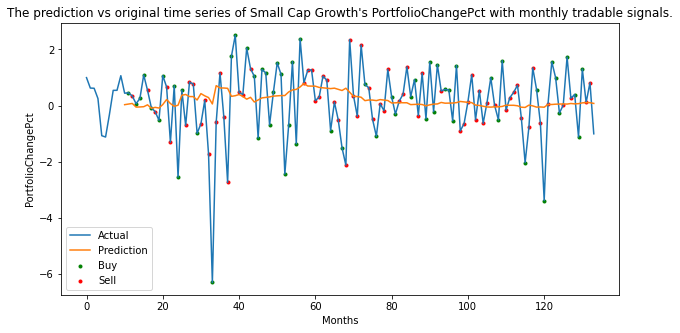

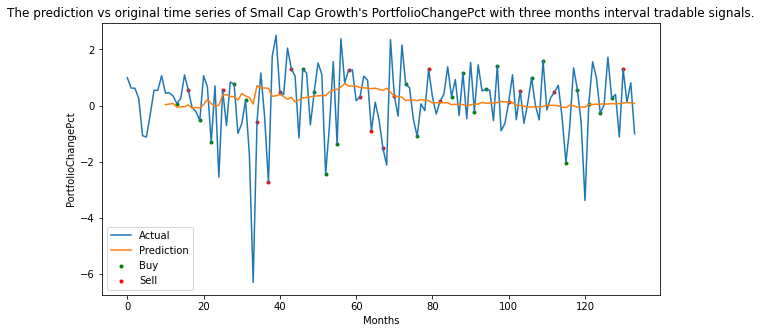

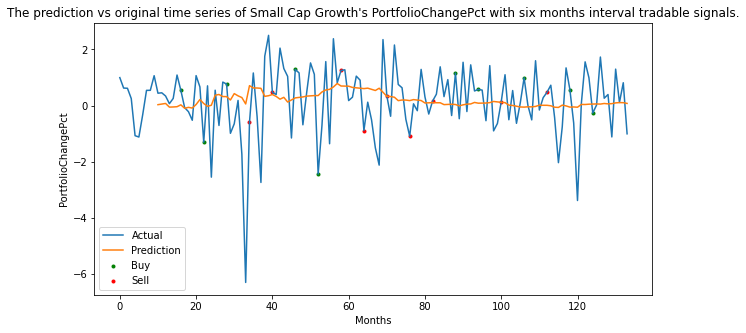

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


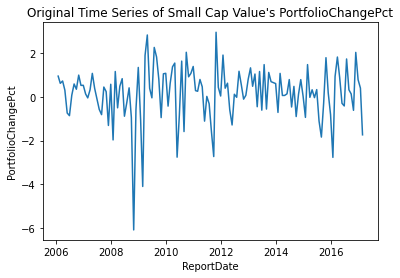

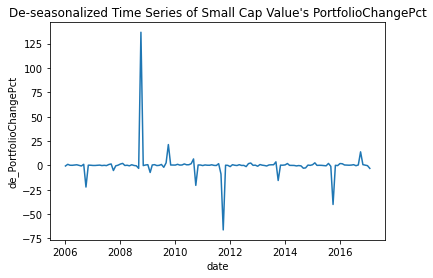

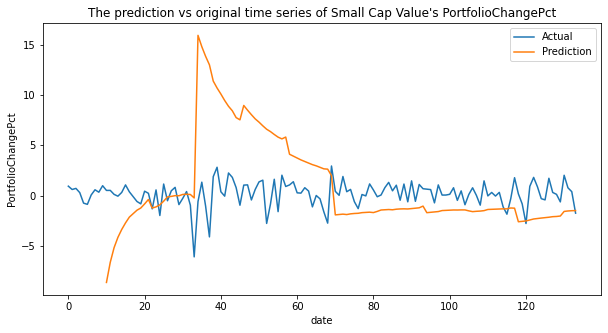

The MSE of the Small Cap Value PortfolioChangePct time series prediction is 236.92650980263872.
The Small Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5446623093681917.
The Small Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.44856459330143544.
The Small Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


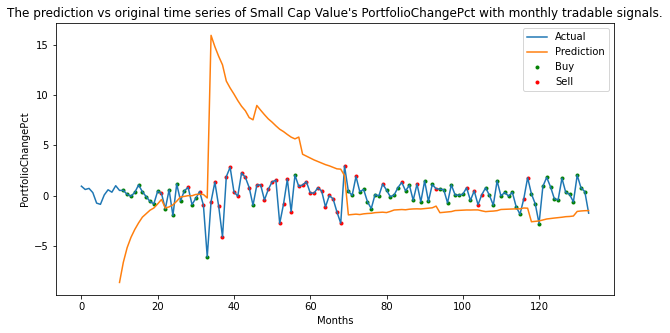

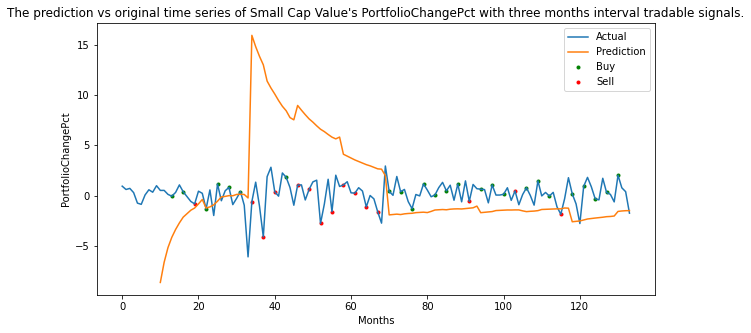

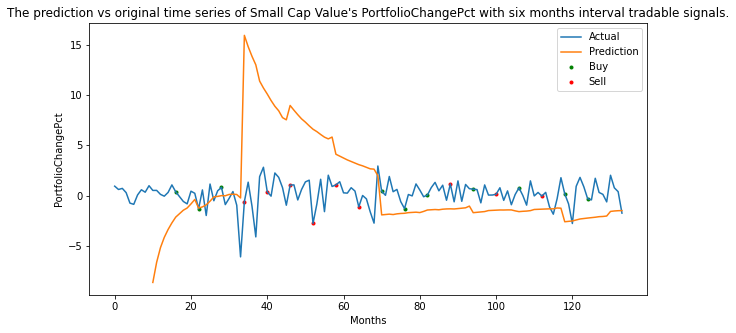

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


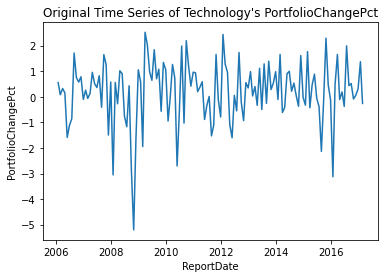

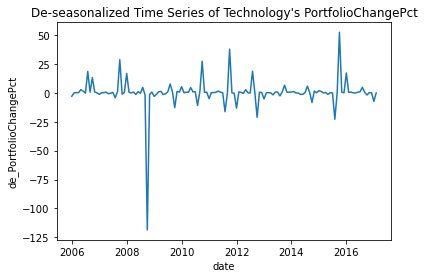

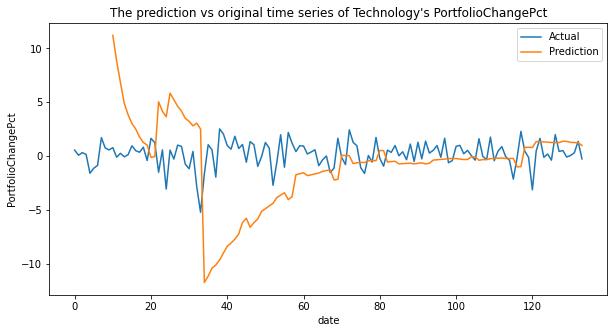

The MSE of the Technology PortfolioChangePct time series prediction is 207.87193119834498.
The Technology PortfolioChangePct one month interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.4642375168690958.
The Technology PortfolioChangePct three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.6002415458937198.
The Technology PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.5151515151515151.


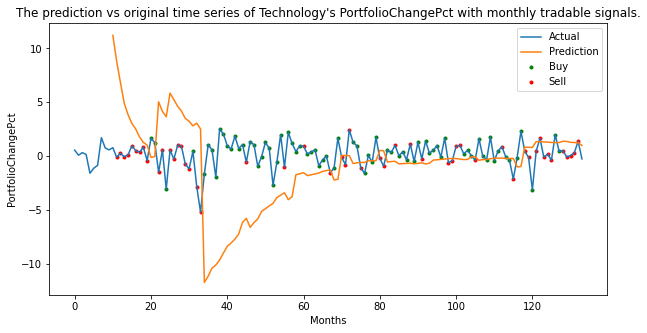

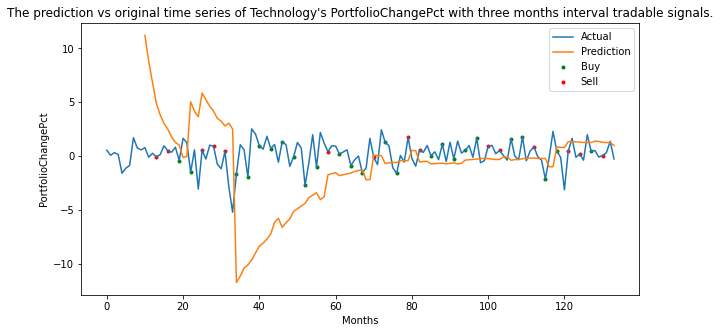

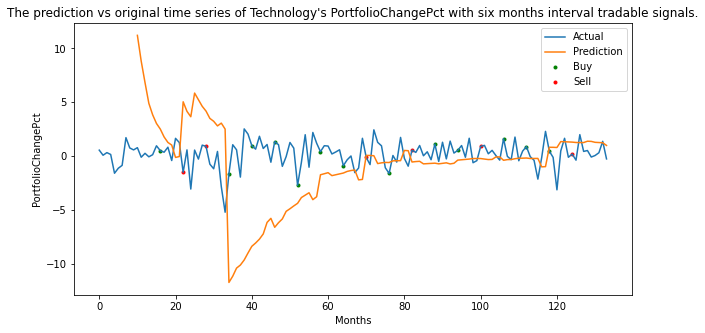

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


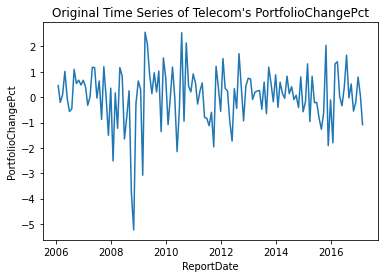

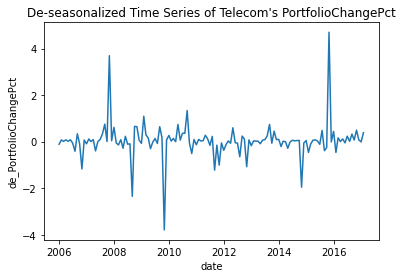

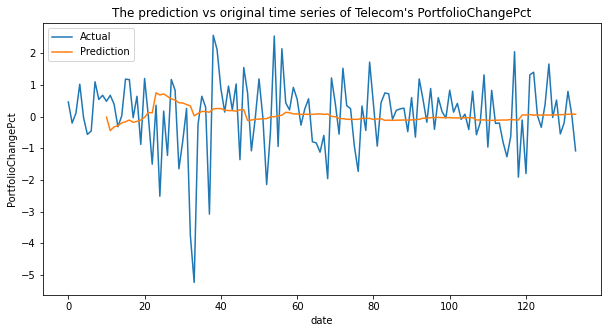

The MSE of the Telecom PortfolioChangePct time series prediction is 0.670261330618278.
The Telecom PortfolioChangePct one month interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5959294436906377.
The Telecom PortfolioChangePct three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.6932367149758454.
The Telecom PortfolioChangePct six months interval prediction's accuracy is 0.7. The AUC score is 0.7.


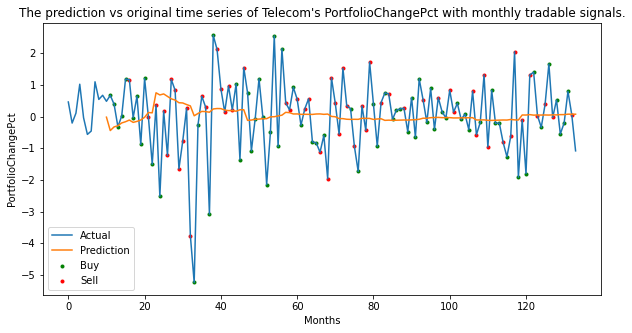

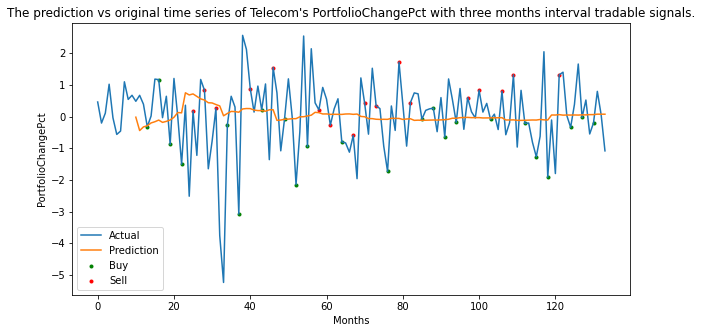

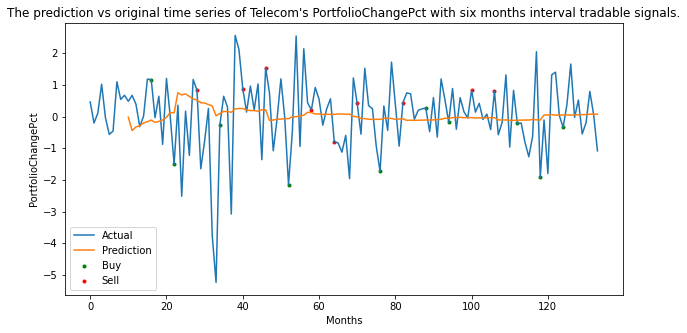

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


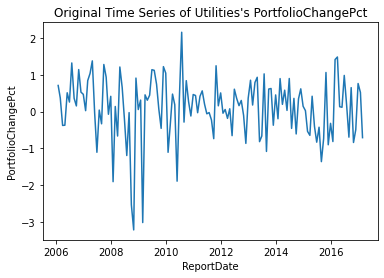

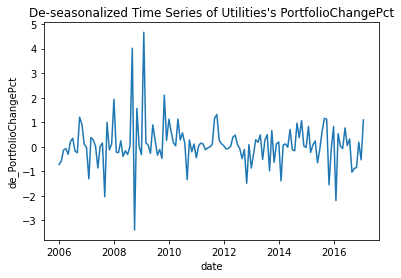

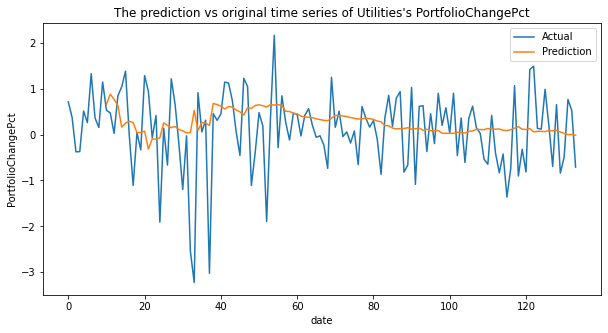

The MSE of the Utilities PortfolioChangePct time series prediction is 0.9595505633491156.
The Utilities PortfolioChangePct one month interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4816017316017316.
The Utilities PortfolioChangePct three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.606280193236715.
The Utilities PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


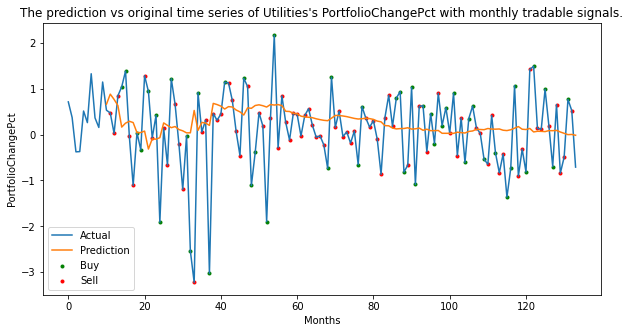

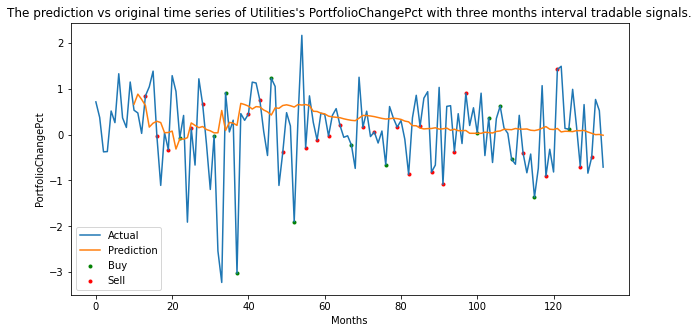

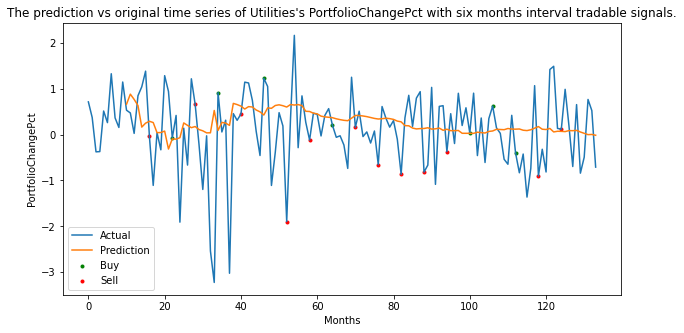

In [86]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'RE', target = 'PortfolioChangePct')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

RE_PortfolioChangePct = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [87]:
RE_PortfolioChangePct

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,6.529944,0.478261,0.476117,0.473684,0.484594,0.578947,0.636905,21,29,31,34,8,7,13,10,5,1,7,6
1,Consumer Goods,1.008386,0.443478,0.436111,0.447368,0.447222,0.315789,0.323864,21,31,33,30,8,11,10,9,3,5,8,3
2,Energy,30.112071,0.406504,0.408232,0.560976,0.569378,0.350000,0.358586,29,45,28,21,13,12,6,10,4,8,5,3
3,Financials,69668.261779,0.577236,0.566484,0.609756,0.618421,0.650000,0.661616,24,23,29,47,11,5,11,14,6,2,5,7
4,Health Care/Biotech,9.530176,0.365854,0.366918,0.658537,0.665459,0.600000,0.606061,19,39,39,26,14,5,9,13,6,3,5,6
5,Industrials,19.860935,0.481481,0.482405,0.555556,0.550000,0.444444,0.450000,12,18,10,14,6,4,4,4,2,3,2,2
6,Large Cap Blend,1.096755,0.495935,0.504143,0.560976,0.563095,0.300000,0.300000,27,37,25,34,13,11,7,10,4,8,6,2
7,Large Cap Growth,2.172492,0.447154,0.438998,0.707317,0.714976,0.500000,0.500000,22,36,32,33,14,8,4,15,6,6,4,4
8,Large Cap Value,2.891439,0.520325,0.537872,0.487805,0.490476,0.400000,0.373737,28,39,20,36,12,13,8,8,7,8,4,1
9,Mid Cap Blend,7.848307,0.593496,0.598077,0.512195,0.511905,0.450000,0.450000,31,29,21,42,10,10,10,11,4,5,6,5


In [88]:
RE_PortfolioChangePct.to_csv('RE_PortfolioChangePct.csv')

#### INS PCP

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


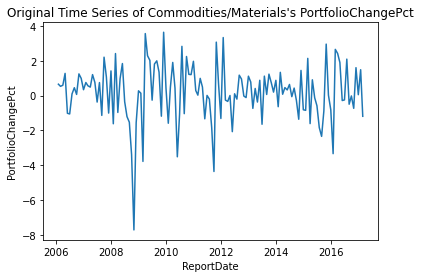

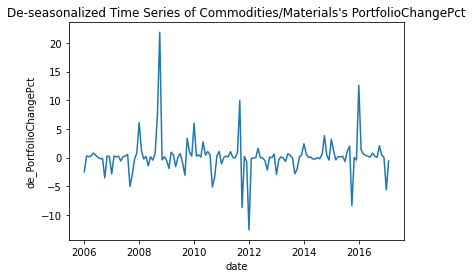

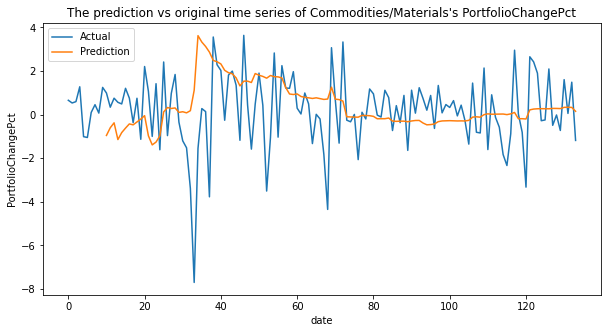

The MSE of the Commodities/Materials PortfolioChangePct time series prediction is 12.508193931309174.
The Commodities/Materials PortfolioChangePct one month interval prediction's accuracy is 0.5772357723577236. The AUC score is 0.5785472972972973.
The Commodities/Materials PortfolioChangePct three months interval prediction's accuracy is 0.5853658536585366. The AUC score is 0.5821256038647343.
The Commodities/Materials PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.4040404040404041.


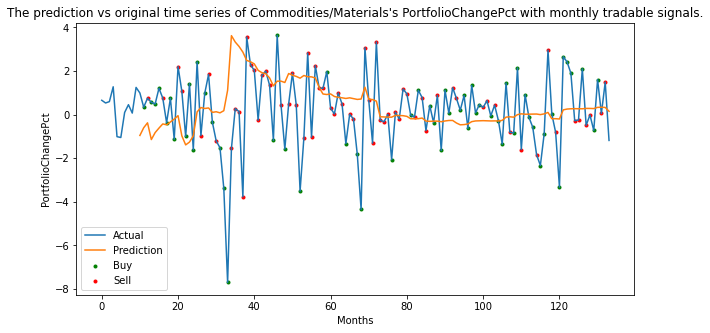

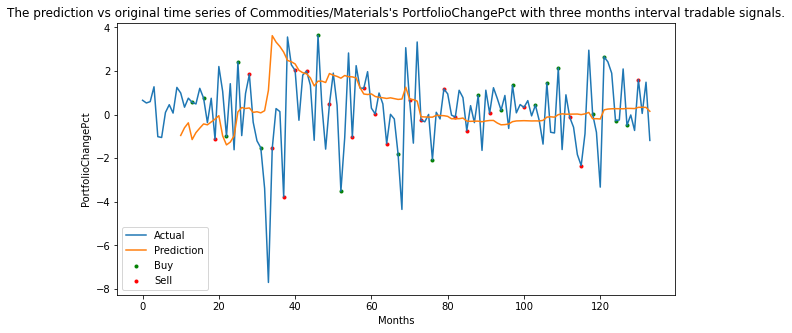

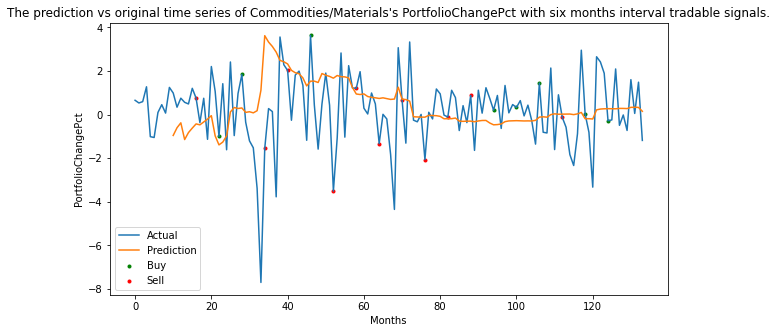

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


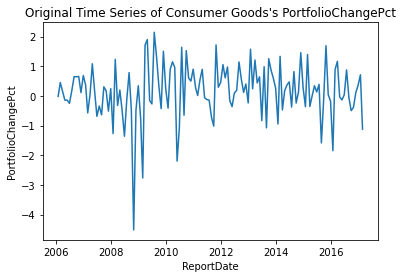

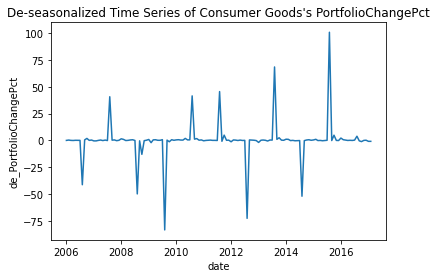

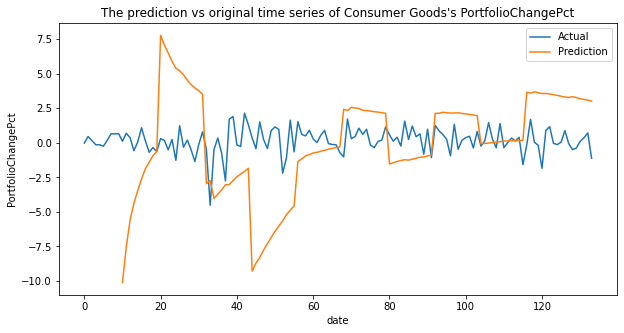

The MSE of the Consumer Goods PortfolioChangePct time series prediction is 329.50987406212283.
The Consumer Goods PortfolioChangePct one month interval prediction's accuracy is 0.45528455284552843. The AUC score is 0.4576248313090418.
The Consumer Goods PortfolioChangePct three months interval prediction's accuracy is 0.4146341463414634. The AUC score is 0.4130952380952381.
The Consumer Goods PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.3939393939393939.


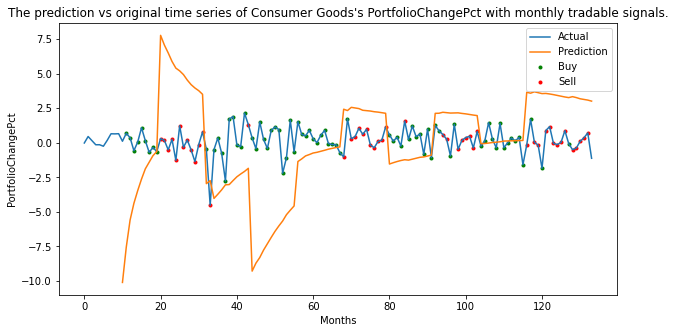

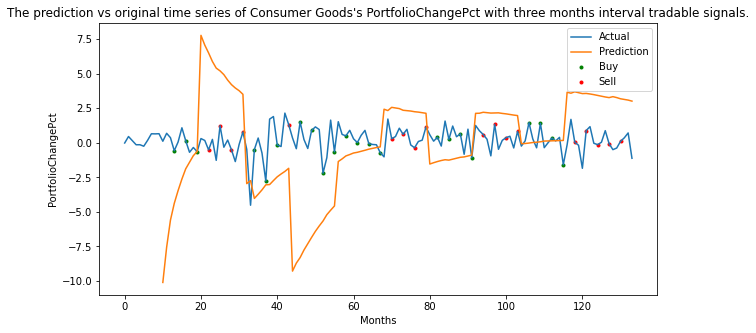

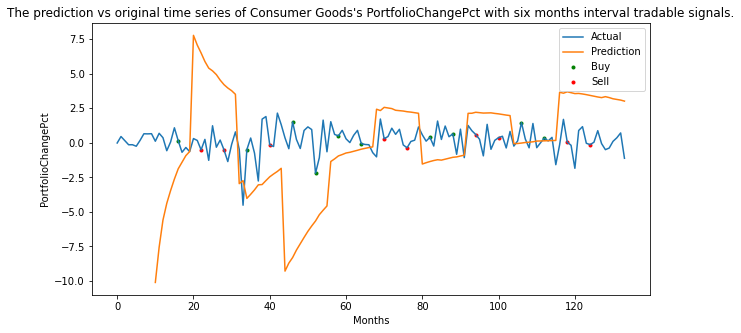

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


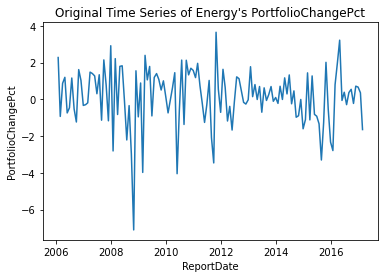

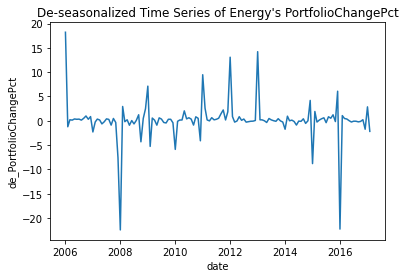

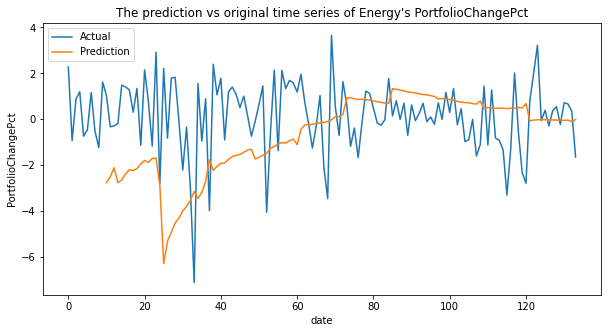

The MSE of the Energy PortfolioChangePct time series prediction is 17.594931994226478.
The Energy PortfolioChangePct one month interval prediction's accuracy is 0.44715447154471544. The AUC score is 0.4539331896551724.
The Energy PortfolioChangePct three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.44138755980861244.
The Energy PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.4949494949494949.


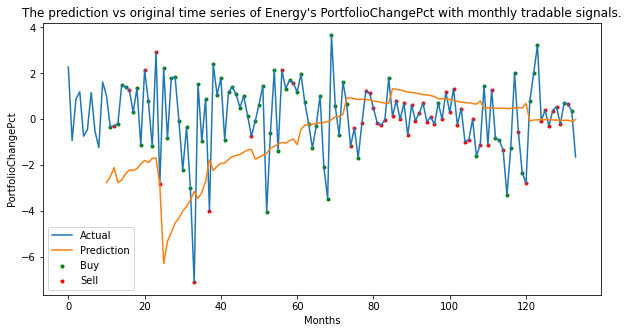

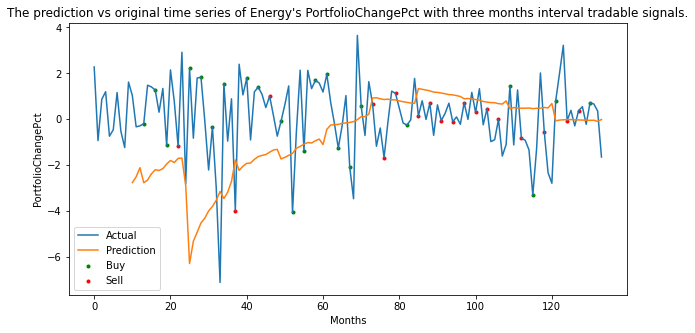

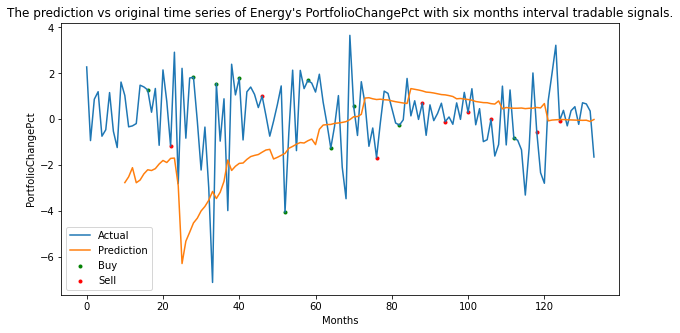

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


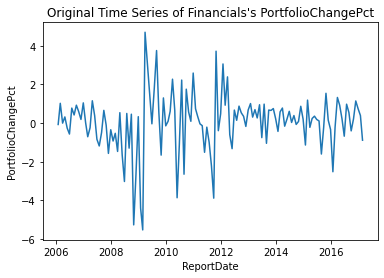

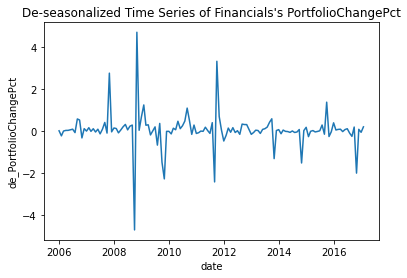

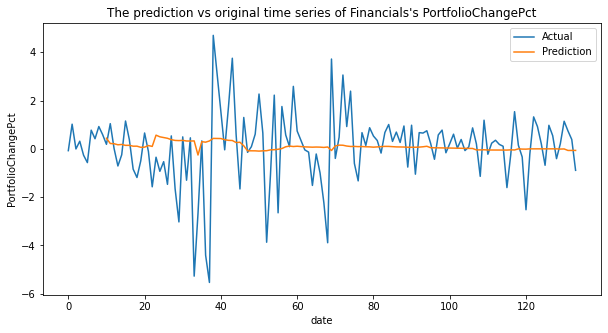

The MSE of the Financials PortfolioChangePct time series prediction is 0.8467969656053563.
The Financials PortfolioChangePct one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5285753349740224.
The Financials PortfolioChangePct three months interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.6142857142857143.
The Financials PortfolioChangePct six months interval prediction's accuracy is 0.65. The AUC score is 0.6414141414141414.


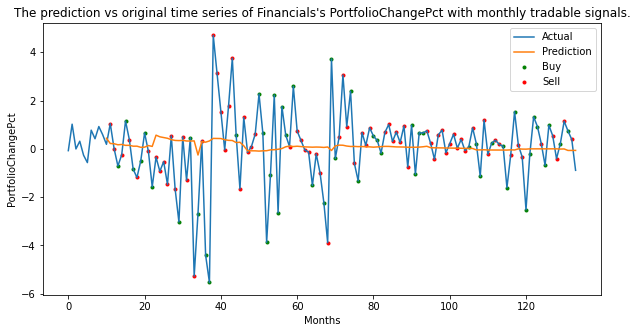

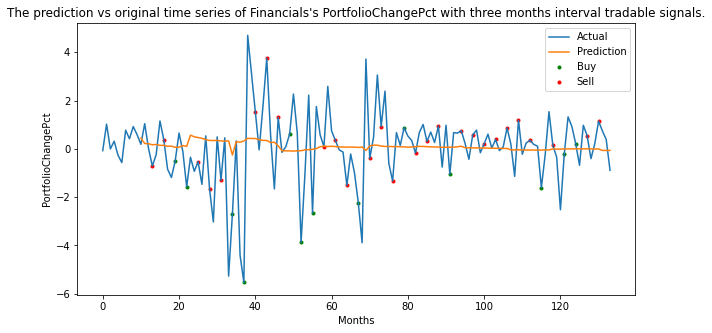

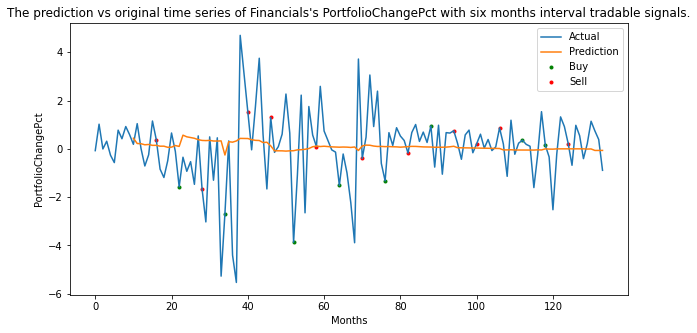

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


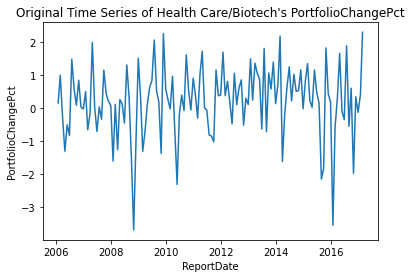

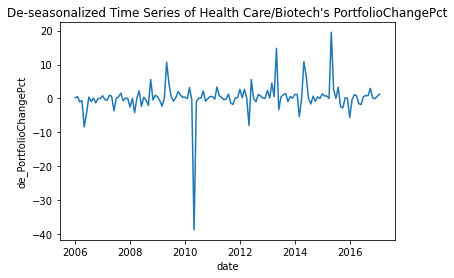

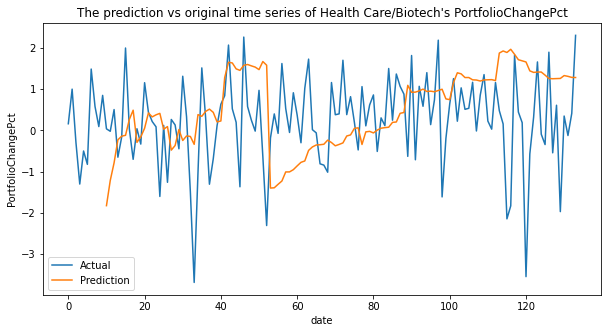

The MSE of the Health Care/Biotech PortfolioChangePct time series prediction is 24.132952372530326.
The Health Care/Biotech PortfolioChangePct one month interval prediction's accuracy is 0.3983739837398374. The AUC score is 0.4093117408906882.
The Health Care/Biotech PortfolioChangePct three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.4342105263157895.
The Health Care/Biotech PortfolioChangePct six months interval prediction's accuracy is 0.55. The AUC score is 0.5404040404040403.


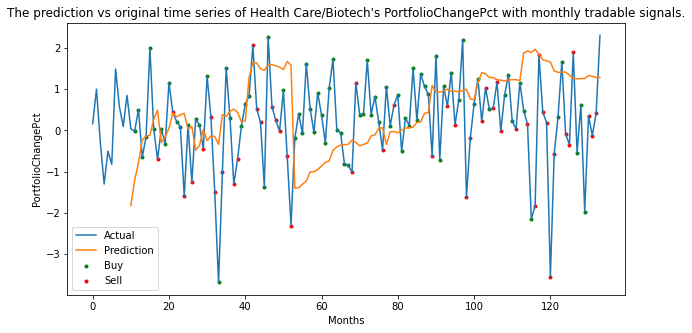

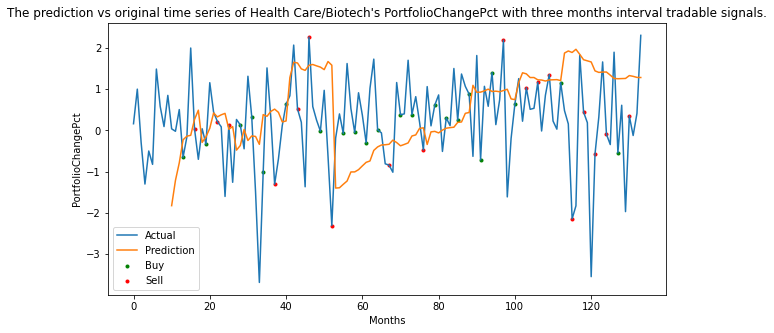

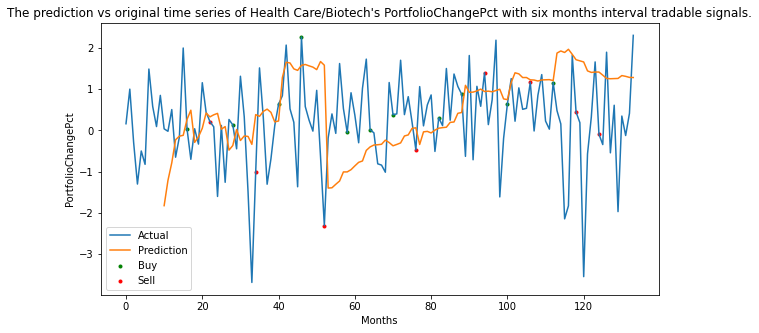

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


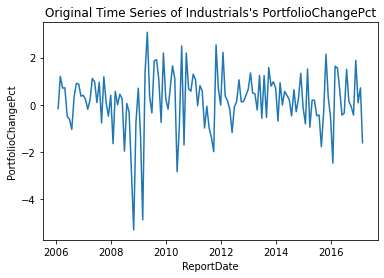

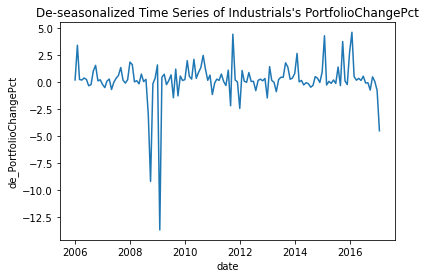

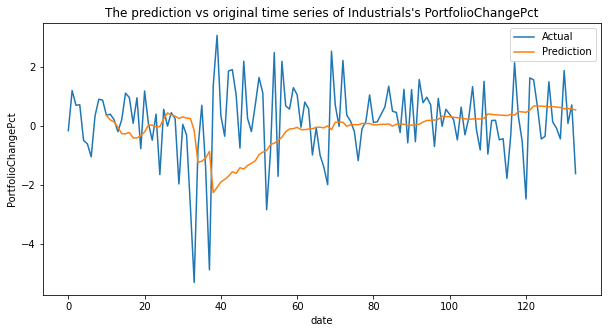

The MSE of the Industrials PortfolioChangePct time series prediction is 3.866599744116709.
The Industrials PortfolioChangePct one month interval prediction's accuracy is 0.4715447154471545. The AUC score is 0.48351648351648346.
The Industrials PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5630952380952381.
The Industrials PortfolioChangePct six months interval prediction's accuracy is 0.45. The AUC score is 0.4292929292929293.


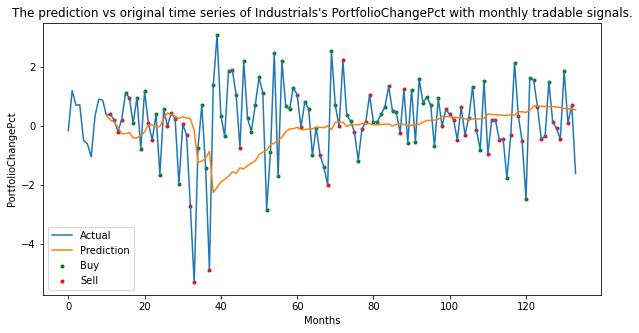

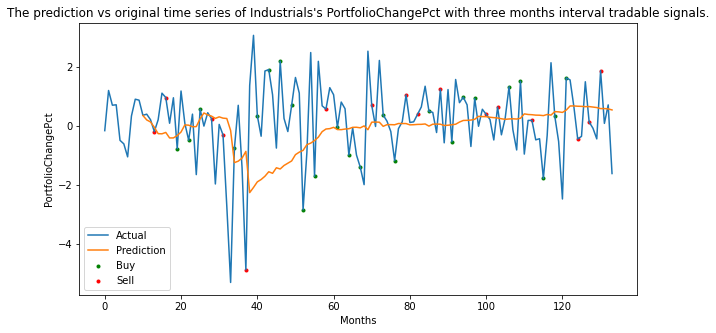

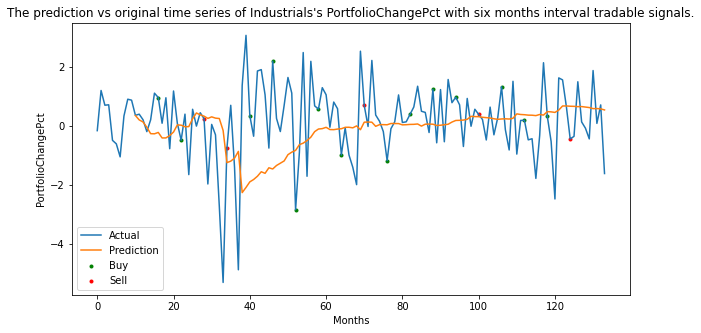

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


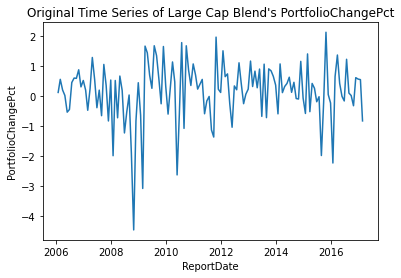

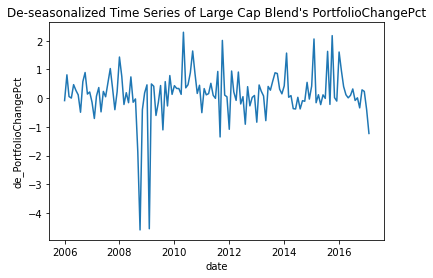

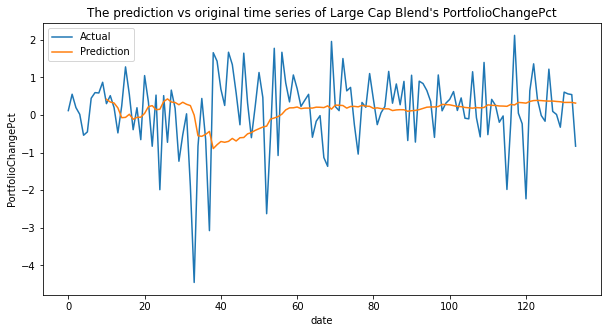

The MSE of the Large Cap Blend PortfolioChangePct time series prediction is 0.8612909193937308.
The Large Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.4796747967479675. The AUC score is 0.48453465893399617.
The Large Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5595238095238095.
The Large Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


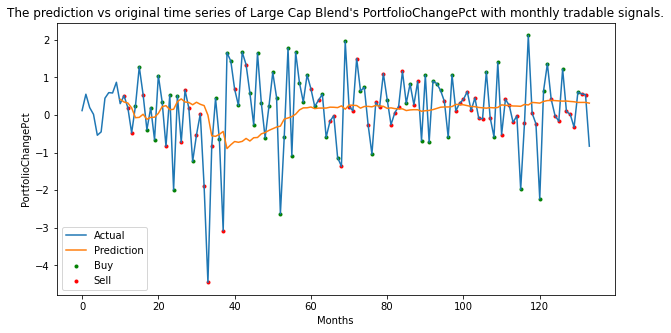

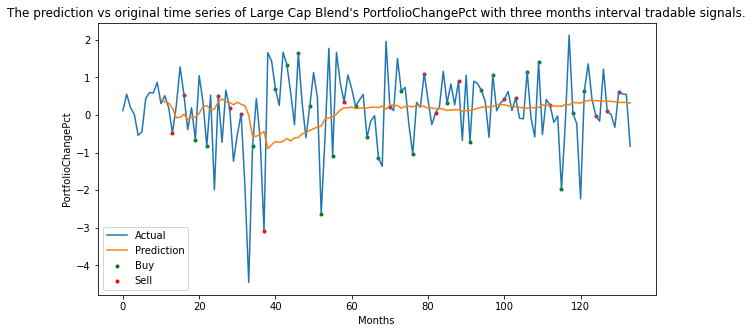

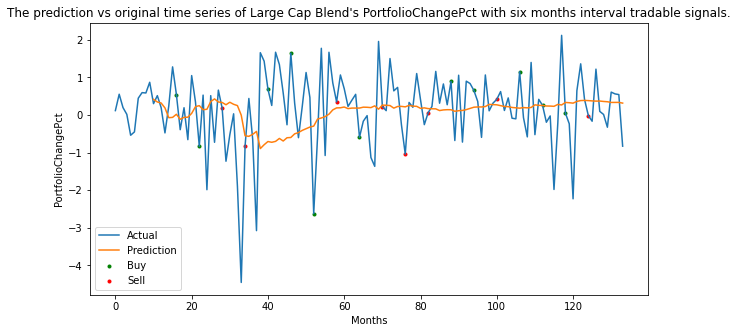

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


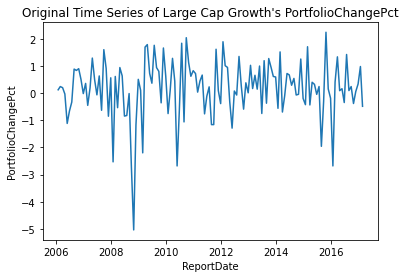

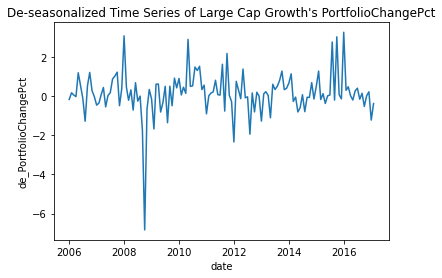

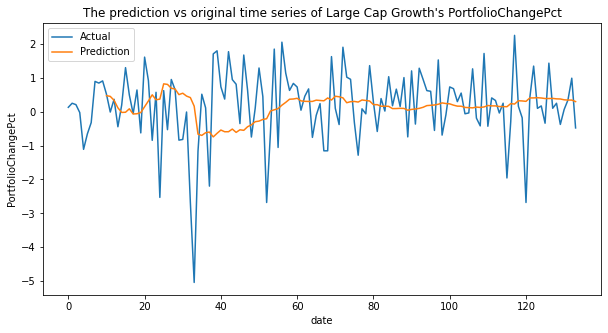

The MSE of the Large Cap Growth PortfolioChangePct time series prediction is 1.3533364226350637.
The Large Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.44715447154471544. The AUC score is 0.4415584415584416.
The Large Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.6829268292682927. The AUC score is 0.6871980676328503.
The Large Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.55. The AUC score is 0.55.


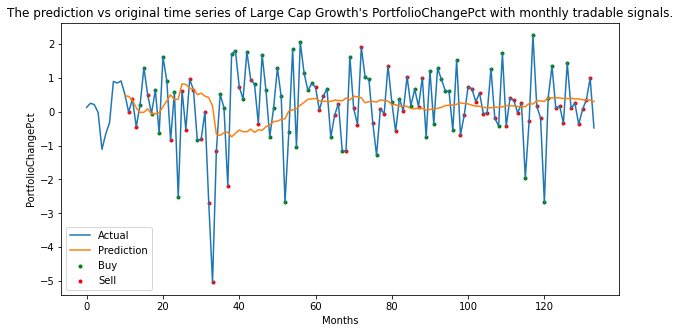

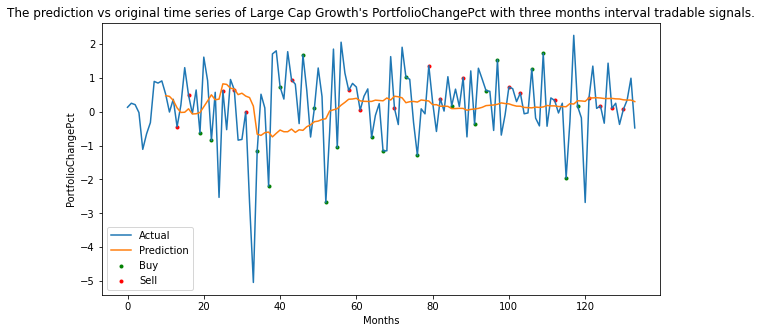

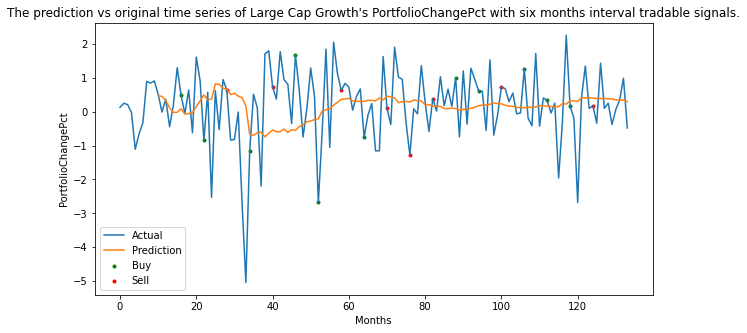

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


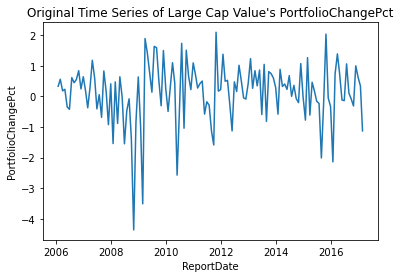

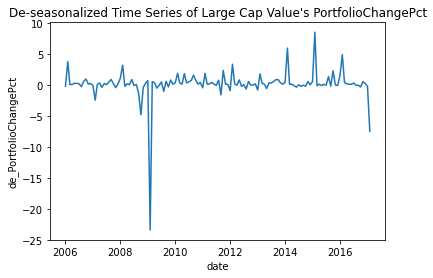

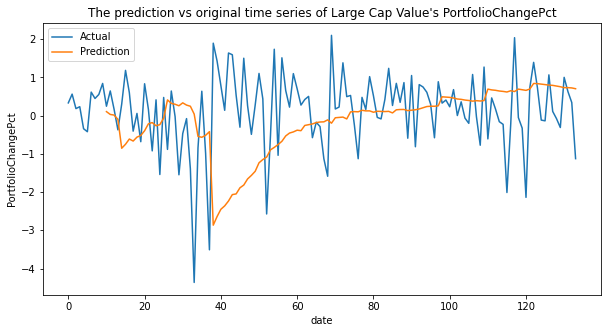

The MSE of the Large Cap Value PortfolioChangePct time series prediction is 6.863742239998852.
The Large Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.5594031531531531.
The Large Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4845238095238095.
The Large Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


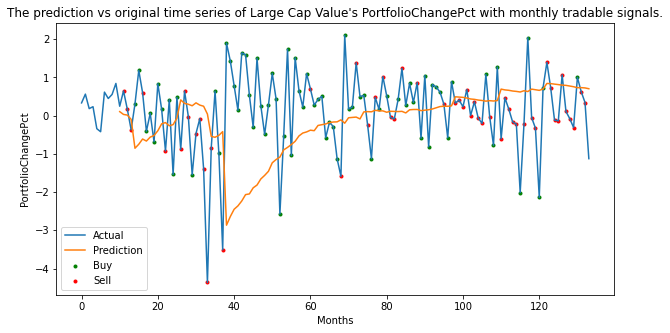

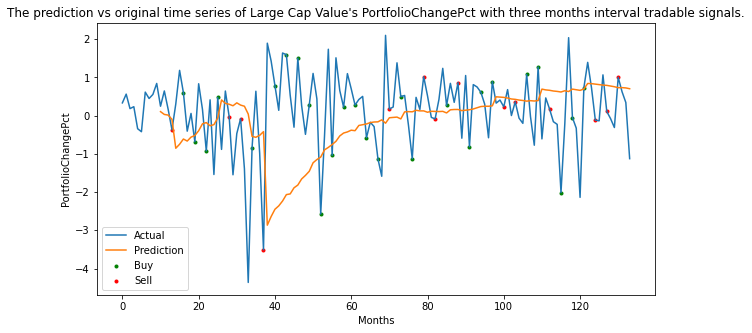

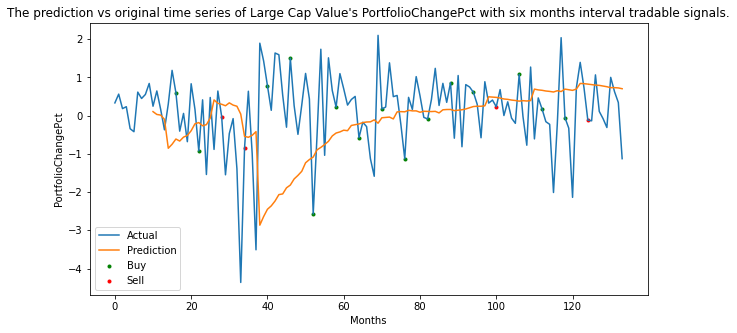

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


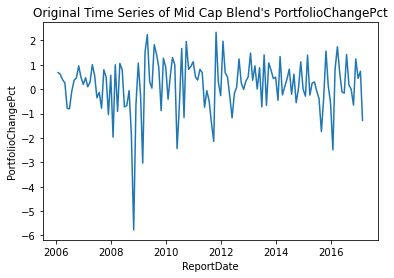

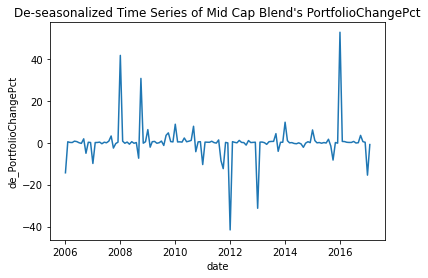

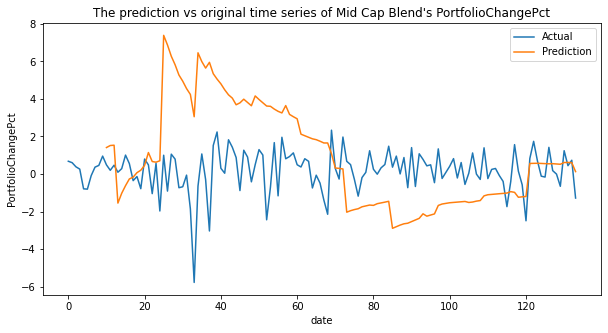

The MSE of the Mid Cap Blend PortfolioChangePct time series prediction is 82.9194230460442.
The Mid Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5686567164179104.
The Mid Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.488095238095238.
The Mid Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.39999999999999997.


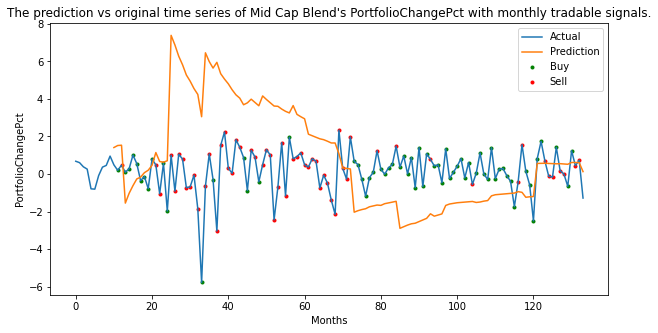

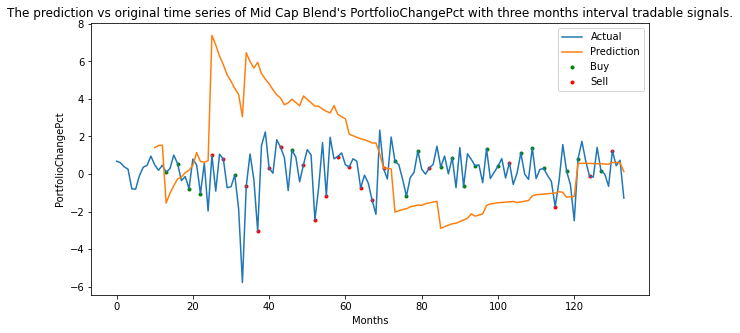

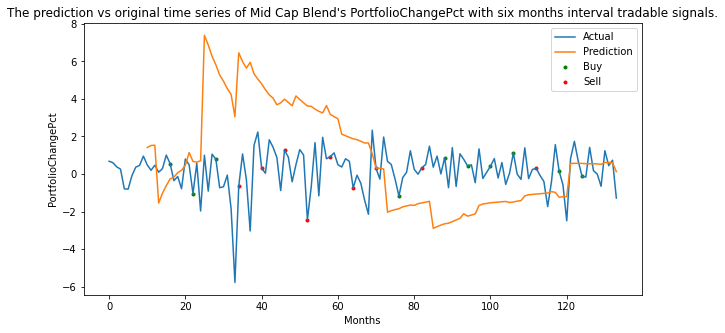

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


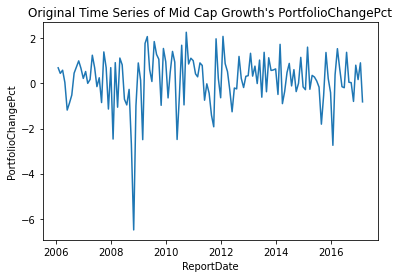

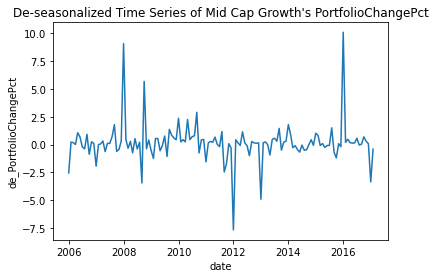

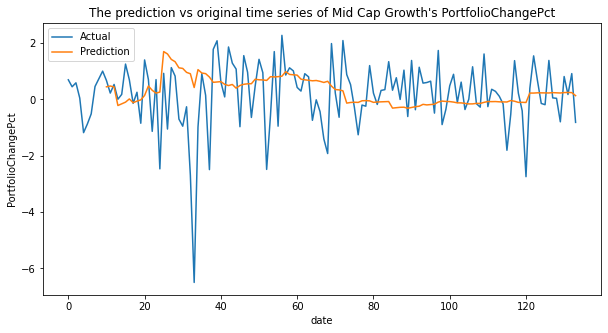

The MSE of the Mid Cap Growth PortfolioChangePct time series prediction is 3.4826612490763105.
The Mid Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.5609756097560976. The AUC score is 0.5596153846153846.
The Mid Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.6097560975609756. The AUC score is 0.6095238095238096.
The Mid Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.4. The AUC score is 0.39999999999999997.


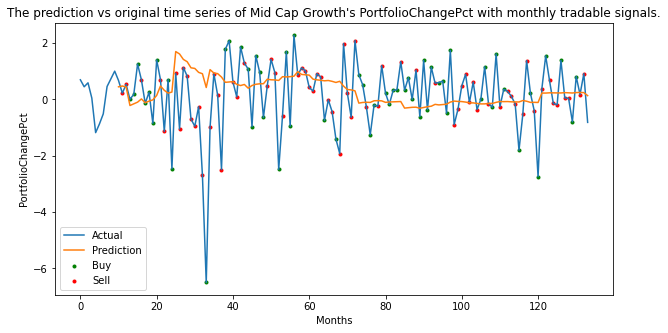

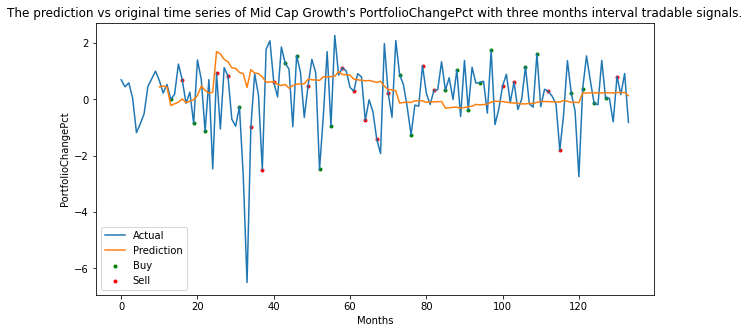

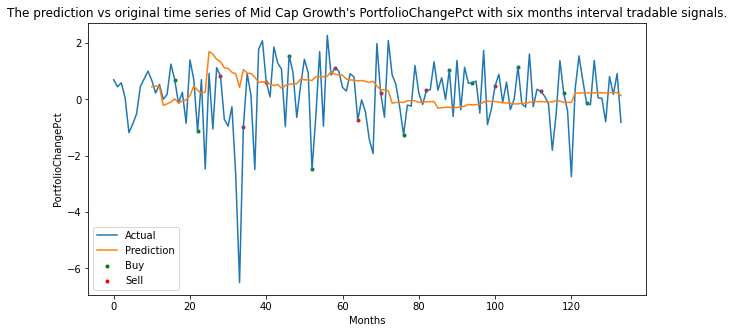

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


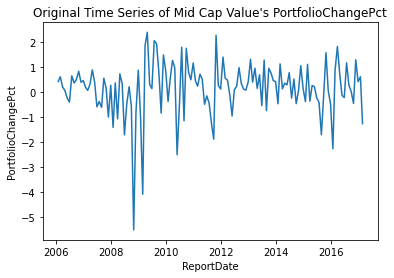

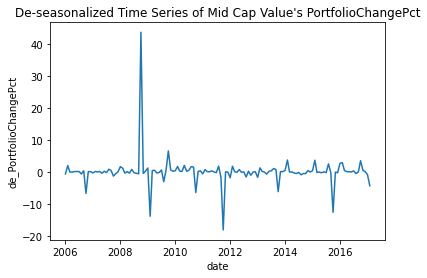

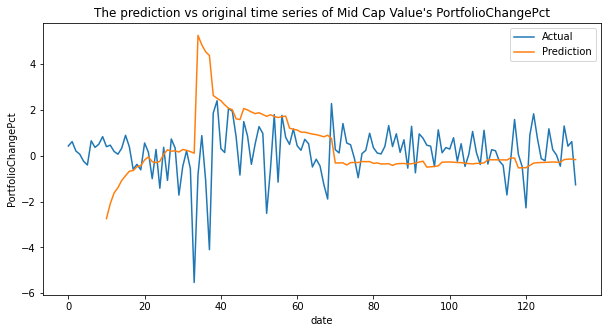

The MSE of the Mid Cap Value PortfolioChangePct time series prediction is 25.618806418809047.
The Mid Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5528455284552846. The AUC score is 0.5561923399496785.
The Mid Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.43902439024390244. The AUC score is 0.4392857142857143.
The Mid Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.3484848484848485.


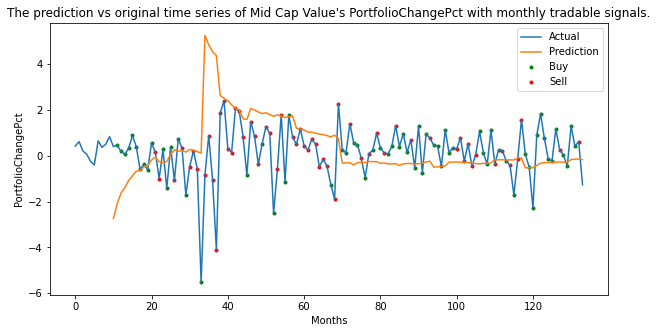

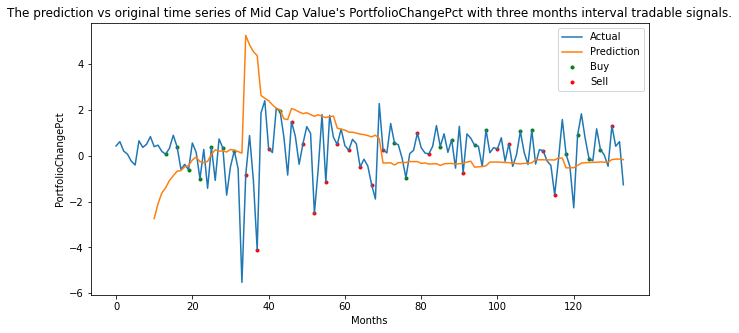

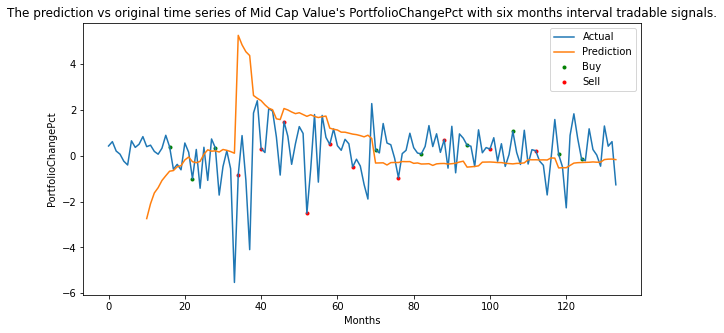

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


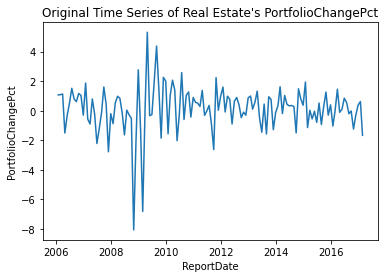

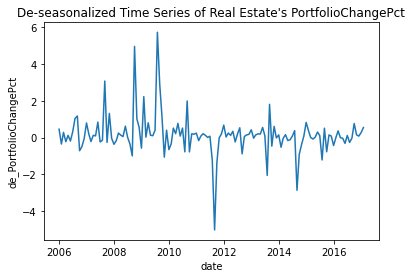

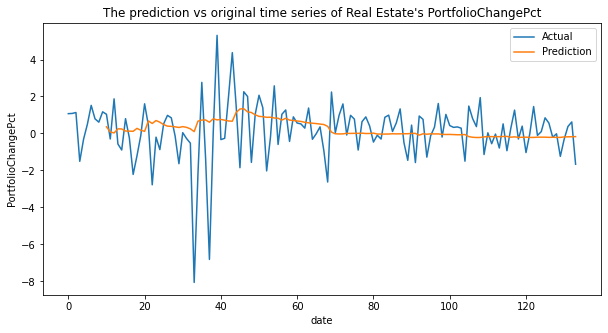

The MSE of the Real Estate PortfolioChangePct time series prediction is 1.283386342512472.
The Real Estate PortfolioChangePct one month interval prediction's accuracy is 0.5203252032520326. The AUC score is 0.5163934426229508.
The Real Estate PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4710144927536232.
The Real Estate PortfolioChangePct six months interval prediction's accuracy is 0.35. The AUC score is 0.35.


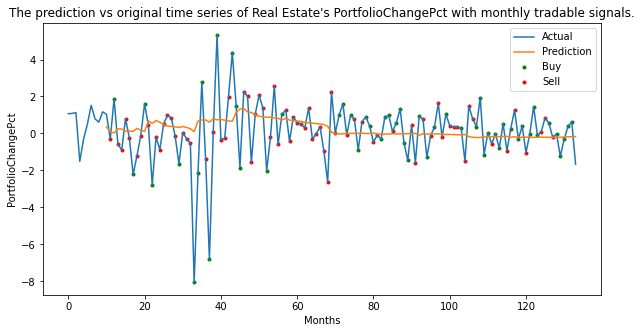

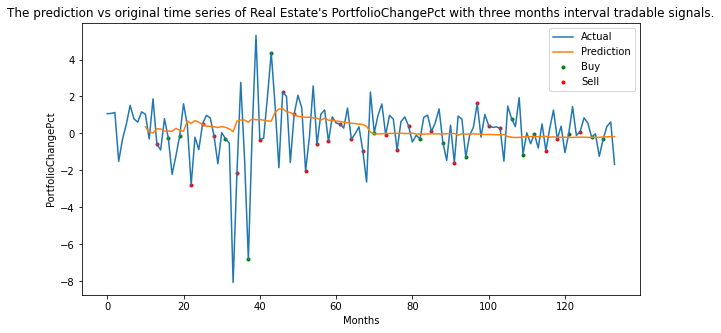

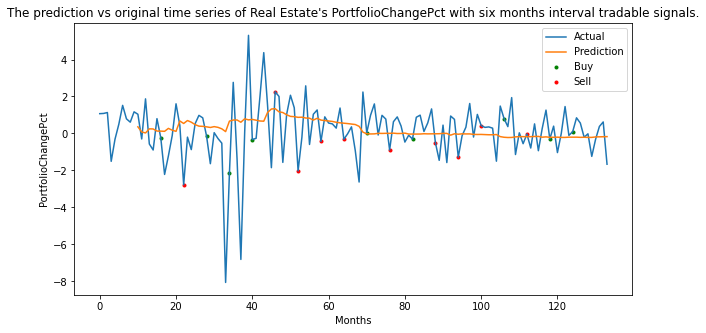

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


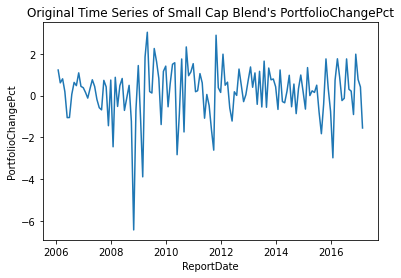

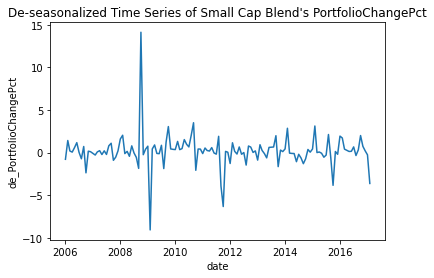

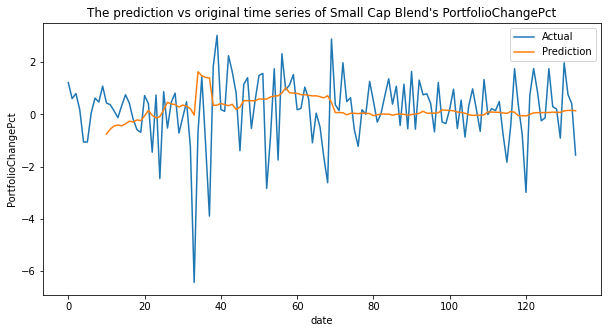

The MSE of the Small Cap Blend PortfolioChangePct time series prediction is 4.185699371324441.
The Small Cap Blend PortfolioChangePct one month interval prediction's accuracy is 0.5203252032520326. The AUC score is 0.5227272727272727.
The Small Cap Blend PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.4904761904761905.
The Small Cap Blend PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.3.


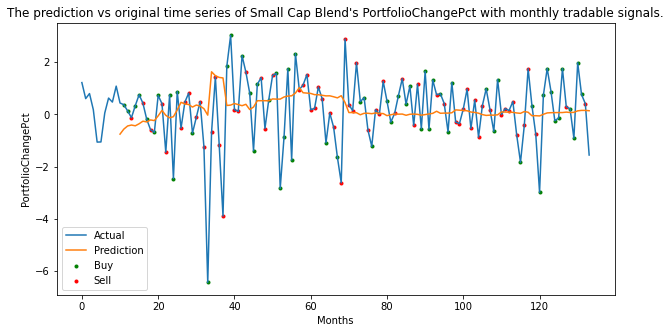

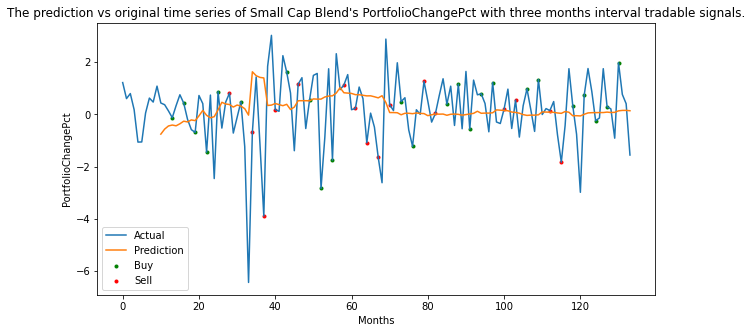

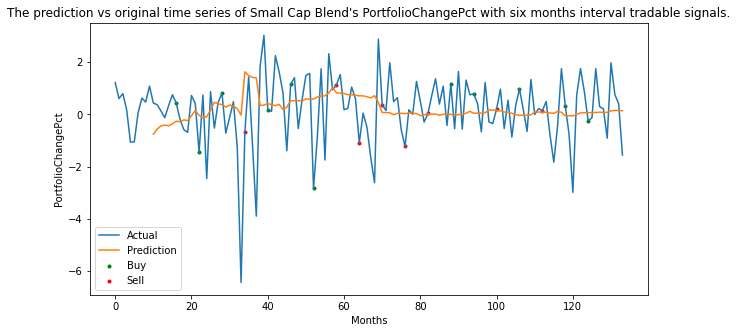

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


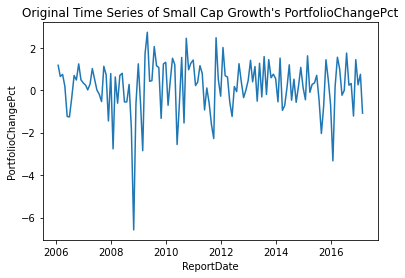

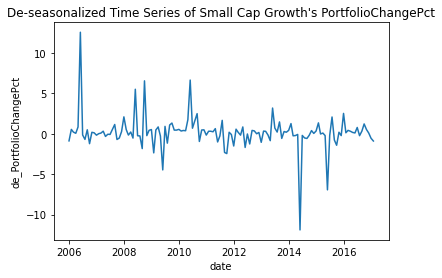

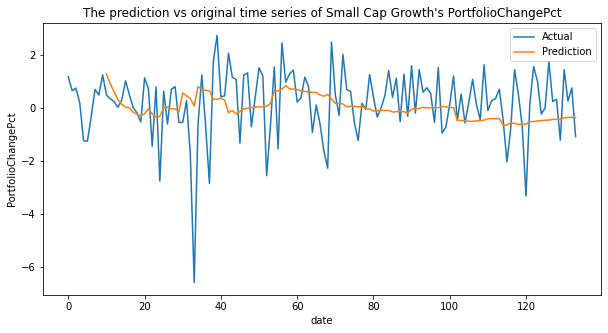

The MSE of the Small Cap Growth PortfolioChangePct time series prediction is 3.6792757860013254.
The Small Cap Growth PortfolioChangePct one month interval prediction's accuracy is 0.5040650406504065. The AUC score is 0.5.
The Small Cap Growth PortfolioChangePct three months interval prediction's accuracy is 0.4878048780487805. The AUC score is 0.48690476190476184.
The Small Cap Growth PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.30303030303030304.


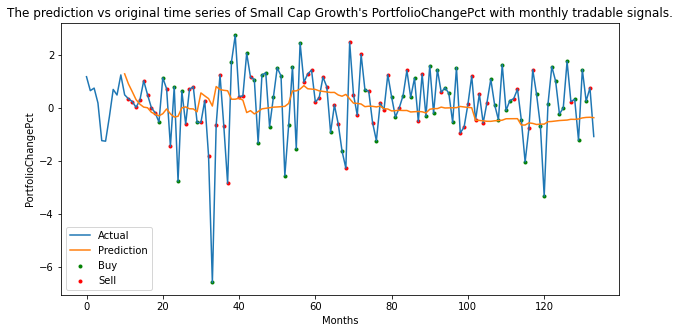

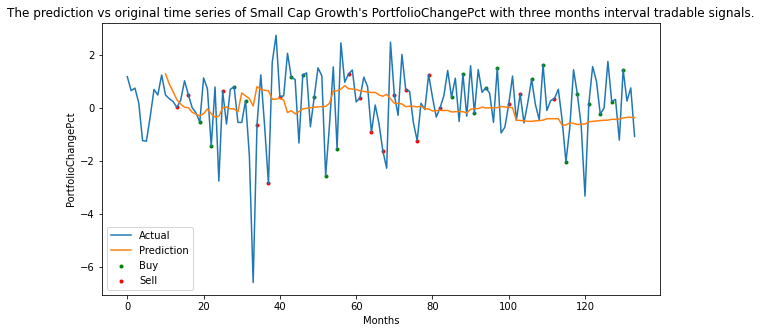

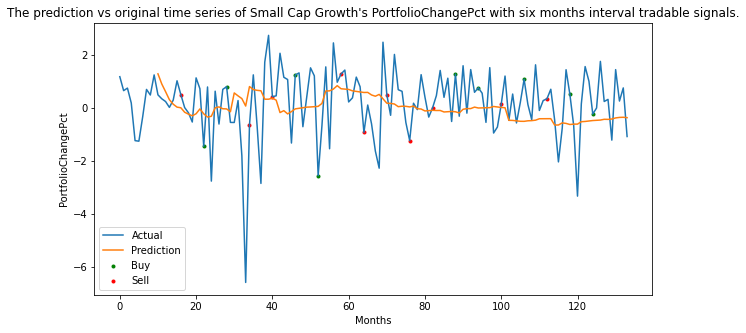

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


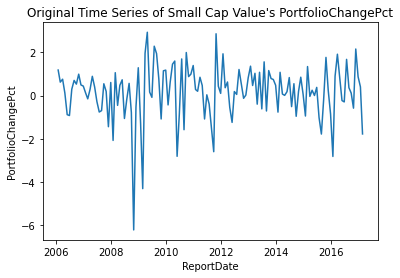

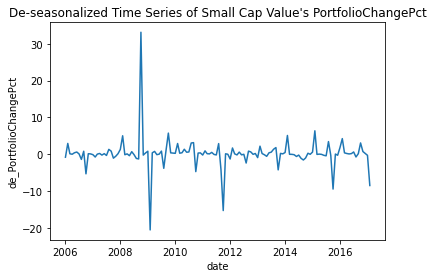

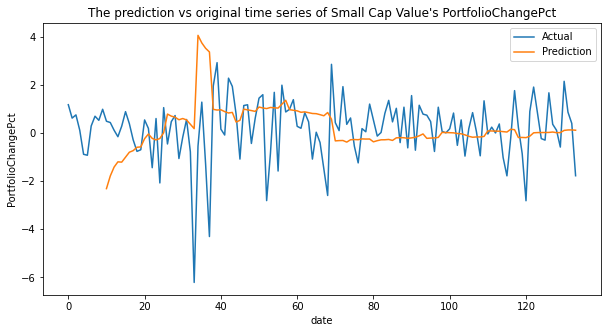

The MSE of the Small Cap Value PortfolioChangePct time series prediction is 19.48555274742379.
The Small Cap Value PortfolioChangePct one month interval prediction's accuracy is 0.5203252032520326. The AUC score is 0.5239651416122004.
The Small Cap Value PortfolioChangePct three months interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.4677033492822966.
The Small Cap Value PortfolioChangePct six months interval prediction's accuracy is 0.3. The AUC score is 0.3.


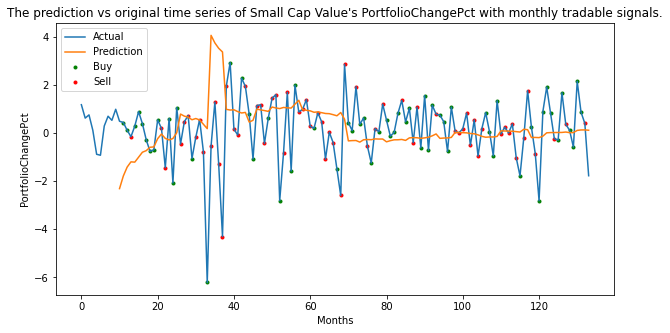

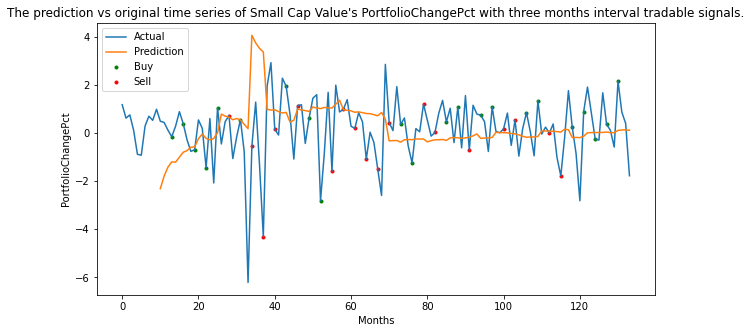

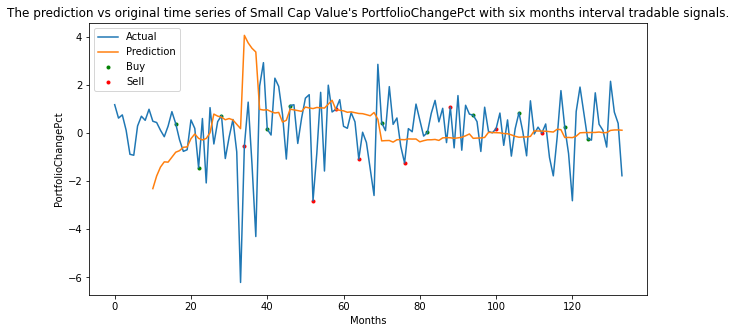

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


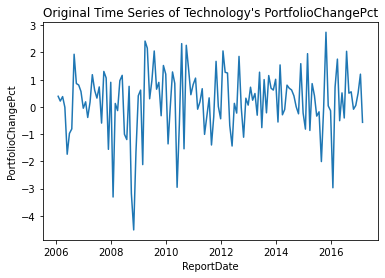

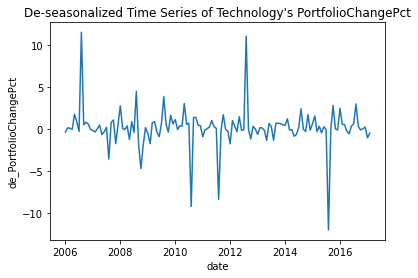

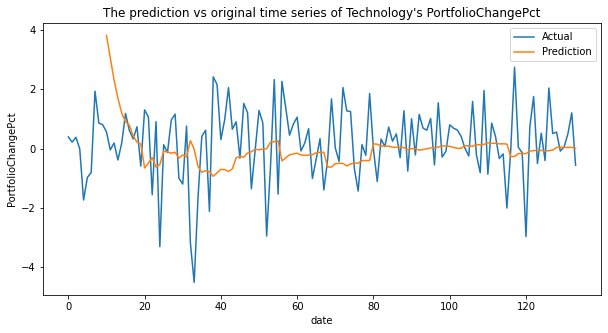

The MSE of the Technology PortfolioChangePct time series prediction is 5.560727223137048.
The Technology PortfolioChangePct one month interval prediction's accuracy is 0.4146341463414634. The AUC score is 0.41244612068965514.
The Technology PortfolioChangePct three months interval prediction's accuracy is 0.5365853658536586. The AUC score is 0.538647342995169.
The Technology PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.4949494949494949.


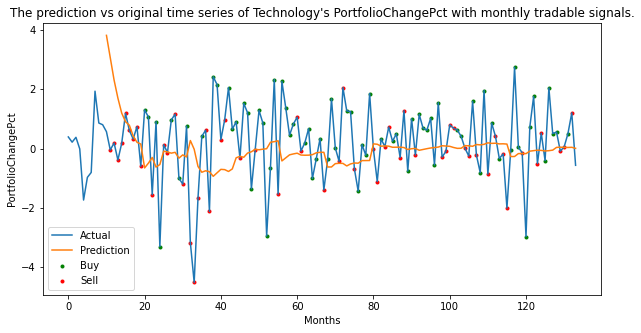

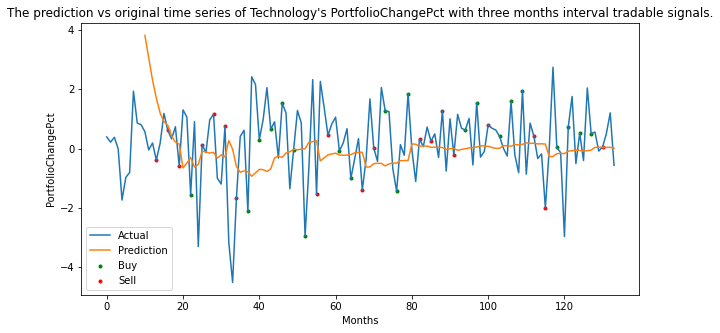

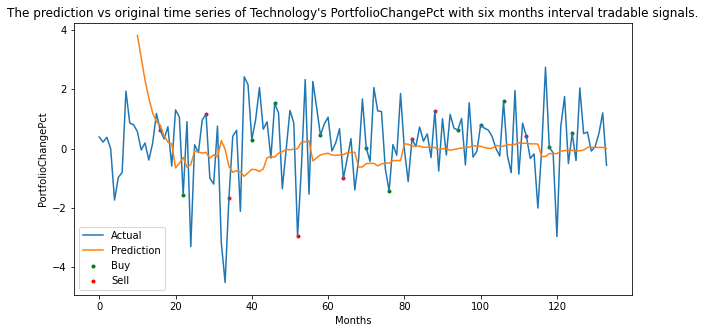

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


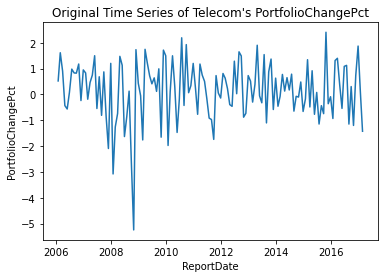

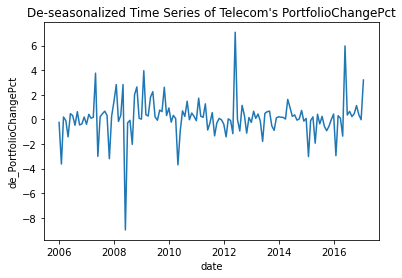

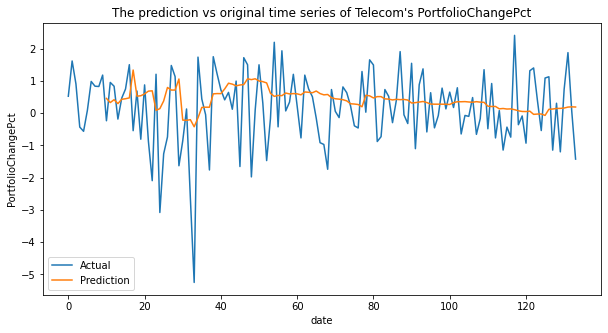

The MSE of the Telecom PortfolioChangePct time series prediction is 3.06851195005149.
The Telecom PortfolioChangePct one month interval prediction's accuracy is 0.4715447154471545. The AUC score is 0.4718614718614718.
The Telecom PortfolioChangePct three months interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.4730392156862745.
The Telecom PortfolioChangePct six months interval prediction's accuracy is 0.5. The AUC score is 0.5.


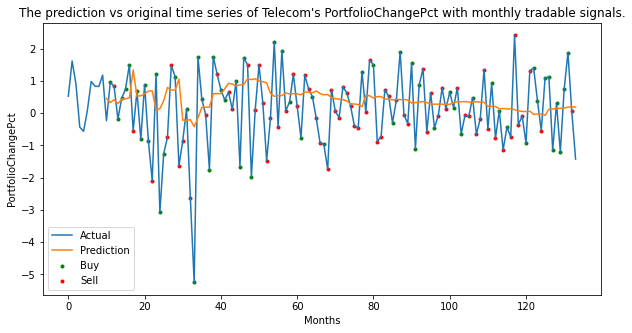

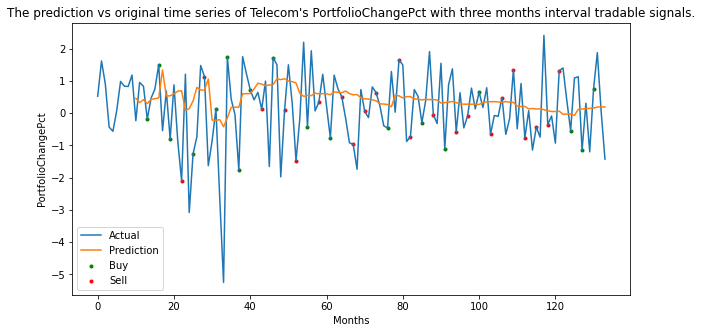

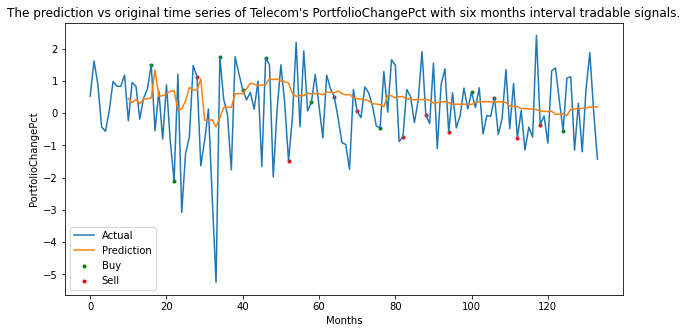

/var/folders/8t/_kd99h0508g3m2zbnrtv5p0c0000gn/T/ipykernel_21248/3752289513.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['ReportDate'] = df_1['ReportDate'].map(lambda x: datetime.strptime(x, '%Y-%m-%d'))


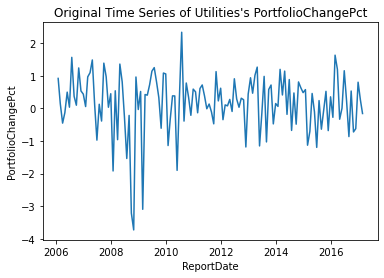

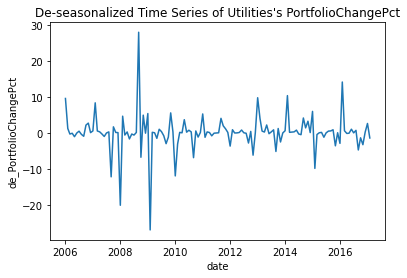

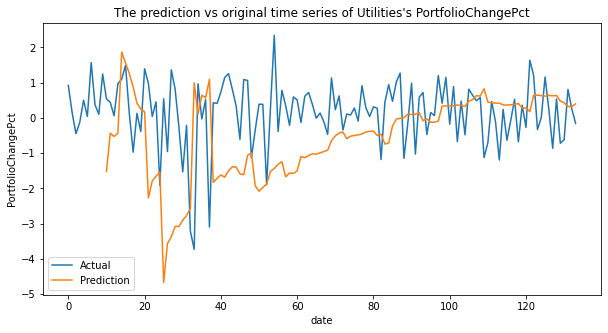

The MSE of the Utilities PortfolioChangePct time series prediction is 30.464608883250914.
The Utilities PortfolioChangePct one month interval prediction's accuracy is 0.3821138211382114. The AUC score is 0.390625.
The Utilities PortfolioChangePct three months interval prediction's accuracy is 0.4634146341463415. The AUC score is 0.44730392156862736.
The Utilities PortfolioChangePct six months interval prediction's accuracy is 0.7. The AUC score is 0.7000000000000001.


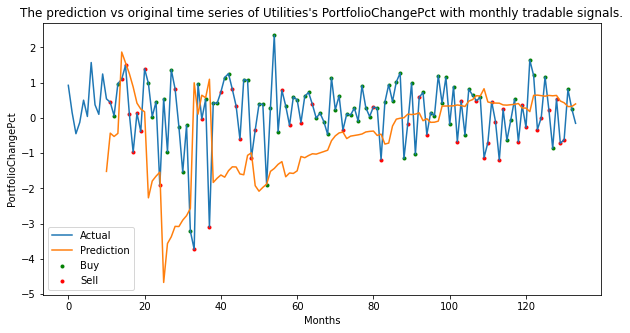

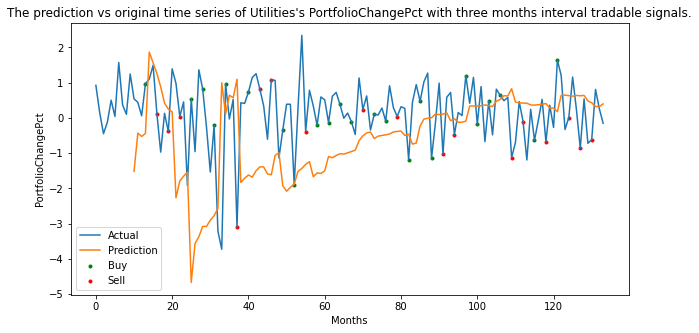

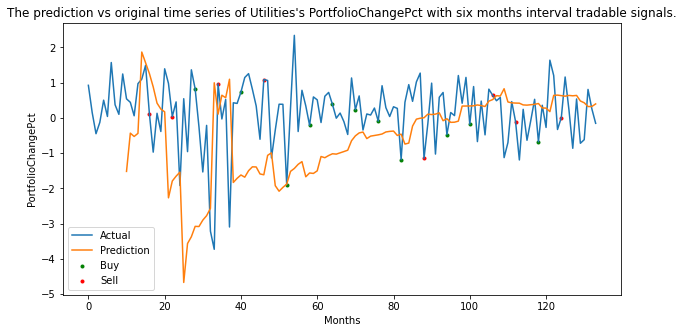

In [89]:
mse = []
one_month_acc = []
three_month_acc = []
six_month_acc = []
one_month_auc = []
three_month_auc = []
six_month_auc = []
one_month_TP = []
one_month_FP = []
one_month_FN = []
one_month_TN = []
three_month_TP = [] 
three_month_FP = [] 
three_month_FN = []
three_month_TN = []
six_month_TP = []
six_month_FP = []
six_month_FN = []
six_month_TN = []

for asset in asset_name:
    asset_mse, one, oneauc, three, threeauc, six, sixauc, oneTP, oneFP, oneFN, oneTN, threeTP, threeFP, threeFN, threeTN, sixTP, sixFP, sixFN, sixTN = DES(Asset = asset, database = 'INS', target = 'PortfolioChangePct')
    mse.append(asset_mse)
    one_month_acc.append(one)
    one_month_auc.append(oneauc)
    three_month_acc.append(three)
    three_month_auc.append(threeauc)
    six_month_acc.append(six)
    six_month_auc.append(sixauc)
    one_month_TP.append(oneTP)
    one_month_FP.append(oneFP)
    one_month_FN.append(oneFN)
    one_month_TN.append(oneTN)
    three_month_TP.append(threeTP)
    three_month_FP.append(threeFP)
    three_month_FN.append(threeFN)
    three_month_TN.append(threeTN)
    six_month_TP.append(sixTP)
    six_month_FP.append(sixFP)
    six_month_FN.append(sixFN)
    six_month_TN.append(sixTN)

INS_PortfolioChangePct = pd.DataFrame({'Assetclass':asset_name, 'MSE':mse, 'one_month_acc':one_month_acc, 'one_month_auc':one_month_auc, 
'three_month_acc':three_month_acc, 'three_month_auc':three_month_auc, 
'six_month_acc':six_month_acc, 'six_month_auc':six_month_auc, 
'one_month_TP' : one_month_TP, 'one_month_FP' : one_month_FP, 'one_month_FN' : one_month_FN ,'one_month_TN' : one_month_TN,
'three_month_TP' : three_month_TP, 'three_month_FP' : three_month_FP, 'three_month_FN' : three_month_FN, 'three_month_TN' : three_month_TN ,
'six_month_TP' : six_month_TP, 'six_month_FP' : six_month_FP, 'six_month_FN' : six_month_FN, 'six_month_TN' : six_month_TN})

In [90]:
INS_PortfolioChangePct

,Assetclass,MSE,one_month_acc,one_month_auc,three_month_acc,three_month_auc,six_month_acc,six_month_auc,one_month_TP,one_month_FP,one_month_FN,one_month_TN,three_month_TP,three_month_FP,three_month_FN,three_month_TN,six_month_TP,six_month_FP,six_month_FN,six_month_TN
0,Commodities/Materials,12.508194,0.577236,0.578547,0.585366,0.582126,0.40,0.404040,27,31,21,44,10,9,8,14,4,5,7,4
1,Consumer Goods,329.509874,0.455285,0.457625,0.414634,0.413095,0.40,0.393939,33,42,25,23,10,13,11,7,5,6,6,3
2,Energy,17.594932,0.447154,0.453933,0.439024,0.441388,0.50,0.494949,30,40,28,25,9,13,10,9,6,5,5,4
3,Financials,0.846797,0.536585,0.528575,0.609756,0.614286,0.65,0.641414,23,26,31,43,9,4,12,16,5,3,4,8
4,Health Care/Biotech,24.132952,0.398374,0.409312,0.439024,0.434211,0.55,0.540404,30,47,27,19,11,12,11,7,7,5,4,4
5,Industrials,3.866600,0.471545,0.483516,0.560976,0.563095,0.45,0.429293,28,40,25,30,13,11,7,10,7,7,4,2
6,Large Cap Blend,0.861291,0.479675,0.484535,0.560976,0.559524,0.35,0.350000,25,37,27,34,13,10,8,10,4,7,6,3
7,Large Cap Growth,1.353336,0.447154,0.441558,0.682927,0.687198,0.55,0.550000,24,36,32,31,13,8,5,15,6,5,4,5
8,Large Cap Value,6.863742,0.536585,0.559403,0.487805,0.484524,0.35,0.350000,31,39,18,35,13,13,8,7,6,9,4,1
9,Mid Cap Blend,82.919423,0.560976,0.568657,0.487805,0.488095,0.40,0.400000,33,32,22,36,10,11,10,10,4,6,6,4


In [91]:
INS_PortfolioChangePct.to_csv('INS_PortfolioChangePct.csv')

### Read the result of the function

In [106]:
etf_ass = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/Etf_AssetsEnd.csv')
ins_ass = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/Ins_AssetsEnd.csv')
re_ass = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/Re_AssetsEnd.csv')

etf_pcp = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/ETF_PortfolioChangePct.csv')
etf_pcp = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/INS_PortfolioChangePct.csv')
etf_pcp = pd.read_csv('/Users/jameslin/Library/CloudStorage/GoogleDrive-songl@bu.edu/共享云端硬盘/Capstone B1/Modeling/RE_PortfolioChangePct.csv')

#### Combine the MSE of all databases and draw heatmaps

In [107]:
from functools import reduce
data_frames = [etf_ass, ins_ass, re_ass]
result_mse = reduce(lambda  left,right: pd.merge(left,right,on=['Assetclass'],how='outer'), data_frames)
result_mse = result_mse.loc[:, ['Assetclass', 'MSE_x', 'MSE_y', 'MSE']]
result_mse.rename(columns={'MSE_x':'Etf', 'MSE_y':'Institutional', 'MSE':'Retail'}, inplace=True)
result_mse.set_index('Assetclass', inplace=True)
result_mse

,Etf,Institutional,Retail
Assetclass,,,
Commodities/Materials,1.470587e+06,1.546950e+06,9.847805e+03
Consumer Goods,1.371557e+07,1.371557e+07,3.421118e+03
Energy,2.647876e+07,5.443744e+07,5.210162e+07
Financials,3.534899e+07,4.053019e+07,1.578976e+06
Health Care/Biotech,5.076275e+07,6.012232e+07,3.936656e+06
Industrials,4.193728e+06,4.193728e+06,1.465923e+02
Large Cap Blend,3.538437e+09,1.198842e+10,9.281338e+08
Large Cap Growth,1.085933e+08,8.044643e+08,4.811277e+08
Large Cap Value,1.831616e+08,6.693287e+08,7.465348e+08


Text(0.5, 1.0, 'MSE of DES model with assetend prediction on each assetclass')

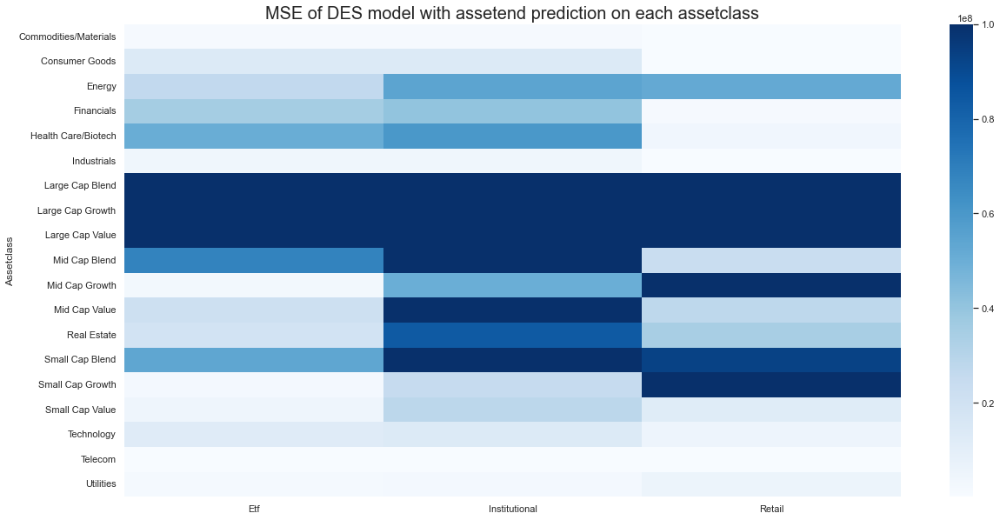

In [111]:
cmap = sns.cm.rocket_r
ax = sns.heatmap(result_mse, cmap='Blues', vmin=100000, vmax=100000000)
sns.set(rc = {'figure.figsize':(20,10)})
ax.set_title('MSE of DES model with assetend prediction on each assetclass', fontsize =20)

#### Combine the one month AUC of all databases and draw heatmaps

In [109]:
data_frames = [etf_ass, ins_ass, re_ass]
result_oneauc = reduce(lambda  left,right: pd.merge(left,right,on=['Assetclass'],how='outer'), data_frames)
result_oneauc = result_oneauc.loc[:, ['Assetclass', 'one_month_auc_x', 'one_month_auc_y', 'one_month_auc']]
result_oneauc.rename(columns={'one_month_auc_x':'Etf', 'one_month_auc_y':'Institutional', 'one_month_auc':'Retail'}, inplace=True)
result_oneauc.set_index('Assetclass', inplace=True)
result_oneauc

,Etf,Institutional,Retail
Assetclass,,,
Commodities/Materials,0.541948,0.545045,0.452233
Consumer Goods,0.505721,0.505721,0.451447
Energy,0.523455,0.535983,0.519380
Financials,0.471110,0.476891,0.607015
Health Care/Biotech,0.520396,0.508333,0.481548
Industrials,0.481419,0.481419,0.525862
Large Cap Blend,0.478221,0.501113,0.513988
Large Cap Growth,0.528730,0.500313,0.463636
Large Cap Value,0.560373,0.526391,0.472540


Text(0.5, 1.0, 'DES model with auc evaluation on each assetclass (One month interval)')

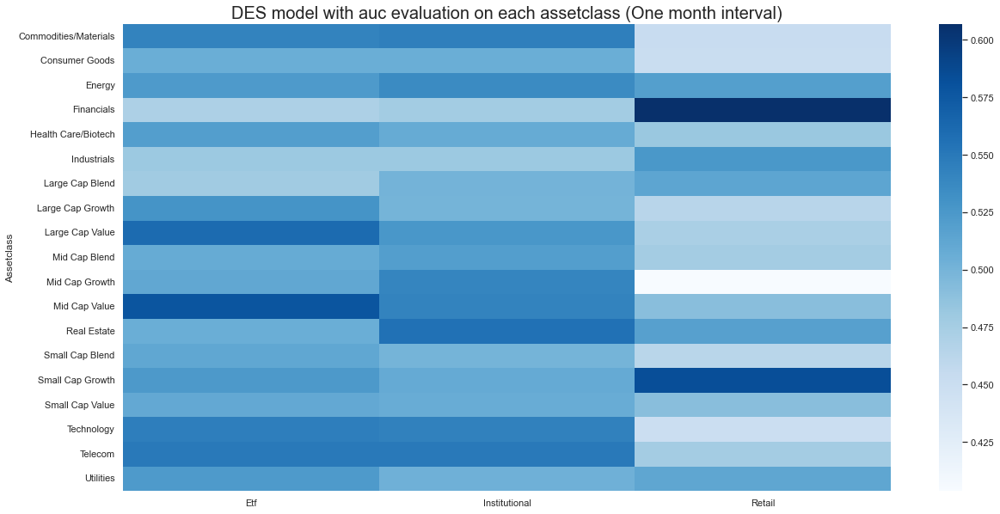

In [110]:
ax = sns.heatmap(result_oneauc,cmap = 'Blues')
sns.set(rc = {'figure.figsize':(20,10)})
ax.set_title('DES model with auc evaluation on each assetclass (One month interval)', fontsize =20)

#### Combine the three months AUC of all databases and draw heatmaps

In [112]:
data_frames = [etf_ass, ins_ass, re_ass]
result_threeauc = reduce(lambda  left,right: pd.merge(left,right,on=['Assetclass'],how='outer'), data_frames)
result_threeauc = result_threeauc.loc[:, ['Assetclass', 'three_month_auc_x', 'three_month_auc_y', 'three_month_auc']]
result_threeauc.rename(columns={'three_month_auc_x':'Etf', 'three_month_auc_y':'Institutional', 'three_month_auc':'Retail'}, inplace=True)
result_threeauc.set_index('Assetclass', inplace=True)
result_threeauc

,Etf,Institutional,Retail
Assetclass,,,
Commodities/Materials,0.587500,0.570513,0.491667
Consumer Goods,0.528788,0.528788,0.556818
Energy,0.579670,0.570106,0.523352
Financials,0.508681,0.508681,0.648284
Health Care/Biotech,0.570106,0.523352,0.531746
Industrials,0.475641,0.475641,0.792208
Large Cap Blend,0.517742,0.557576,0.582418
Large Cap Growth,0.579861,0.551613,0.580460
Large Cap Value,0.603030,0.594697,0.576250


Text(0.5, 1.0, 'DES model with auc evaluation on each assetclass (Three months interval)')

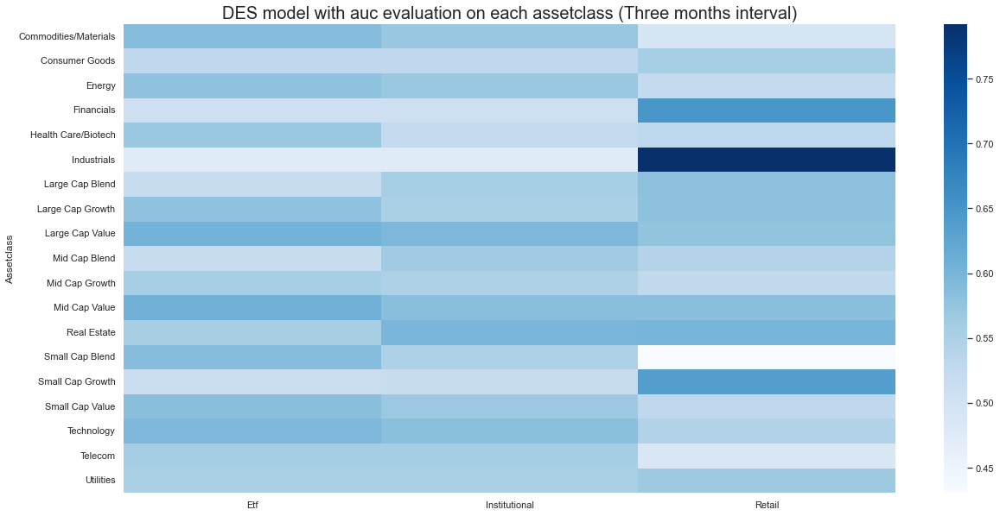

In [113]:
ax = sns.heatmap(result_threeauc,cmap = 'Blues')
sns.set(rc = {'figure.figsize':(20,10)})
ax.set_title('DES model with auc evaluation on each assetclass (Three months interval)', fontsize =20)

#### Combine the six months AUC of all databases and draw heatmaps

In [114]:
data_frames = [etf_ass, ins_ass, re_ass]
result_sixauc = reduce(lambda  left,right: pd.merge(left,right,on=['Assetclass'],how='outer'), data_frames)
result_sixauc = result_sixauc.loc[:, ['Assetclass', 'six_month_auc_x', 'six_month_auc_y', 'six_month_auc']]
result_sixauc.rename(columns={'six_month_auc_x':'Etf', 'six_month_auc_y':'Institutional', 'six_month_auc':'Retail'}, inplace=True)
result_sixauc.set_index('Assetclass', inplace=True)
result_sixauc

,Etf,Institutional,Retail
Assetclass,,,
Commodities/Materials,0.566667,0.466667,0.533333
Consumer Goods,0.600000,0.600000,0.561111
Energy,0.406250,0.411765,0.437500
Financials,0.750000,0.750000,0.670330
Health Care/Biotech,0.547619,0.566667,0.500000
Industrials,0.547619,0.547619,0.666667
Large Cap Blend,0.666667,0.694444,0.476190
Large Cap Growth,0.433333,0.444444,0.440476
Large Cap Value,0.607843,0.607843,0.417582


Text(0.5, 1.0, 'DES model with auc evaluation on each assetclass (Six months interval)')

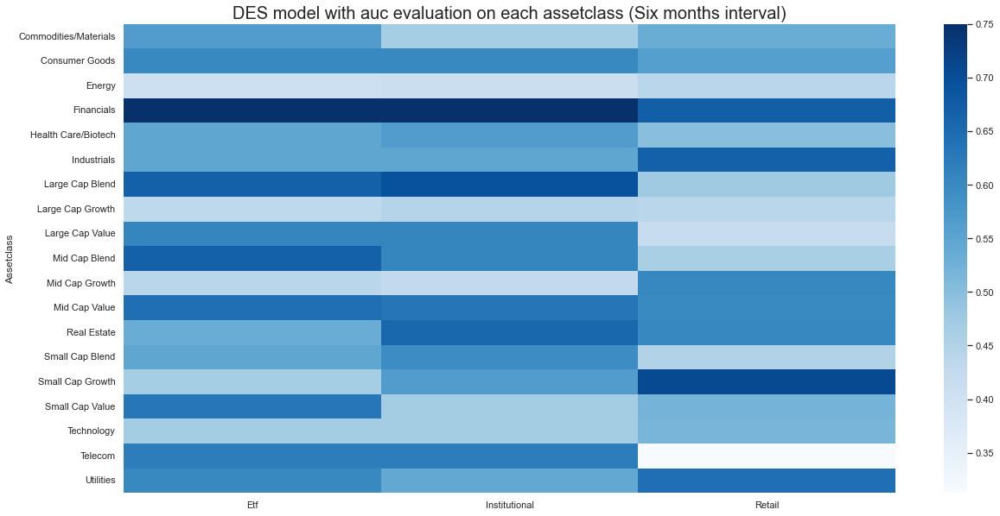

In [115]:
ax = sns.heatmap(result_sixauc,cmap = 'Blues')
sns.set(rc = {'figure.figsize':(20,10)})
ax.set_title('DES model with auc evaluation on each assetclass (Six months interval)', fontsize =20)